## PPO Agent Training

Here we will import Proximal Policy Optimization (PPO) algorithm from Stable Baselines3 and train it with minimal parameters.

We allow it to train for 50,000 time samples.

For more information about PPO, please refer to our hello world example notebook [here](https://github.com/GeoML-SIG/wildcatter/blob/main/examples/01_rl_hello_world_cartpole.ipynb).

In [1]:
from wildcatter.environment_for_RLib import SimpleDriller
import ray
from ray import air, tune
from ray.rllib.models.tf.tf_modelv2 import TFModelV2
from ray.rllib.models.tf.fcnet import FullyConnectedNetwork
from ray.rllib.utils.framework import try_import_tf
from ray.rllib.models import ModelCatalog
from gym.spaces import Box, Dict
import numpy as np
import matplotlib.pyplot as plt
from time import time

tf1, tf, tfv = try_import_tf(error=True)

class WildcatterActionMaskedModel(TFModelV2):
     
    def __init__(self, 
                 obs_space,
                 action_space,
                 num_outputs,
                 model_config,
                 name,
                 true_obs_shape=(11,40),
                 action_embed_size=4+38+1,
                 *args, **kwargs):
         
        super(WildcatterActionMaskedModel, self).__init__(obs_space,
            action_space, num_outputs, model_config, name, 
            *args, **kwargs)
         
        self.action_embed_model = FullyConnectedNetwork(
            Box(-10, 10, shape=true_obs_shape), 
                action_space, action_embed_size,
            model_config, name + "_action_embed")
        #self.register_variables(self.action_embed_model.variables())
 
    def forward(self, input_dict, state, seq_lens):
        # Extract the available actions tensor from the observation.
        action_mask = input_dict["obs"]["action_mask"]
        # Compute the predicted action embedding
        action_embed, _ = self.action_embed_model({
            "obs": input_dict["obs"]["state"]})
        # Mask out invalid actions (use tf.float32.min for stability)
        inf_mask = tf.maximum(tf.math.log(action_mask), tf.float32.min)
        # Return action_logits + inf_mask, state
        return action_embed + inf_mask, state
 
    def value_function(self):
        return self.action_embed_model.value_function()
    
ModelCatalog.register_custom_model('wildcatter_masked', WildcatterActionMaskedModel)

In [2]:
env_random_config = dict(model_type = "random",
                  nrow=11,
                  ncol=40,
                  available_pipe=30,
                  available_wells=2,
                  oil_price = 40,
                  relocation_cost = 0.2,
                  drilling_cost = 0.5,
                  drilling_depth_markup = 0.1,
#                  seed = 0,
                 )

env_random_pockets_config = dict(model_type = "random_pockets",
                  nrow=11,
                  ncol=40,
                  available_pipe=30,
                  available_wells=3,
                  oil_price = 1,
                  relocation_cost = 0.2,
                  drilling_cost = 0.5,
                  drilling_depth_markup = 0.1,
#                  seed = 0,
                 )

env_2d_two_rectangular_targets_config = dict(model_type = "from_csv",
                  model_path=r"/home/studio-lab-user/sagemaker-studiolab-notebooks/wildcatter-ThreeAmigos/examples/data/2d_two_rectangular_targets.csv",
                  delim=",",
                  available_pipe=30,
                  available_wells=2,
                  oil_price = 40,
                  relocation_cost = 0.2,
                  drilling_cost = 0.5,
                  drilling_depth_markup = 0.1,
#                  seed = 0,
                  )

env_config = env_random_pockets_config
#tune.register_env('wildcatter_driller', lambda environment_config_dict: SimpleDriller(environment_config_dict))

In [3]:
import ray.rllib.algorithms.ppo as ppo
from ray.tune.logger import pretty_print

In [6]:
# Custom Trial Plateau stopper that computes St.D. of windowed average
from typing import Dict, Optional
from collections import defaultdict, deque
import numpy as np
from ray.tune import Stopper

class MyTrialPlateauStopper(Stopper):
    """Early stop single trials when their windowed average reaches a plateau.

    When the standard deviation of the window-averaged `metric` result of a trial is
    below a threshold `std`, the trial plateaued and will be stopped
    early.

    Args:
        metric: Metric to check for convergence.
        std: Maximum metric standard deviation to decide if a
            trial plateaued. Defaults to 0.01.
        num_results: Number of results to consider for stdev
            calculation.
        grace_period: Minimum number of timesteps before a trial
            can be early stopped
        metric_threshold (Optional[float]):
            Minimum or maximum value the result has to exceed before it can
            be stopped early.
        mode: If a `metric_threshold` argument has been
            passed, this must be one of [min, max]. Specifies if we optimize
            for a large metric (max) or a small metric (min). If max, the
            `metric_threshold` has to be exceeded, if min the value has to
            be lower than `metric_threshold` in order to early stop.
    """

    def __init__(
        self,
        metric: str,
        std: float = 15,
        num_results: int = 10,
        grace_period: int = 10,
        metric_threshold: Optional[float] = None,
        mode: Optional[str] = None,
    ):
        self._metric = metric
        self._mode = mode

        self._std = std
        self._num_results = num_results
        self._grace_period = grace_period
        self._metric_threshold = metric_threshold

        if self._metric_threshold:
            if mode not in ["min", "max"]:
                raise ValueError(
                    f"When specifying a `metric_threshold`, the `mode` "
                    f"argument has to be one of [min, max]. "
                    f"Got: {mode}"
                )

        self._iter = defaultdict(lambda: 0)
        self._trial_results = defaultdict(lambda: deque(maxlen=self._num_results))
        self._trial_averages = defaultdict(lambda: deque(maxlen=self._num_results))

    def __call__(self, trial_id: str, result: Dict):
        metric_result = result.get(self._metric)
        self._trial_results[trial_id].append(metric_result)
        # Calculate running averages
        try:
            windowed_avg = np.average(self._trial_results[trial_id])
        except Exception:
            windowed_avg = metric_result
        self._trial_averages[trial_id].append(windowed_avg)
        self._iter[trial_id] += 1

        # If still in grace period, do not stop yet
        if self._iter[trial_id] < self._grace_period:
            return False

        # If not enough results yet, do not stop yet
        if len(self._trial_results[trial_id]) < self._num_results:
            return False

        # If metric threshold value not reached, do not stop yet
        if self._metric_threshold is not None:
            if self._mode == "min" and metric_result > self._metric_threshold:
                return False
            elif self._mode == "max" and metric_result < self._metric_threshold:
                return False

        # Calculate stdev of last `num_results` averages
        try:
            current_std = np.std(self._trial_averages[trial_id])
        except Exception:
            current_std = float("inf")

        # If stdev is lower than threshold, stop early.
        return current_std < self._std

    def stop_all(self):
        return False

In [7]:
# Hyperparameter tuning
from ray.tune.tuner import Tuner
from ray.tune.stopper import ExperimentPlateauStopper
from ray.tune.schedulers import AsyncHyperBandScheduler as ASHAScheduler
from ray.air.config import CheckpointConfig
#from ray.tune import Callback

param_space_config = ppo.DEFAULT_CONFIG.copy()
special_config = {"num_gpus" : 0,
                  "num_workers" : 0,
                  "num_envs_per_worker" : 1,
                  "env": SimpleDriller,
                  "env_config": env_config,
                  "model": {
                      "custom_model": "wildcatter_masked",
                  },
                  "framework": "tf2",
                  "horizon" : 40,
                  #"clip_param" : tune.uniform(0.1, 0.4),
                  "clip_param" : 0.2,
                  "eager_tracing" : True,
                  #"entropy_coeff" : tune.loguniform(1e-8, 1e-1),
                  "entropy_coeff" : 0,
                  "gamma" : tune.loguniform(0.9, 0.9999),
                  #"gamma" : 0.9,
                  #"lambda" : tune.loguniform(0.8, 1.0),,
                  "lambda" : 1
                  "lr" : tune.loguniform(1e-5, 1e-1),
                  #"sgd_minibatch_size" : tune.choice([8, 16, 32, 64, 128, 256, 512]),
                  "sgd_minibatch_size" : 128,
                  #"vf_loss_coeff" : tune.uniform(0,1),
                  "vf_loss_coeff" : 1.0,
                  #"num_sgd_iter" : tune.choice([4, 8, 16, 32, 64, 128, 256, 512, 1024, 2048]),
                  "num_sgd_iter" : 30,
                 }
param_space_config.update(special_config)

# Run config
stopper = MyTrialPlateauStopper("episode_reward_mean", std = 0.38, num_results = 10, grace_period = 10)

myCheckpointConfig = CheckpointConfig(num_to_keep = 3,
                                      checkpoint_frequency = 10,
                                      checkpoint_at_end = True)

myRunConfig = air.RunConfig(name = "Test0003",
                            local_dir = "~/sagemaker-studiolab-notebooks/",
                            stop = stopper,
                            checkpoint_config = myCheckpointConfig,
                            log_to_file = True)

# Tune config
asha_scheduler = ASHAScheduler(
    time_attr='training_iteration',
    metric='episode_reward_mean',
    mode='max',
    max_t=100,
    grace_period=2,
    reduction_factor=3,
    brackets=1)

myTuneConfig = tune.TuneConfig(scheduler=asha_scheduler,
                               num_samples=100,
                               time_budget_s = 2 * 60 * 60, # In seconds. It exits gracefully when the wall clock time is reached.
                              )

ray.init(ignore_reinit_error=True)
tuner = Tuner("PPO", run_config=myRunConfig, param_space=param_space_config, tune_config=myTuneConfig )
results = tuner.fit()

2022-08-26 08:42:47,810	WARNING services.py:1882 -- WARNING: The object store is using /tmp instead of /dev/shm because /dev/shm has only 4294967296 bytes available. This will harm performance! You may be able to free up space by deleting files in /dev/shm. If you are inside a Docker container, you can increase /dev/shm size by passing '--shm-size=4.67gb' to 'docker run' (or add it to the run_options list in a Ray cluster config). Make sure to set this to more than 30% of available RAM.
2022-08-26 08:42:49,073	INFO worker.py:1509 -- Started a local Ray instance. View the dashboard at 127.0.0.1:8265 


Trial name,status,loc,clip_param,entropy_coeff,gamma,lambda,lr,vf_loss_coeff,iter,total time (s),ts,reward,num_recreated_wor...,episode_reward_max,episode_reward_min
PPO_SimpleDriller_11997_00772,RUNNING,169.254.255.2:27177,0.337619,0.00279075,0.9286,0.963211,7.79128e-05,0.915389,26,880.755,104000,1175.19,0,1227,-4.3
PPO_SimpleDriller_11997_00775,RUNNING,169.254.255.2:27438,0.364623,3.9051e-05,0.927694,0.947722,5.47976e-05,0.382242,20,679.99,80000,1192.41,0,1227,-37.8
PPO_SimpleDriller_11997_00778,RUNNING,169.254.255.2:27823,0.293664,1.18356e-07,0.955829,0.89958,0.0961027,0.19997,,,,,,,
PPO_SimpleDriller_11997_00779,RUNNING,169.254.255.2:27893,0.190018,6.33798e-08,0.931183,0.97971,0.00094691,0.781697,,,,,,,
PPO_SimpleDriller_11997_00780,PENDING,,0.227632,2.3657e-06,0.962156,0.800146,0.0262592,0.858802,,,,,,,
PPO_SimpleDriller_11997_00781,PENDING,,0.323767,0.0217489,0.940846,0.912942,0.000524598,0.241621,,,,,,,
PPO_SimpleDriller_11997_00782,PENDING,,0.322085,3.44467e-06,0.963188,0.850304,0.0495981,0.977191,,,,,,,
PPO_SimpleDriller_11997_00783,PENDING,,0.288489,5.37592e-05,0.9462,0.858826,1.00547e-05,0.730614,,,,,,,
PPO_SimpleDriller_11997_00784,PENDING,,0.211021,5.27409e-07,0.933244,0.900463,0.0139404,0.322053,,,,,,,
PPO_SimpleDriller_11997_00785,PENDING,,0.258025,0.000377197,0.955749,0.843422,0.00014296,0.940815,,,,,,,


(PPO pid=421) 2022-08-26 08:42:57,052	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=421) 2022-08-26 08:42:57,054	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=421) 2022-08-26 08:42:57,059	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=421) 2022-08-26 08:42:57,574	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=421) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages

Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-43-24
  done: false
  episode_len_mean: 7.899209486166008
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 46.807905138339926
  episode_reward_min: -18.5
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002497138048056513
          entropy: 1.5724941492080688
          entropy_coeff: 0.09243922680616379
          kl: 0.009931033477187157
          policy_loss: -0.013836434110999107
          total_loss: 0.09299972653388977
          vf_explained_var: 0.0008637049468234181
          vf_l

(PPO pid=504) 2022-08-26 08:43:29,734	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00001:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-43-33
  done: true
  episode_len_mean: 7.713733075435203
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 19.735589941972922
  episode_reward_min: -14.7
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: 3cdfd8890bb34441979b26d75d0bee0d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.3805472665117122e-05
          entropy: 1.5800590515136719
          entropy_coeff: 0.058381445705890656
          kl: 0.0073682209476828575
          policy_loss: -0.01196120586246252
          total_loss: 1.410774827003479
          vf_explained_var: 0.00011228751100134104
          vf_l

(PPO pid=550) 2022-08-26 08:43:39,710	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=631) 2022-08-26 08:43:45,349	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=631) 2022-08-26 08:43:45,351	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=631) 2022-08-26 08:43:45,359	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=631) 2022-08-26 08:43:

Result for PPO_SimpleDriller_11997_00002:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-43-45
  done: true
  episode_len_mean: 7.926587301587301
  episode_media: {}
  episode_reward_max: 1224.8
  episode_reward_mean: 22.564285714285713
  episode_reward_min: -24.1
  episodes_this_iter: 504
  episodes_total: 504
  experiment_id: 20d4a38c1a564050ace871cda7f152ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.178347065433627e-05
          entropy: 1.5612430572509766
          entropy_coeff: 2.7154925192007795e-05
          kl: 0.012254073284566402
          policy_loss: -0.012274060398340225
          total_loss: 1.9359276294708252
          vf_explained_var: 8.781440556049347e-06
          vf_

(PPO pid=631) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=631)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=706) 2022-08-26 08:43:56,880	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=706) 2022-08-26 08:43:56,882	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=706) 2022-08-26 08:43:56,887	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to 

Result for PPO_SimpleDriller_11997_00003:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-43-55
  done: false
  episode_len_mean: 8.012024048096192
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 36.81402805611223
  episode_reward_min: -14.6
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: a10c01e5bc884bcb8ed8d25a5f1b8dcb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.07296684384346008
          entropy: 0.3935239911079407
          entropy_coeff: 2.7221260552323656e-06
          kl: 9.672839164733887
          policy_loss: 0.17867009341716766
          total_loss: 11.48941707611084
          vf_explained_var: -6.575137234676731e-08
          vf_loss: 9

(PPO pid=706) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=706)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=631) 2022-08-26 08:44:02,099	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=706) 2022-08-26 08:44:13,924	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00004:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-44-17
  done: false
  episode_len_mean: 8.146938775510204
  episode_media: {}
  episode_reward_max: 1225.2
  episode_reward_mean: 41.28183673469388
  episode_reward_min: -19.200000000000006
  episodes_this_iter: 490
  episodes_total: 490
  experiment_id: a214f537eda249c29211cd0bb2b53900
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0006699900259263813
          entropy: 1.571570873260498
          entropy_coeff: 1.588747363712173e-05
          kl: 0.004138624761253595
          policy_loss: -0.0017847662093117833
          total_loss: 1.8798574209213257
          vf_explained_var: 1.1386971010551861e-07

(PPO pid=792) 2022-08-26 08:44:40,913	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=792) 2022-08-26 08:44:40,917	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=792) 2022-08-26 08:44:40,926	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=792) 2022-08-26 08:44:41,295	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=792) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages

Result for PPO_SimpleDriller_11997_00004:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_08-44-49
  done: false
  episode_len_mean: 8.363256784968685
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 51.04843423799583
  episode_reward_min: -24.7
  episodes_this_iter: 479
  episodes_total: 969
  experiment_id: a214f537eda249c29211cd0bb2b53900
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 0.0006699900259263813
          entropy: 1.5540021657943726
          entropy_coeff: 1.588747363712173e-05
          kl: 0.005145674105733633
          policy_loss: -0.004455684684216976
          total_loss: 2.378089427947998
          vf_explained_var: 2.4835269396561444e-09
          vf_l

(PPO pid=792) 2022-08-26 08:44:59,755	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=866) 2022-08-26 08:45:10,226	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=866) 2022-08-26 08:45:10,228	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=866) 2022-08-26 08:45:10,237	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=866) 2022-08-26 08:45:

Result for PPO_SimpleDriller_11997_00006:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-45-15
  done: true
  episode_len_mean: 8.095141700404858
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 28.671862348178134
  episode_reward_min: -23.899999999999995
  episodes_this_iter: 494
  episodes_total: 494
  experiment_id: 01009ba407ff4b0a92cfe44179f66cf6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 8.765311940805987e-05
          entropy: 1.559585452079773
          entropy_coeff: 1.8643814883034793e-06
          kl: 0.008724846877157688
          policy_loss: -0.016875673085451126
          total_loss: 2.0654006004333496
          vf_explained_var: 0.00037221319507807493

(PPO pid=943) 2022-08-26 08:45:26,241	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=943) 2022-08-26 08:45:26,243	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=943) 2022-08-26 08:45:26,250	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=943) 2022-08-26 08:45:26,505	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_08-45-25
  done: false
  episode_len_mean: 7.598859315589354
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 89.93992395437263
  episode_reward_min: -17.500000000000004
  episodes_this_iter: 526
  episodes_total: 2520
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002497138048056513
          entropy: 1.5362205505371094
          entropy_coeff: 0.09243922680616379
          kl: 0.018319427967071533
          policy_loss: -0.027438482269644737
          total_loss: 0.16576071083545685
          vf_explained_var: 0.000829909869935

(PPO pid=943) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=943)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=866) 2022-08-26 08:45:28,298	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=943) 2022-08-26 08:45:43,075	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00007:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-45-43
  done: true
  episode_len_mean: 7.703275529865126
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 35.112331406551064
  episode_reward_min: -12.599999999999996
  episodes_this_iter: 519
  episodes_total: 519
  experiment_id: eea31dd7e450456089f25e36792a46d2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00016840265016071498
          entropy: 1.584617018699646
          entropy_coeff: 2.7414320356911048e-05
          kl: 0.004957948345690966
          policy_loss: -0.013936621136963367
          total_loss: 2.223905324935913
          vf_explained_var: 0.00032662233570590615

(PPO pid=1019) 2022-08-26 08:45:55,652	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1019) 2022-08-26 08:45:55,660	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1019) 2022-08-26 08:45:55,691	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1019) 2022-08-26 08:45:56,088	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1019) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_08-45-57
  done: false
  episode_len_mean: 7.207207207207207
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 95.74936936936938
  episode_reward_min: -16.700000000000003
  episodes_this_iter: 555
  episodes_total: 3075
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002497138048056513
          entropy: 1.559977412223816
          entropy_coeff: 0.09243922680616379
          kl: 0.01839783973991871
          policy_loss: -0.029702065512537956
          total_loss: 0.17479100823402405
          vf_explained_var: 0.00030770356534048

(PPO pid=1094) 2022-08-26 08:46:09,936	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1094) 2022-08-26 08:46:09,942	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1094) 2022-08-26 08:46:09,951	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1094) 2022-08-26 08:46:10,286	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1094) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00004:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_08-46-21
  done: false
  episode_len_mean: 8.961968680089486
  episode_media: {}
  episode_reward_max: 1504.4
  episode_reward_mean: 68.73691275167785
  episode_reward_min: -23.400000000000002
  episodes_this_iter: 447
  episodes_total: 2418
  experiment_id: a214f537eda249c29211cd0bb2b53900
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.05000000074505806
          cur_lr: 0.0006699900259263813
          entropy: 1.510480284690857
          entropy_coeff: 1.588747363712173e-05
          kl: 0.005959079600870609
          policy_loss: -0.003050555707886815
          total_loss: 2.813086986541748
          vf_explained_var: -2.483526939656144

(PPO pid=1094) 2022-08-26 08:46:29,475	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1174) 2022-08-26 08:46:39,438	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1174) 2022-08-26 08:46:39,445	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1174) 2022-08-26 08:46:39,454	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1174) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00010:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-46-45
  done: true
  episode_len_mean: 7.88560157790927
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 34.11932938856016
  episode_reward_min: -18.199999999999996
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: 2d04c9aacb4d4894825abddfdf2da7c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0009364971774630249
          entropy: 1.559985637664795
          entropy_coeff: 0.00038504376425407827
          kl: 0.01772913709282875
          policy_loss: -0.006267508026212454
          total_loss: 0.00011824824468931183
          vf_explained_var: 1.4590720809337654e-0

(PPO pid=1248) 2022-08-26 08:46:56,693	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1248) 2022-08-26 08:46:56,697	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1248) 2022-08-26 08:46:56,706	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1248) 2022-08-26 08:46:57,043	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1248) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_08-46-58
  done: false
  episode_len_mean: 9.928217821782178
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 429.41138613861386
  episode_reward_min: -31.299999999999986
  episodes_this_iter: 404
  episodes_total: 3921
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0002497138048056513
          entropy: 1.3229923248291016
          entropy_coeff: 0.09243922680616379
          kl: 0.020643416792154312
          policy_loss: -0.0375828891992569
          total_loss: 0.6735926270484924
          vf_explained_var: -0.0012101171305403

(PPO pid=1174) 2022-08-26 08:46:58,640	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00011:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-47-14
  done: true
  episode_len_mean: 7.75
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 26.220348837209304
  episode_reward_min: -14.8
  episodes_this_iter: 516
  episodes_total: 516
  experiment_id: ee62f636ad654a0e9ab47dc8734653cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0007440620684064925
          entropy: 1.5697559118270874
          entropy_coeff: 0.00040793351945467293
          kl: 0.011548686772584915
          policy_loss: -0.004356160759925842
          total_loss: 0.19150416553020477
          vf_explained_var: 3.4098823675776657e-07
          vf_loss: 1.314

(PPO pid=1248) 2022-08-26 08:47:14,483	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1326) 2022-08-26 08:47:26,587	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1326) 2022-08-26 08:47:26,591	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1326) 2022-08-26 08:47:26,598	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00004:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_08-47-22
  done: false
  episode_len_mean: 8.769736842105264
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 89.28662280701754
  episode_reward_min: -19.3
  episodes_this_iter: 456
  episodes_total: 3361
  experiment_id: a214f537eda249c29211cd0bb2b53900
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.05000000074505806
          cur_lr: 0.0006699900259263813
          entropy: 1.503710389137268
          entropy_coeff: 1.588747363712173e-05
          kl: 0.004921481013298035
          policy_loss: -0.0008259769529104233
          total_loss: 3.2604265213012695
          vf_explained_var: -3.2906730673687434e-09
      

(PPO pid=1326) 2022-08-26 08:47:26,937	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1326) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=1326)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_08-47-29
  done: false
  episode_len_mean: 8.875831485587582
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 439.74767184035477
  episode_reward_min: -34.499999999999986
  episodes_this_iter: 451
  episodes_total: 4372
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0002497138048056513
          entropy: 1.330328345298767
          entropy_coeff: 0.09243922680616379
          kl: 0.0188517514616251
          policy_loss: -0.044187165796756744
          total_loss: 0.6825955510139465
          vf_explained_var: -0.00183588243089616

(PPO pid=1399) 2022-08-26 08:47:39,895	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1399) 2022-08-26 08:47:39,897	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1399) 2022-08-26 08:47:39,904	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1399) 2022-08-26 08:47:40,215	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1399) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00004:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_08-47-56
  done: false
  episode_len_mean: 8.419831223628693
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 56.19345991561182
  episode_reward_min: -20.999999999999996
  episodes_this_iter: 474
  episodes_total: 3835
  experiment_id: a214f537eda249c29211cd0bb2b53900
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.02500000037252903
          cur_lr: 0.0006699900259263813
          entropy: 1.4999111890792847
          entropy_coeff: 1.588747363712173e-05
          kl: 0.005794007796794176
          policy_loss: -0.004081337247043848
          total_loss: 2.736605167388916
          vf_explained_var: -2.73187961141729

(PPO pid=1399) 2022-08-26 08:48:00,141	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1478) 2022-08-26 08:48:09,291	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1478) 2022-08-26 08:48:09,294	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1478) 2022-08-26 08:48:09,305	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1478) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00014:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-48-15
  done: true
  episode_len_mean: 7.958083832335329
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 32.65528942115769
  episode_reward_min: -12.299999999999999
  episodes_this_iter: 501
  episodes_total: 501
  experiment_id: 29dbada4e2eb47eab8d604248a7699a9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 5.1916533266194165e-05
          entropy: 1.56393563747406
          entropy_coeff: 5.1083752339309285e-08
          kl: 0.006089283153414726
          policy_loss: -0.010993133299052715
          total_loss: 1.155283808708191
          vf_explained_var: 0.0002152248634956777
  

(PPO pid=1553) 2022-08-26 08:48:26,939	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1553) 2022-08-26 08:48:26,941	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1553) 2022-08-26 08:48:26,949	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1553) 2022-08-26 08:48:27,252	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00004:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_08-48-25
  done: true
  episode_len_mean: 8.675324675324676
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 109.4857142857143
  episode_reward_min: -18.2
  episodes_this_iter: 462
  episodes_total: 4297
  experiment_id: a214f537eda249c29211cd0bb2b53900
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.02500000037252903
          cur_lr: 0.0006699900259263813
          entropy: 1.4795303344726562
          entropy_coeff: 1.588747363712173e-05
          kl: 0.004669456277042627
          policy_loss: -0.0019409348024055362
          total_loss: 3.3460190296173096
          vf_explained_var: -4.408259979271634e-09
       

(PPO pid=1553) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=1553)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=1478) 2022-08-26 08:48:27,999	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_08-48-28
  done: false
  episode_len_mean: 9.70316301703163
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 742.796107055961
  episode_reward_min: -31.59999999999999
  episodes_this_iter: 411
  episodes_total: 5205
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002497138048056513
          entropy: 1.1549550294876099
          entropy_coeff: 0.09243922680616379
          kl: 0.016275228932499886
          policy_loss: -0.037525467574596405
          total_loss: 0.9434366822242737
          vf_explained_var: -0.0016367142088711262


(PPO pid=1624) 2022-08-26 08:48:38,221	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1624) 2022-08-26 08:48:38,223	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1624) 2022-08-26 08:48:38,231	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1624) 2022-08-26 08:48:38,596	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1624) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00015:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-48-42
  done: true
  episode_len_mean: 7.902970297029703
  episode_media: {}
  episode_reward_max: 1225.1
  episode_reward_mean: 19.784950495049504
  episode_reward_min: -15.600000000000003
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: fc88c3fbf09f427ba973e2206ad2b4cf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 8.066424197750166e-05
          entropy: 1.574413537979126
          entropy_coeff: 0.011924036778509617
          kl: 0.006839468143880367
          policy_loss: -0.008675670251250267
          total_loss: 1.1994621753692627
          vf_explained_var: 0.0011958129471167922
  

(PPO pid=1553) 2022-08-26 08:48:42,939	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1624) 2022-08-26 08:48:55,660	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1697) 2022-08-26 08:48:55,633	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1697) 2022-08-26 08:48:55,638	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1697) 2022-08-26 08:48:55,646	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in y

Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_08-48-57
  done: false
  episode_len_mean: 9.371495327102803
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 861.0682242990653
  episode_reward_min: -33.4
  episodes_this_iter: 428
  episodes_total: 5633
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002497138048056513
          entropy: 1.029473900794983
          entropy_coeff: 0.09243922680616379
          kl: 0.014934364706277847
          policy_loss: -0.03419847413897514
          total_loss: 1.029499888420105
          vf_explained_var: -0.0025054903235286474
          vf_l

(PPO pid=1774) 2022-08-26 08:49:10,622	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1774) 2022-08-26 08:49:10,626	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1774) 2022-08-26 08:49:10,633	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-49-10
  done: false
  episode_len_mean: 7.982035928143713
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 36.541916167664674
  episode_reward_min: -18.799999999999997
  episodes_this_iter: 501
  episodes_total: 501
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.0326356863952242e-05
          entropy: 1.559821605682373
          entropy_coeff: 0.00022045096557121724
          kl: 0.01829710602760315
          policy_loss: -0.016677431762218475
          total_loss: 1.1206883192062378
          vf_explained_var: 8.310408884426579e-05

(PPO pid=1774) 2022-08-26 08:49:10,950	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1774) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=1774)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=1697) 2022-08-26 08:49:12,966	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_08-49-28
  done: false
  episode_len_mean: 8.984269662921347
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1008.6964044943819
  episode_reward_min: -34.89999999999999
  episodes_this_iter: 445
  episodes_total: 6078
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002497138048056513
          entropy: 0.9587917327880859
          entropy_coeff: 0.09243922680616379
          kl: 0.013187112286686897
          policy_loss: -0.02630736492574215
          total_loss: 1.1641405820846558
          vf_explained_var: -0.001415088539943099

(PPO pid=1774) 2022-08-26 08:49:29,259	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1855) 2022-08-26 08:49:40,550	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1855) 2022-08-26 08:49:40,556	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1855) 2022-08-26 08:49:40,568	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1855) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_08-49-43
  done: false
  episode_len_mean: 7.829745596868885
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 50.16712328767124
  episode_reward_min: -22.9
  episodes_this_iter: 511
  episodes_total: 1012
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.0326356863952242e-05
          entropy: 1.5377825498580933
          entropy_coeff: 0.00022045096557121724
          kl: 0.017256025224924088
          policy_loss: -0.01646062731742859
          total_loss: 1.3654927015304565
          vf_explained_var: 0.000217151697142981
          vf_

(PPO pid=1928) 2022-08-26 08:49:55,554	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1928) 2022-08-26 08:49:55,558	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1928) 2022-08-26 08:49:55,568	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1928) 2022-08-26 08:49:55,894	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1928) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_08-49-59
  done: false
  episode_len_mean: 8.882222222222222
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1064.9986666666666
  episode_reward_min: -32.7
  episodes_this_iter: 450
  episodes_total: 6528
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002497138048056513
          entropy: 0.9062354564666748
          entropy_coeff: 0.09243922680616379
          kl: 0.014619767665863037
          policy_loss: -0.0275393296033144
          total_loss: 1.2005915641784668
          vf_explained_var: -0.0022786215413361788
          vf

(PPO pid=1928) 2022-08-26 08:50:14,781	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=2007) 2022-08-26 08:50:25,799	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2007) 2022-08-26 08:50:25,804	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2007) 2022-08-26 08:50:25,816	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2007) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00021:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_08-50-30
  done: true
  episode_len_mean: 7.662835249042145
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 28.500574712643676
  episode_reward_min: -22.099999999999998
  episodes_this_iter: 522
  episodes_total: 522
  experiment_id: 62e6602d80224b2287b9317c27f8c607
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.240447429358028e-05
          entropy: 1.5849359035491943
          entropy_coeff: 0.0001595950743649155
          kl: 0.007744475267827511
          policy_loss: -0.007533269468694925
          total_loss: 1.047349214553833
          vf_explained_var: 8.251145118265413e-06
 

(PPO pid=2082) 2022-08-26 08:50:42,110	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2082) 2022-08-26 08:50:42,113	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2082) 2022-08-26 08:50:42,123	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2082) 2022-08-26 08:50:42,475	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2082) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_08-50-45
  done: false
  episode_len_mean: 9.401408450704226
  episode_media: {}
  episode_reward_max: 2041.6
  episode_reward_mean: 185.43661971830986
  episode_reward_min: -26.000000000000004
  episodes_this_iter: 426
  episodes_total: 1911
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.0326356863952242e-05
          entropy: 1.3419820070266724
          entropy_coeff: 0.00022045096557121724
          kl: 0.015554538927972317
          policy_loss: -0.024449598044157028
          total_loss: 2.713275671005249
          vf_explained_var: -0.00018340951

(PPO pid=2082) 2022-08-26 08:51:01,522	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_08-51-02
  done: false
  episode_len_mean: 8.289855072463768
  episode_media: {}
  episode_reward_max: 1624.4
  episode_reward_mean: 1066.8492753623188
  episode_reward_min: -25.5
  episodes_this_iter: 483
  episodes_total: 7458
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002497138048056513
          entropy: 0.8612420558929443
          entropy_coeff: 0.09243922680616379
          kl: 0.012463104911148548
          policy_loss: -0.02001907490193844
          total_loss: 1.2079284191131592
          vf_explained_var: -0.0015264094108715653
          v

(PPO pid=2169) 2022-08-26 08:51:29,274	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2169) 2022-08-26 08:51:29,279	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2169) 2022-08-26 08:51:29,287	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2169) 2022-08-26 08:51:29,642	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2169) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_08-51-32
  done: false
  episode_len_mean: 8.571734475374733
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 64.76059957173447
  episode_reward_min: -21.900000000000002
  episodes_this_iter: 467
  episodes_total: 977
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.956677240552381e-05
          entropy: 1.5257165431976318
          entropy_coeff: 0.03755035623908043
          kl: 0.015309263952076435
          policy_loss: -0.030670184642076492
          total_loss: 0.6421502828598022
          vf_explained_var: 9.303919068770483e-05
  

(PPO pid=2169) 2022-08-26 08:51:46,955	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_08-51-48
  done: false
  episode_len_mean: 12.496875
  episode_media: {}
  episode_reward_max: 1629.3
  episode_reward_mean: 445.79625000000004
  episode_reward_min: -24.3
  episodes_this_iter: 320
  episodes_total: 2586
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.0326356863952242e-05
          entropy: 1.0856671333312988
          entropy_coeff: 0.00022045096557121724
          kl: 0.019852953031659126
          policy_loss: -0.04471870884299278
          total_loss: 4.005220890045166
          vf_explained_var: -0.0007056390168145299
          vf_l

(PPO pid=2250) 2022-08-26 08:52:13,458	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2250) 2022-08-26 08:52:13,463	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2250) 2022-08-26 08:52:13,470	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2250) 2022-08-26 08:52:13,774	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_08-52-06
  done: false
  episode_len_mean: 8.458773784355179
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1034.516490486258
  episode_reward_min: -35.69999999999998
  episodes_this_iter: 473
  episodes_total: 8421
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002497138048056513
          entropy: 0.8923923969268799
          entropy_coeff: 0.09243922680616379
          kl: 0.01254888903349638
          policy_loss: -0.023893844336271286
          total_loss: 1.1598663330078125
          vf_explained_var: -0.0012649946147575974

(PPO pid=2250) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=2250)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_08-52-19
  done: false
  episode_len_mean: 11.93731343283582
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 561.7098507462687
  episode_reward_min: -26.2
  episodes_this_iter: 335
  episodes_total: 2921
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.0326356863952242e-05
          entropy: 0.9807186126708984
          entropy_coeff: 0.00022045096557121724
          kl: 0.02267422340810299
          policy_loss: -0.05050601065158844
          total_loss: 4.256307601928711
          vf_explained_var: 0.00033053389051929116
        

(PPO pid=2250) 2022-08-26 08:52:29,475	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_08-52-30
  done: false
  episode_len_mean: 13.003246753246753
  episode_media: {}
  episode_reward_max: 1706.8
  episode_reward_mean: 288.63214285714287
  episode_reward_min: -31.300000000000004
  episodes_this_iter: 308
  episodes_total: 1627
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.956677240552381e-05
          entropy: 1.3246948719024658
          entropy_coeff: 0.03755035623908043
          kl: 0.014581087045371532
          policy_loss: -0.03876739367842674
          total_loss: 1.356990933418274
          vf_explained_var: 0.0003021173761226

(PPO pid=2332) 2022-08-26 08:52:55,962	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2332) 2022-08-26 08:52:55,965	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2332) 2022-08-26 08:52:55,972	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_08-52-50
  done: false
  episode_len_mean: 10.427083333333334
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 872.8260416666667
  episode_reward_min: -18.200000000000003
  episodes_this_iter: 384
  episodes_total: 3305
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 3.0326356863952242e-05
          entropy: 0.8777822852134705
          entropy_coeff: 0.00022045096557121724
          kl: 0.021948805078864098
          policy_loss: -0.049059830605983734
          total_loss: 5.528252601623535
          vf_explained_var: 0.000417113420

(PPO pid=2332) 2022-08-26 08:52:56,294	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2332) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=2332)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_08-53-01
  done: false
  episode_len_mean: 14.177304964539006
  episode_media: {}
  episode_reward_max: 1876.0
  episode_reward_mean: 339.92021276595744
  episode_reward_min: -37.799999999999976
  episodes_this_iter: 282
  episodes_total: 1909
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.956677240552381e-05
          entropy: 1.2620660066604614
          entropy_coeff: 0.03755035623908043
          kl: 0.01801450364291668
          policy_loss: -0.04030584543943405
          total_loss: 1.3825632333755493
          vf_explained_var: 0.0002043379499809

(PPO pid=2332) 2022-08-26 08:53:12,535	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_08-53-13
  done: false
  episode_len_mean: 8.423157894736843
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1046.1014736842105
  episode_reward_min: -36.79999999999999
  episodes_this_iter: 475
  episodes_total: 9376
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002497138048056513
          entropy: 0.8721099495887756
          entropy_coeff: 0.09243922680616379
          kl: 0.011426890268921852
          policy_loss: -0.02112283743917942
          total_loss: 1.1915653944015503
          vf_explained_var: -0.001140699954703450

(PPO pid=2418) 2022-08-26 08:53:39,397	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2418) 2022-08-26 08:53:39,399	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2418) 2022-08-26 08:53:39,416	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2418) 2022-08-26 08:53:39,736	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2418) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 84000
  counters:
    num_agent_steps_sampled: 84000
    num_agent_steps_trained: 84000
    num_env_steps_sampled: 84000
    num_env_steps_trained: 84000
  custom_metrics: {}
  date: 2022-08-26_08-53-46
  done: false
  episode_len_mean: 8.915178571428571
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1098.355357142857
  episode_reward_min: -22.399999999999995
  episodes_this_iter: 448
  episodes_total: 9824
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002497138048056513
          entropy: 0.8869361877441406
          entropy_coeff: 0.09243922680616379
          kl: 0.012612419202923775
          policy_loss: -0.02001119777560234
          total_loss: 1.2154029607772827
          vf_explained_var: -0.001758657628670334

(PPO pid=2418) 2022-08-26 08:53:58,093	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_08-54-02
  done: false
  episode_len_mean: 14.575091575091575
  episode_media: {}
  episode_reward_max: 1462.9
  episode_reward_mean: 644.237728937729
  episode_reward_min: -36.39999999999998
  episodes_this_iter: 273
  episodes_total: 2459
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 9.956677240552381e-05
          entropy: 1.1532572507858276
          entropy_coeff: 0.03755035623908043
          kl: 0.019474051892757416
          policy_loss: -0.04963523522019386
          total_loss: 1.7112171649932861
          vf_explained_var: -0.00047763891052454

(PPO pid=2517) 2022-08-26 08:55:30,685	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2517) 2022-08-26 08:55:30,690	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2517) 2022-08-26 08:55:30,699	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2517) 2022-08-26 08:55:31,052	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2517) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_08-55-34
  done: false
  episode_len_mean: 8.410526315789474
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1131.9223157894737
  episode_reward_min: -36.999999999999986
  episodes_this_iter: 475
  episodes_total: 5570
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 3.0326356863952242e-05
          entropy: 0.5826131105422974
          entropy_coeff: 0.00022045096557121724
          kl: 0.013024857267737389
          policy_loss: -0.03159277141094208
          total_loss: 5.860755920410156
          vf_explained_var: 0.001779431593604

(PPO pid=2517) 2022-08-26 08:55:47,434	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_08-55-54
  done: false
  episode_len_mean: 8.381551362683439
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1102.7513626834382
  episode_reward_min: -19.299999999999997
  episodes_this_iter: 477
  episodes_total: 11693
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002497138048056513
          entropy: 0.8457041382789612
          entropy_coeff: 0.09243922680616379
          kl: 0.012487008236348629
          policy_loss: -0.0188552625477314
          total_loss: 1.2308756113052368
          vf_explained_var: -0.000581107393

(PPO pid=2598) 2022-08-26 08:56:13,628	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2598) 2022-08-26 08:56:13,630	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2598) 2022-08-26 08:56:13,637	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_08-56-10
  done: false
  episode_len_mean: 12.21165644171779
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 942.7726993865032
  episode_reward_min: -32.699999999999996
  episodes_this_iter: 326
  episodes_total: 3660
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 9.956677240552381e-05
          entropy: 1.0454730987548828
          entropy_coeff: 0.03755035623908043
          kl: 0.018755992874503136
          policy_loss: -0.04577004164457321
          total_loss: 1.913573980331421
          vf_explained_var: 0.000808808777946978

(PPO pid=2598) 2022-08-26 08:56:13,919	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2598) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=2598)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_08-56-25
  done: false
  episode_len_mean: 8.425263157894737
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1078.6271578947367
  episode_reward_min: -30.399999999999995
  episodes_this_iter: 475
  episodes_total: 12168
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002497138048056513
          entropy: 0.868928074836731
          entropy_coeff: 0.09243922680616379
          kl: 0.010866478085517883
          policy_loss: -0.02147081308066845
          total_loss: 1.1759374141693115
          vf_explained_var: -0.001678859465

(PPO pid=2598) 2022-08-26 08:56:30,394	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_08-56-33
  done: false
  episode_len_mean: 7.547169811320755
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1168.2450943396225
  episode_reward_min: -5.8999999999999995
  episodes_this_iter: 530
  episodes_total: 6603
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 3.0326356863952242e-05
          entropy: 0.49150970578193665
          entropy_coeff: 0.00022045096557121724
          kl: 0.007223169784992933
          policy_loss: -0.017359158024191856
          total_loss: 6.1563496589660645
          vf_explained_var: -0.00059081963

(PPO pid=2695) 2022-08-26 08:58:01,070	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2695) 2022-08-26 08:58:01,082	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2695) 2022-08-26 08:58:01,093	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2695) 2022-08-26 08:58:01,421	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 116000
  counters:
    num_agent_steps_sampled: 116000
    num_agent_steps_trained: 116000
    num_env_steps_sampled: 116000
    num_env_steps_trained: 116000
  custom_metrics: {}
  date: 2022-08-26_08-58-01
  done: false
  episode_len_mean: 8.097165991902834
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1042.7313765182184
  episode_reward_min: -15.399999999999997
  episodes_this_iter: 494
  episodes_total: 13629
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002497138048056513
          entropy: 0.8448453545570374
          entropy_coeff: 0.09243922680616379
          kl: 0.0074639152735471725
          policy_loss: -0.019841305911540985
          total_loss: 1.1754225492477417
          vf_explained_var: -0.00038620

(PPO pid=2695) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=2695)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_08-58-09
  done: false
  episode_len_mean: 7.29143897996357
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1163.4852459016392
  episode_reward_min: -32.9
  episodes_this_iter: 549
  episodes_total: 8210
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 3.0326356863952242e-05
          entropy: 0.48069849610328674
          entropy_coeff: 0.00022045096557121724
          kl: 0.006615837570279837
          policy_loss: -0.013404563069343567
          total_loss: 6.201924800872803
          vf_explained_var: -0.0014675207203254104
       

(PPO pid=2695) 2022-08-26 08:58:18,610	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00000:
  agent_timesteps_total: 120000
  counters:
    num_agent_steps_sampled: 120000
    num_agent_steps_trained: 120000
    num_env_steps_sampled: 120000
    num_env_steps_trained: 120000
  custom_metrics: {}
  date: 2022-08-26_08-58-32
  done: true
  episode_len_mean: 7.879446640316205
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1114.2883399209484
  episode_reward_min: -9.8
  episodes_this_iter: 506
  episodes_total: 14135
  experiment_id: a34c20d96c594b8e84ff614812c334da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002497138048056513
          entropy: 0.7884294390678406
          entropy_coeff: 0.09243922680616379
          kl: 0.008208796381950378
          policy_loss: -0.015544596128165722
          total_loss: 1.2480140924453735
          vf_explained_var: -0.0021949447691440582
     

(PPO pid=2778) 2022-08-26 08:58:44,120	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2778) 2022-08-26 08:58:44,125	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2778) 2022-08-26 08:58:44,132	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2778) 2022-08-26 08:58:44,463	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2778) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_08-58-49
  done: false
  episode_len_mean: 9.295348837209302
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1002.3462790697675
  episode_reward_min: -37.09999999999999
  episodes_this_iter: 430
  episodes_total: 5598
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.956677240552381e-05
          entropy: 0.9286338686943054
          entropy_coeff: 0.03755035623908043
          kl: 0.01660127379000187
          policy_loss: -0.04052768647670746
          total_loss: 1.9001158475875854
          vf_explained_var: 0.0007317417184822261


(PPO pid=2778) 2022-08-26 08:59:00,928	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00030:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_08-59-06
  done: false
  episode_len_mean: 6.771043771043771
  episode_media: {}
  episode_reward_max: 1021.1
  episode_reward_mean: 2.57996632996633
  episode_reward_min: -17.4
  episodes_this_iter: 594
  episodes_total: 1096
  experiment_id: 3e42b9fd929441c88f769b4e0ddb623d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.002819355111569166
          entropy: 1.5064948797225952
          entropy_coeff: 8.34631421753329e-08
          kl: 0.050854943692684174
          policy_loss: 0.004480126779526472
          total_loss: 0.12872348725795746
          vf_explained_var: -1.750886369222826e-08
          vf_lo

(PPO pid=2864) 2022-08-26 08:59:28,111	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2864) 2022-08-26 08:59:28,119	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2864) 2022-08-26 08:59:28,126	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2864) 2022-08-26 08:59:28,488	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2864) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00030:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_08-59-39
  done: true
  episode_len_mean: 7.076106194690266
  episode_media: {}
  episode_reward_max: 1137.3
  episode_reward_mean: 6.14212389380531
  episode_reward_min: -17.799999999999997
  episodes_this_iter: 565
  episodes_total: 1661
  experiment_id: 3e42b9fd929441c88f769b4e0ddb623d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.002819355111569166
          entropy: 1.4621933698654175
          entropy_coeff: 8.34631421753329e-08
          kl: 0.036361899226903915
          policy_loss: 0.003934712149202824
          total_loss: 0.1830538809299469
          vf_explained_var: 6.829699028543246e-10

(PPO pid=2864) 2022-08-26 08:59:46,221	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=2938) 2022-08-26 08:59:49,517	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2938) 2022-08-26 08:59:49,523	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2938) 2022-08-26 08:59:49,542	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2938) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_08-59-53
  done: false
  episode_len_mean: 8.77024070021882
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1130.2299781181619
  episode_reward_min: -34.9
  episodes_this_iter: 457
  episodes_total: 6502
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.956677240552381e-05
          entropy: 0.8113958835601807
          entropy_coeff: 0.03755035623908043
          kl: 0.012529603205621243
          policy_loss: -0.03160839527845383
          total_loss: 2.035850763320923
          vf_explained_var: 0.0005856373463757336
          vf_l

(PPO pid=2938) 2022-08-26 09:00:08,302	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=3013) 2022-08-26 09:00:13,668	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3013) 2022-08-26 09:00:13,671	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3013) 2022-08-26 09:00:13,678	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3013) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_09-00-15
  done: false
  episode_len_mean: 7.460820895522388
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1084.7160447761196
  episode_reward_min: -15.7
  episodes_this_iter: 536
  episodes_total: 10371
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 3.0326356863952242e-05
          entropy: 0.5775235295295715
          entropy_coeff: 0.00022045096557121724
          kl: 0.009351937100291252
          policy_loss: -0.02248089574277401
          total_loss: 5.791545391082764
          vf_explained_var: -0.0023392951115965843
       

(PPO pid=3013) 2022-08-26 09:00:31,488	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_09-00-47
  done: false
  episode_len_mean: 7.3083941605839415
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1141.4479927007299
  episode_reward_min: -3.9999999999999996
  episodes_this_iter: 548
  episodes_total: 10919
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 3.0326356863952242e-05
          entropy: 0.5303758978843689
          entropy_coeff: 0.00022045096557121724
          kl: 0.007777797058224678
          policy_loss: -0.013609697110950947
          total_loss: 6.123819828033447
          vf_explained_var: -0.00178988231

(PPO pid=3097) 2022-08-26 09:00:59,340	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3097) 2022-08-26 09:00:59,342	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3097) 2022-08-26 09:00:59,349	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3097) 2022-08-26 09:00:59,613	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_09-00-57
  done: false
  episode_len_mean: 8.23045267489712
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1160.879218106996
  episode_reward_min: -35.69999999999998
  episodes_this_iter: 486
  episodes_total: 7454
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.956677240552381e-05
          entropy: 0.6927369832992554
          entropy_coeff: 0.03755035623908043
          kl: 0.013202274218201637
          policy_loss: -0.029607130214571953
          total_loss: 2.0637974739074707
          vf_explained_var: -0.0001281912118429318

(PPO pid=3097) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=3097)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=3097) 2022-08-26 09:01:16,106	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 96000
  counters:
    num_agent_steps_sampled: 96000
    num_agent_steps_trained: 96000
    num_env_steps_sampled: 96000
    num_env_steps_trained: 96000
  custom_metrics: {}
  date: 2022-08-26_09-01-16
  done: false
  episode_len_mean: 7.315018315018315
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1151.9408424908424
  episode_reward_min: -13.000000000000002
  episodes_this_iter: 546
  episodes_total: 11465
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 3.0326356863952242e-05
          entropy: 0.5376215577125549
          entropy_coeff: 0.00022045096557121724
          kl: 0.014545058831572533
          policy_loss: -0.023918239399790764
          total_loss: 6.1262664794921875
          vf_explained_var: -0.00262418831

(PPO pid=3183) 2022-08-26 09:01:44,837	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3183) 2022-08-26 09:01:44,844	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3183) 2022-08-26 09:01:44,852	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3183) 2022-08-26 09:01:45,150	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3183) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_09-01-51
  done: false
  episode_len_mean: 7.356617647058823
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1128.3172794117647
  episode_reward_min: -9.7
  episodes_this_iter: 544
  episodes_total: 12009
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 3.0326356863952242e-05
          entropy: 0.5706828832626343
          entropy_coeff: 0.00022045096557121724
          kl: 0.015048357658088207
          policy_loss: -0.027478916570544243
          total_loss: 6.025606155395508
          vf_explained_var: -0.0027874624356627464
  

(PPO pid=3183) 2022-08-26 09:02:04,960	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00036:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-02-20
  done: true
  episode_len_mean: 7.8392156862745095
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 29.468431372549023
  episode_reward_min: -19.3
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: 1dd47fca97ba416aaade9e3aa3f843c1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00940616987645626
          entropy: 1.3851854801177979
          entropy_coeff: 1.5751878891023807e-05
          kl: 0.3034628927707672
          policy_loss: 0.033899370580911636
          total_loss: 0.7863864302635193
          vf_explained_var: -1.2169281582430358e-08
          vf_lo

(PPO pid=3267) 2022-08-26 09:02:31,696	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3267) 2022-08-26 09:02:31,699	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3267) 2022-08-26 09:02:31,707	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_09-02-25
  done: false
  episode_len_mean: 7.518796992481203
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1030.7050751879701
  episode_reward_min: -35.89999999999999
  episodes_this_iter: 532
  episodes_total: 12541
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 3.0326356863952242e-05
          entropy: 0.6490939855575562
          entropy_coeff: 0.00022045096557121724
          kl: 0.016311805695295334
          policy_loss: -0.030653728172183037
          total_loss: 5.5623555183410645
          vf_explained_var: -0.0020835

(PPO pid=3267) 2022-08-26 09:02:31,983	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00033:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_09-02-30
  done: false
  episode_len_mean: 8.109533468559837
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 78.66064908722109
  episode_reward_min: -19.0
  episodes_this_iter: 493
  episodes_total: 2507
  experiment_id: bdfa0793d568406596b7d53712216abc
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003552570997271687
          entropy: 1.5317631959915161
          entropy_coeff: 6.18249032413587e-06
          kl: 0.00954019371420145
          policy_loss: -0.01380326971411705
          total_loss: 2.572505235671997
          vf_explained_var: 0.0010069763520732522
          vf

(PPO pid=3267) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=3267)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_09-02-32
  done: false
  episode_len_mean: 8.014028056112224
  episode_media: {}
  episode_reward_max: 1629.8
  episode_reward_mean: 1163.3725450901802
  episode_reward_min: -32.2
  episodes_this_iter: 499
  episodes_total: 8960
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.956677240552381e-05
          entropy: 0.6452282071113586
          entropy_coeff: 0.03755035623908043
          kl: 0.011989453807473183
          policy_loss: -0.029396556317806244
          total_loss: 2.092658281326294
          vf_explained_var: -0.0002712661516852677
          v

(PPO pid=3267) 2022-08-26 09:02:46,577	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00017:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_09-03-02
  done: true
  episode_len_mean: 7.419294990723563
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1119.560853432282
  episode_reward_min: -4.2
  episodes_this_iter: 539
  episodes_total: 13080
  experiment_id: 1f378c820d804888b32d8a9208fc4aa8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 3.0326356863952242e-05
          entropy: 0.5837957859039307
          entropy_coeff: 0.00022045096557121724
          kl: 0.010801148600876331
          policy_loss: -0.0216961819678545
          total_loss: 5.985058784484863
          vf_explained_var: -0.0026308861561119556
      

(PPO pid=3350) 2022-08-26 09:03:14,048	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3350) 2022-08-26 09:03:14,051	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3350) 2022-08-26 09:03:14,059	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3350) 2022-08-26 09:03:14,375	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3350) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00033:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_09-03-35
  done: false
  episode_len_mean: 8.119675456389452
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 136.04908722109536
  episode_reward_min: -23.500000000000004
  episodes_this_iter: 493
  episodes_total: 3458
  experiment_id: bdfa0793d568406596b7d53712216abc
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003552570997271687
          entropy: 1.4801851511001587
          entropy_coeff: 6.18249032413587e-06
          kl: 0.012275316752493382
          policy_loss: -0.017412293702363968
          total_loss: 2.9506895542144775
          vf_explained_var: 0.00017824961105

(PPO pid=3350) 2022-08-26 09:03:35,760	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00037:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-03-36
  done: false
  episode_len_mean: 6.142857142857143
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 6.901843317972349
  episode_reward_min: -9.200000000000001
  episodes_this_iter: 651
  episodes_total: 1144
  experiment_id: 853df0fae2cf48f88f4c92f93912d92f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.004069767892360687
          entropy: 1.5034193992614746
          entropy_coeff: 2.0317047528806143e-05
          kl: 0.0953342616558075
          policy_loss: 0.0023288235533982515
          total_loss: 0.34663477540016174
          vf_explained_var: -2.0489097085629737e-09

(PPO pid=3435) 2022-08-26 09:04:06,415	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3435) 2022-08-26 09:04:06,416	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3435) 2022-08-26 09:04:06,425	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00033:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_09-04-06
  done: false
  episode_len_mean: 9.084090909090909
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 262.7452272727273
  episode_reward_min: -28.400000000000002
  episodes_this_iter: 440
  episodes_total: 3898
  experiment_id: bdfa0793d568406596b7d53712216abc
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003552570997271687
          entropy: 1.3970201015472412
          entropy_coeff: 6.18249032413587e-06
          kl: 0.013840001076459885
          policy_loss: -0.017062325030565262
          total_loss: 4.242761135101318
          vf_explained_var: 6.178046169225127e

(PPO pid=3435) 2022-08-26 09:04:06,786	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3435) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=3435)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00037:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-04-08
  done: true
  episode_len_mean: 5.949404761904762
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 8.09360119047619
  episode_reward_min: -8.5
  episodes_this_iter: 672
  episodes_total: 1816
  experiment_id: 853df0fae2cf48f88f4c92f93912d92f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.004069767892360687
          entropy: 1.4884709119796753
          entropy_coeff: 2.0317047528806143e-05
          kl: 0.06510072201490402
          policy_loss: 0.003925634082406759
          total_loss: 0.26879194378852844
          vf_explained_var: -9.064873296438236e-09
          v

(PPO pid=3506) 2022-08-26 09:04:19,119	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3506) 2022-08-26 09:04:19,130	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3506) 2022-08-26 09:04:19,146	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3506) 2022-08-26 09:04:19,448	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3506) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00033:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_09-04-36
  done: true
  episode_len_mean: 9.960199004975124
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 396.76592039801
  episode_reward_min: -29.2
  episodes_this_iter: 402
  episodes_total: 4300
  experiment_id: bdfa0793d568406596b7d53712216abc
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003552570997271687
          entropy: 1.31150484085083
          entropy_coeff: 6.18249032413587e-06
          kl: 0.015844304114580154
          policy_loss: -0.018538368865847588
          total_loss: 5.049795627593994
          vf_explained_var: -0.00012935418635606766
          vf_

(PPO pid=3506) 2022-08-26 09:04:39,910	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=3582) 2022-08-26 09:04:46,449	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3582) 2022-08-26 09:04:46,452	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3582) 2022-08-26 09:04:46,460	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3582) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_09-04-39
  done: false
  episode_len_mean: 8.03012048192771
  episode_media: {}
  episode_reward_max: 2041.8
  episode_reward_mean: 1161.7267068273093
  episode_reward_min: -17.200000000000003
  episodes_this_iter: 498
  episodes_total: 10959
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.956677240552381e-05
          entropy: 0.6685317754745483
          entropy_coeff: 0.03755035623908043
          kl: 0.01259700022637844
          policy_loss: -0.024007435888051987
          total_loss: 2.0677525997161865
          vf_explained_var: -1.036574485624

(PPO pid=3582) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=3582)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00040:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-04-50
  done: false
  episode_len_mean: 7.665384615384616
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 39.777115384615385
  episode_reward_min: -18.5
  episodes_this_iter: 520
  episodes_total: 520
  experiment_id: f2e6d8f9830a4d4b805862a5540db0d1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.005837282165884972
          entropy: 1.4255539178848267
          entropy_coeff: 4.400364559842274e-06
          kl: 0.2042115181684494
          policy_loss: 0.011970818042755127
          total_loss: 1.1422725915908813
          vf_explained_var: 1.614292521878724e-08
          vf_loss

(PPO pid=3658) 2022-08-26 09:04:57,525	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3658) 2022-08-26 09:04:57,527	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3658) 2022-08-26 09:04:57,535	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3658) 2022-08-26 09:04:57,837	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3658) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 112000
  counters:
    num_agent_steps_sampled: 112000
    num_agent_steps_trained: 112000
    num_env_steps_sampled: 112000
    num_env_steps_trained: 112000
  custom_metrics: {}
  date: 2022-08-26_09-05-17
  done: false
  episode_len_mean: 7.78988326848249
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1160.0879377431907
  episode_reward_min: -4.8
  episodes_this_iter: 514
  episodes_total: 11473
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.956677240552381e-05
          entropy: 0.65864497423172
          entropy_coeff: 0.03755035623908043
          kl: 0.011805006302893162
          policy_loss: -0.01988457702100277
          total_loss: 2.0684781074523926
          vf_explained_var: 0.00026537509984336793
         

(PPO pid=3658) 2022-08-26 09:05:18,746	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00041:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-05-19
  done: true
  episode_len_mean: 7.622137404580153
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 20.6956106870229
  episode_reward_min: -15.2
  episodes_this_iter: 524
  episodes_total: 524
  experiment_id: a09077fee389400ea3bb6f1281365647
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.1134742635476869e-05
          entropy: 1.5775227546691895
          entropy_coeff: 0.00018444666056893766
          kl: 0.017033835873007774
          policy_loss: -0.014164227992296219
          total_loss: 0.8638803958892822
          vf_explained_var: 1.0242933967674617e-05
          vf_

(PPO pid=3740) 2022-08-26 09:05:30,466	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3740) 2022-08-26 09:05:30,472	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3740) 2022-08-26 09:05:30,479	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3740) 2022-08-26 09:05:30,840	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3740) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00042:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-05-34
  done: false
  episode_len_mean: 7.893280632411067
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 34.54505928853755
  episode_reward_min: -16.6
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: 396480854a8a4c669a4bd74c37143c55
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0014427582500502467
          entropy: 1.5431400537490845
          entropy_coeff: 3.90319837606512e-05
          kl: 0.03185971453785896
          policy_loss: 0.003423144808039069
          total_loss: 0.8040778040885925
          vf_explained_var: 4.470348535789981e-09
          vf_loss

(PPO pid=3740) 2022-08-26 09:05:48,891	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 116000
  counters:
    num_agent_steps_sampled: 116000
    num_agent_steps_trained: 116000
    num_env_steps_sampled: 116000
    num_env_steps_trained: 116000
  custom_metrics: {}
  date: 2022-08-26_09-05-49
  done: false
  episode_len_mean: 7.7084942084942085
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1137.6523166023167
  episode_reward_min: -35.8
  episodes_this_iter: 518
  episodes_total: 11991
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.956677240552381e-05
          entropy: 0.6507660746574402
          entropy_coeff: 0.03755035623908043
          kl: 0.01195538230240345
          policy_loss: -0.023417362943291664
          total_loss: 2.03438401222229
          vf_explained_var: -0.0001130017772084102
      

(PPO pid=3827) 2022-08-26 09:06:16,346	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3827) 2022-08-26 09:06:16,353	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3827) 2022-08-26 09:06:16,365	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3827) 2022-08-26 09:06:16,772	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3827) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00022:
  agent_timesteps_total: 120000
  counters:
    num_agent_steps_sampled: 120000
    num_agent_steps_trained: 120000
    num_env_steps_sampled: 120000
    num_env_steps_trained: 120000
  custom_metrics: {}
  date: 2022-08-26_09-06-22
  done: false
  episode_len_mean: 7.7466150870406185
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1166.5075435203096
  episode_reward_min: -22.499999999999993
  episodes_this_iter: 517
  episodes_total: 12508
  experiment_id: c8cdcf0b9c2b4ea599fc1debb40cf38e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.956677240552381e-05
          entropy: 0.630172073841095
          entropy_coeff: 0.03755035623908043
          kl: 0.011478913016617298
          policy_loss: -0.02628755196928978
          total_loss: 2.0660500526428223
          vf_explained_var: -8.12983780633

(PPO pid=3827) 2022-08-26 09:06:34,487	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00042:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-06-40
  done: false
  episode_len_mean: 10.610079575596817
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 65.1289124668435
  episode_reward_min: -33.79999999999998
  episodes_this_iter: 377
  episodes_total: 1256
  experiment_id: 396480854a8a4c669a4bd74c37143c55
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0014427582500502467
          entropy: 1.3965290784835815
          entropy_coeff: 3.90319837606512e-05
          kl: 0.01998957060277462
          policy_loss: 0.00431771669536829
          total_loss: 1.772223711013794
          vf_explained_var: -2.2351742678949904e-0

(PPO pid=3929) 2022-08-26 09:08:04,017	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3929) 2022-08-26 09:08:04,019	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3929) 2022-08-26 09:08:04,025	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00040:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_09-08-00
  done: false
  episode_len_mean: 9.535714285714286
  episode_media: {}
  episode_reward_max: 1262.8
  episode_reward_mean: 102.19928571428571
  episode_reward_min: -27.2
  episodes_this_iter: 420
  episodes_total: 2994
  experiment_id: f2e6d8f9830a4d4b805862a5540db0d1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.005837282165884972
          entropy: 1.2952533960342407
          entropy_coeff: 4.400364559842274e-06
          kl: 0.017739804461598396
          policy_loss: -0.002935025142505765
          total_loss: 2.5361616611480713
          vf_explained_var: -3.47693762670076e-09
          

(PPO pid=3929) 2022-08-26 09:08:04,267	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3929) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=3929)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=3998) 2022-08-26 09:08:16,105	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3998) 2022-08-26 09:08:16,117	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3998) 2022-08-26 09:08:16,125	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set

Result for PPO_SimpleDriller_11997_00042:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_09-08-18
  done: false
  episode_len_mean: 10.308483290488432
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 104.90616966580977
  episode_reward_min: -28.6
  episodes_this_iter: 389
  episodes_total: 2525
  experiment_id: 396480854a8a4c669a4bd74c37143c55
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0014427582500502467
          entropy: 1.3669875860214233
          entropy_coeff: 3.90319837606512e-05
          kl: 0.01534594688564539
          policy_loss: 0.003114670980721712
          total_loss: 1.9332493543624878
          vf_explained_var: -4.967053879312289e-09
          

(PPO pid=3929) 2022-08-26 09:08:20,836	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00040:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_09-08-34
  done: false
  episode_len_mean: 8.7
  episode_media: {}
  episode_reward_max: 2159.5
  episode_reward_mean: 95.20913043478261
  episode_reward_min: -19.100000000000005
  episodes_this_iter: 460
  episodes_total: 3454
  experiment_id: f2e6d8f9830a4d4b805862a5540db0d1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.005837282165884972
          entropy: 1.3271896839141846
          entropy_coeff: 4.400364559842274e-06
          kl: 0.020419271662831306
          policy_loss: -0.0021072523668408394
          total_loss: 2.363435983657837
          vf_explained_var: -3.6011138515590346e-09
         

(PPO pid=3998) 2022-08-26 09:08:34,562	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00045:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-08-36
  done: true
  episode_len_mean: 8.205338809034908
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 24.03778234086242
  episode_reward_min: -14.9
  episodes_this_iter: 487
  episodes_total: 487
  experiment_id: ebcc265dc4144e769b3a5ab0a8a7ec0a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 5.464290370582603e-05
          entropy: 1.5528151988983154
          entropy_coeff: 2.116163386745029e-06
          kl: 0.015338190831243992
          policy_loss: -0.017687447369098663
          total_loss: 1.0620568990707397
          vf_explained_var: 0.0001816745789255947
          vf_lo

(PPO pid=4077) 2022-08-26 09:08:48,792	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4077) 2022-08-26 09:08:48,797	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4077) 2022-08-26 09:08:48,813	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4077) 2022-08-26 09:08:49,153	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4077) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00046:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-08-50
  done: true
  episode_len_mean: 7.778210116731517
  episode_media: {}
  episode_reward_max: 1225.4
  episode_reward_mean: 15.720622568093384
  episode_reward_min: -18.299999999999997
  episodes_this_iter: 514
  episodes_total: 514
  experiment_id: 819cfeaab12d4f3f8c1e125d2fb5ce30
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.010628344491124153
          entropy: 1.3605259656906128
          entropy_coeff: 0.0002829412987921387
          kl: 0.32605770230293274
          policy_loss: 0.04353901371359825
          total_loss: 0.6571652889251709
          vf_explained_var: 4.9484274455835475e-08
   

(PPO pid=4151) 2022-08-26 09:09:02,947	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4151) 2022-08-26 09:09:02,949	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4151) 2022-08-26 09:09:02,956	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4151) 2022-08-26 09:09:03,260	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4151) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00040:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_09-09-06
  done: true
  episode_len_mean: 9.73838630806846
  episode_media: {}
  episode_reward_max: 1630.2
  episode_reward_mean: 157.0237163814181
  episode_reward_min: -25.799999999999994
  episodes_this_iter: 409
  episodes_total: 3863
  experiment_id: f2e6d8f9830a4d4b805862a5540db0d1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 3.417187452316284
          cur_lr: 0.005837282165884972
          entropy: 1.3050572872161865
          entropy_coeff: 4.400364559842274e-06
          kl: 0.012836170382797718
          policy_loss: -0.0002517630928196013
          total_loss: 3.2442195415496826
          vf_explained_var: -8.630255621255856e-

(PPO pid=4077) 2022-08-26 09:09:06,515	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=4223) 2022-08-26 09:09:18,479	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4223) 2022-08-26 09:09:18,481	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4223) 2022-08-26 09:09:18,492	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4223) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00042:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_09-09-22
  done: false
  episode_len_mean: 9.736077481840194
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 101.4910411622276
  episode_reward_min: -32.499999999999986
  episodes_this_iter: 413
  episodes_total: 3330
  experiment_id: 396480854a8a4c669a4bd74c37143c55
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0014427582500502467
          entropy: 1.380500316619873
          entropy_coeff: 3.90319837606512e-05
          kl: 0.0148506760597229
          policy_loss: 0.004100306425243616
          total_loss: 1.6551369428634644
          vf_explained_var: -6.829699028543246e-09


(PPO pid=4223) 2022-08-26 09:09:36,071	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00048:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-09-37
  done: false
  episode_len_mean: 8.434599156118143
  episode_media: {}
  episode_reward_max: 1262.3
  episode_reward_mean: 51.0006329113924
  episode_reward_min: -21.899999999999995
  episodes_this_iter: 474
  episodes_total: 474
  experiment_id: d3fdbc584b6d4cf9997cd1eb350aca38
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.017111295834183693
          entropy: 1.1459426879882812
          entropy_coeff: 0.000318943610182032
          kl: 1.0809439420700073
          policy_loss: 0.09457454830408096
          total_loss: 1.637039065361023
          vf_explained_var: -6.7676109161141085e-09
      

(PPO pid=4314) 2022-08-26 09:10:05,085	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4314) 2022-08-26 09:10:05,089	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4314) 2022-08-26 09:10:05,098	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4314) 2022-08-26 09:10:05,482	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4314) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00048:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-10-11
  done: false
  episode_len_mean: 5.961251862891207
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.7011922503725782
  episode_reward_min: -8.2
  episodes_this_iter: 671
  episodes_total: 1145
  experiment_id: d3fdbc584b6d4cf9997cd1eb350aca38
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.017111295834183693
          entropy: 0.7468920350074768
          entropy_coeff: 0.000318943610182032
          kl: 1.6689321994781494
          policy_loss: 0.046972133219242096
          total_loss: 0.9980365633964539
          vf_explained_var: -5.650023560122008e-09
          vf_loss: 

(PPO pid=4314) 2022-08-26 09:10:25,167	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00047:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-10-25
  done: false
  episode_len_mean: 9.765281173594133
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 96.36723716381417
  episode_reward_min: -19.6
  episodes_this_iter: 409
  episodes_total: 1306
  experiment_id: 4a31c2e449904628bea4b34e96c08ca3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.29641063924646e-05
          entropy: 1.4736473560333252
          entropy_coeff: 4.15611793869175e-05
          kl: 0.00929501373320818
          policy_loss: -0.01828046888113022
          total_loss: 0.3817600905895233
          vf_explained_var: 0.00015756487846374512
          v

(PPO pid=4394) 2022-08-26 09:10:52,083	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4394) 2022-08-26 09:10:52,085	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4394) 2022-08-26 09:10:52,094	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00048:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-10-44
  done: true
  episode_len_mean: 4.3207343412527
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.08498920086393087
  episode_reward_min: -4.8
  episodes_this_iter: 926
  episodes_total: 2071
  experiment_id: d3fdbc584b6d4cf9997cd1eb350aca38
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.017111295834183693
          entropy: 0.5303911566734314
          entropy_coeff: 0.000318943610182032
          kl: 0.48821258544921875
          policy_loss: 0.006786155514419079
          total_loss: 0.27160289883613586
          vf_explained_var: -3.5390257391298974e-09
          vf_

(PPO pid=4394) 2022-08-26 09:10:52,444	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4394) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=4394)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00049:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-10-55
  done: true
  episode_len_mean: 7.21880650994575
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 31.612115732368895
  episode_reward_min: -15.400000000000002
  episodes_this_iter: 553
  episodes_total: 1533
  experiment_id: 447fd83273504162977f6ee3a32cf1bb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.69317747047171e-05
          entropy: 1.5873709917068481
          entropy_coeff: 0.06522808223962784
          kl: 0.010209260508418083
          policy_loss: -0.02126483805477619
          total_loss: 0.4718964993953705
          vf_explained_var: 0.0004701221478171646

(PPO pid=4466) 2022-08-26 09:11:03,364	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4466) 2022-08-26 09:11:03,366	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4466) 2022-08-26 09:11:03,373	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4466) 2022-08-26 09:11:03,669	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4466) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00051:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-11-23
  done: true
  episode_len_mean: 7.819960861056751
  episode_media: {}
  episode_reward_max: 1226.1
  episode_reward_mean: 9.240117416829747
  episode_reward_min: -22.900000000000006
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: ba6d4579d89b42be838886c1b7ecebc9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.9220402211649343e-05
          entropy: 1.5760502815246582
          entropy_coeff: 2.6038716072207535e-08
          kl: 0.008464058861136436
          policy_loss: -0.01004932913929224
          total_loss: 0.6300361156463623
          vf_explained_var: 0.0013328547356650233


(PPO pid=4589) 2022-08-26 09:11:35,916	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4589) 2022-08-26 09:11:35,923	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4589) 2022-08-26 09:11:35,931	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4589) 2022-08-26 09:11:36,311	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4589) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00052:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-11-37
  done: true
  episode_len_mean: 8.072727272727272
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 16.03030303030303
  episode_reward_min: -24.599999999999994
  episodes_this_iter: 495
  episodes_total: 495
  experiment_id: e0cea569fe144d13ad662e352d004bac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0004678949189838022
          entropy: 1.5642720460891724
          entropy_coeff: 0.01577289216220379
          kl: 0.009328722953796387
          policy_loss: -0.006137937307357788
          total_loss: 0.34008267521858215
          vf_explained_var: 0.00028547941474244
    

(PPO pid=4664) 2022-08-26 09:11:47,467	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4664) 2022-08-26 09:11:47,469	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4664) 2022-08-26 09:11:47,480	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4664) 2022-08-26 09:11:47,832	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4664) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00047:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_09-11-54
  done: false
  episode_len_mean: 12.072507552870091
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 307.00181268882176
  episode_reward_min: -31.699999999999996
  episodes_this_iter: 331
  episodes_total: 2376
  experiment_id: 4a31c2e449904628bea4b34e96c08ca3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.29641063924646e-05
          entropy: 1.2912999391555786
          entropy_coeff: 4.15611793869175e-05
          kl: 0.008573387749493122
          policy_loss: -0.026750661432743073
          total_loss: 0.5918445587158203
          vf_explained_var: 0.00012557773152

(PPO pid=4664) 2022-08-26 09:12:04,828	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=4668) 2022-08-26 09:12:05,777	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00054:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-12-07
  done: false
  episode_len_mean: 8.184426229508198
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 37.29774590163935
  episode_reward_min: -16.400000000000002
  episodes_this_iter: 488
  episodes_total: 488
  experiment_id: 65197f0232414ec98c7fb5c224e76a6f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.016946911811828613
          entropy: 1.1836143732070923
          entropy_coeff: 0.039505284279584885
          kl: 0.9226602911949158
          policy_loss: 0.06696111708879471
          total_loss: 2.218942165374756
          vf_explained_var: 1.2417634032146907e-08
      

(PPO pid=4797) 2022-08-26 09:12:31,106	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4797) 2022-08-26 09:12:31,108	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4797) 2022-08-26 09:12:31,116	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4797) 2022-08-26 09:12:31,413	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4797) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00054:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-12-35
  done: false
  episode_len_mean: 12.276073619631902
  episode_media: {}
  episode_reward_max: 1586.9
  episode_reward_mean: 132.7941717791411
  episode_reward_min: -26.399999999999995
  episodes_this_iter: 326
  episodes_total: 814
  experiment_id: 65197f0232414ec98c7fb5c224e76a6f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.016946911811828613
          entropy: 0.9636625647544861
          entropy_coeff: 0.039505284279584885
          kl: 0.5152494311332703
          policy_loss: 0.062101636081933975
          total_loss: 4.922419548034668
          vf_explained_var: -5.525847335263734e-09
    

(PPO pid=4838) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=4838)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=4797) 2022-08-26 09:12:44,603	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=4838) 2022-08-26 09:12:55,898	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00057:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-13-01
  done: true
  episode_len_mean: 7.833333333333333
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 27.02980392156863
  episode_reward_min: -13.399999999999999
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: 8e964c8963904427a294b48a085a1a5a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.006255153100937605
          entropy: 1.4592775106430054
          entropy_coeff: 1.3557048532675253e-06
          kl: 0.15490055084228516
          policy_loss: 0.024624446406960487
          total_loss: 0.3708285987377167
          vf_explained_var: -1.5584131318746586e-08
 

(PPO pid=4923) 2022-08-26 09:13:12,663	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4923) 2022-08-26 09:13:12,664	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4923) 2022-08-26 09:13:12,670	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00058:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-13-12
  done: false
  episode_len_mean: 7.874015748031496
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 48.28582677165355
  episode_reward_min: -16.900000000000002
  episodes_this_iter: 508
  episodes_total: 508
  experiment_id: 2e7ba3e3ea5f459682295a251b8a8164
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0006182868964970112
          entropy: 1.556219220161438
          entropy_coeff: 0.011941725388169289
          kl: 0.022970648482441902
          policy_loss: -0.01904088258743286
          total_loss: 1.2629109621047974
          vf_explained_var: -3.116826263749317e-08
  

(PPO pid=4923) 2022-08-26 09:13:12,868	WARNING util.py:65 -- Install gputil for GPU system monitoring.


  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-13-09
  done: false
  episode_len_mean: 17.076923076923077
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 134.59871794871793
  episode_reward_min: -29.000000000000004
  episodes_this_iter: 234
  episodes_total: 1048
  experiment_id: 65197f0232414ec98c7fb5c224e76a6f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.016946911811828613
          entropy: 0.7454957365989685
          entropy_coeff: 0.039505284279584885
          kl: 0.2215190827846527
          policy_loss: 0.03067966178059578
          total_loss: 4.928279399871826
          vf_explained_var: -2.9802322831784522e-09
          vf_loss: 5.375372409820557
  

(PPO pid=4923) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=4923)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=4923) 2022-08-26 09:13:27,496	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00047:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_09-13-42
  done: false
  episode_len_mean: 12.742038216560509
  episode_media: {}
  episode_reward_max: 1631.2
  episode_reward_mean: 650.8859872611465
  episode_reward_min: -37.79999999999999
  episodes_this_iter: 314
  episodes_total: 3334
  experiment_id: 4a31c2e449904628bea4b34e96c08ca3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.29641063924646e-05
          entropy: 1.1262335777282715
          entropy_coeff: 4.15611793869175e-05
          kl: 0.00938455481082201
          policy_loss: -0.030030440539121628
          total_loss: 0.7428609132766724
          vf_explained_var: -0.0003441126318648

(PPO pid=5003) 2022-08-26 09:13:56,441	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5003) 2022-08-26 09:13:56,444	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5003) 2022-08-26 09:13:56,452	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5003) 2022-08-26 09:13:56,760	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5003) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00047:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_09-14-12
  done: false
  episode_len_mean: 11.491379310344827
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 803.8821839080459
  episode_reward_min: -29.09999999999999
  episodes_this_iter: 348
  episodes_total: 3682
  experiment_id: 4a31c2e449904628bea4b34e96c08ca3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.29641063924646e-05
          entropy: 1.07781183719635
          entropy_coeff: 4.15611793869175e-05
          kl: 0.009427549317479134
          policy_loss: -0.029547007754445076
          total_loss: 0.8037842512130737
          vf_explained_var: 0.001169471652247011

(PPO pid=5003) 2022-08-26 09:14:17,235	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00060:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-14-33
  done: true
  episode_len_mean: 7.998
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 29.514199999999995
  episode_reward_min: -14.100000000000003
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: 98ce90517a874fd8abe5bfb399c1692f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00017423454846721143
          entropy: 1.5520989894866943
          entropy_coeff: 0.00018991934484802186
          kl: 0.0243489108979702
          policy_loss: -0.029460303485393524
          total_loss: 0.5250069499015808
          vf_explained_var: 0.0006044091423973441
          vf

(PPO pid=5091) 2022-08-26 09:14:44,607	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5091) 2022-08-26 09:14:44,609	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5091) 2022-08-26 09:14:44,614	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00047:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_09-14-42
  done: false
  episode_len_mean: 10.620689655172415
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 911.9877984084882
  episode_reward_min: -35.9
  episodes_this_iter: 377
  episodes_total: 4059
  experiment_id: 4a31c2e449904628bea4b34e96c08ca3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.29641063924646e-05
          entropy: 0.9961684942245483
          entropy_coeff: 4.15611793869175e-05
          kl: 0.011175225488841534
          policy_loss: -0.03289182484149933
          total_loss: 0.8433762788772583
          vf_explained_var: 0.0008165678009390831
          

(PPO pid=5091) 2022-08-26 09:14:44,809	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00058:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_09-14-43
  done: false
  episode_len_mean: 9.485781990521327
  episode_media: {}
  episode_reward_max: 1630.5
  episode_reward_mean: 129.94810426540283
  episode_reward_min: -19.7
  episodes_this_iter: 422
  episodes_total: 1804
  experiment_id: 2e7ba3e3ea5f459682295a251b8a8164
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0006182868964970112
          entropy: 1.406832218170166
          entropy_coeff: 0.011941725388169289
          kl: 0.018818391487002373
          policy_loss: -0.01201344933360815
          total_loss: 2.2122297286987305
          vf_explained_var: -4.9049657668831514e-09
        

(PPO pid=5091) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=5091)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_09-14-43
  done: false
  episode_len_mean: 7.908910891089109
  episode_media: {}
  episode_reward_max: 2453.1
  episode_reward_mean: 150.68257425742576
  episode_reward_min: -12.2
  episodes_this_iter: 505
  episodes_total: 2407
  experiment_id: 65197f0232414ec98c7fb5c224e76a6f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.016946911811828613
          entropy: 0.7961126565933228
          entropy_coeff: 0.039505284279584885
          kl: 0.0659763514995575
          policy_loss: 0.013059409335255623
          total_loss: 3.276036500930786
          vf_explained_var: -7.140139590688932e-09
          vf_loss: 3.5568363666534424
        num_agent

(PPO pid=5091) 2022-08-26 09:14:59,317	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00047:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_09-15-15
  done: false
  episode_len_mean: 10.362694300518134
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 938.7424870466322
  episode_reward_min: -35.49999999999999
  episodes_this_iter: 386
  episodes_total: 4445
  experiment_id: 4a31c2e449904628bea4b34e96c08ca3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.29641063924646e-05
          entropy: 0.9279360175132751
          entropy_coeff: 4.15611793869175e-05
          kl: 0.011848647147417068
          policy_loss: -0.035548970103263855
          total_loss: 0.8442540764808655
          vf_explained_var: 0.0009713178151287

(PPO pid=5189) 2022-08-26 09:16:28,283	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5189) 2022-08-26 09:16:28,288	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5189) 2022-08-26 09:16:28,295	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5189) 2022-08-26 09:16:28,605	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5189) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00047:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_09-16-46
  done: false
  episode_len_mean: 8.4
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1163.657894736842
  episode_reward_min: -5.0
  episodes_this_iter: 475
  episodes_total: 5793
  experiment_id: 4a31c2e449904628bea4b34e96c08ca3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.29641063924646e-05
          entropy: 0.6769610047340393
          entropy_coeff: 4.15611793869175e-05
          kl: 0.010561163537204266
          policy_loss: -0.02833395265042782
          total_loss: 0.911072313785553
          vf_explained_var: 0.0036816562060266733
          vf_loss: 9.678344

(PPO pid=5189) 2022-08-26 09:16:48,518	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00061:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_09-16-50
  done: false
  episode_len_mean: 13.871527777777779
  episode_media: {}
  episode_reward_max: 2450.9
  episode_reward_mean: 168.49756944444445
  episode_reward_min: -29.9
  episodes_this_iter: 288
  episodes_total: 1489
  experiment_id: 0cbbc6184ae14ea8834b18563f55e6da
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0022956766188144684
          entropy: 1.2635953426361084
          entropy_coeff: 1.0383144655179422e-07
          kl: 0.025493662804365158
          policy_loss: -0.00405482854694128
          total_loss: 1.1338287591934204
          vf_explained_var: -5.4637592228345966e-09
      

(PPO pid=5272) 2022-08-26 09:17:16,818	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5272) 2022-08-26 09:17:16,820	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5272) 2022-08-26 09:17:16,829	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5272) 2022-08-26 09:17:17,246	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5272) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00047:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_09-17-18
  done: false
  episode_len_mean: 8.20040899795501
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1148.8752556237218
  episode_reward_min: -9.2
  episodes_this_iter: 489
  episodes_total: 6282
  experiment_id: 4a31c2e449904628bea4b34e96c08ca3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.29641063924646e-05
          entropy: 0.6178290247917175
          entropy_coeff: 4.15611793869175e-05
          kl: 0.013165527023375034
          policy_loss: -0.02104041539132595
          total_loss: 0.909481406211853
          vf_explained_var: 0.0031259527895599604
          vf_

(PPO pid=5343) 2022-08-26 09:17:29,607	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5343) 2022-08-26 09:17:29,609	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5343) 2022-08-26 09:17:29,616	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5343) 2022-08-26 09:17:29,909	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5343) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00047:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_09-17-49
  done: false
  episode_len_mean: 7.856299212598425
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1151.3574803149609
  episode_reward_min: -12.6
  episodes_this_iter: 508
  episodes_total: 6790
  experiment_id: 4a31c2e449904628bea4b34e96c08ca3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.29641063924646e-05
          entropy: 0.5882090330123901
          entropy_coeff: 4.15611793869175e-05
          kl: 0.01120135560631752
          policy_loss: -0.021379876881837845
          total_loss: 0.8908549547195435
          vf_explained_var: 0.0011955068912357092
          

(PPO pid=5343) 2022-08-26 09:17:49,583	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00063:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-17-50
  done: false
  episode_len_mean: 7.80078125
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 38.798828125
  episode_reward_min: -10.999999999999998
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: 491d98946beb41f380869af6270ed652
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.475068686180748e-05
          entropy: 1.5669046640396118
          entropy_coeff: 1.0577980269488307e-08
          kl: 0.011471184901893139
          policy_loss: -0.013065149076282978
          total_loss: 0.849969208240509
          vf_explained_var: 7.104594260454178e-05
          vf

(PPO pid=5446) 2022-08-26 09:19:25,331	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5446) 2022-08-26 09:19:25,338	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5446) 2022-08-26 09:19:25,355	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5446) 2022-08-26 09:19:25,896	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00047:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_09-19-26
  done: false
  episode_len_mean: 7.316270566727606
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1190.7124314442412
  episode_reward_min: -36.499999999999986
  episodes_this_iter: 547
  episodes_total: 8395
  experiment_id: 4a31c2e449904628bea4b34e96c08ca3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.29641063924646e-05
          entropy: 0.4071334898471832
          entropy_coeff: 4.15611793869175e-05
          kl: 0.006918441038578749
          policy_loss: -0.012766268104314804
          total_loss: 0.9253624081611633
          vf_explained_var: 0.002576379571110

(PPO pid=5446) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=5446)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00063:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_09-19-26
  done: false
  episode_len_mean: 9.267898383371824
  episode_media: {}
  episode_reward_max: 2123.7
  episode_reward_mean: 181.40577367205546
  episode_reward_min: -19.9
  episodes_this_iter: 433
  episodes_total: 1904
  experiment_id: 491d98946beb41f380869af6270ed652
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.475068686180748e-05
          entropy: 1.4008631706237793
          entropy_coeff: 1.0577980269488307e-08
          kl: 0.013723311014473438
          policy_loss: -0.022893810644745827
          total_loss: 1.9033262729644775
          vf_explained_var: 9.179779590340331e-05
      

(PPO pid=5519) 2022-08-26 09:19:37,273	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5519) 2022-08-26 09:19:37,275	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5519) 2022-08-26 09:19:37,283	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5519) 2022-08-26 09:19:37,602	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5519) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00063:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_09-19-55
  done: false
  episode_len_mean: 10.144670050761421
  episode_media: {}
  episode_reward_max: 1343.1
  episode_reward_mean: 217.2246192893401
  episode_reward_min: -16.4
  episodes_this_iter: 394
  episodes_total: 2298
  experiment_id: 491d98946beb41f380869af6270ed652
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.475068686180748e-05
          entropy: 1.3041144609451294
          entropy_coeff: 1.0577980269488307e-08
          kl: 0.011551727540791035
          policy_loss: -0.024646291509270668
          total_loss: 2.165675401687622
          vf_explained_var: -3.0248115763242822e-06
     

(PPO pid=5519) 2022-08-26 09:19:58,077	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00065:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-19-58
  done: false
  episode_len_mean: 7.889546351084813
  episode_media: {}
  episode_reward_max: 1224.5
  episode_reward_mean: 41.76252465483235
  episode_reward_min: -13.7
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: 39ac8a0519f841d7a45b5df1dffa2f65
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0004809210076928139
          entropy: 1.5635712146759033
          entropy_coeff: 0.000235744213568978
          kl: 0.0209578238427639
          policy_loss: -0.01926005259156227
          total_loss: 1.1608350276947021
          vf_explained_var: 0.00013918062904849648
          vf_loss

(PPO pid=5679) 2022-08-26 09:24:57,784	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5679) 2022-08-26 09:24:57,788	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5679) 2022-08-26 09:24:57,796	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5679) 2022-08-26 09:24:58,140	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5679) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00066:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_09-25-11
  done: false
  episode_len_mean: 8.62472885032538
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 919.2418655097614
  episode_reward_min: -27.7
  episodes_this_iter: 461
  episodes_total: 4227
  experiment_id: 9698044f2f2f4d20ab2c5abc61a9375a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002773486194200814
          entropy: 0.8912156224250793
          entropy_coeff: 1.0832462038479207e-07
          kl: 0.0199116338044405
          policy_loss: -0.04513510316610336
          total_loss: 5.182105541229248
          vf_explained_var: -0.0009417988476343453
          vf

(PPO pid=5679) 2022-08-26 09:25:19,336	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00067:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-25-35
  done: false
  episode_len_mean: 8.348643006263048
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 42.953653444676405
  episode_reward_min: -21.4
  episodes_this_iter: 479
  episodes_total: 479
  experiment_id: 78b450c1e1cd4ba398ed5b955ba91e79
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 5.929050166741945e-05
          entropy: 1.552587628364563
          entropy_coeff: 5.483587415255897e-07
          kl: 0.007759734522551298
          policy_loss: -0.01434344332665205
          total_loss: 1.6034703254699707
          vf_explained_var: 0.00034273770870640874
          vf_l

(PPO pid=5870) 2022-08-26 09:32:29,907	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5870) 2022-08-26 09:32:29,910	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5870) 2022-08-26 09:32:29,928	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5870) 2022-08-26 09:32:30,331	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5870) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00065:
  agent_timesteps_total: 96000
  counters:
    num_agent_steps_sampled: 96000
    num_agent_steps_trained: 96000
    num_env_steps_sampled: 96000
    num_env_steps_trained: 96000
  custom_metrics: {}
  date: 2022-08-26_09-32-33
  done: false
  episode_len_mean: 10.111392405063292
  episode_media: {}
  episode_reward_max: 2454.0
  episode_reward_mean: 244.19215189873415
  episode_reward_min: -23.4
  episodes_this_iter: 395
  episodes_total: 10233
  experiment_id: 39ac8a0519f841d7a45b5df1dffa2f65
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 0.0004809210076928139
          entropy: 0.9224864840507507
          entropy_coeff: 0.000235744213568978
          kl: 0.005146561190485954
          policy_loss: -0.001030553481541574
          total_loss: 3.368178606033325
          vf_explained_var: -5.4451327002880134e-08
      

(PPO pid=5870) 2022-08-26 09:32:47,790	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00068:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-33-05
  done: true
  episode_len_mean: 7.627862595419847
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 20.50019083969466
  episode_reward_min: -15.7
  episodes_this_iter: 524
  episodes_total: 524
  experiment_id: 257e296022094d0087b4832c3edfa695
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0001069216086762026
          entropy: 1.5784252882003784
          entropy_coeff: 0.00014886734425090253
          kl: 0.011731292121112347
          policy_loss: -0.01436376292258501
          total_loss: 0.4011310636997223
          vf_explained_var: 0.0012311661848798394
          vf_lo

(PPO pid=5955) 2022-08-26 09:33:15,944	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5955) 2022-08-26 09:33:15,946	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5955) 2022-08-26 09:33:15,952	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00067:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_09-33-13
  done: false
  episode_len_mean: 8.002
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1140.4288
  episode_reward_min: -33.599999999999994
  episodes_this_iter: 500
  episodes_total: 6464
  experiment_id: 78b450c1e1cd4ba398ed5b955ba91e79
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 5.929050166741945e-05
          entropy: 0.6882878541946411
          entropy_coeff: 5.483587415255897e-07
          kl: 0.010161108337342739
          policy_loss: -0.02236970327794552
          total_loss: 6.965493202209473
          vf_explained_var: -0.0007654184009879827
          vf_loss

(PPO pid=5955) 2022-08-26 09:33:16,205	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00066:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_09-33-12
  done: false
  episode_len_mean: 7.751937984496124
  episode_media: {}
  episode_reward_max: 2042.4
  episode_reward_mean: 1179.3116279069766
  episode_reward_min: -35.39999999999999
  episodes_this_iter: 516
  episodes_total: 11803
  experiment_id: 9698044f2f2f4d20ab2c5abc61a9375a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002773486194200814
          entropy: 0.5586973428726196
          entropy_coeff: 1.0832462038479207e-07
          kl: 0.012827487662434578
          policy_loss: -0.021421512588858604
          total_loss: 6.054773807525635
          vf_explained_var: -0.00354699

(PPO pid=5955) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=5955)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=5955) 2022-08-26 09:33:33,389	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00065:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_09-33-35
  done: false
  episode_len_mean: 8.119675456389452
  episode_media: {}
  episode_reward_max: 1795.4
  episode_reward_mean: 217.78640973630834
  episode_reward_min: -15.3
  episodes_this_iter: 493
  episodes_total: 11190
  experiment_id: 39ac8a0519f841d7a45b5df1dffa2f65
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 0.0004809210076928139
          entropy: 0.8925088047981262
          entropy_coeff: 0.000235744213568978
          kl: 0.01792242005467415
          policy_loss: -0.03584655001759529
          total_loss: 2.702336311340332
          vf_explained_var: -3.6507845635469494e-08
    

(PPO pid=6040) 2022-08-26 09:34:02,534	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6040) 2022-08-26 09:34:02,537	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6040) 2022-08-26 09:34:02,546	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6040) 2022-08-26 09:34:02,870	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=6040) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00065:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_09-34-09
  done: true
  episode_len_mean: 8.790748898678414
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 521.284140969163
  episode_reward_min: -17.2
  episodes_this_iter: 454
  episodes_total: 11644
  experiment_id: 39ac8a0519f841d7a45b5df1dffa2f65
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 0.0004809210076928139
          entropy: 0.7838642597198486
          entropy_coeff: 0.000235744213568978
          kl: 0.02300550974905491
          policy_loss: -0.05403009429574013
          total_loss: 3.9053878784179688
          vf_explained_var: -1.6763805898989403e-09
      

(PPO pid=6111) 2022-08-26 09:34:20,650	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6111) 2022-08-26 09:34:20,652	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6111) 2022-08-26 09:34:20,658	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00067:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_09-34-19
  done: false
  episode_len_mean: 7.871794871794871
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1166.4757396449704
  episode_reward_min: -23.400000000000006
  episodes_this_iter: 507
  episodes_total: 7483
  experiment_id: 78b450c1e1cd4ba398ed5b955ba91e79
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 5.929050166741945e-05
          entropy: 0.613690972328186
          entropy_coeff: 5.483587415255897e-07
          kl: 0.010029681958258152
          policy_loss: -0.021925508975982666
          total_loss: 7.0248870849609375
          vf_explained_var: -0.002359637524932

(PPO pid=6111) 2022-08-26 09:34:20,907	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=6111) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=6111)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00066:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_09-34-18
  done: false
  episode_len_mean: 7.441340782122905
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1162.5741154562384
  episode_reward_min: -33.699999999999996
  episodes_this_iter: 537
  episodes_total: 12850
  experiment_id: 9698044f2f2f4d20ab2c5abc61a9375a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002773486194200814
          entropy: 0.5536419153213501
          entropy_coeff: 1.0832462038479207e-07
          kl: 0.010660122148692608
          policy_loss: -0.017080964520573616
          total_loss: 6.202460765838623
          vf_explained_var: -0.0030378

(PPO pid=6040) 2022-08-26 09:34:21,893	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00070:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-34-37
  done: true
  episode_len_mean: 7.910891089108911
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 22.376237623762375
  episode_reward_min: -20.2
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: 3a606533923c48e0a1b70b16157cd419
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.004602107685059309
          entropy: 1.4897830486297607
          entropy_coeff: 0.01294438261538744
          kl: 0.10503654181957245
          policy_loss: 0.02526606246829033
          total_loss: 0.5892953276634216
          vf_explained_var: -1.2045105357572083e-08
          vf_loss:

(PPO pid=6111) 2022-08-26 09:34:37,953	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6192) 2022-08-26 09:34:50,253	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6192) 2022-08-26 09:34:50,256	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6192) 2022-08-26 09:34:50,265	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6192) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00067:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_09-34-53
  done: false
  episode_len_mean: 7.660919540229885
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1135.2325670498085
  episode_reward_min: -33.699999999999996
  episodes_this_iter: 522
  episodes_total: 8005
  experiment_id: 78b450c1e1cd4ba398ed5b955ba91e79
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 5.929050166741945e-05
          entropy: 0.6118524074554443
          entropy_coeff: 5.483587415255897e-07
          kl: 0.010006885044276714
          policy_loss: -0.01858770288527012
          total_loss: 7.017129898071289
          vf_explained_var: -0.0026998801622539

(PPO pid=6192) 2022-08-26 09:35:07,090	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00067:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_09-35-25
  done: false
  episode_len_mean: 7.556603773584905
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1142.5941509433962
  episode_reward_min: -16.199999999999996
  episodes_this_iter: 530
  episodes_total: 8535
  experiment_id: 78b450c1e1cd4ba398ed5b955ba91e79
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 5.929050166741945e-05
          entropy: 0.588975727558136
          entropy_coeff: 5.483587415255897e-07
          kl: 0.01049377117305994
          policy_loss: -0.01744779944419861
          total_loss: 7.054576396942139
          vf_explained_var: -0.00277570728212595


(PPO pid=6275) 2022-08-26 09:35:34,705	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6275) 2022-08-26 09:35:34,706	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6275) 2022-08-26 09:35:34,715	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00071:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-35-27
  done: false
  episode_len_mean: 7.909090909090909
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 31.35
  episode_reward_min: -16.799999999999997
  episodes_this_iter: 506
  episodes_total: 988
  experiment_id: 5bff3888c4e34527a9e5172f85a6383e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 1.2375255209917668e-05
          entropy: 1.582282304763794
          entropy_coeff: 1.5083618336575455e-06
          kl: 0.004190346226096153
          policy_loss: -0.005072101950645447
          total_loss: 0.45706748962402344
          vf_explained_var: 0.00017940688121598214
         

(PPO pid=6275) 2022-08-26 09:35:34,971	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=6275) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=6275)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=6275) 2022-08-26 09:35:53,400	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00067:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_09-35-54
  done: false
  episode_len_mean: 8.004
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1172.9774
  episode_reward_min: -36.59999999999999
  episodes_this_iter: 500
  episodes_total: 9035
  experiment_id: 78b450c1e1cd4ba398ed5b955ba91e79
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 5.929050166741945e-05
          entropy: 0.5769912600517273
          entropy_coeff: 5.483587415255897e-07
          kl: 0.00969751551747322
          policy_loss: -0.02134476974606514
          total_loss: 6.994444847106934
          vf_explained_var: -0.0011315823066979647
          vf_loss: 

(PPO pid=6359) 2022-08-26 09:36:17,626	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6359) 2022-08-26 09:36:17,629	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6359) 2022-08-26 09:36:17,638	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6359) 2022-08-26 09:36:17,991	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=6359) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00066:
  agent_timesteps_total: 124000
  counters:
    num_agent_steps_sampled: 124000
    num_agent_steps_trained: 124000
    num_env_steps_sampled: 124000
    num_env_steps_trained: 124000
  custom_metrics: {}
  date: 2022-08-26_09-36-26
  done: false
  episode_len_mean: 7.608365019011407
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1144.7100760456274
  episode_reward_min: -15.000000000000002
  episodes_this_iter: 526
  episodes_total: 14938
  experiment_id: 9698044f2f2f4d20ab2c5abc61a9375a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002773486194200814
          entropy: 0.5842942595481873
          entropy_coeff: 1.0832462038479207e-07
          kl: 0.011070349253714085
          policy_loss: -0.01747835986316204
          total_loss: 6.115144729614258
          vf_explained_var: -0.00584527

(PPO pid=6359) 2022-08-26 09:36:36,396	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00073:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-36-41
  done: false
  episode_len_mean: 6.7272727272727275
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 5.727946127946128
  episode_reward_min: -10.3
  episodes_this_iter: 594
  episodes_total: 1088
  experiment_id: d100242cdd79460baf3fd229b42e2799
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0014103053836151958
          entropy: 1.553656816482544
          entropy_coeff: 4.5701487039195854e-08
          kl: 0.029780752956867218
          policy_loss: -0.0015513140242546797
          total_loss: 0.812390148639679
          vf_explained_var: -1.0058283983482852e-08
          

(PPO pid=6443) 2022-08-26 09:37:04,118	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6443) 2022-08-26 09:37:04,122	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6443) 2022-08-26 09:37:04,130	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00067:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_09-37-00
  done: false
  episode_len_mean: 7.458955223880597
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1206.8535447761194
  episode_reward_min: -14.799999999999997
  episodes_this_iter: 536
  episodes_total: 10089
  experiment_id: 78b450c1e1cd4ba398ed5b955ba91e79
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 5.929050166741945e-05
          entropy: 0.49512913823127747
          entropy_coeff: 5.483587415255897e-07
          kl: 0.019747348502278328
          policy_loss: -0.024441413581371307
          total_loss: 7.321619510650635
          vf_explained_var: -0.0003743328270

(PPO pid=6443) 2022-08-26 09:37:04,430	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=6443) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=6443)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00073:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-37-13
  done: true
  episode_len_mean: 6.832764505119454
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 35.23430034129694
  episode_reward_min: -15.200000000000001
  episodes_this_iter: 586
  episodes_total: 1674
  experiment_id: d100242cdd79460baf3fd229b42e2799
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0014103053836151958
          entropy: 1.5178581476211548
          entropy_coeff: 4.5701487039195854e-08
          kl: 0.030891025438904762
          policy_loss: -0.003009373787790537
          total_loss: 1.3703842163085938
          vf_explained_var: -4.4082599792716

(PPO pid=6443) 2022-08-26 09:37:22,074	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6515) 2022-08-26 09:37:24,820	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6515) 2022-08-26 09:37:24,823	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6515) 2022-08-26 09:37:24,834	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6515) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00066:
  agent_timesteps_total: 132000
  counters:
    num_agent_steps_sampled: 132000
    num_agent_steps_trained: 132000
    num_env_steps_sampled: 132000
    num_env_steps_trained: 132000
  custom_metrics: {}
  date: 2022-08-26_09-37-30
  done: false
  episode_len_mean: 7.354779411764706
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1175.6411764705883
  episode_reward_min: -11.899999999999999
  episodes_this_iter: 544
  episodes_total: 16015
  experiment_id: 9698044f2f2f4d20ab2c5abc61a9375a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002773486194200814
          entropy: 0.5300217866897583
          entropy_coeff: 1.0832462038479207e-07
          kl: 0.008244061842560768
          policy_loss: -0.014189639128744602
          total_loss: 6.281186103820801
          vf_explained_var: -0.0029752

(PPO pid=6515) 2022-08-26 09:37:44,739	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6595) 2022-08-26 09:37:50,619	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6595) 2022-08-26 09:37:50,621	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6595) 2022-08-26 09:37:50,630	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6595) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00076:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-38-01
  done: true
  episode_len_mean: 8.260330578512397
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 33.91446280991735
  episode_reward_min: -18.7
  episodes_this_iter: 484
  episodes_total: 484
  experiment_id: 1fb9edff18074131a069405fb40c583a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00026008981512859464
          entropy: 1.546671748161316
          entropy_coeff: 2.0200037397444248e-05
          kl: 0.01756492629647255
          policy_loss: -0.01833322085440159
          total_loss: 0.4856202304363251
          vf_explained_var: 0.0013480627676472068
          vf_los

(PPO pid=6595) 2022-08-26 09:38:11,523	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6672) 2022-08-26 09:38:12,377	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6672) 2022-08-26 09:38:12,380	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6672) 2022-08-26 09:38:12,389	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6672) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00077:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-38-27
  done: false
  episode_len_mean: 7.770428015564202
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 51.728015564202344
  episode_reward_min: -12.999999999999995
  episodes_this_iter: 514
  episodes_total: 514
  experiment_id: 2402a390a14144d088ddd36c8723e274
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.028890036046504974
          entropy: 0.8621782660484314
          entropy_coeff: 0.06717752665281296
          kl: 3.07163143157959
          policy_loss: 0.13879133760929108
          total_loss: 1.4423975944519043
          vf_explained_var: -2.8969100185349816e-06
      

(PPO pid=6672) 2022-08-26 09:38:32,072	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00066:
  agent_timesteps_total: 140000
  counters:
    num_agent_steps_sampled: 140000
    num_agent_steps_trained: 140000
    num_env_steps_sampled: 140000
    num_env_steps_trained: 140000
  custom_metrics: {}
  date: 2022-08-26_09-38-33
  done: false
  episode_len_mean: 7.622857142857143
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1161.9177142857143
  episode_reward_min: -25.7
  episodes_this_iter: 525
  episodes_total: 17083
  experiment_id: 9698044f2f2f4d20ab2c5abc61a9375a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002773486194200814
          entropy: 0.5451769232749939
          entropy_coeff: 1.0832462038479207e-07
          kl: 0.013399998657405376
          policy_loss: -0.023078687489032745
          total_loss: 6.148505210876465
          vf_explained_var: -0.004796593450009823
  

(PPO pid=6761) 2022-08-26 09:39:18,548	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6761) 2022-08-26 09:39:18,552	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6761) 2022-08-26 09:39:18,564	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00067:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_09-39-14
  done: false
  episode_len_mean: 7.928712871287129
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1176.6724752475247
  episode_reward_min: -36.499999999999986
  episodes_this_iter: 505
  episodes_total: 12074
  experiment_id: 78b450c1e1cd4ba398ed5b955ba91e79
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 5.929050166741945e-05
          entropy: 0.580353319644928
          entropy_coeff: 5.483587415255897e-07
          kl: 0.016663026064634323
          policy_loss: -0.02846086397767067
          total_loss: 7.214198589324951
          vf_explained_var: 0.001811348600

(PPO pid=6761) 2022-08-26 09:39:18,892	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=6761) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=6761)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00078:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-39-20
  done: false
  episode_len_mean: 7.946428571428571
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 64.24563492063493
  episode_reward_min: -16.700000000000003
  episodes_this_iter: 504
  episodes_total: 996
  experiment_id: 8236d051b2ab45178e355c27954f0f02
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.8503140381653793e-05
          entropy: 1.5322915315628052
          entropy_coeff: 0.0033249701373279095
          kl: 0.017076104879379272
          policy_loss: -0.014172980561852455
          total_loss: 1.8935818672180176
          vf_explained_var: 0.0001156389698735438

(PPO pid=6761) 2022-08-26 09:39:36,116	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6837) 2022-08-26 09:39:46,626	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6837) 2022-08-26 09:39:46,633	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6837) 2022-08-26 09:39:46,645	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6837) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00067:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_09-39-52
  done: true
  episode_len_mean: 7.48968105065666
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1150.770544090056
  episode_reward_min: -8.8
  episodes_this_iter: 533
  episodes_total: 12607
  experiment_id: 78b450c1e1cd4ba398ed5b955ba91e79
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 5.929050166741945e-05
          entropy: 0.5804526209831238
          entropy_coeff: 5.483587415255897e-07
          kl: 0.006458787247538567
          policy_loss: -0.011076604947447777
          total_loss: 7.2578816413879395
          vf_explained_var: 6.210269930306822e-05
       

(PPO pid=6944) 2022-08-26 09:40:02,995	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6944) 2022-08-26 09:40:02,997	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6944) 2022-08-26 09:40:03,004	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6942) 2022-08-26 09:40:03,157	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in orde

Result for PPO_SimpleDriller_11997_00080:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-40-21
  done: true
  episode_len_mean: 7.7592233009708735
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 15.840582524271847
  episode_reward_min: -16.9
  episodes_this_iter: 515
  episodes_total: 515
  experiment_id: 56ca8ed6239143b793f4ac8f471b2cdb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0007406118675135076
          entropy: 1.5666717290878296
          entropy_coeff: 0.00010529509745538235
          kl: 0.015388105064630508
          policy_loss: -0.005907678045332432
          total_loss: 0.05862245336174965
          vf_explained_var: 1.0666748266885406e-06
          

(PPO pid=6942) 2022-08-26 09:40:22,166	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6944) 2022-08-26 09:40:22,447	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00079:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-40-23
  done: false
  episode_len_mean: 8.109533468559837
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 50.36815415821501
  episode_reward_min: -16.1
  episodes_this_iter: 493
  episodes_total: 988
  experiment_id: 24a783531d7749968fd1b05290db1166
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.6564114048378542e-05
          entropy: 1.5511095523834229
          entropy_coeff: 4.542539500107523e-08
          kl: 0.008515030145645142
          policy_loss: -0.010389539413154125
          total_loss: 2.213791608810425
          vf_explained_var: 6.0513801145134494e-05
          vf_

(PPO pid=7064) 2022-08-26 09:40:33,920	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7064) 2022-08-26 09:40:33,922	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7064) 2022-08-26 09:40:33,930	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7064) 2022-08-26 09:40:34,463	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7064) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00082:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-40-38
  done: false
  episode_len_mean: 7.80859375
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 39.5236328125
  episode_reward_min: -15.099999999999996
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: 4528acb9e05747219ab452090aaac1f9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000529949611518532
          entropy: 1.569908618927002
          entropy_coeff: 0.0001710229553282261
          kl: 0.010416893288493156
          policy_loss: -0.01240566000342369
          total_loss: 0.03497660532593727
          vf_explained_var: -9.34427006882288e-08
          vf_

(PPO pid=7064) 2022-08-26 09:40:52,417	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00079:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-40-55
  done: true
  episode_len_mean: 8.66017316017316
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 75.75606060606061
  episode_reward_min: -17.1
  episodes_this_iter: 462
  episodes_total: 1450
  experiment_id: 24a783531d7749968fd1b05290db1166
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.6564114048378542e-05
          entropy: 1.5134376287460327
          entropy_coeff: 4.542539500107523e-08
          kl: 0.007859036326408386
          policy_loss: -0.010580616071820259
          total_loss: 2.9622018337249756
          vf_explained_var: 0.00022101854847278446
        

(PPO pid=7146) 2022-08-26 09:41:10,480	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7146) 2022-08-26 09:41:10,483	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7146) 2022-08-26 09:41:10,491	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7146) 2022-08-26 09:41:10,891	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00083:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-41-10
  done: true
  episode_len_mean: 7.906930693069307
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 32.2740594059406
  episode_reward_min: -17.2
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: c76b500a448d4816ba5a7ba2a8c32f06
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.212907464941964e-05
          entropy: 1.5738446712493896
          entropy_coeff: 5.988979410176398e-06
          kl: 0.002505392534658313
          policy_loss: -0.007490998134016991
          total_loss: 1.055122971534729
          vf_explained_var: 4.466871541808359e-05
          vf_loss

(PPO pid=7146) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=7146)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00081:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-41-12
  done: false
  episode_len_mean: 7.544256120527307
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 41.056497175141246
  episode_reward_min: -13.3
  episodes_this_iter: 531
  episodes_total: 1027
  experiment_id: f40b9124f888436ea24499396336a0ef
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00017257402942050248
          entropy: 1.569000244140625
          entropy_coeff: 0.023811811581254005
          kl: 0.015555045567452908
          policy_loss: -0.02104065753519535
          total_loss: 0.34548863768577576
          vf_explained_var: 0.0013243169523775578
          vf_

(PPO pid=7218) 2022-08-26 09:41:21,312	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7218) 2022-08-26 09:41:21,314	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7218) 2022-08-26 09:41:21,321	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7218) 2022-08-26 09:41:21,643	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7218) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00082:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-41-41
  done: false
  episode_len_mean: 9.343457943925234
  episode_media: {}
  episode_reward_max: 1262.8
  episode_reward_mean: 107.2051401869159
  episode_reward_min: -22.0
  episodes_this_iter: 428
  episodes_total: 1420
  experiment_id: 4528acb9e05747219ab452090aaac1f9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000529949611518532
          entropy: 1.477198839187622
          entropy_coeff: 0.0001710229553282261
          kl: 0.010081915184855461
          policy_loss: -0.005433331709355116
          total_loss: 0.08028251677751541
          vf_explained_var: 2.607703164514419e-09
         

(PPO pid=7218) 2022-08-26 09:41:42,734	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00081:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-41-42
  done: false
  episode_len_mean: 8.095141700404858
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 96.67125506072875
  episode_reward_min: -14.599999999999998
  episodes_this_iter: 494
  episodes_total: 1521
  experiment_id: f40b9124f888436ea24499396336a0ef
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00017257402942050248
          entropy: 1.5140949487686157
          entropy_coeff: 0.023811811581254005
          kl: 0.025071673095226288
          policy_loss: -0.03681859001517296
          total_loss: 0.5245928168296814
          vf_explained_var: 0.000982769066467

(PPO pid=7299) 2022-08-26 09:41:54,594	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7299) 2022-08-26 09:41:54,599	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7299) 2022-08-26 09:41:54,607	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7299) 2022-08-26 09:41:55,014	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7299) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00085:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-41-58
  done: false
  episode_len_mean: 8.058704453441296
  episode_media: {}
  episode_reward_max: 1877.2
  episode_reward_mean: 40.371457489878544
  episode_reward_min: -15.900000000000002
  episodes_this_iter: 494
  episodes_total: 494
  experiment_id: ea0ec39460444f2baba74ef5d07b05b3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.023118678480386734
          entropy: 1.013404369354248
          entropy_coeff: 0.017660625278949738
          kl: 1.8416423797607422
          policy_loss: 0.11269387602806091
          total_loss: 1.8733561038970947
          vf_explained_var: -4.284083754413359e-09
     

(PPO pid=7299) 2022-08-26 09:42:14,823	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00086:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-42-31
  done: false
  episode_len_mean: 7.889546351084813
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 38.96646942800789
  episode_reward_min: -17.0
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: 88d4cfbda4114c59adc43669a8953b47
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0026055043563246727
          entropy: 1.520527958869934
          entropy_coeff: 0.011551730334758759
          kl: 0.06339019536972046
          policy_loss: 0.015314457006752491
          total_loss: 1.7630301713943481
          vf_explained_var: 4.71870098550653e-09
          vf_loss: 

(PPO pid=7392) 2022-08-26 09:43:15,627	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7392) 2022-08-26 09:43:15,629	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7392) 2022-08-26 09:43:15,641	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7392) 2022-08-26 09:43:16,038	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7392) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00082:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_09-43-19
  done: false
  episode_len_mean: 11.021978021978022
  episode_media: {}
  episode_reward_max: 2452.0
  episode_reward_mean: 158.90027472527473
  episode_reward_min: -27.0
  episodes_this_iter: 364
  episodes_total: 2556
  experiment_id: 4528acb9e05747219ab452090aaac1f9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000529949611518532
          entropy: 1.394474744796753
          entropy_coeff: 0.0001710229553282261
          kl: 0.008446196094155312
          policy_loss: -0.006448276806622744
          total_loss: 0.09963121265172958
          vf_explained_var: -7.264316259636416e-09
      

(PPO pid=7392) 2022-08-26 09:43:33,933	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00086:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-43-36
  done: true
  episode_len_mean: 7.452690166975882
  episode_media: {}
  episode_reward_max: 1223.2
  episode_reward_mean: 23.467161410018555
  episode_reward_min: -14.600000000000001
  episodes_this_iter: 539
  episodes_total: 1520
  experiment_id: 88d4cfbda4114c59adc43669a8953b47
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0026055043563246727
          entropy: 1.4489456415176392
          entropy_coeff: 0.011551730334758759
          kl: 0.04032301902770996
          policy_loss: 0.009821026585996151
          total_loss: 1.445645809173584
          vf_explained_var: 1.3038515822572094e-

(PPO pid=7471) 2022-08-26 09:43:49,934	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7471) 2022-08-26 09:43:49,944	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7471) 2022-08-26 09:43:49,953	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7471) 2022-08-26 09:43:50,392	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7471) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00087:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-43-51
  done: true
  episode_len_mean: 7.744186046511628
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 31.36007751937985
  episode_reward_min: -13.8
  episodes_this_iter: 516
  episodes_total: 516
  experiment_id: 8690dc94ca9a4f5797c1b3ff6e13c214
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.888345084618777e-05
          entropy: 1.5729506015777588
          entropy_coeff: 0.00030495249666273594
          kl: 0.014669501222670078
          policy_loss: -0.02379610948264599
          total_loss: 1.6595916748046875
          vf_explained_var: 0.0002435327769489959
          vf_lo

(PPO pid=7545) 2022-08-26 09:44:03,148	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7545) 2022-08-26 09:44:03,150	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7545) 2022-08-26 09:44:03,158	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7545) 2022-08-26 09:44:03,495	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7545) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00082:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_09-44-22
  done: false
  episode_len_mean: 10.052763819095478
  episode_media: {}
  episode_reward_max: 2165.3
  episode_reward_mean: 145.78391959798995
  episode_reward_min: -18.2
  episodes_this_iter: 398
  episodes_total: 3315
  experiment_id: 4528acb9e05747219ab452090aaac1f9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000529949611518532
          entropy: 1.3434725999832153
          entropy_coeff: 0.0001710229553282261
          kl: 0.00914270244538784
          policy_loss: -0.004222455900162458
          total_loss: 0.0925365537405014
          vf_explained_var: -3.5390257391298974e-09
      

(PPO pid=7545) 2022-08-26 09:44:24,788	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00089:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-44-40
  done: true
  episode_len_mean: 7.818003913894325
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 28.67240704500978
  episode_reward_min: -22.9
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: c275376958f84b9ab88f60f95e8c3482
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00910253543406725
          entropy: 1.3850382566452026
          entropy_coeff: 1.7301619692489112e-08
          kl: 0.280894011259079
          policy_loss: 0.025665514171123505
          total_loss: 1.3860079050064087
          vf_explained_var: 8.133550721822758e-09
          vf_loss: 1

(PPO pid=7631) 2022-08-26 09:44:54,188	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7631) 2022-08-26 09:44:54,195	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7631) 2022-08-26 09:44:54,227	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7631) 2022-08-26 09:44:54,607	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00082:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_09-44-54
  done: true
  episode_len_mean: 11.451428571428572
  episode_media: {}
  episode_reward_max: 1264.3
  episode_reward_mean: 171.61971428571428
  episode_reward_min: -24.6
  episodes_this_iter: 350
  episodes_total: 3665
  experiment_id: 4528acb9e05747219ab452090aaac1f9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000529949611518532
          entropy: 1.2852585315704346
          entropy_coeff: 0.0001710229553282261
          kl: 0.006111748982220888
          policy_loss: -0.0031817445997148752
          total_loss: 0.1144283264875412
          vf_explained_var: -8.133550721822758e-09
      

(PPO pid=7631) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=7631)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-44-55
  done: false
  episode_len_mean: 8.316008316008316
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 52.0962577962578
  episode_reward_min: -19.4
  episodes_this_iter: 481
  episodes_total: 996
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.9786707930034027e-05
          entropy: 1.5351203680038452
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.011793526820838451
          policy_loss: -0.020986434072256088
          total_loss: 1.348156213760376
          vf_explained_var: 0.0003582270292099565
          vf_l

(PPO pid=7704) 2022-08-26 09:45:06,176	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7704) 2022-08-26 09:45:06,178	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7704) 2022-08-26 09:45:06,185	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7704) 2022-08-26 09:45:06,534	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7704) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_09-45-25
  done: false
  episode_len_mean: 9.656174334140436
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 124.99636803874093
  episode_reward_min: -23.399999999999995
  episodes_this_iter: 413
  episodes_total: 1409
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.9786707930034027e-05
          entropy: 1.4373031854629517
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.01489200908690691
          policy_loss: -0.03037259168922901
          total_loss: 2.023632526397705
          vf_explained_var: 0.00053475820459

(PPO pid=7704) 2022-08-26 09:45:27,366	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=7784) 2022-08-26 09:45:38,681	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7784) 2022-08-26 09:45:38,686	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7784) 2022-08-26 09:45:38,696	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7784) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00091:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-45-42
  done: true
  episode_len_mean: 7.879684418145956
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 30.057988165680477
  episode_reward_min: -20.300000000000004
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: 45cbaf2a12614c678743bf8cf9db1c5b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.567819269141182e-05
          entropy: 1.5809518098831177
          entropy_coeff: 6.157397933748143e-07
          kl: 0.0023578505497425795
          policy_loss: -0.004964994266629219
          total_loss: 0.7573639154434204
          vf_explained_var: 0.0001342161267530173

(PPO pid=7857) 2022-08-26 09:45:54,386	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7857) 2022-08-26 09:45:54,389	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7857) 2022-08-26 09:45:54,396	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7857) 2022-08-26 09:45:54,785	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7857) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_09-45-56
  done: false
  episode_len_mean: 11.27247191011236
  episode_media: {}
  episode_reward_max: 1753.5
  episode_reward_mean: 187.75758426966294
  episode_reward_min: -20.2
  episodes_this_iter: 356
  episodes_total: 1765
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.9786707930034027e-05
          entropy: 1.3276782035827637
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.012334663420915604
          policy_loss: -0.03125368431210518
          total_loss: 2.4883012771606445
          vf_explained_var: 0.0002478172245901078
      

(PPO pid=7784) 2022-08-26 09:45:58,385	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00081:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_09-45-59
  done: false
  episode_len_mean: 8.626609442060087
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 873.9321888412018
  episode_reward_min: -35.79999999999998
  episodes_this_iter: 466
  episodes_total: 4856
  experiment_id: f40b9124f888436ea24499396336a0ef
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00017257402942050248
          entropy: 0.9970614910125732
          entropy_coeff: 0.023811811581254005
          kl: 0.014812622219324112
          policy_loss: -0.04002312570810318
          total_loss: 1.9933054447174072
          vf_explained_var: 0.00104540167376399

(PPO pid=7857) 2022-08-26 09:46:12,374	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00092:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-46-13
  done: false
  episode_len_mean: 8.153061224489797
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 50.30877551020408
  episode_reward_min: -21.299999999999997
  episodes_this_iter: 490
  episodes_total: 490
  experiment_id: 6fb09b67c9b541ceb66dd65656e262b4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.04937485232949257
          entropy: 0.5718390941619873
          entropy_coeff: 0.00893559493124485
          kl: 5.761078357696533
          policy_loss: 0.19592119753360748
          total_loss: 4.986745834350586
          vf_explained_var: -7.343788865910028e-07
         

(PPO pid=7944) 2022-08-26 09:46:42,862	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7944) 2022-08-26 09:46:42,872	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7944) 2022-08-26 09:46:42,882	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7944) 2022-08-26 09:46:43,225	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7944) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00092:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-46-47
  done: false
  episode_len_mean: 31.37007874015748
  episode_media: {}
  episode_reward_max: 1952.9
  episode_reward_mean: 158.28031496062997
  episode_reward_min: -35.79999999999998
  episodes_this_iter: 127
  episodes_total: 617
  experiment_id: 6fb09b67c9b541ceb66dd65656e262b4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.04937485232949257
          entropy: 0.36194419860839844
          entropy_coeff: 0.00893559493124485
          kl: 1.1870453357696533
          policy_loss: 0.11831851303577423
          total_loss: 4.1177144050598145
          vf_explained_var: 1.090889213628543e-06
       

(PPO pid=7944) 2022-08-26 09:47:01,526	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00081:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_09-47-02
  done: false
  episode_len_mean: 8.134419551934826
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 976.995315682281
  episode_reward_min: -21.69999999999999
  episodes_this_iter: 491
  episodes_total: 5861
  experiment_id: f40b9124f888436ea24499396336a0ef
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00017257402942050248
          entropy: 0.8960216641426086
          entropy_coeff: 0.023811811581254005
          kl: 0.01202364731580019
          policy_loss: -0.028066366910934448
          total_loss: 2.2174081802368164
          vf_explained_var: 0.000119874319352675

(PPO pid=8029) 2022-08-26 09:47:29,453	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8029) 2022-08-26 09:47:29,458	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8029) 2022-08-26 09:47:29,467	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8033) 2022-08-26 09:47:29,498	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in orde

Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_09-47-31
  done: false
  episode_len_mean: 11.385269121813032
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 709.9300283286119
  episode_reward_min: -35.49999999999999
  episodes_this_iter: 353
  episodes_total: 2772
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.9786707930034027e-05
          entropy: 1.0099066495895386
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.018245428800582886
          policy_loss: -0.043615639209747314
          total_loss: 4.163644313812256
          vf_explained_var: 0.0013809705851

(PPO pid=8029) 2022-08-26 09:47:45,486	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=8033) 2022-08-26 09:47:46,188	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_09-48-02
  done: false
  episode_len_mean: 10.309278350515465
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 932.8378865979382
  episode_reward_min: -34.8
  episodes_this_iter: 388
  episodes_total: 3160
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.9786707930034027e-05
          entropy: 0.9300978183746338
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.0255757886916399
          policy_loss: -0.04820454120635986
          total_loss: 4.496615886688232
          vf_explained_var: 0.0011507779126986861
         

(PPO pid=8160) 2022-08-26 09:48:14,339	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8160) 2022-08-26 09:48:14,341	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8160) 2022-08-26 09:48:14,348	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8160) 2022-08-26 09:48:14,666	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8160) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_09-48-33
  done: false
  episode_len_mean: 9.411764705882353
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1018.0682352941177
  episode_reward_min: -35.800000000000004
  episodes_this_iter: 425
  episodes_total: 3585
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 3.9786707930034027e-05
          entropy: 0.8382093906402588
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.016289424151182175
          policy_loss: -0.03996298834681511
          total_loss: 4.822681903839111
          vf_explained_var: -0.000176472967

(PPO pid=8164) 2022-08-26 09:48:33,517	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00081:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_09-48-40
  done: false
  episode_len_mean: 7.8799212598425195
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1058.1035433070865
  episode_reward_min: -27.599999999999994
  episodes_this_iter: 508
  episodes_total: 7368
  experiment_id: f40b9124f888436ea24499396336a0ef
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00017257402942050248
          entropy: 0.7854470014572144
          entropy_coeff: 0.023811811581254005
          kl: 0.011117682792246342
          policy_loss: -0.025611968711018562
          total_loss: 2.311051368713379
          vf_explained_var: -0.0004549877776

(PPO pid=8287) 2022-08-26 09:49:00,330	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8287) 2022-08-26 09:49:00,334	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8287) 2022-08-26 09:49:00,350	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8287) 2022-08-26 09:49:00,706	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8287) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_09-49-07
  done: false
  episode_len_mean: 8.763676148796499
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1097.9525164113786
  episode_reward_min: -35.79999999999999
  episodes_this_iter: 457
  episodes_total: 4042
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 3.9786707930034027e-05
          entropy: 0.7430225014686584
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.016474176198244095
          policy_loss: -0.03571934998035431
          total_loss: 4.8514299392700195
          vf_explained_var: 0.0011491212062

(PPO pid=8287) 2022-08-26 09:49:19,925	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00098:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-49-21
  done: false
  episode_len_mean: 7.912871287128713
  episode_media: {}
  episode_reward_max: 1338.3
  episode_reward_mean: 47.760792079207924
  episode_reward_min: -13.2
  episodes_this_iter: 505
  episodes_total: 995
  experiment_id: 3846180171594c47885bce0cd610ee3a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 0.00013824434427078813
          entropy: 1.5746212005615234
          entropy_coeff: 0.03267795220017433
          kl: 0.006619890686124563
          policy_loss: -0.01363330241292715
          total_loss: 0.7330361008644104
          vf_explained_var: 0.0006521005998365581
          vf_lo

(PPO pid=8370) 2022-08-26 09:49:47,167	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8370) 2022-08-26 09:49:47,169	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8370) 2022-08-26 09:49:47,176	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_09-49-40
  done: false
  episode_len_mean: 8.23045267489712
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1108.154732510288
  episode_reward_min: -23.1
  episodes_this_iter: 486
  episodes_total: 4528
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 3.9786707930034027e-05
          entropy: 0.6580743193626404
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.02088719978928566
          policy_loss: -0.0366579070687294
          total_loss: 4.872756004333496
          vf_explained_var: -0.00020529436005745083
         

(PPO pid=8370) 2022-08-26 09:49:47,460	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8370) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=8370)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00081:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_09-49-45
  done: false
  episode_len_mean: 7.9425742574257425
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1039.921584158416
  episode_reward_min: -33.900000000000006
  episodes_this_iter: 505
  episodes_total: 8389
  experiment_id: f40b9124f888436ea24499396336a0ef
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00017257402942050248
          entropy: 0.7742875218391418
          entropy_coeff: 0.023811811581254005
          kl: 0.011140749789774418
          policy_loss: -0.024405794218182564
          total_loss: 2.300680637359619
          vf_explained_var: -0.00027695187600

(PPO pid=8442) 2022-08-26 09:50:03,159	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8442) 2022-08-26 09:50:03,163	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8442) 2022-08-26 09:50:03,174	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8370) 2022-08-26 09:50:03,226	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=8442) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_09-50-17
  done: false
  episode_len_mean: 7.976047904191617
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1139.5550898203594
  episode_reward_min: -29.10000000000001
  episodes_this_iter: 501
  episodes_total: 5029
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.9786707930034027e-05
          entropy: 0.5849233269691467
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.018740395084023476
          policy_loss: -0.03590227663516998
          total_loss: 4.852905750274658
          vf_explained_var: -0.0019224334973

(PPO pid=8442) 2022-08-26 09:50:23,831	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=8520) 2022-08-26 09:50:31,416	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8520) 2022-08-26 09:50:31,419	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8520) 2022-08-26 09:50:31,425	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8520) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00101:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-50-39
  done: true
  episode_len_mean: 7.883629191321499
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 22.3232741617357
  episode_reward_min: -23.4
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: 530cb6c318934979bcb01dbdc4f6f801
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00017704529454931617
          entropy: 1.5662841796875
          entropy_coeff: 4.127320707425497e-08
          kl: 0.017988765612244606
          policy_loss: -0.01777130737900734
          total_loss: 1.355290174484253
          vf_explained_var: 0.0007803060580044985
          vf_loss: 2

(PPO pid=8596) 2022-08-26 09:50:50,937	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8596) 2022-08-26 09:50:50,938	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8596) 2022-08-26 09:50:50,944	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8520) 2022-08-26 09:50:51,114	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_09-50-50
  done: false
  episode_len_mean: 7.600760456273764
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1160.5446768060835
  episode_reward_min: -14.299999999999999
  episodes_this_iter: 526
  episodes_total: 5555
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.9786707930034027e-05
          entropy: 0.48645132780075073
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.01234497595578432
          policy_loss: -0.028235796838998795
          total_loss: 4.965911388397217
          vf_explained_var: -0.00256880256

(PPO pid=8596) 2022-08-26 09:50:51,165	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8596) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=8596)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00081:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_09-50-49
  done: false
  episode_len_mean: 7.942460317460317
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1109.353968253968
  episode_reward_min: -16.199999999999996
  episodes_this_iter: 504
  episodes_total: 9406
  experiment_id: f40b9124f888436ea24499396336a0ef
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00017257402942050248
          entropy: 0.7621796727180481
          entropy_coeff: 0.023811811581254005
          kl: 0.011051716282963753
          policy_loss: -0.020751871168613434
          total_loss: 2.416412115097046
          vf_explained_var: -0.000376704818336

(PPO pid=8596) 2022-08-26 09:51:07,915	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=8677) 2022-08-26 09:51:20,091	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8677) 2022-08-26 09:51:20,094	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8677) 2022-08-26 09:51:20,110	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8677) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_09-51-23
  done: false
  episode_len_mean: 7.5319548872180455
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1202.7225563909772
  episode_reward_min: -13.200000000000001
  episodes_this_iter: 532
  episodes_total: 6087
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.9786707930034027e-05
          entropy: 0.4499085247516632
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.01207162905484438
          policy_loss: -0.020841803401708603
          total_loss: 5.102819442749023
          vf_explained_var: -0.00288446317

(PPO pid=8753) 2022-08-26 09:51:35,010	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8753) 2022-08-26 09:51:35,012	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8753) 2022-08-26 09:51:35,019	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8753) 2022-08-26 09:51:35,394	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8753) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_09-51-52
  done: false
  episode_len_mean: 7.818003913894325
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1104.10469667319
  episode_reward_min: -36.19999999999999
  episodes_this_iter: 511
  episodes_total: 6598
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.9786707930034027e-05
          entropy: 0.566985547542572
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.012294220738112926
          policy_loss: -0.02506934478878975
          total_loss: 4.764097213745117
          vf_explained_var: -0.0017613992094993

(PPO pid=8753) 2022-08-26 09:51:55,305	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00105:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-52-10
  done: true
  episode_len_mean: 8.066666666666666
  episode_media: {}
  episode_reward_max: 1225.5
  episode_reward_mean: 26.405656565656564
  episode_reward_min: -20.3
  episodes_this_iter: 495
  episodes_total: 495
  experiment_id: 5d8d9e01f1874441b7553af27c826ce8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.993931725039147e-05
          entropy: 1.5592799186706543
          entropy_coeff: 0.0005389598081819713
          kl: 0.012970758602023125
          policy_loss: -0.016382770612835884
          total_loss: 0.3917594850063324
          vf_explained_var: 0.00023089480237104
          vf_los

(PPO pid=8840) 2022-08-26 09:52:24,390	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8840) 2022-08-26 09:52:24,393	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8840) 2022-08-26 09:52:24,401	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_09-52-23
  done: false
  episode_len_mean: 7.8858267716535435
  episode_media: {}
  episode_reward_max: 1626.9
  episode_reward_mean: 1139.0531496062993
  episode_reward_min: -34.49999999999999
  episodes_this_iter: 508
  episodes_total: 7106
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.9786707930034027e-05
          entropy: 0.5279184579849243
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.013371984474360943
          policy_loss: -0.024710088968276978
          total_loss: 4.861147880554199
          vf_explained_var: -0.00147574767

(PPO pid=8840) 2022-08-26 09:52:24,712	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-52-24
  done: false
  episode_len_mean: 9.020316027088036
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 88.0568848758465
  episode_reward_min: -12.900000000000002
  episodes_this_iter: 443
  episodes_total: 949
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.679123281268403e-05
          entropy: 1.494941234588623
          entropy_coeff: 5.969017820461886e-06
          kl: 0.017243631184101105
          policy_loss: -0.021165557205677032
          total_loss: 2.803455352783203
          vf_explained_var: 0.00021003199799451977
  

(PPO pid=8840) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=8840)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00081:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_09-52-25
  done: false
  episode_len_mean: 7.684615384615385
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1069.555
  episode_reward_min: -29.500000000000007
  episodes_this_iter: 520
  episodes_total: 10978
  experiment_id: f40b9124f888436ea24499396336a0ef
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00017257402942050248
          entropy: 0.7164856195449829
          entropy_coeff: 0.023811811581254005
          kl: 0.008241825737059116
          policy_loss: -0.01858913153409958
          total_loss: 2.3647680282592773
          vf_explained_var: -0.0005950837512500584
   

(PPO pid=8840) 2022-08-26 09:52:40,413	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_09-52-58
  done: false
  episode_len_mean: 7.710424710424711
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1124.5830115830115
  episode_reward_min: -30.3
  episodes_this_iter: 518
  episodes_total: 7624
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.9786707930034027e-05
          entropy: 0.5304378867149353
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.015576739795506
          policy_loss: -0.02545388974249363
          total_loss: 4.82477331161499
          vf_explained_var: -0.0016538056079298258
          

(PPO pid=8924) 2022-08-26 09:53:09,462	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8924) 2022-08-26 09:53:09,464	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8924) 2022-08-26 09:53:09,472	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8924) 2022-08-26 09:53:09,786	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8924) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00088:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_09-53-29
  done: false
  episode_len_mean: 7.96215139442231
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1148.8561752988048
  episode_reward_min: -37.59999999999999
  episodes_this_iter: 502
  episodes_total: 8126
  experiment_id: ad87ed4bb07f4c07a07feaeaee004774
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.9786707930034027e-05
          entropy: 0.5030321478843689
          entropy_coeff: 2.3144766103655456e-08
          kl: 0.014504259452223778
          policy_loss: -0.03042735904455185
          total_loss: 4.739136695861816
          vf_explained_var: -0.00146755576133

(PPO pid=8924) 2022-08-26 09:53:31,033	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00107:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-53-46
  done: true
  episode_len_mean: 7.928571428571429
  episode_media: {}
  episode_reward_max: 1712.7
  episode_reward_mean: 27.931150793650794
  episode_reward_min: -19.699999999999996
  episodes_this_iter: 504
  episodes_total: 504
  experiment_id: ec39ffc3762b481c9091f1720e17fc79
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00887432973831892
          entropy: 1.3340526819229126
          entropy_coeff: 0.0014660634333267808
          kl: 0.3694181442260742
          policy_loss: 0.03909217566251755
          total_loss: 1.0079338550567627
          vf_explained_var: 5.650023560122008e-09
      

(PPO pid=9008) 2022-08-26 09:54:00,017	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9008) 2022-08-26 09:54:00,025	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9008) 2022-08-26 09:54:00,033	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9008) 2022-08-26 09:54:00,558	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9008) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_09-54-02
  done: false
  episode_len_mean: 10.92896174863388
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 261.6784153005465
  episode_reward_min: -26.5
  episodes_this_iter: 366
  episodes_total: 2107
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.679123281268403e-05
          entropy: 1.2738865613937378
          entropy_coeff: 5.969017820461886e-06
          kl: 0.016019564121961594
          policy_loss: -0.03198318928480148
          total_loss: 4.811097145080566
          vf_explained_var: 4.377532604848966e-05
          

(PPO pid=9008) 2022-08-26 09:54:17,027	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_09-54-34
  done: false
  episode_len_mean: 11.458452722063038
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 410.7381088825215
  episode_reward_min: -20.3
  episodes_this_iter: 349
  episodes_total: 2456
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.679123281268403e-05
          entropy: 1.1856120824813843
          entropy_coeff: 5.969017820461886e-06
          kl: 0.01567409187555313
          policy_loss: -0.038387689739465714
          total_loss: 5.377504348754883
          vf_explained_var: -0.0001913199230330065
        

(PPO pid=9093) 2022-08-26 09:54:45,153	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9093) 2022-08-26 09:54:45,157	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9093) 2022-08-26 09:54:45,164	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9093) 2022-08-26 09:54:45,474	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9096) 2022-08-26 09:54:45,535	INFO algorithm.py:1860 -- Executing eagerly (framework=

Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_09-55-03
  done: false
  episode_len_mean: 11.30225988700565
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 590.3844632768362
  episode_reward_min: -22.200000000000003
  episodes_this_iter: 354
  episodes_total: 2810
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.679123281268403e-05
          entropy: 1.1011842489242554
          entropy_coeff: 5.969017820461886e-06
          kl: 0.016487600281834602
          policy_loss: -0.04231846705079079
          total_loss: 6.2350544929504395
          vf_explained_var: -0.00027114685508

(PPO pid=9093) 2022-08-26 09:55:04,329	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=9096) 2022-08-26 09:55:04,667	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00109:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-55-20
  done: false
  episode_len_mean: 7.722007722007722
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 43.418532818532825
  episode_reward_min: -16.700000000000006
  episodes_this_iter: 518
  episodes_total: 518
  experiment_id: 102dc238ab4e4697b25d73c46e53d6ea
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0007373286061920226
          entropy: 1.568859577178955
          entropy_coeff: 0.0023349809926003218
          kl: 0.030269654467701912
          policy_loss: -0.01393000315874815
          total_loss: 0.38872596621513367
          vf_explained_var: 5.83628834149863e-09
 

(PPO pid=9219) 2022-08-26 09:55:32,975	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9219) 2022-08-26 09:55:32,984	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9219) 2022-08-26 09:55:32,996	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9219) 2022-08-26 09:55:33,355	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9219) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_09-55-36
  done: false
  episode_len_mean: 10.671122994652407
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 805.0200534759358
  episode_reward_min: -32.3
  episodes_this_iter: 374
  episodes_total: 3184
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.679123281268403e-05
          entropy: 0.9835326075553894
          entropy_coeff: 5.969017820461886e-06
          kl: 0.018855709582567215
          policy_loss: -0.04462014138698578
          total_loss: 7.136088848114014
          vf_explained_var: -0.00012986523506697267
       

(PPO pid=9219) 2022-08-26 09:55:51,174	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00109:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_09-55-54
  done: false
  episode_len_mean: 8.504255319148935
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 36.96234042553192
  episode_reward_min: -22.2
  episodes_this_iter: 470
  episodes_total: 988
  experiment_id: 102dc238ab4e4697b25d73c46e53d6ea
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0007373286061920226
          entropy: 1.501636028289795
          entropy_coeff: 0.0023349809926003218
          kl: 0.023272819817066193
          policy_loss: -0.011491304263472557
          total_loss: 0.47303372621536255
          vf_explained_var: 7.698933046640377e-09
          vf_l

(PPO pid=9327) 2022-08-26 09:57:56,574	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9327) 2022-08-26 09:57:56,579	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9327) 2022-08-26 09:57:56,588	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9327) 2022-08-26 09:57:56,904	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9327) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00109:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_09-58-05
  done: false
  episode_len_mean: 11.75366568914956
  episode_media: {}
  episode_reward_max: 2040.8
  episode_reward_mean: 152.7401759530792
  episode_reward_min: -27.900000000000002
  episodes_this_iter: 341
  episodes_total: 2521
  experiment_id: 102dc238ab4e4697b25d73c46e53d6ea
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0007373286061920226
          entropy: 1.3046081066131592
          entropy_coeff: 0.0023349809926003218
          kl: 0.011484251357614994
          policy_loss: -0.006471367087215185
          total_loss: 0.9770011305809021
          vf_explained_var: -2.0489097085629

(PPO pid=9327) 2022-08-26 09:58:16,173	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00112:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_09-58-32
  done: true
  episode_len_mean: 7.823874755381604
  episode_media: {}
  episode_reward_max: 1224.9
  episode_reward_mean: 33.96066536203523
  episode_reward_min: -11.200000000000001
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: e138898b1a2e4415ba8c84fc306c25f6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0008836874039843678
          entropy: 1.5643872022628784
          entropy_coeff: 0.027071483433246613
          kl: 0.020040923729538918
          policy_loss: -0.005717626307159662
          total_loss: 0.4999779462814331
          vf_explained_var: 4.5013923255510235e-08
 

(PPO pid=9411) 2022-08-26 09:58:43,190	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9411) 2022-08-26 09:58:43,192	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9411) 2022-08-26 09:58:43,197	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_09-58-42
  done: false
  episode_len_mean: 7.694230769230769
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1173.0982692307691
  episode_reward_min: -12.4
  episodes_this_iter: 520
  episodes_total: 5861
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 2.679123281268403e-05
          entropy: 0.5602189302444458
          entropy_coeff: 5.969017820461886e-06
          kl: 0.00989639200270176
          policy_loss: -0.02403595671057701
          total_loss: 8.169617652893066
          vf_explained_var: 0.0012231155997142196
          vf

(PPO pid=9411) 2022-08-26 09:58:43,412	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9411) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=9411)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00111:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_09-58-41
  done: false
  episode_len_mean: 13.072368421052632
  episode_media: {}
  episode_reward_max: 1504.3
  episode_reward_mean: 470.3302631578948
  episode_reward_min: -34.5
  episodes_this_iter: 304
  episodes_total: 2152
  experiment_id: 0d4e9ffbd0c94a9cb5b0292e706744d4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00022778683342039585
          entropy: 1.2266756296157837
          entropy_coeff: 0.08235049992799759
          kl: 0.022030888125300407
          policy_loss: -0.05005734786391258
          total_loss: 3.9346699714660645
          vf_explained_var: -0.0006090531824156642
        

(PPO pid=9411) 2022-08-26 09:58:58,023	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_09-59-14
  done: false
  episode_len_mean: 7.5206766917293235
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1175.693233082707
  episode_reward_min: -35.89999999999999
  episodes_this_iter: 532
  episodes_total: 6393
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 2.679123281268403e-05
          entropy: 0.5442094206809998
          entropy_coeff: 5.969017820461886e-06
          kl: 0.006960745435208082
          policy_loss: -0.01879803091287613
          total_loss: 8.114823341369629
          vf_explained_var: -0.00069678109139204

(PPO pid=9493) 2022-08-26 09:59:27,270	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9493) 2022-08-26 09:59:27,272	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9493) 2022-08-26 09:59:27,279	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9493) 2022-08-26 09:59:27,623	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9493) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00109:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_09-59-44
  done: true
  episode_len_mean: 10.443864229765014
  episode_media: {}
  episode_reward_max: 2452.4
  episode_reward_mean: 213.94020887728462
  episode_reward_min: -21.6
  episodes_this_iter: 383
  episodes_total: 3713
  experiment_id: 102dc238ab4e4697b25d73c46e53d6ea
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0007373286061920226
          entropy: 1.2528212070465088
          entropy_coeff: 0.0023349809926003218
          kl: 0.012375196442008018
          policy_loss: -0.0054893954657018185
          total_loss: 0.8931955695152283
          vf_explained_var: -7.388492484494691e-09
     

(PPO pid=9493) 2022-08-26 09:59:48,362	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=9567) 2022-08-26 09:59:55,607	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9567) 2022-08-26 09:59:55,612	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9567) 2022-08-26 09:59:55,619	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9567) 2022-08-26 0

Result for PPO_SimpleDriller_11997_00114:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-00-04
  done: true
  episode_len_mean: 8.307692307692308
  episode_media: {}
  episode_reward_max: 1225.1
  episode_reward_mean: 24.464864864864865
  episode_reward_min: -17.299999999999997
  episodes_this_iter: 481
  episodes_total: 481
  experiment_id: 305746152d544f34a9ef1c4b63c99329
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03737052530050278
          entropy: 0.8699690699577332
          entropy_coeff: 1.5859301356613287e-06
          kl: 2.515090227127075
          policy_loss: 0.11667979508638382
          total_loss: 1.521131157875061
          vf_explained_var: -4.9610684072831646e-05
     

(PPO pid=9567) 2022-08-26 10:00:16,023	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=9643) 2022-08-26 10:00:16,775	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9643) 2022-08-26 10:00:16,776	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9643) 2022-08-26 10:00:16,782	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00111:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_10-00-15
  done: true
  episode_len_mean: 11.337110481586402
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 852.8651558073655
  episode_reward_min: -35.3
  episodes_this_iter: 353
  episodes_total: 3133
  experiment_id: 0d4e9ffbd0c94a9cb5b0292e706744d4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00022778683342039585
          entropy: 1.0959631204605103
          entropy_coeff: 0.08235049992799759
          kl: 0.021842557936906815
          policy_loss: -0.04662300646305084
          total_loss: 4.576087474822998
          vf_explained_var: 0.0001563996629556641
          v

(PPO pid=9643) 2022-08-26 10:00:17,025	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9643) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=9643)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_10-00-16
  done: false
  episode_len_mean: 7.646271510516252
  episode_media: {}
  episode_reward_max: 1614.8
  episode_reward_mean: 1201.649330783939
  episode_reward_min: -36.99999999999999
  episodes_this_iter: 523
  episodes_total: 7461
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 2.679123281268403e-05
          entropy: 0.4662991166114807
          entropy_coeff: 5.969017820461886e-06
          kl: 0.009689834900200367
          policy_loss: -0.021981699392199516
          total_loss: 8.242363929748535
          vf_explained_var: -0.00199530785903334

(PPO pid=9716) 2022-08-26 10:00:27,852	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9716) 2022-08-26 10:00:27,854	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9716) 2022-08-26 10:00:27,864	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9716) 2022-08-26 10:00:28,285	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9716) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00115:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-00-30
  done: true
  episode_len_mean: 7.897233201581027
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 20.42075098814229
  episode_reward_min: -15.2
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: c2758cd0f92448dc92746113a4bca0ec
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0004960388178005815
          entropy: 1.548735499382019
          entropy_coeff: 0.004936612211167812
          kl: 0.03557427600026131
          policy_loss: -0.022906513884663582
          total_loss: 2.4017069339752197
          vf_explained_var: 8.522222287865588e-07
          vf_loss:

(PPO pid=9643) 2022-08-26 10:00:33,808	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=9789) 2022-08-26 10:00:44,018	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9789) 2022-08-26 10:00:44,023	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9789) 2022-08-26 10:00:44,037	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9789) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_10-00-49
  done: false
  episode_len_mean: 7.284153005464481
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1202.048087431694
  episode_reward_min: -3.3999999999999995
  episodes_this_iter: 549
  episodes_total: 8010
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 2.679123281268403e-05
          entropy: 0.4831174314022064
          entropy_coeff: 5.969017820461886e-06
          kl: 0.010981323197484016
          policy_loss: -0.012677336111664772
          total_loss: 8.279271125793457
          vf_explained_var: -0.0025702803395688

(PPO pid=9864) 2022-08-26 10:01:02,467	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9864) 2022-08-26 10:01:02,469	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9864) 2022-08-26 10:01:02,477	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9864) 2022-08-26 10:01:02,779	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-01-02
  done: false
  episode_len_mean: 7.80078125
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 44.788671875000006
  episode_reward_min: -16.9
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.569016553228721e-05
          entropy: 1.574360966682434
          entropy_coeff: 0.0002465136058162898
          kl: 0.01086011715233326
          policy_loss: -0.014630881138145924
          total_loss: 0.7977777123451233
          vf_explained_var: 7.495166209992021e-05
          vf_loss: 1.9

(PPO pid=9789) 2022-08-26 10:01:03,035	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=9864) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=9864)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00118:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-01-18
  done: false
  episode_len_mean: 7.823874755381604
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 36.42387475538161
  episode_reward_min: -17.800000000000004
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: 94d0d829c3eb4b93b950c05386ee5fa4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.517679553828202e-05
          entropy: 1.5744796991348267
          entropy_coeff: 0.002893500030040741
          kl: 0.008324596099555492
          policy_loss: -0.01302456296980381
          total_loss: 1.1425031423568726
          vf_explained_var: 0.00010448390094097704
 

(PPO pid=9864) 2022-08-26 10:01:21,573	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-01-37
  done: false
  episode_len_mean: 8.076612903225806
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 61.465725806451616
  episode_reward_min: -15.099999999999996
  episodes_this_iter: 496
  episodes_total: 1008
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.569016553228721e-05
          entropy: 1.5423558950424194
          entropy_coeff: 0.0002465136058162898
          kl: 0.011970728635787964
          policy_loss: -0.0178537555038929
          total_loss: 0.9578201174736023
          vf_explained_var: 0.00045970099745318294

(PPO pid=9950) 2022-08-26 10:01:50,333	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9950) 2022-08-26 10:01:50,336	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9950) 2022-08-26 10:01:50,344	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9950) 2022-08-26 10:01:50,733	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9950) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00118:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-01-51
  done: false
  episode_len_mean: 8.986516853932585
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 54.928089887640446
  episode_reward_min: -22.900000000000006
  episodes_this_iter: 445
  episodes_total: 956
  experiment_id: 94d0d829c3eb4b93b950c05386ee5fa4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.517679553828202e-05
          entropy: 1.5225987434387207
          entropy_coeff: 0.002893500030040741
          kl: 0.00823292601853609
          policy_loss: -0.017875608056783676
          total_loss: 1.7493764162063599
          vf_explained_var: 0.0001306605845456943
 

(PPO pid=9950) 2022-08-26 10:02:07,877	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-02-09
  done: false
  episode_len_mean: 9.459715639810426
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 106.44170616113743
  episode_reward_min: -28.799999999999994
  episodes_this_iter: 422
  episodes_total: 1430
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.569016553228721e-05
          entropy: 1.4640291929244995
          entropy_coeff: 0.0002465136058162898
          kl: 0.012623922899365425
          policy_loss: -0.02647736854851246
          total_loss: 1.3891886472702026
          vf_explained_var: 0.00036680133780

(PPO pid=10038) 2022-08-26 10:02:35,647	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10038) 2022-08-26 10:02:35,651	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10038) 2022-08-26 10:02:35,658	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10038) 2022-08-26 10:02:35,975	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10038) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_10-02-42
  done: false
  episode_len_mean: 10.763440860215054
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 196.46263440860213
  episode_reward_min: -26.900000000000006
  episodes_this_iter: 372
  episodes_total: 1802
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.569016553228721e-05
          entropy: 1.3616034984588623
          entropy_coeff: 0.0002465136058162898
          kl: 0.01474764384329319
          policy_loss: -0.0314694307744503
          total_loss: 1.6692235469818115
          vf_explained_var: 0.000247940159169

(PPO pid=10038) 2022-08-26 10:02:55,194	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_10-02-57
  done: false
  episode_len_mean: 7.469158878504673
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1199.8349532710279
  episode_reward_min: -34.7
  episodes_this_iter: 535
  episodes_total: 10119
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 2.679123281268403e-05
          entropy: 0.48135560750961304
          entropy_coeff: 5.969017820461886e-06
          kl: 0.00915185920894146
          policy_loss: -0.019194431602954865
          total_loss: 8.20905876159668
          vf_explained_var: -0.0022455016151070595
         

(PPO pid=10119) 2022-08-26 10:03:23,029	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10119) 2022-08-26 10:03:23,031	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10119) 2022-08-26 10:03:23,040	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10119) 2022-08-26 10:03:23,469	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10119) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00118:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_10-03-25
  done: false
  episode_len_mean: 11.337110481586402
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 281.37167138810196
  episode_reward_min: -26.5
  episodes_this_iter: 353
  episodes_total: 2099
  experiment_id: 94d0d829c3eb4b93b950c05386ee5fa4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.517679553828202e-05
          entropy: 1.3594276905059814
          entropy_coeff: 0.002893500030040741
          kl: 0.012198912911117077
          policy_loss: -0.03310582786798477
          total_loss: 3.1568429470062256
          vf_explained_var: -0.00029624521266669035
      

(PPO pid=10119) 2022-08-26 10:03:40,746	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-03-47
  done: false
  episode_len_mean: 10.931693989071038
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 459.5969945355191
  episode_reward_min: -28.3
  episodes_this_iter: 366
  episodes_total: 2551
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.569016553228721e-05
          entropy: 1.2226779460906982
          entropy_coeff: 0.0002465136058162898
          kl: 0.016573460772633553
          policy_loss: -0.03776780888438225
          total_loss: 2.5851564407348633
          vf_explained_var: -4.534659456112422e-05
       

(PPO pid=10203) 2022-08-26 10:04:09,913	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10203) 2022-08-26 10:04:09,915	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10203) 2022-08-26 10:04:09,922	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10203) 2022-08-26 10:04:10,273	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10203) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_10-04-20
  done: false
  episode_len_mean: 10.920765027322405
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 672.3639344262294
  episode_reward_min: -36.19999999999999
  episodes_this_iter: 366
  episodes_total: 2917
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.569016553228721e-05
          entropy: 1.0999058485031128
          entropy_coeff: 0.0002465136058162898
          kl: 0.022722449153661728
          policy_loss: -0.043648671358823776
          total_loss: 2.987227439880371
          vf_explained_var: 0.000173303487827

(PPO pid=10203) 2022-08-26 10:04:29,534	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_10-04-36
  done: false
  episode_len_mean: 7.862204724409449
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1190.9399606299212
  episode_reward_min: -12.0
  episodes_this_iter: 508
  episodes_total: 11632
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 2.679123281268403e-05
          entropy: 0.5231262445449829
          entropy_coeff: 5.969017820461886e-06
          kl: 0.009087207727134228
          policy_loss: -0.018087033182382584
          total_loss: 8.224227905273438
          vf_explained_var: -0.004571487661451101
    

(PPO pid=10286) 2022-08-26 10:04:57,097	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10286) 2022-08-26 10:04:57,100	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10286) 2022-08-26 10:04:57,108	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_10-04-53
  done: false
  episode_len_mean: 10.0025
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 819.4164999999999
  episode_reward_min: -28.7
  episodes_this_iter: 400
  episodes_total: 3317
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 3.569016553228721e-05
          entropy: 1.0024669170379639
          entropy_coeff: 0.0002465136058162898
          kl: 0.01872861012816429
          policy_loss: -0.041810519993305206
          total_loss: 3.343388319015503
          vf_explained_var: 0.00017117062816396356
          vf_loss: 

(PPO pid=10286) 2022-08-26 10:04:57,428	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10286) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=10286)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00118:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_10-05-00
  done: false
  episode_len_mean: 10.644385026737968
  episode_media: {}
  episode_reward_max: 1629.1
  episode_reward_mean: 639.7957219251338
  episode_reward_min: -34.99999999999999
  episodes_this_iter: 374
  episodes_total: 3211
  experiment_id: 94d0d829c3eb4b93b950c05386ee5fa4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.517679553828202e-05
          entropy: 1.1781784296035767
          entropy_coeff: 0.002893500030040741
          kl: 0.01628633588552475
          policy_loss: -0.035903044044971466
          total_loss: 4.374441623687744
          vf_explained_var: 0.00019078540208283

(PPO pid=10286) 2022-08-26 10:05:15,160	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_10-05-29
  done: false
  episode_len_mean: 9.510688836104514
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 971.4729216152018
  episode_reward_min: -29.199999999999996
  episodes_this_iter: 421
  episodes_total: 3738
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 3.569016553228721e-05
          entropy: 0.8829687833786011
          entropy_coeff: 0.0002465136058162898
          kl: 0.015116352587938309
          policy_loss: -0.035927120596170425
          total_loss: 3.6088359355926514
          vf_explained_var: -8.6788953922223

(PPO pid=10371) 2022-08-26 10:05:43,811	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10371) 2022-08-26 10:05:43,815	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10371) 2022-08-26 10:05:43,824	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10371) 2022-08-26 10:05:44,168	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10371) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_10-05-44
  done: false
  episode_len_mean: 7.405555555555556
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1192.6833333333334
  episode_reward_min: -3.8999999999999995
  episodes_this_iter: 540
  episodes_total: 12699
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 2.679123281268403e-05
          entropy: 0.506492555141449
          entropy_coeff: 5.969017820461886e-06
          kl: 0.0072761899791657925
          policy_loss: -0.016355808824300766
          total_loss: 8.20224666595459
          vf_explained_var: -0.0074656675

(PPO pid=10374) 2022-08-26 10:05:45,027	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10374) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=10374)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=10371) 2022-08-26 10:06:00,495	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_10-06-01
  done: false
  episode_len_mean: 8.915178571428571
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1068.7667410714287
  episode_reward_min: -36.19999999999998
  episodes_this_iter: 448
  episodes_total: 4186
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 3.569016553228721e-05
          entropy: 0.7979528903961182
          entropy_coeff: 0.0002465136058162898
          kl: 0.022976266220211983
          policy_loss: -0.04050152003765106
          total_loss: 3.829472541809082
          vf_explained_var: -0.000841786677483

(PPO pid=10374) 2022-08-26 10:06:02,056	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00104:
  agent_timesteps_total: 112000
  counters:
    num_agent_steps_sampled: 112000
    num_agent_steps_trained: 112000
    num_env_steps_sampled: 112000
    num_env_steps_trained: 112000
  custom_metrics: {}
  date: 2022-08-26_10-06-17
  done: true
  episode_len_mean: 7.373848987108656
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1170.351565377532
  episode_reward_min: -10.4
  episodes_this_iter: 543
  episodes_total: 13242
  experiment_id: 79678d88ba974804be836433231714b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 2.679123281268403e-05
          entropy: 0.5086435079574585
          entropy_coeff: 5.969017820461886e-06
          kl: 0.006816971581429243
          policy_loss: -0.01824171096086502
          total_loss: 8.058542251586914
          vf_explained_var: -0.009250476956367493
       

(PPO pid=10496) 2022-08-26 10:06:28,468	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10496) 2022-08-26 10:06:28,472	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10496) 2022-08-26 10:06:28,479	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10504) 2022-08-26 10:06:28,607	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_10-06-35
  done: false
  episode_len_mean: 8.22381930184805
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1128.9359342915811
  episode_reward_min: -35.8
  episodes_this_iter: 487
  episodes_total: 4673
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.569016553228721e-05
          entropy: 0.6558422446250916
          entropy_coeff: 0.0002465136058162898
          kl: 0.014660501852631569
          policy_loss: -0.031992338597774506
          total_loss: 3.9275126457214355
          vf_explained_var: 0.00019566745322663337
       

(PPO pid=10496) 2022-08-26 10:06:45,322	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=10504) 2022-08-26 10:06:46,252	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00125:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-06-50
  done: false
  episode_len_mean: 8.08266129032258
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 50.08306451612904
  episode_reward_min: -18.3
  episodes_this_iter: 496
  episodes_total: 994
  experiment_id: 95a36c5c996d4315985e8260d52a3113
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 2.605912413855549e-05
          entropy: 1.5650337934494019
          entropy_coeff: 2.950819862235221e-06
          kl: 0.0050915321335196495
          policy_loss: -0.009132870472967625
          total_loss: 2.3680131435394287
          vf_explained_var: 0.0002201858296757564
          vf_l

(PPO pid=10629) 2022-08-26 10:07:13,676	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10629) 2022-08-26 10:07:13,686	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10629) 2022-08-26 10:07:13,694	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10631) 2022-08-26 10:07:13,752	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00125:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-07-25
  done: true
  episode_len_mean: 8.620689655172415
  episode_media: {}
  episode_reward_max: 2448.7
  episode_reward_mean: 66.1980603448276
  episode_reward_min: -19.500000000000004
  episodes_this_iter: 464
  episodes_total: 1458
  experiment_id: 95a36c5c996d4315985e8260d52a3113
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 2.605912413855549e-05
          entropy: 1.5302367210388184
          entropy_coeff: 2.950819862235221e-06
          kl: 0.006184048485010862
          policy_loss: -0.014136594720184803
          total_loss: 2.377040147781372
          vf_explained_var: 0.00043031430686824

(PPO pid=10631) 2022-08-26 10:07:31,402	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=10629) 2022-08-26 10:07:31,704	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=10744) 2022-08-26 10:07:37,798	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10744) 2022-08-26 10:07:37,805	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10744) 2022-08-26 10:07:37,814	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_10-07-38
  done: false
  episode_len_mean: 7.984031936127744
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1123.3373253493014
  episode_reward_min: -38.19999999999998
  episodes_this_iter: 501
  episodes_total: 5676
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.569016553228721e-05
          entropy: 0.6098206639289856
          entropy_coeff: 0.0002465136058162898
          kl: 0.016088292002677917
          policy_loss: -0.031793851405382156
          total_loss: 3.832484006881714
          vf_explained_var: 0.001039660302922

(PPO pid=10744) 2022-08-26 10:07:38,262	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10744) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=10744)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00130:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-07-48
  done: true
  episode_len_mean: 8.103658536585366
  episode_media: {}
  episode_reward_max: 1225.5
  episode_reward_mean: 25.553861788617887
  episode_reward_min: -16.7
  episodes_this_iter: 492
  episodes_total: 492
  experiment_id: cbc4016ba89849929341a3000c2cd064
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0001887459511635825
          entropy: 1.5634068250656128
          entropy_coeff: 0.06640367209911346
          kl: 0.009454069659113884
          policy_loss: -0.017002681270241737
          total_loss: 0.09772289544343948
          vf_explained_var: 0.0007599937380291522
          vf_lo

(PPO pid=10744) 2022-08-26 10:07:54,780	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=10826) 2022-08-26 10:07:57,607	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10826) 2022-08-26 10:07:57,609	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10826) 2022-08-26 10:07:57,616	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10826) 2022-08

Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_10-08-07
  done: false
  episode_len_mean: 7.506566604127579
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1161.5127579737336
  episode_reward_min: -36.3
  episodes_this_iter: 533
  episodes_total: 6209
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.569016553228721e-05
          entropy: 0.5565158128738403
          entropy_coeff: 0.0002465136058162898
          kl: 0.00828504003584385
          policy_loss: -0.013987342827022076
          total_loss: 4.015425205230713
          vf_explained_var: -0.0014480702811852098
        

(PPO pid=10869) 2022-08-26 10:08:08,523	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10869) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=10869)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00131:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-08-10
  done: false
  episode_len_mean: 7.837254901960784
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 39.95117647058823
  episode_reward_min: -15.200000000000001
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: d49d343fe2c540538ec171da45afe90c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00017666131316218525
          entropy: 1.5720064640045166
          entropy_coeff: 0.0006286402349360287
          kl: 0.014888865873217583
          policy_loss: -0.02240302972495556
          total_loss: 1.7177761793136597
          vf_explained_var: 0.00040061716572381556

(PPO pid=10826) 2022-08-26 10:08:17,372	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=10869) 2022-08-26 10:08:25,179	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00132:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-08-34
  done: false
  episode_len_mean: 7.816046966731898
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 40.05009784735812
  episode_reward_min: -19.2
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: de1a72d6888f4d8991dfe3d65144e241
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.551431887492072e-05
          entropy: 1.577391266822815
          entropy_coeff: 2.2808580979472026e-07
          kl: 0.007210127077996731
          policy_loss: -0.010687577538192272
          total_loss: 1.001193642616272
          vf_explained_var: 8.912695193430409e-06
          vf_lo

(PPO pid=10958) 2022-08-26 10:08:53,481	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10958) 2022-08-26 10:08:53,485	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10958) 2022-08-26 10:08:53,494	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10958) 2022-08-26 10:08:53,800	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10958) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00132:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-09-07
  done: false
  episode_len_mean: 7.712355212355212
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 35.54169884169884
  episode_reward_min: -13.199999999999998
  episodes_this_iter: 518
  episodes_total: 1029
  experiment_id: de1a72d6888f4d8991dfe3d65144e241
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.551431887492072e-05
          entropy: 1.5638865232467651
          entropy_coeff: 2.2808580979472026e-07
          kl: 0.007012983318418264
          policy_loss: -0.011899367906153202
          total_loss: 0.9793374538421631
          vf_explained_var: 0.000247343006776645

(PPO pid=10958) 2022-08-26 10:09:14,166	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=11034) 2022-08-26 10:09:24,109	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11034) 2022-08-26 10:09:24,111	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11034) 2022-08-26 10:09:24,120	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11034) 2022-08

Result for PPO_SimpleDriller_11997_00134:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-09-30
  done: false
  episode_len_mean: 7.823874755381604
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 40.24011741682975
  episode_reward_min: -14.4
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: 1b782bb9848246f19b8831b342df2144
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0051590511575341225
          entropy: 1.4326716661453247
          entropy_coeff: 0.0021620322950184345
          kl: 0.17941655218601227
          policy_loss: 0.023172851651906967
          total_loss: 0.6897785663604736
          vf_explained_var: -1.5397866093280754e-08
          vf_l

(PPO pid=11034) 2022-08-26 10:09:44,640	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=11109) 2022-08-26 10:09:49,500	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11109) 2022-08-26 10:09:49,503	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11109) 2022-08-26 10:09:49,513	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_10-09-44
  done: false
  episode_len_mean: 7.446927374301676
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1101.4720670391062
  episode_reward_min: -10.4
  episodes_this_iter: 537
  episodes_total: 7802
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.569016553228721e-05
          entropy: 0.6400566697120667
          entropy_coeff: 0.0002465136058162898
          kl: 0.017625687643885612
          policy_loss: -0.02291977033019066
          total_loss: 3.864712715148926
          vf_explained_var: -0.0023178337141871452
        

(PPO pid=11109) 2022-08-26 10:09:49,861	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11109) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=11109)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00135:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-09-59
  done: true
  episode_len_mean: 7.883629191321499
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 27.605719921104537
  episode_reward_min: -17.5
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: 10b4ed73b0474931b946bf9ff6201e97
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00046844189637340605
          entropy: 1.566792607307434
          entropy_coeff: 0.00017389489221386611
          kl: 0.01743078976869583
          policy_loss: -0.013263304717838764
          total_loss: 0.32704055309295654
          vf_explained_var: 4.365605491329916e-06
          vf_

(PPO pid=11109) 2022-08-26 10:10:08,382	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=11185) 2022-08-26 10:10:10,204	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11185) 2022-08-26 10:10:10,206	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11185) 2022-08-26 10:10:10,214	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11185) 2022-08

Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_10-10-22
  done: false
  episode_len_mean: 7.746124031007752
  episode_media: {}
  episode_reward_max: 1631.9
  episode_reward_mean: 1098.1366279069769
  episode_reward_min: -11.0
  episodes_this_iter: 516
  episodes_total: 8318
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.569016553228721e-05
          entropy: 0.6345367431640625
          entropy_coeff: 0.0002465136058162898
          kl: 0.013321902602910995
          policy_loss: -0.0243388619273901
          total_loss: 3.8014817237854004
          vf_explained_var: -0.001282244105823338
         

(PPO pid=11185) 2022-08-26 10:10:30,642	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=11263) 2022-08-26 10:10:36,136	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11263) 2022-08-26 10:10:36,147	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11263) 2022-08-26 10:10:36,155	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00134:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-10-32
  done: false
  episode_len_mean: 12.262996941896024
  episode_media: {}
  episode_reward_max: 2040.8
  episode_reward_mean: 189.85932721712538
  episode_reward_min: -29.299999999999997
  episodes_this_iter: 327
  episodes_total: 1194
  experiment_id: 1b782bb9848246f19b8831b342df2144
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0051590511575341225
          entropy: 1.0941920280456543
          entropy_coeff: 0.0021620322950184345
          kl: 0.08113012462854385
          policy_loss: 0.015170200727880001
          total_loss: 1.8516372442245483
          vf_explained_var: -3.7873784108910

(PPO pid=11263) 2022-08-26 10:10:36,452	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11263) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=11263)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00137:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-10-45
  done: true
  episode_len_mean: 7.905138339920948
  episode_media: {}
  episode_reward_max: 2453.2
  episode_reward_mean: 25.0598814229249
  episode_reward_min: -22.900000000000002
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: a42a9a79e0eb465d9fd495ac1288c582
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00010852154082385823
          entropy: 1.5569312572479248
          entropy_coeff: 0.0036445464938879013
          kl: 0.022319955751299858
          policy_loss: -0.02736818790435791
          total_loss: 1.0658748149871826
          vf_explained_var: 0.0005980766145512462
  

(PPO pid=11263) 2022-08-26 10:10:54,474	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=11342) 2022-08-26 10:10:56,132	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11342) 2022-08-26 10:10:56,134	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11342) 2022-08-26 10:10:56,140	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_10-10-55
  done: false
  episode_len_mean: 7.348623853211009
  episode_media: {}
  episode_reward_max: 1631.1
  episode_reward_mean: 1125.5009174311926
  episode_reward_min: -5.999999999999999
  episodes_this_iter: 545
  episodes_total: 8863
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.569016553228721e-05
          entropy: 0.5954030156135559
          entropy_coeff: 0.0002465136058162898
          kl: 0.011395941488444805
          policy_loss: -0.019810112193226814
          total_loss: 3.9052581787109375
          vf_explained_var: -0.0007627646555

(PPO pid=11342) 2022-08-26 10:10:56,430	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11342) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=11342)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00134:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_10-11-07
  done: false
  episode_len_mean: 18.553488372093025
  episode_media: {}
  episode_reward_max: 1383.3
  episode_reward_mean: 127.01348837209301
  episode_reward_min: -32.5
  episodes_this_iter: 215
  episodes_total: 1409
  experiment_id: 1b782bb9848246f19b8831b342df2144
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0051590511575341225
          entropy: 0.8610000014305115
          entropy_coeff: 0.0021620322950184345
          kl: 0.04281507804989815
          policy_loss: 0.005617434158921242
          total_loss: 1.4832987785339355
          vf_explained_var: -6.891787140972383e-09
         

(PPO pid=11342) 2022-08-26 10:11:15,429	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00117:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_10-11-29
  done: false
  episode_len_mean: 7.591254752851711
  episode_media: {}
  episode_reward_max: 1631.1
  episode_reward_mean: 1173.2469581749049
  episode_reward_min: -36.29999999999999
  episodes_this_iter: 526
  episodes_total: 9389
  experiment_id: becc3b03264d4834853239333ca232fd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.569016553228721e-05
          entropy: 0.5604641437530518
          entropy_coeff: 0.0002465136058162898
          kl: 0.028635174036026
          policy_loss: -0.033551834523677826
          total_loss: 3.971954107284546
          vf_explained_var: -0.00174865825101733

(PPO pid=11462) 2022-08-26 10:13:58,257	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11462) 2022-08-26 10:13:58,261	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11462) 2022-08-26 10:13:58,267	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00138:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-13-57
  done: false
  episode_len_mean: 10.880108991825614
  episode_media: {}
  episode_reward_max: 2042.4
  episode_reward_mean: 219.34414168937332
  episode_reward_min: -22.4
  episodes_this_iter: 367
  episodes_total: 2303
  experiment_id: bc42a428b093425f89815c70f115910c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.22499999403953552
          cur_lr: 1.659052759350743e-05
          entropy: 1.2533818483352661
          entropy_coeff: 9.69249686022522e-06
          kl: 0.007613366935402155
          policy_loss: -0.017594704404473305
          total_loss: 3.2603795528411865
          vf_explained_var: -0.00023718731245025992
     

(PPO pid=11462) 2022-08-26 10:13:58,588	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11462) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=11462)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00139:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-14-12
  done: false
  episode_len_mean: 17.905829596412556
  episode_media: {}
  episode_reward_max: 1263.6
  episode_reward_mean: 235.62780269058297
  episode_reward_min: -29.999999999999993
  episodes_this_iter: 223
  episodes_total: 1868
  experiment_id: 904e1c9d449247d1be7998033c02c74b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.014640889130532742
          entropy: 0.6489415764808655
          entropy_coeff: 6.974683492444456e-05
          kl: 0.0266623105853796
          policy_loss: 0.015980636700987816
          total_loss: 3.3617970943450928
          vf_explained_var: -3.5390257391298974

(PPO pid=11462) 2022-08-26 10:14:16,993	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00138:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_10-14-30
  done: false
  episode_len_mean: 11.72434017595308
  episode_media: {}
  episode_reward_max: 2452.8
  episode_reward_mean: 335.3278592375367
  episode_reward_min: -20.9
  episodes_this_iter: 341
  episodes_total: 2644
  experiment_id: bc42a428b093425f89815c70f115910c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.22499999403953552
          cur_lr: 1.659052759350743e-05
          entropy: 1.144701361656189
          entropy_coeff: 9.69249686022522e-06
          kl: 0.011898021213710308
          policy_loss: -0.023960087448358536
          total_loss: 3.725411891937256
          vf_explained_var: -0.0006389999762177467
          

(PPO pid=11548) 2022-08-26 10:14:57,768	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11548) 2022-08-26 10:14:57,774	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11548) 2022-08-26 10:14:57,782	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11548) 2022-08-26 10:14:58,146	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11548) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00138:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_10-15-03
  done: false
  episode_len_mean: 11.407407407407407
  episode_media: {}
  episode_reward_max: 2370.4
  episode_reward_mean: 475.7934472934473
  episode_reward_min: -20.5
  episodes_this_iter: 351
  episodes_total: 2995
  experiment_id: bc42a428b093425f89815c70f115910c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.22499999403953552
          cur_lr: 1.659052759350743e-05
          entropy: 1.0935170650482178
          entropy_coeff: 9.69249686022522e-06
          kl: 0.015156577341258526
          policy_loss: -0.033163487911224365
          total_loss: 4.253542423248291
          vf_explained_var: -0.0007668277830816805
        

(PPO pid=11548) 2022-08-26 10:15:16,954	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00141:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-15-33
  done: true
  episode_len_mean: 8.074747474747475
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 24.61717171717172
  episode_reward_min: -27.400000000000002
  episodes_this_iter: 495
  episodes_total: 495
  experiment_id: 572ad5b6365b4f1e95d3e212b4c34812
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0032361168414354324
          entropy: 1.5034356117248535
          entropy_coeff: 0.0012058067368343472
          kl: 0.07447481155395508
          policy_loss: 0.013039748184382915
          total_loss: 0.45167824625968933
          vf_explained_var: 2.6449560763808222e-08
 

(PPO pid=11632) 2022-08-26 10:15:43,524	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11632) 2022-08-26 10:15:43,525	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11632) 2022-08-26 10:15:43,531	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11632) 2022-08-26 10:15:43,731	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11632) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00140:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-15-36
  done: true
  episode_len_mean: 19.197115384615383
  episode_media: {}
  episode_reward_max: 1224.3
  episode_reward_mean: 35.902884615384615
  episode_reward_min: -23.1
  episodes_this_iter: 208
  episodes_total: 933
  experiment_id: 0454ef8521b54fe5aec7149bce0fc589
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.019224202260375023
          entropy: 0.7675600647926331
          entropy_coeff: 5.909389599878523e-08
          kl: 0.16579928994178772
          policy_loss: 0.019513506442308426
          total_loss: 0.9395099878311157
          vf_explained_var: -2.669791276943556e-09
          

(PPO pid=11674) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=11674)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00139:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_10-15-42
  done: true
  episode_len_mean: 14.763837638376383
  episode_media: {}
  episode_reward_max: 1264.3
  episode_reward_mean: 283.6826568265683
  episode_reward_min: -27.799999999999997
  episodes_this_iter: 271
  episodes_total: 2727
  experiment_id: 904e1c9d449247d1be7998033c02c74b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 5.125781059265137
          cur_lr: 0.014640889130532742
          entropy: 0.694863498210907
          entropy_coeff: 6.974683492444456e-05
          kl: 0.02253912203013897
          policy_loss: 0.008987915702164173
          total_loss: 3.705793857574463
          vf_explained_var: -4.408259979271634e-09


(PPO pid=11632) 2022-08-26 10:15:54,722	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=11775) 2022-08-26 10:16:01,704	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11775) 2022-08-26 10:16:01,707	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11775) 2022-08-26 10:16:01,717	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11770) 2022-08

Result for PPO_SimpleDriller_11997_00142:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-16-10
  done: true
  episode_len_mean: 7.887573964497041
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 24.423668639053254
  episode_reward_min: -14.800000000000002
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: b34da7ce5de5425e9d0af0d055a39b83
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.1868669389514253e-05
          entropy: 1.5693516731262207
          entropy_coeff: 1.6780409950456487e-08
          kl: 0.0042811729945242405
          policy_loss: -0.007302051410079002
          total_loss: 0.2234373688697815
          vf_explained_var: 8.994651579996571e-

(PPO pid=11775) 2022-08-26 10:16:18,739	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=11770) 2022-08-26 10:16:19,907	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=11890) 2022-08-26 10:16:21,053	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11890) 2022-08-26 10:16:21,063	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11890) 2022-08-26 10:16:21,071	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00143:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-16-22
  done: true
  episode_len_mean: 7.914851485148515
  episode_media: {}
  episode_reward_max: 1225.0
  episode_reward_mean: 28.231881188118813
  episode_reward_min: -14.599999999999998
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: b73c02d1d92a422b94d04257b5a51b95
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.04215962439775467
          entropy: 0.6894617676734924
          entropy_coeff: 3.3656024243100546e-06
          kl: 4.141961097717285
          policy_loss: 0.12316916882991791
          total_loss: 5.739285469055176
          vf_explained_var: -1.1175870895385742e-07
     

(PPO pid=11966) 2022-08-26 10:16:35,106	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11966) 2022-08-26 10:16:35,115	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11966) 2022-08-26 10:16:35,137	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11966) 2022-08-26 10:16:35,457	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00145:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-16-34
  done: false
  episode_len_mean: 8.026104417670682
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 43.11385542168675
  episode_reward_min: -19.300000000000004
  episodes_this_iter: 498
  episodes_total: 498
  experiment_id: 62dc3826feda4c84bab5e807a9c68744
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00038459699135273695
          entropy: 1.5581687688827515
          entropy_coeff: 0.0006983523489907384
          kl: 0.017946600914001465
          policy_loss: -0.014952512457966805
          total_loss: 0.35505956411361694
          vf_explained_var: 0.000657320022583007

(PPO pid=11966) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=11966)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00144:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-16-36
  done: true
  episode_len_mean: 7.634799235181644
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 19.6131931166348
  episode_reward_min: -11.0
  episodes_this_iter: 523
  episodes_total: 523
  experiment_id: 89a276ed099a4a4a9d445319da8d12d6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.01169316004961729
          entropy: 1.3646332025527954
          entropy_coeff: 2.119497139574378e-06
          kl: 0.34810635447502136
          policy_loss: 0.044374726712703705
          total_loss: 1.4544991254806519
          vf_explained_var: -6.146728903644316e-09
          vf_loss: 

(PPO pid=11890) 2022-08-26 10:16:40,684	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=12043) 2022-08-26 10:16:47,035	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12043) 2022-08-26 10:16:47,039	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12043) 2022-08-26 10:16:47,047	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12043) 2022-08

Result for PPO_SimpleDriller_11997_00146:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-16-56
  done: true
  episode_len_mean: 7.920792079207921
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 24.77207920792079
  episode_reward_min: -14.7
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: 7520f6d0d780469fb93560c5b7a6cb3d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.05882798880338669
          entropy: 0.5482109189033508
          entropy_coeff: 1.4073482816456817e-05
          kl: 6.564130783081055
          policy_loss: 0.12916995584964752
          total_loss: 7.206749439239502
          vf_explained_var: -1.323595597568783e-06
          vf_loss: 9.

(PPO pid=12043) 2022-08-26 10:17:07,339	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=12124) 2022-08-26 10:17:07,917	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12124) 2022-08-26 10:17:07,918	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12124) 2022-08-26 10:17:07,924	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12124) 2022-08

Result for PPO_SimpleDriller_11997_00145:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-17-05
  done: false
  episode_len_mean: 8.313929313929314
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 61.85155925155925
  episode_reward_min: -23.099999999999998
  episodes_this_iter: 481
  episodes_total: 979
  experiment_id: 62dc3826feda4c84bab5e807a9c68744
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00038459699135273695
          entropy: 1.5202239751815796
          entropy_coeff: 0.0006983523489907384
          kl: 0.01908205822110176
          policy_loss: -0.013794233091175556
          total_loss: 0.4943905174732208
          vf_explained_var: 0.00047336172428913414

(PPO pid=12124) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=12124)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00147:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-17-07
  done: true
  episode_len_mean: 7.735009671179884
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 24.91450676982592
  episode_reward_min: -11.6
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: 30afc2382c1c40d8aebda07e25c2c0e0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.008723068982362747
          entropy: 1.3740748167037964
          entropy_coeff: 2.9992495598207825e-08
          kl: 0.2984582781791687
          policy_loss: 0.030852263793349266
          total_loss: 0.6537871956825256
          vf_explained_var: 6.270905128502591e-09
          vf_loss:

(PPO pid=12198) 2022-08-26 10:17:20,259	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12198) 2022-08-26 10:17:20,261	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12198) 2022-08-26 10:17:20,269	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12198) 2022-08-26 10:17:20,626	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12198) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00148:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-17-21
  done: true
  episode_len_mean: 8.006012024048097
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 32.63486973947896
  episode_reward_min: -18.300000000000004
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: 93da787fef7847389bbcef6867cfee10
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00040042412001639605
          entropy: 1.5508244037628174
          entropy_coeff: 9.407420293428004e-05
          kl: 0.020150568336248398
          policy_loss: -0.009177478961646557
          total_loss: 0.15401339530944824
          vf_explained_var: 0.0008409077418036759

(PPO pid=12124) 2022-08-26 10:17:24,755	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=12269) 2022-08-26 10:17:33,689	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12269) 2022-08-26 10:17:33,692	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12269) 2022-08-26 10:17:33,701	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12269) 2022-08

Result for PPO_SimpleDriller_11997_00145:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-17-39
  done: true
  episode_len_mean: 9.040723981900452
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 86.07760180995476
  episode_reward_min: -24.399999999999995
  episodes_this_iter: 442
  episodes_total: 1421
  experiment_id: 62dc3826feda4c84bab5e807a9c68744
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00038459699135273695
          entropy: 1.4532731771469116
          entropy_coeff: 0.0006983523489907384
          kl: 0.02469724789261818
          policy_loss: -0.02201375924050808
          total_loss: 0.6289777159690857
          vf_explained_var: 0.0002152361557818

(PPO pid=12198) 2022-08-26 10:17:39,687	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00149:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-17-40
  done: false
  episode_len_mean: 8.004016064257028
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 39.148393574297195
  episode_reward_min: -22.099999999999998
  episodes_this_iter: 498
  episodes_total: 498
  experiment_id: 5480f43dbe21498cbddaf9f1b242a7b5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.06390397250652313
          entropy: 0.4691300094127655
          entropy_coeff: 2.3927464098960627e-06
          kl: 7.6339802742004395
          policy_loss: 0.1601862609386444
          total_loss: 4.1894121170043945
          vf_explained_var: 6.648463568126317e-06
     

(PPO pid=12347) 2022-08-26 10:17:51,154	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12347) 2022-08-26 10:17:51,156	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12347) 2022-08-26 10:17:51,164	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12347) 2022-08-26 10:17:51,469	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12347) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00150:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-17-55
  done: true
  episode_len_mean: 7.703275529865126
  episode_media: {}
  episode_reward_max: 1222.6
  episode_reward_mean: 13.163198458574183
  episode_reward_min: -18.6
  episodes_this_iter: 519
  episodes_total: 519
  experiment_id: fe4a020563b44601b0c7d137ba050a53
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.02276715822517872
          entropy: 1.150598168373108
          entropy_coeff: 1.2893088978671585e-06
          kl: 1.0499815940856934
          policy_loss: 0.061305537819862366
          total_loss: 1.6944472789764404
          vf_explained_var: -2.421438605182402e-09
          vf_loss:

(PPO pid=12422) 2022-08-26 10:18:07,816	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12422) 2022-08-26 10:18:07,818	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12422) 2022-08-26 10:18:07,826	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12422) 2022-08-26 10:18:08,155	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00151:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-18-07
  done: false
  episode_len_mean: 8.076923076923077
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 38.40910931174089
  episode_reward_min: -17.8
  episodes_this_iter: 494
  episodes_total: 494
  experiment_id: 665a7ebc16744a0e80db786eb843e065
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.118961027823389e-05
          entropy: 1.5634819269180298
          entropy_coeff: 0.062408264726400375
          kl: 0.004490090999752283
          policy_loss: -0.009150352329015732
          total_loss: 1.328614592552185
          vf_explained_var: 0.00013914953160565346
          vf_lo

(PPO pid=12422) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=12422)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=12347) 2022-08-26 10:18:09,787	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00149:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-18-13
  done: false
  episode_len_mean: 5.026315789473684
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.016917293233082706
  episode_reward_min: -6.8999999999999995
  episodes_this_iter: 798
  episodes_total: 1296
  experiment_id: 5480f43dbe21498cbddaf9f1b242a7b5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.06390397250652313
          entropy: 0.14011181890964508
          entropy_coeff: 2.3927464098960627e-06
          kl: 4.094488143920898
          policy_loss: 0.11368387192487717
          total_loss: 3.8482768535614014
          vf_explained_var: -0.0006470652879215777
  

(PPO pid=12422) 2022-08-26 10:18:26,021	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00151:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-18-42
  done: false
  episode_len_mean: 7.50561797752809
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 32.64082397003745
  episode_reward_min: -13.600000000000001
  episodes_this_iter: 534
  episodes_total: 1028
  experiment_id: 665a7ebc16744a0e80db786eb843e065
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 6.118961027823389e-05
          entropy: 1.5846326351165771
          entropy_coeff: 0.062408264726400375
          kl: 0.009720266796648502
          policy_loss: -0.013259533792734146
          total_loss: 1.264744520187378
          vf_explained_var: 0.0017511650221422315
  

(PPO pid=12509) 2022-08-26 10:18:54,111	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12509) 2022-08-26 10:18:54,116	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12509) 2022-08-26 10:18:54,125	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12509) 2022-08-26 10:18:54,506	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12509) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00152:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-18-58
  done: false
  episode_len_mean: 8.111561866125761
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 53.14705882352941
  episode_reward_min: -18.400000000000002
  episodes_this_iter: 493
  episodes_total: 985
  experiment_id: e6013f8f52154fdfb1ca5b2157a72d1f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0007836939767003059
          entropy: 1.557507038116455
          entropy_coeff: 0.01635032147169113
          kl: 0.012201875448226929
          policy_loss: -0.0026156806852668524
          total_loss: -0.009448405355215073
          vf_explained_var: -1.862645149230957e-0

(PPO pid=12509) 2022-08-26 10:19:11,057	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=12537) 2022-08-26 10:19:12,679	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=12627) 2022-08-26 10:19:23,775	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12627) 2022-08-26 10:19:23,778	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12627) 2022-08-26 10:19:23,790	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00154:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-19-27
  done: false
  episode_len_mean: 7.905138339920948
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 39.12134387351778
  episode_reward_min: -12.999999999999998
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: 5cf61741b2b84bd8be7d14d2872a90d3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0031872314866632223
          entropy: 1.5096869468688965
          entropy_coeff: 0.0025372656527906656
          kl: 0.06973759084939957
          policy_loss: 0.020173311233520508
          total_loss: 2.069483757019043
          vf_explained_var: 8.6923440667519e-10
     

(PPO pid=12627) 2022-08-26 10:19:40,991	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=12704) 2022-08-26 10:19:41,725	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12704) 2022-08-26 10:19:41,727	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12704) 2022-08-26 10:19:41,734	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12704) 2022-08

Result for PPO_SimpleDriller_11997_00156:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-19-57
  done: true
  episode_len_mean: 8.414376321353066
  episode_media: {}
  episode_reward_max: 1225.5
  episode_reward_mean: 33.34778012684989
  episode_reward_min: -23.200000000000003
  episodes_this_iter: 473
  episodes_total: 473
  experiment_id: d44f349287044611a0a88136e9af76b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002892116899602115
          entropy: 1.5434569120407104
          entropy_coeff: 6.034440502844518e-07
          kl: 0.01090699527412653
          policy_loss: -0.013445348478853703
          total_loss: 0.4580511152744293
          vf_explained_var: 0.000865587149746716
   

(PPO pid=12704) 2022-08-26 10:20:03,194	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=12782) 2022-08-26 10:20:09,216	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12782) 2022-08-26 10:20:09,219	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12782) 2022-08-26 10:20:09,232	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12782) 2022-08

Result for PPO_SimpleDriller_11997_00157:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-20-18
  done: true
  episode_len_mean: 7.797270955165692
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 20.322027290448343
  episode_reward_min: -18.8
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: 47907d293f0a452bb770f0cdecf5e40b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0007252232171595097
          entropy: 1.5629299879074097
          entropy_coeff: 0.022127792239189148
          kl: 0.019893495365977287
          policy_loss: -0.00844651646912098
          total_loss: 1.7613089084625244
          vf_explained_var: 2.8188029688180904e-08
          vf_lo

(PPO pid=12782) 2022-08-26 10:20:29,374	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=12859) 2022-08-26 10:20:30,421	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12859) 2022-08-26 10:20:30,424	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12859) 2022-08-26 10:20:30,430	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12859) 2022-08

Result for PPO_SimpleDriller_11997_00155:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-20-30
  done: false
  episode_len_mean: 10.703208556149733
  episode_media: {}
  episode_reward_max: 2329.4
  episode_reward_mean: 102.01684491978611
  episode_reward_min: -29.2
  episodes_this_iter: 374
  episodes_total: 1280
  experiment_id: 58c0d02cad1f4df285e30ee3ce2ae776
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 2.269630931550637e-05
          entropy: 1.3893078565597534
          entropy_coeff: 0.001300054951570928
          kl: 0.01671009510755539
          policy_loss: -0.022201387211680412
          total_loss: 2.581421136856079
          vf_explained_var: 0.0003605540841817856
         

(PPO pid=12859) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=12859)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00154:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-20-30
  done: true
  episode_len_mean: 6.684474123539232
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 24.46928213689483
  episode_reward_min: -14.2
  episodes_this_iter: 599
  episodes_total: 1673
  experiment_id: 5cf61741b2b84bd8be7d14d2872a90d3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0031872314866632223
          entropy: 1.2152432203292847
          entropy_coeff: 0.0025372656527906656
          kl: 0.04295972362160683
          policy_loss: 0.012242774479091167
          total_loss: 1.3580981492996216
          vf_explained_var: -3.5390257391298974e-09
         

(PPO pid=12932) 2022-08-26 10:20:43,186	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12932) 2022-08-26 10:20:43,188	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12932) 2022-08-26 10:20:43,195	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12932) 2022-08-26 10:20:43,518	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12932) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00158:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-20-44
  done: true
  episode_len_mean: 7.673704414587332
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 29.423608445297507
  episode_reward_min: -15.300000000000002
  episodes_this_iter: 521
  episodes_total: 521
  experiment_id: 5c2a5e2b978c40c082010ac9f94cc76a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0018397117964923382
          entropy: 1.5406818389892578
          entropy_coeff: 0.0023293141275644302
          kl: 0.04477382451295853
          policy_loss: 0.004529809579253197
          total_loss: 0.9528178572654724
          vf_explained_var: -9.002785184009099e-09
 

(PPO pid=12859) 2022-08-26 10:20:46,545	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13005) 2022-08-26 10:20:55,761	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13005) 2022-08-26 10:20:55,768	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13005) 2022-08-26 10:20:55,776	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13005) 2022-08

Result for PPO_SimpleDriller_11997_00155:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_10-21-00
  done: false
  episode_len_mean: 12.235474006116208
  episode_media: {}
  episode_reward_max: 2369.8
  episode_reward_mean: 180.00519877675842
  episode_reward_min: -28.09999999999999
  episodes_this_iter: 327
  episodes_total: 1607
  experiment_id: 58c0d02cad1f4df285e30ee3ce2ae776
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 2.269630931550637e-05
          entropy: 1.32069993019104
          entropy_coeff: 0.001300054951570928
          kl: 0.010657792910933495
          policy_loss: -0.016308266669511795
          total_loss: 3.033512592315674
          vf_explained_var: 9.020908328238875e-

(PPO pid=12932) 2022-08-26 10:21:02,722	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13005) 2022-08-26 10:21:13,385	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13081) 2022-08-26 10:21:14,230	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13081) 2022-08-26 10:21:14,234	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13081) 2022-08-26 10:21:14,241	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00160:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-21-17
  done: true
  episode_len_mean: 7.8352941176470585
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 22.025098039215685
  episode_reward_min: -26.2
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: e0f2ee363f1f4e4d80b6c4702953fdd3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0008641497115604579
          entropy: 1.5679508447647095
          entropy_coeff: 0.0015386048471555114
          kl: 0.015297995880246162
          policy_loss: -0.007154554594308138
          total_loss: 2.427515983581543
          vf_explained_var: -6.705522359595761e-09
          vf_

(PPO pid=13156) 2022-08-26 10:21:29,969	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13156) 2022-08-26 10:21:29,971	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13156) 2022-08-26 10:21:29,979	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13156) 2022-08-26 10:21:30,283	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00161:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-21-29
  done: true
  episode_len_mean: 8.24586776859504
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 33.72066115702479
  episode_reward_min: -21.899999999999995
  episodes_this_iter: 484
  episodes_total: 484
  experiment_id: c98f640ba17546a9b25f4346195345ff
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00044394272845238447
          entropy: 1.5533568859100342
          entropy_coeff: 4.627269390766742e-06
          kl: 0.009761705063283443
          policy_loss: -0.008118809200823307
          total_loss: 1.4029260873794556
          vf_explained_var: 8.676697689224966e-06
 

(PPO pid=13156) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=13156)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00155:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_10-21-30
  done: false
  episode_len_mean: 12.4858934169279
  episode_media: {}
  episode_reward_max: 2041.5
  episode_reward_mean: 227.59498432601882
  episode_reward_min: -26.8
  episodes_this_iter: 319
  episodes_total: 1926
  experiment_id: 58c0d02cad1f4df285e30ee3ce2ae776
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 2.269630931550637e-05
          entropy: 1.2882496118545532
          entropy_coeff: 0.001300054951570928
          kl: 0.009642621502280235
          policy_loss: -0.022956518456339836
          total_loss: 3.3733980655670166
          vf_explained_var: -6.681227387161925e-05
        

(PPO pid=13081) 2022-08-26 10:21:33,207	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13228) 2022-08-26 10:21:42,078	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13228) 2022-08-26 10:21:42,081	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13228) 2022-08-26 10:21:42,094	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13228) 2022-08

Result for PPO_SimpleDriller_11997_00162:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-21-48
  done: true
  episode_len_mean: 7.950199203187251
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 31.7703187250996
  episode_reward_min: -17.3
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: 062c0fdc9cc946b8ab50bdcc6649b2a3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.114737278840039e-05
          entropy: 1.5638699531555176
          entropy_coeff: 0.0006601557834073901
          kl: 0.007897013798356056
          policy_loss: -0.01022124383598566
          total_loss: 0.6660388708114624
          vf_explained_var: 1.1878894838446286e-05
          vf_los

(PPO pid=13307) 2022-08-26 10:22:00,937	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13307) 2022-08-26 10:22:00,941	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13307) 2022-08-26 10:22:00,950	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13307) 2022-08-26 10:22:01,361	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00163:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-22-01
  done: true
  episode_len_mean: 7.934523809523809
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 30.375396825396827
  episode_reward_min: -17.7
  episodes_this_iter: 504
  episodes_total: 504
  experiment_id: e655048952904bdb85d9300bd6857489
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.006667435169219971
          entropy: 1.380499243736267
          entropy_coeff: 4.945382556797995e-07
          kl: 0.2333144247531891
          policy_loss: 0.02255549095571041
          total_loss: 1.4429763555526733
          vf_explained_var: 1.3783574281944766e-08
          vf_loss: 

(PPO pid=13307) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=13307)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=13228) 2022-08-26 10:22:01,747	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00155:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-22-01
  done: false
  episode_len_mean: 12.919354838709678
  episode_media: {}
  episode_reward_max: 2451.9
  episode_reward_mean: 329.78193548387094
  episode_reward_min: -26.499999999999996
  episodes_this_iter: 310
  episodes_total: 2236
  experiment_id: 58c0d02cad1f4df285e30ee3ce2ae776
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 2.269630931550637e-05
          entropy: 1.2546437978744507
          entropy_coeff: 0.001300054951570928
          kl: 0.008499924093484879
          policy_loss: -0.023570217192173004
          total_loss: 3.838120460510254
          vf_explained_var: -0.0003345586883

(PPO pid=13381) 2022-08-26 10:22:13,405	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13381) 2022-08-26 10:22:13,408	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13381) 2022-08-26 10:22:13,415	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13381) 2022-08-26 10:22:13,738	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13381) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00164:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-22-17
  done: true
  episode_len_mean: 7.76504854368932
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 29.40757281553398
  episode_reward_min: -16.8
  episodes_this_iter: 515
  episodes_total: 515
  experiment_id: f02a40a85a19472bbb24d5cbc0150f11
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0007473815348930657
          entropy: 1.5706268548965454
          entropy_coeff: 1.0677918908186257e-05
          kl: 0.017609411850571632
          policy_loss: -0.006839616224169731
          total_loss: 1.1790522336959839
          vf_explained_var: 1.73846881335038e-09
          vf_los

(PPO pid=13455) 2022-08-26 10:22:30,109	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13455) 2022-08-26 10:22:30,112	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13455) 2022-08-26 10:22:30,121	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13455) 2022-08-26 10:22:30,538	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13455) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00155:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_10-22-31
  done: false
  episode_len_mean: 15.075187969924812
  episode_media: {}
  episode_reward_max: 1876.6
  episode_reward_mean: 396.59849624060155
  episode_reward_min: -31.200000000000006
  episodes_this_iter: 266
  episodes_total: 2502
  experiment_id: 58c0d02cad1f4df285e30ee3ce2ae776
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 2.269630931550637e-05
          entropy: 1.1515889167785645
          entropy_coeff: 0.001300054951570928
          kl: 0.011937745846807957
          policy_loss: -0.027429359033703804
          total_loss: 4.130905628204346
          vf_explained_var: -0.0005626005586

(PPO pid=13381) 2022-08-26 10:22:32,377	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00165:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-22-33
  done: true
  episode_len_mean: 7.795321637426901
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 28.613060428849902
  episode_reward_min: -14.300000000000002
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: 98c4b1718f094c46923911086bca1fcf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000920874357689172
          entropy: 1.5692875385284424
          entropy_coeff: 0.01226953323930502
          kl: 0.006455324590206146
          policy_loss: -0.0007374189444817603
          total_loss: 1.1666923761367798
          vf_explained_var: 5.0850211152919655e-08
 

(PPO pid=13530) 2022-08-26 10:22:44,410	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13530) 2022-08-26 10:22:44,415	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13530) 2022-08-26 10:22:44,433	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13530) 2022-08-26 10:22:44,786	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13530) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00166:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-22-47
  done: false
  episode_len_mean: 7.910891089108911
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 38.39920792079208
  episode_reward_min: -20.7
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: 5db264b93ba6453c9a26cd2cd9416f64
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0017713395645841956
          entropy: 1.5375274419784546
          entropy_coeff: 0.0028166447300463915
          kl: 0.03865694999694824
          policy_loss: 0.0021968635264784098
          total_loss: 0.7591853737831116
          vf_explained_var: 5.885958742624098e-08
          vf_lo

(PPO pid=13530) 2022-08-26 10:23:04,392	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00168:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-23-20
  done: false
  episode_len_mean: 8.203285420944558
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 50.43449691991786
  episode_reward_min: -27.5
  episodes_this_iter: 487
  episodes_total: 487
  experiment_id: 30b57ba9a54a4e1d81f187fd834fcc72
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0018212718423455954
          entropy: 1.5244816541671753
          entropy_coeff: 0.09569274634122849
          kl: 0.04715065658092499
          policy_loss: -0.0019036432495340705
          total_loss: 1.6847503185272217
          vf_explained_var: -2.427647594061e-08
          vf_loss:

(PPO pid=13625) 2022-08-26 10:23:45,880	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13625) 2022-08-26 10:23:45,886	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13625) 2022-08-26 10:23:45,894	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13625) 2022-08-26 10:23:46,240	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13625) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00168:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-23-52
  done: false
  episode_len_mean: 7.429368029739777
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 29.0817843866171
  episode_reward_min: -10.6
  episodes_this_iter: 538
  episodes_total: 1025
  experiment_id: 30b57ba9a54a4e1d81f187fd834fcc72
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0018212718423455954
          entropy: 1.537017822265625
          entropy_coeff: 0.09569274634122849
          kl: 0.04145663231611252
          policy_loss: -0.0003057900757994503
          total_loss: 1.2628509998321533
          vf_explained_var: 5.1533182165997005e-09
          vf_los

(PPO pid=13625) 2022-08-26 10:24:04,085	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13697) 2022-08-26 10:24:04,480	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13697) 2022-08-26 10:24:04,482	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13697) 2022-08-26 10:24:04,490	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13697) 2022-08

Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-24-10
  done: false
  episode_len_mean: 10.057788944723619
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 161.8103015075377
  episode_reward_min: -20.899999999999995
  episodes_this_iter: 398
  episodes_total: 1367
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 8.155438990797848e-05
          entropy: 1.411602258682251
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.02129151113331318
          policy_loss: -0.04015208035707474
          total_loss: 0.5371555089950562
          vf_explained_var: 0.000918460194952

(PPO pid=13697) 2022-08-26 10:24:24,083	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13776) 2022-08-26 10:24:30,599	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13776) 2022-08-26 10:24:30,601	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13776) 2022-08-26 10:24:30,611	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00168:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-24-22
  done: true
  episode_len_mean: 8.46723044397463
  episode_media: {}
  episode_reward_max: 1226.1
  episode_reward_mean: 47.573784355179704
  episode_reward_min: -19.300000000000004
  episodes_this_iter: 473
  episodes_total: 1498
  experiment_id: 30b57ba9a54a4e1d81f187fd834fcc72
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0018212718423455954
          entropy: 1.4903225898742676
          entropy_coeff: 0.09569274634122849
          kl: 0.03537953272461891
          policy_loss: -0.0031994313467293978
          total_loss: 2.085684061050415
          vf_explained_var: -5.4637592228345966e

(PPO pid=13776) 2022-08-26 10:24:30,939	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13776) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=13776)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=13847) 2022-08-26 10:24:42,429	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13847) 2022-08-26 10:24:42,431	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13847) 2022-08-26 10:24:42,438	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you ha

Result for PPO_SimpleDriller_11997_00170:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-24-38
  done: true
  episode_len_mean: 8.072727272727272
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 26.899797979797974
  episode_reward_min: -25.7
  episodes_this_iter: 495
  episodes_total: 495
  experiment_id: 66896db54a8642b98d14afc53635f1f1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00010344955080654472
          entropy: 1.559411644935608
          entropy_coeff: 1.1392782717223326e-08
          kl: 0.00793194118887186
          policy_loss: -0.016483116894960403
          total_loss: 0.22397054731845856
          vf_explained_var: 0.0006466622580774128
          vf_

(PPO pid=13847) 2022-08-26 10:24:42,673	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13847) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=13847)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=13776) 2022-08-26 10:24:47,383	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13919) 2022-08-26 10:24:53,213	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13919) 2022-08-26 10:24:53,219	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' o

Result for PPO_SimpleDriller_11997_00171:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-25-03
  done: false
  episode_len_mean: 7.956175298804781
  episode_media: {}
  episode_reward_max: 2453.4
  episode_reward_mean: 37.59701195219124
  episode_reward_min: -15.7
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: 8410e78808e9424d9ad6261409110c4b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005303425132296979
          entropy: 1.561297059059143
          entropy_coeff: 3.2107124070535065e-07
          kl: 0.0071960268542170525
          policy_loss: -0.008919386193156242
          total_loss: 0.381948858499527
          vf_explained_var: 3.7165980870668136e-07
          vf_

(PPO pid=13919) 2022-08-26 10:25:13,638	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_10-25-14
  done: false
  episode_len_mean: 10.567282321899736
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 473.8538258575198
  episode_reward_min: -32.8
  episodes_this_iter: 379
  episodes_total: 2128
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 8.155438990797848e-05
          entropy: 1.236885905265808
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.019560502842068672
          policy_loss: -0.054793380200862885
          total_loss: 0.8915769457817078
          vf_explained_var: 0.000616778910625726
          

(PPO pid=14002) 2022-08-26 10:25:28,897	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14002) 2022-08-26 10:25:28,902	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14002) 2022-08-26 10:25:28,910	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14002) 2022-08-26 10:25:29,266	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=14002) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00173:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-25-29
  done: true
  episode_len_mean: 7.901185770750988
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 27.620553359683793
  episode_reward_min: -14.499999999999995
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: 99e84adaca67462a83c48b82e7db1827
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.017997080460190773
          entropy: 1.149562954902649
          entropy_coeff: 0.002325086621567607
          kl: 1.0516347885131836
          policy_loss: 0.08533112704753876
          total_loss: 0.7303555607795715
          vf_explained_var: -1.2293457807288632e-08
     

(PPO pid=14076) 2022-08-26 10:25:41,866	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14076) 2022-08-26 10:25:41,869	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14076) 2022-08-26 10:25:41,877	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14076) 2022-08-26 10:25:42,190	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=14076) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-25-47
  done: false
  episode_len_mean: 10.776280323450134
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 640.2377358490567
  episode_reward_min: -32.3
  episodes_this_iter: 371
  episodes_total: 2499
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 8.155438990797848e-05
          entropy: 1.1473610401153564
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.02134346403181553
          policy_loss: -0.05255074426531792
          total_loss: 1.064475178718567
          vf_explained_var: 0.000459018541732803
          vf

(PPO pid=14076) 2022-08-26 10:25:59,547	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00174:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-26-03
  done: true
  episode_len_mean: 7.879684418145956
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 20.90473372781065
  episode_reward_min: -17.4
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: cc989cfdc47240ed86e8d7cd6dc9f516
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00018320884555578232
          entropy: 1.5708205699920654
          entropy_coeff: 3.3701802749419585e-05
          kl: 0.00956739578396082
          policy_loss: -0.011579174548387527
          total_loss: 1.5323909521102905
          vf_explained_var: 0.0016897539608180523
          vf_l

(PPO pid=14156) 2022-08-26 10:26:15,316	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14156) 2022-08-26 10:26:15,319	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14156) 2022-08-26 10:26:15,332	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14156) 2022-08-26 10:26:15,724	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=14156) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00175:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-26-16
  done: true
  episode_len_mean: 7.742248062015504
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 24.459689922480624
  episode_reward_min: -23.700000000000003
  episodes_this_iter: 516
  episodes_total: 516
  experiment_id: 5d93a2f69fc140b79c6ecb61dce83a46
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.460567525820807e-05
          entropy: 1.578001856803894
          entropy_coeff: 0.0020576638635247946
          kl: 0.010948490351438522
          policy_loss: -0.012621399015188217
          total_loss: 0.9028082489967346
          vf_explained_var: 0.0017918979283422232
 

(PPO pid=14210) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=14210)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_10-26-20
  done: false
  episode_len_mean: 10.416666666666666
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 848.0752604166668
  episode_reward_min: -35.10000000000001
  episodes_this_iter: 384
  episodes_total: 2883
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 1.0699927806854248
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.0155331464484334
          policy_loss: -0.05280013754963875
          total_loss: 1.2309913635253906
          vf_explained_var: 0.00060976395616307

(PPO pid=14156) 2022-08-26 10:26:31,354	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14297) 2022-08-26 10:26:31,726	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14297) 2022-08-26 10:26:31,730	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14297) 2022-08-26 10:26:31,738	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14297) 2022-08

Result for PPO_SimpleDriller_11997_00176:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-26-48
  done: false
  episode_len_mean: 7.874015748031496
  episode_media: {}
  episode_reward_max: 2123.6
  episode_reward_mean: 46.18641732283465
  episode_reward_min: -17.3
  episodes_this_iter: 508
  episodes_total: 508
  experiment_id: 690c3d9d39174a9e813b5999b4410cb2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0230975653976202
          entropy: 1.0404956340789795
          entropy_coeff: 2.7022917947761016e-07
          kl: 1.7873618602752686
          policy_loss: 0.11531136929988861
          total_loss: 8.015192985534668
          vf_explained_var: 1.1175871339474952e-09
          vf_loss: 9

(PPO pid=14297) 2022-08-26 10:26:53,313	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14379) 2022-08-26 10:27:04,721	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14379) 2022-08-26 10:27:04,726	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14379) 2022-08-26 10:27:04,736	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14379) 2022-08

Result for PPO_SimpleDriller_11997_00178:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-27-09
  done: false
  episode_len_mean: 8.046277665995976
  episode_media: {}
  episode_reward_max: 1225.4
  episode_reward_mean: 35.19356136820926
  episode_reward_min: -18.1
  episodes_this_iter: 497
  episodes_total: 497
  experiment_id: f48988bc20f54b9db563c065e1d08a64
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.002716813934966922
          entropy: 1.5003002882003784
          entropy_coeff: 0.021897489205002785
          kl: 0.07804352790117264
          policy_loss: 0.005273116286844015
          total_loss: 1.8839126825332642
          vf_explained_var: 2.1730859334212482e-09
          vf_loss

(PPO pid=14379) 2022-08-26 10:27:24,693	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00179:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-27-41
  done: false
  episode_len_mean: 7.906930693069307
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 35.705346534653465
  episode_reward_min: -16.4
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: 92479d8dabd947d6b4bc448a049ee537
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.0754767319886014e-05
          entropy: 1.5722718238830566
          entropy_coeff: 0.0031372220255434513
          kl: 0.010726405307650566
          policy_loss: -0.009245865978300571
          total_loss: 0.8818064332008362
          vf_explained_var: 6.416104588424787e-05
          vf

(PPO pid=14468) 2022-08-26 10:28:04,005	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14468) 2022-08-26 10:28:04,009	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14468) 2022-08-26 10:28:04,017	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14468) 2022-08-26 10:28:04,411	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=14468) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00179:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-28-13
  done: false
  episode_len_mean: 7.707129094412331
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 44.9
  episode_reward_min: -17.2
  episodes_this_iter: 519
  episodes_total: 1024
  experiment_id: 92479d8dabd947d6b4bc448a049ee537
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.0754767319886014e-05
          entropy: 1.5509910583496094
          entropy_coeff: 0.0031372220255434513
          kl: 0.013284770771861076
          policy_loss: -0.01653566025197506
          total_loss: 1.0237525701522827
          vf_explained_var: 0.00030448593315668404
          vf_loss: 2.2125

(PPO pid=14468) 2022-08-26 10:28:23,499	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14544) 2022-08-26 10:28:27,035	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14544) 2022-08-26 10:28:27,046	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14544) 2022-08-26 10:28:27,055	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14544) 2022-08

Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_10-28-30
  done: false
  episode_len_mean: 8.266528925619834
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1079.440909090909
  episode_reward_min: -32.7
  episodes_this_iter: 484
  episodes_total: 4686
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.7883438467979431
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.015944592654705048
          policy_loss: -0.037184812128543854
          total_loss: 1.3767523765563965
          vf_explained_var: -0.0005625949124805629
       

(PPO pid=14544) 2022-08-26 10:28:46,130	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14620) 2022-08-26 10:28:50,813	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14620) 2022-08-26 10:28:50,822	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14620) 2022-08-26 10:28:50,830	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00179:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-28-45
  done: false
  episode_len_mean: 8.236625514403292
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 99.10534979423869
  episode_reward_min: -15.1
  episodes_this_iter: 486
  episodes_total: 1510
  experiment_id: 92479d8dabd947d6b4bc448a049ee537
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.0754767319886014e-05
          entropy: 1.4819207191467285
          entropy_coeff: 0.0031372220255434513
          kl: 0.01428703498095274
          policy_loss: -0.015332832001149654
          total_loss: 1.3530045747756958
          vf_explained_var: 0.00029530940810218453
       

(PPO pid=14620) 2022-08-26 10:28:51,142	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=14620) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=14620)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00181:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-29-01
  done: true
  episode_len_mean: 7.7933723196881095
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 21.182261208577
  episode_reward_min: -16.8
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: 69f7874fc08a47b8b07e5e26bb7d8193
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0018800951074808836
          entropy: 1.5180094242095947
          entropy_coeff: 0.0036910073831677437
          kl: 0.05884743481874466
          policy_loss: 0.002676759148016572
          total_loss: 0.17261987924575806
          vf_explained_var: 8.363277004264091e-08
          vf_loss

(PPO pid=14620) 2022-08-26 10:29:09,459	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14698) 2022-08-26 10:29:11,852	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14698) 2022-08-26 10:29:11,855	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14698) 2022-08-26 10:29:11,862	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14698) 2022-08

Result for PPO_SimpleDriller_11997_00179:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_10-29-23
  done: false
  episode_len_mean: 9.093181818181819
  episode_media: {}
  episode_reward_max: 2042.4
  episode_reward_mean: 124.85022727272728
  episode_reward_min: -21.200000000000003
  episodes_this_iter: 440
  episodes_total: 1950
  experiment_id: 92479d8dabd947d6b4bc448a049ee537
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.0754767319886014e-05
          entropy: 1.4064725637435913
          entropy_coeff: 0.0031372220255434513
          kl: 0.008031290024518967
          policy_loss: -0.009766343049705029
          total_loss: 1.6175817251205444
          vf_explained_var: 0.000117379553

(PPO pid=14698) 2022-08-26 10:29:32,276	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_10-29-34
  done: false
  episode_len_mean: 7.912871287128713
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1076.24
  episode_reward_min: -20.59999999999999
  episodes_this_iter: 505
  episodes_total: 5676
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.7269474267959595
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.012702791020274162
          policy_loss: -0.03185199201107025
          total_loss: 1.3352572917938232
          vf_explained_var: -0.0005918769747950137
     

(PPO pid=14791) 2022-08-26 10:30:44,460	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14791) 2022-08-26 10:30:44,462	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14791) 2022-08-26 10:30:44,470	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_10-30-42
  done: false
  episode_len_mean: 7.610266159695818
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1116.384980988593
  episode_reward_min: -19.599999999999998
  episodes_this_iter: 526
  episodes_total: 6722
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.655741810798645
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.010120323859155178
          policy_loss: -0.026345467194914818
          total_loss: 1.4023085832595825
          vf_explained_var: -0.00103469577152

(PPO pid=14791) 2022-08-26 10:30:44,787	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=14791) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=14791)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00183:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-30-52
  done: true
  episode_len_mean: 9.825980392156863
  episode_media: {}
  episode_reward_max: 1587.9
  episode_reward_mean: 69.88014705882352
  episode_reward_min: -21.700000000000003
  episodes_this_iter: 408
  episodes_total: 1316
  experiment_id: 5027ffa0f4f94824a1fe08b3baaef336
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0008129349444061518
          entropy: 1.4723408222198486
          entropy_coeff: 7.270928108482622e-07
          kl: 0.01192497368901968
          policy_loss: -0.002373019466176629
          total_loss: 1.6490023136138916
          vf_explained_var: 1.2728075482471013

(PPO pid=14791) 2022-08-26 10:31:02,746	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14866) 2022-08-26 10:31:02,809	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14866) 2022-08-26 10:31:02,811	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14866) 2022-08-26 10:31:02,817	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00179:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_10-31-00
  done: false
  episode_len_mean: 12.048048048048049
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 352.65195195195196
  episode_reward_min: -29.89999999999999
  episodes_this_iter: 333
  episodes_total: 3056
  experiment_id: 92479d8dabd947d6b4bc448a049ee537
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.0754767319886014e-05
          entropy: 1.1427018642425537
          entropy_coeff: 0.0031372220255434513
          kl: 0.009424732066690922
          policy_loss: -0.02607681415975094
          total_loss: 2.918809652328491
          vf_explained_var: -0.0001795756979

(PPO pid=14866) 2022-08-26 10:31:03,120	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=14866) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=14866)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_10-31-17
  done: false
  episode_len_mean: 7.575757575757576
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1134.4373106060607
  episode_reward_min: -34.89999999999999
  episodes_this_iter: 528
  episodes_total: 7250
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.607489287853241
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.010018274188041687
          policy_loss: -0.025129416957497597
          total_loss: 1.4107439517974854
          vf_explained_var: -0.00236338423565

(PPO pid=14866) 2022-08-26 10:31:22,871	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14943) 2022-08-26 10:31:31,311	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14943) 2022-08-26 10:31:31,314	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14943) 2022-08-26 10:31:31,325	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14943) 2022-08

Result for PPO_SimpleDriller_11997_00179:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_10-31-37
  done: false
  episode_len_mean: 11.24438202247191
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 452.1421348314606
  episode_reward_min: -24.599999999999998
  episodes_this_iter: 356
  episodes_total: 3412
  experiment_id: 92479d8dabd947d6b4bc448a049ee537
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.0754767319886014e-05
          entropy: 1.107240080833435
          entropy_coeff: 0.0031372220255434513
          kl: 0.011270787566900253
          policy_loss: -0.030534472316503525
          total_loss: 3.1161818504333496
          vf_explained_var: 0.00050586543511

(PPO pid=14943) 2022-08-26 10:31:50,554	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15018) 2022-08-26 10:31:50,719	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15018) 2022-08-26 10:31:50,721	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15018) 2022-08-26 10:31:50,729	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_10-31-50
  done: false
  episode_len_mean: 7.622857142857143
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1129.070857142857
  episode_reward_min: -37.49999999999998
  episodes_this_iter: 525
  episodes_total: 7775
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.6039330959320068
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.011510870419442654
          policy_loss: -0.03053317405283451
          total_loss: 1.4055752754211426
          vf_explained_var: -0.003186178626492

(PPO pid=15018) 2022-08-26 10:31:51,012	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15018) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=15018)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00186:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-32-06
  done: true
  episode_len_mean: 7.669865642994242
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 14.479270633397313
  episode_reward_min: -17.5
  episodes_this_iter: 521
  episodes_total: 521
  experiment_id: 761907fea01f4c3892fc4439b1aa7e9c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.194667856907472e-05
          entropy: 1.5895743370056152
          entropy_coeff: 6.85907298247912e-06
          kl: 0.0018596691079437733
          policy_loss: -0.002399731893092394
          total_loss: 0.6664785146713257
          vf_explained_var: 6.033958197804168e-05
          vf_l

(PPO pid=15018) 2022-08-26 10:32:10,413	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15101) 2022-08-26 10:32:18,671	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15101) 2022-08-26 10:32:18,674	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15101) 2022-08-26 10:32:18,693	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15101) 2022-08

Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_10-32-25
  done: false
  episode_len_mean: 7.703275529865126
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1146.324470134875
  episode_reward_min: -22.400000000000002
  episodes_this_iter: 519
  episodes_total: 8294
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.5991803407669067
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.010474996641278267
          policy_loss: -0.026453815400600433
          total_loss: 1.3996762037277222
          vf_explained_var: -0.0019352898234

(PPO pid=15217) 2022-08-26 10:32:36,890	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15217) 2022-08-26 10:32:36,892	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15217) 2022-08-26 10:32:36,899	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15099) 2022-08-26 10:32:37,271	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15217) 2022-08

Result for PPO_SimpleDriller_11997_00188:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-32-54
  done: true
  episode_len_mean: 8.184426229508198
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 27.097540983606557
  episode_reward_min: -13.2
  episodes_this_iter: 488
  episodes_total: 488
  experiment_id: db85fffc829f4597bc12216fedda9da2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 5.119257184560411e-05
          entropy: 1.5513916015625
          entropy_coeff: 1.0110679404817802e-08
          kl: 0.01739606261253357
          policy_loss: -0.024227846413850784
          total_loss: 2.097299337387085
          vf_explained_var: 4.943267776980065e-05
          vf_loss:

(PPO pid=15217) 2022-08-26 10:32:59,266	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15298) 2022-08-26 10:33:05,425	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15298) 2022-08-26 10:33:05,427	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15298) 2022-08-26 10:33:05,434	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15298) 2022-08

Result for PPO_SimpleDriller_11997_00190:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-33-15
  done: true
  episode_len_mean: 8.140529531568228
  episode_media: {}
  episode_reward_max: 1872.8
  episode_reward_mean: 24.095112016293278
  episode_reward_min: -18.200000000000003
  episodes_this_iter: 491
  episodes_total: 491
  experiment_id: 7293412d23bc404989efa465ff78d666
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.445594327582512e-05
          entropy: 1.5365849733352661
          entropy_coeff: 1.1118373066665299e-07
          kl: 0.031512439250946045
          policy_loss: -0.026739485561847687
          total_loss: 0.8847243189811707
          vf_explained_var: 5.478834282257594e-05

(PPO pid=15298) 2022-08-26 10:33:25,514	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15378) 2022-08-26 10:33:27,519	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15378) 2022-08-26 10:33:27,521	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15378) 2022-08-26 10:33:27,528	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00189:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-33-26
  done: false
  episode_len_mean: 9.835380835380835
  episode_media: {}
  episode_reward_max: 1624.9
  episode_reward_mean: 36.03267813267813
  episode_reward_min: -27.4
  episodes_this_iter: 407
  episodes_total: 904
  experiment_id: 2a5d509ba80142d5b146786a78526893
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0034895166754722595
          entropy: 1.372046709060669
          entropy_coeff: 6.47461783955805e-05
          kl: 0.06339795142412186
          policy_loss: 0.014248372986912727
          total_loss: 1.017541527748108
          vf_explained_var: -4.470348535789981e-09
          vf_loss:

(PPO pid=15378) 2022-08-26 10:33:27,843	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15378) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=15378)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_10-33-31
  done: false
  episode_len_mean: 7.780155642023346
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1128.8011673151752
  episode_reward_min: -37.19999999999998
  episodes_this_iter: 514
  episodes_total: 9338
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.5826995968818665
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.012087059207260609
          policy_loss: -0.029081638902425766
          total_loss: 1.3954988718032837
          vf_explained_var: -0.0027644743677

(PPO pid=15378) 2022-08-26 10:33:45,963	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15454) 2022-08-26 10:33:55,170	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15454) 2022-08-26 10:33:55,172	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15454) 2022-08-26 10:33:55,180	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15454) 2022-08

Result for PPO_SimpleDriller_11997_00189:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-34-00
  done: true
  episode_len_mean: 8.14256619144603
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 16.69205702647658
  episode_reward_min: -16.399999999999995
  episodes_this_iter: 491
  episodes_total: 1395
  experiment_id: 2a5d509ba80142d5b146786a78526893
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0034895166754722595
          entropy: 1.3902348279953003
          entropy_coeff: 6.47461783955805e-05
          kl: 0.04822689667344093
          policy_loss: 0.010454672388732433
          total_loss: 0.8141453862190247
          vf_explained_var: -4.967053879312289e-0

(PPO pid=15531) 2022-08-26 10:34:12,300	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15531) 2022-08-26 10:34:12,305	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15531) 2022-08-26 10:34:12,314	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15531) 2022-08-26 10:34:12,623	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15531) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00193:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-34-29
  done: true
  episode_len_mean: 8.064516129032258
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 21.332862903225806
  episode_reward_min: -25.7
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: a3aa9e3824814f868ac00c087796a1ad
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005154832033440471
          entropy: 1.5627771615982056
          entropy_coeff: 1.2946037131200683e-08
          kl: 0.01109596062451601
          policy_loss: -0.0072943163104355335
          total_loss: 1.800637125968933
          vf_explained_var: 2.019728242430574e-07
          vf_l

(PPO pid=15535) 2022-08-26 10:34:32,784	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15531) 2022-08-26 10:34:32,936	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_10-34-34
  done: false
  episode_len_mean: 7.776699029126213
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1149.2122330097088
  episode_reward_min: -31.9
  episodes_this_iter: 515
  episodes_total: 10394
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.5346435308456421
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.010354956611990929
          policy_loss: -0.026889650151133537
          total_loss: 1.4046413898468018
          vf_explained_var: -0.003335539484396577
      

(PPO pid=15652) 2022-08-26 10:34:41,264	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15652) 2022-08-26 10:34:41,271	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15652) 2022-08-26 10:34:41,280	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15652) 2022-08-26 10:34:41,639	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15652) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00195:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-34-49
  done: true
  episode_len_mean: 7.8313725490196076
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 10.832156862745098
  episode_reward_min: -20.8
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: 3db8c38565ae4c4e887c01e91dc0e8e3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005889539024792612
          entropy: 1.5733622312545776
          entropy_coeff: 1.0897268865051046e-08
          kl: 0.00388056761585176
          policy_loss: 0.0003569019609130919
          total_loss: 0.7153466939926147
          vf_explained_var: 1.6512969978066394e-06
          vf

(PPO pid=15652) 2022-08-26 10:35:00,138	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15736) 2022-08-26 10:35:00,242	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15736) 2022-08-26 10:35:00,244	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15736) 2022-08-26 10:35:00,252	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15733) 2022-08

Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_10-35-08
  done: false
  episode_len_mean: 7.5643939393939394
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1157.7778409090909
  episode_reward_min: -30.599999999999998
  episodes_this_iter: 528
  episodes_total: 10922
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.4854455888271332
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.009717955254018307
          policy_loss: -0.02921905927360058
          total_loss: 1.4188878536224365
          vf_explained_var: -0.00485743675

(PPO pid=15736) 2022-08-26 10:35:19,334	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15733) 2022-08-26 10:35:19,352	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15853) 2022-08-26 10:35:28,438	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15853) 2022-08-26 10:35:28,445	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15853) 2022-08-26 10:35:28,453	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00198:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-35-36
  done: true
  episode_len_mean: 7.74031007751938
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 32.99282945736434
  episode_reward_min: -16.599999999999998
  episodes_this_iter: 516
  episodes_total: 516
  experiment_id: 4ff1dff716fb44108e65ef68aa0b8392
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.014029349200427532
          entropy: 1.2006169557571411
          entropy_coeff: 0.00037164759123697877
          kl: 0.7944577932357788
          policy_loss: 0.05766834318637848
          total_loss: 2.1880927085876465
          vf_explained_var: -5.587935669737476e-10
     

(PPO pid=15956) 2022-08-26 10:35:47,222	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15956) 2022-08-26 10:35:47,225	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15956) 2022-08-26 10:35:47,233	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15960) 2022-08-26 10:35:47,456	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00199:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-36-04
  done: false
  episode_len_mean: 7.899209486166008
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 34.42154150197629
  episode_reward_min: -16.4
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: 23a9229d786b47c5882b033a3d40b8c0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03238093480467796
          entropy: 0.892593502998352
          entropy_coeff: 1.254003567652262e-08
          kl: 2.598506212234497
          policy_loss: 0.11360228806734085
          total_loss: 3.326096773147583
          vf_explained_var: 1.968319111256278e-06
          vf_loss: 9.98

(PPO pid=15956) 2022-08-26 10:36:05,801	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15960) 2022-08-26 10:36:05,889	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_10-36-13
  done: false
  episode_len_mean: 7.605714285714286
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1186.28
  episode_reward_min: -7.199999999999999
  episodes_this_iter: 525
  episodes_total: 11991
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.4713025391101837
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.008022609166800976
          policy_loss: -0.023767368867993355
          total_loss: 1.4477653503417969
          vf_explained_var: -0.006414475850760937

(PPO pid=16098) 2022-08-26 10:37:27,422	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16098) 2022-08-26 10:37:27,425	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16098) 2022-08-26 10:37:27,435	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-37-27
  done: false
  episode_len_mean: 11.63953488372093
  episode_media: {}
  episode_reward_max: 1750.3
  episode_reward_mean: 207.58255813953485
  episode_reward_min: -31.199999999999992
  episodes_this_iter: 344
  episodes_total: 1234
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00010553776519373059
          entropy: 1.3516682386398315
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.021499497815966606
          policy_loss: -0.050752606242895126
          total_loss: 2.740079641342163
          vf_explained_var: 0.000136054179

(PPO pid=16098) 2022-08-26 10:37:27,673	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16098) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=16098)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_10-37-21
  done: false
  episode_len_mean: 7.549056603773585
  episode_media: {}
  episode_reward_max: 1541.6
  episode_reward_mean: 1190.7315094339622
  episode_reward_min: -22.699999999999992
  episodes_this_iter: 530
  episodes_total: 13047
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.46102648973464966
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.009849399328231812
          policy_loss: -0.01808524876832962
          total_loss: 1.4503979682922363
          vf_explained_var: -0.005501

(PPO pid=16166) 2022-08-26 10:37:39,012	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16166) 2022-08-26 10:37:39,014	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16166) 2022-08-26 10:37:39,022	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16166) 2022-08-26 10:37:39,344	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16166) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_10-37-57
  done: false
  episode_len_mean: 12.877813504823152
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 368.4749196141479
  episode_reward_min: -31.099999999999998
  episodes_this_iter: 311
  episodes_total: 1545
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00010553776519373059
          entropy: 1.2844643592834473
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.018629785627126694
          policy_loss: -0.056468889117240906
          total_loss: 3.408574104309082
          vf_explained_var: -0.0002820446388

(PPO pid=16166) 2022-08-26 10:38:01,007	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=16244) 2022-08-26 10:38:11,650	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16244) 2022-08-26 10:38:11,654	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16244) 2022-08-26 10:38:11,664	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16244) 2022-08

Result for PPO_SimpleDriller_11997_00203:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-38-16
  done: true
  episode_len_mean: 7.588235294117647
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 21.722011385199245
  episode_reward_min: -23.9
  episodes_this_iter: 527
  episodes_total: 527
  experiment_id: aae2d761580b43f89c329195bcc12694
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.860860902525019e-05
          entropy: 1.5862210988998413
          entropy_coeff: 2.0672734635240886e-08
          kl: 0.0047889696434140205
          policy_loss: -0.006810230202972889
          total_loss: 0.5813448429107666
          vf_explained_var: 9.438346023671329e-05
          vf

(PPO pid=16321) 2022-08-26 10:38:29,326	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16321) 2022-08-26 10:38:29,330	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16321) 2022-08-26 10:38:29,339	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_10-38-28
  done: false
  episode_len_mean: 12.986970684039088
  episode_media: {}
  episode_reward_max: 1793.7
  episode_reward_mean: 505.0351791530944
  episode_reward_min: -33.10000000000001
  episodes_this_iter: 307
  episodes_total: 1852
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00010553776519373059
          entropy: 1.2156378030776978
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.02027442865073681
          policy_loss: -0.06078818067908287
          total_loss: 3.7347471714019775
          vf_explained_var: -0.001180046005174

(PPO pid=16321) 2022-08-26 10:38:29,674	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16321) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=16321)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=16244) 2022-08-26 10:38:30,531	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 116000
  counters:
    num_agent_steps_sampled: 116000
    num_agent_steps_trained: 116000
    num_env_steps_sampled: 116000
    num_env_steps_trained: 116000
  custom_metrics: {}
  date: 2022-08-26_10-38-32
  done: false
  episode_len_mean: 7.603024574669187
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1195.722495274102
  episode_reward_min: -17.9
  episodes_this_iter: 529
  episodes_total: 14105
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.5034024715423584
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.010792735032737255
          policy_loss: -0.02475246600806713
          total_loss: 1.459836483001709
          vf_explained_var: -0.005330115556716919
    

(PPO pid=16321) 2022-08-26 10:38:47,254	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=16401) 2022-08-26 10:39:00,018	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16401) 2022-08-26 10:39:00,023	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16401) 2022-08-26 10:39:00,042	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16401) 2022-08

Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-39-01
  done: false
  episode_len_mean: 12.770700636942674
  episode_media: {}
  episode_reward_max: 2207.1
  episode_reward_mean: 635.9143312101911
  episode_reward_min: -35.4
  episodes_this_iter: 314
  episodes_total: 2166
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010553776519373059
          entropy: 1.171020746231079
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.016537997871637344
          policy_loss: -0.0561835914850235
          total_loss: 3.963155508041382
          vf_explained_var: -0.0011944110738113523
         

(PPO pid=16476) 2022-08-26 10:39:15,098	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16476) 2022-08-26 10:39:15,100	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16476) 2022-08-26 10:39:15,107	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16476) 2022-08-26 10:39:15,418	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16476) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_10-39-32
  done: false
  episode_len_mean: 12.501567398119123
  episode_media: {}
  episode_reward_max: 1503.9
  episode_reward_mean: 766.215987460815
  episode_reward_min: -35.39999999999999
  episodes_this_iter: 319
  episodes_total: 2485
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010553776519373059
          entropy: 1.1000045537948608
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.016823450103402138
          policy_loss: -0.05696892365813255
          total_loss: 4.247541427612305
          vf_explained_var: -0.000817796040792

(PPO pid=16476) 2022-08-26 10:39:36,284	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=16555) 2022-08-26 10:39:44,741	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16555) 2022-08-26 10:39:44,744	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16555) 2022-08-26 10:39:44,751	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 124000
  counters:
    num_agent_steps_sampled: 124000
    num_agent_steps_trained: 124000
    num_env_steps_sampled: 124000
    num_env_steps_trained: 124000
  custom_metrics: {}
  date: 2022-08-26_10-39-37
  done: false
  episode_len_mean: 7.378228782287823
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1181.211070110701
  episode_reward_min: -21.5
  episodes_this_iter: 542
  episodes_total: 15185
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.46270641684532166
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.008091207593679428
          policy_loss: -0.017254453152418137
          total_loss: 1.4493151903152466
          vf_explained_var: -0.006540960632264614
 

(PPO pid=16555) 2022-08-26 10:39:45,064	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16555) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=16555)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00207:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-39-50
  done: true
  episode_len_mean: 8.116089613034623
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 30.419144602851322
  episode_reward_min: -15.1
  episodes_this_iter: 491
  episodes_total: 491
  experiment_id: 076d1425921f42e8aa577253c696032a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03303433209657669
          entropy: 0.8887279629707336
          entropy_coeff: 2.501746712368913e-05
          kl: 2.4697282314300537
          policy_loss: 0.08074956387281418
          total_loss: 8.203691482543945
          vf_explained_var: -3.744370042113587e-05
          vf_loss: 9

(PPO pid=16628) 2022-08-26 10:40:01,728	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16628) 2022-08-26 10:40:01,744	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16628) 2022-08-26 10:40:01,755	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16628) 2022-08-26 10:40:02,163	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16628) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_10-40-02
  done: false
  episode_len_mean: 11.8698224852071
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 839.1514792899407
  episode_reward_min: -36.79999999999998
  episodes_this_iter: 338
  episodes_total: 2823
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010553776519373059
          entropy: 1.046447992324829
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.016984082758426666
          policy_loss: -0.057599201798439026
          total_loss: 4.467489242553711
          vf_explained_var: -0.0003446034388616

(PPO pid=16555) 2022-08-26 10:40:03,910	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00167:
  agent_timesteps_total: 128000
  counters:
    num_agent_steps_sampled: 128000
    num_agent_steps_trained: 128000
    num_env_steps_sampled: 128000
    num_env_steps_trained: 128000
  custom_metrics: {}
  date: 2022-08-26_10-40-18
  done: true
  episode_len_mean: 7.23869801084991
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1172.8410488245931
  episode_reward_min: -22.099999999999998
  episodes_this_iter: 553
  episodes_total: 15738
  experiment_id: dd144a5606df48169997ba67b156aca8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 8.155438990797848e-05
          entropy: 0.4491153657436371
          entropy_coeff: 2.8728490519824845e-07
          kl: 0.009197534061968327
          policy_loss: -0.021504104137420654
          total_loss: 1.4622889757156372
          vf_explained_var: -0.00912722

(PPO pid=16628) 2022-08-26 10:40:21,838	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=16706) 2022-08-26 10:40:32,164	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16706) 2022-08-26 10:40:32,167	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16706) 2022-08-26 10:40:32,174	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16706) 2022-08

Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_10-40-36
  done: false
  episode_len_mean: 11.314447592067989
  episode_media: {}
  episode_reward_max: 1792.6
  episode_reward_mean: 973.6563739376771
  episode_reward_min: -33.599999999999994
  episodes_this_iter: 353
  episodes_total: 3176
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010553776519373059
          entropy: 0.9959694743156433
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.01655740849673748
          policy_loss: -0.056858595460653305
          total_loss: 4.67530632019043
          vf_explained_var: 0.000310361647279

(PPO pid=16706) 2022-08-26 10:40:51,500	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00208:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-40-53
  done: false
  episode_len_mean: 19.0
  episode_media: {}
  episode_reward_max: 1221.5
  episode_reward_mean: 106.73875598086123
  episode_reward_min: -34.69999999999999
  episodes_this_iter: 209
  episodes_total: 697
  experiment_id: 02c425be785f445da24ff57ad6c951ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.007078439928591251
          entropy: 1.0422171354293823
          entropy_coeff: 2.8919246688019484e-05
          kl: 0.13977289199829102
          policy_loss: 0.02034791000187397
          total_loss: 1.2369669675827026
          vf_explained_var: -2.1730859334212482e-09
          vf_l

(PPO pid=16792) 2022-08-26 10:41:18,766	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16792) 2022-08-26 10:41:18,769	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16792) 2022-08-26 10:41:18,777	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00209:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-41-11
  done: false
  episode_len_mean: 5.2936507936507935
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.17619047619047618
  episode_reward_min: -18.0
  episodes_this_iter: 756
  episodes_total: 1262
  experiment_id: dfb5be8b977f439e8501462e325e0617
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.07155647873878479
          entropy: 0.10862036049365997
          entropy_coeff: 4.321028086451406e-07
          kl: 2.4423742294311523
          policy_loss: 0.03067406453192234
          total_loss: 3.727247953414917
          vf_explained_var: -4.153698682785034e-06
          vf_loss

(PPO pid=16792) 2022-08-26 10:41:19,086	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16792) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=16792)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00208:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-41-24
  done: false
  episode_len_mean: 26.793333333333333
  episode_media: {}
  episode_reward_max: 1223.1
  episode_reward_mean: 136.35333333333332
  episode_reward_min: -36.5
  episodes_this_iter: 150
  episodes_total: 847
  experiment_id: 02c425be785f445da24ff57ad6c951ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.007078439928591251
          entropy: 0.8567523956298828
          entropy_coeff: 2.8919246688019484e-05
          kl: 0.08100860565900803
          policy_loss: 0.013825921341776848
          total_loss: 1.2429980039596558
          vf_explained_var: -1.3038515822572094e-09
       

(PPO pid=16792) 2022-08-26 10:41:36,940	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_10-41-38
  done: false
  episode_len_mean: 10.378238341968911
  episode_media: {}
  episode_reward_max: 2041.6
  episode_reward_mean: 1049.749481865285
  episode_reward_min: -37.099999999999994
  episodes_this_iter: 386
  episodes_total: 3934
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010553776519373059
          entropy: 0.884503185749054
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.016523433849215508
          policy_loss: -0.04948627948760986
          total_loss: 4.81450080871582
          vf_explained_var: 0.0018143629422411

(PPO pid=16876) 2022-08-26 10:42:03,765	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16876) 2022-08-26 10:42:03,767	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16876) 2022-08-26 10:42:03,781	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16878) 2022-08-26 10:42:03,860	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_10-42-12
  done: false
  episode_len_mean: 9.957605985037407
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 1089.0117206982543
  episode_reward_min: -38.29999999999998
  episodes_this_iter: 401
  episodes_total: 4335
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010553776519373059
          entropy: 0.8198020458221436
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.01631462201476097
          policy_loss: -0.05131036415696144
          total_loss: 4.821916580200195
          vf_explained_var: 0.0005639899754896

(PPO pid=16876) 2022-08-26 10:42:21,513	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=16878) 2022-08-26 10:42:21,624	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00208:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_10-42-28
  done: false
  episode_len_mean: 29.962406015037594
  episode_media: {}
  episode_reward_max: 961.7
  episode_reward_mean: -0.5503759398496227
  episode_reward_min: -30.8
  episodes_this_iter: 133
  episodes_total: 1105
  experiment_id: 02c425be785f445da24ff57ad6c951ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.007078439928591251
          entropy: 0.4789671003818512
          entropy_coeff: 2.8919246688019484e-05
          kl: 0.018172292038798332
          policy_loss: 4.0109378460329026e-05
          total_loss: 0.8536825776100159
          vf_explained_var: -3.228584954939606e-09
     

(PPO pid=17008) 2022-08-26 10:42:48,261	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17008) 2022-08-26 10:42:48,262	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17008) 2022-08-26 10:42:48,268	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17008) 2022-08-26 10:42:48,553	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17008) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00208:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-42-56
  done: false
  episode_len_mean: 31.3203125
  episode_media: {}
  episode_reward_max: 1210.4
  episode_reward_mean: 50.770312499999996
  episode_reward_min: -30.599999999999994
  episodes_this_iter: 128
  episodes_total: 1233
  experiment_id: 02c425be785f445da24ff57ad6c951ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.007078439928591251
          entropy: 0.4630224108695984
          entropy_coeff: 2.8919246688019484e-05
          kl: 0.02093011885881424
          policy_loss: 0.002151373540982604
          total_loss: 0.890574038028717
          vf_explained_var: -3.8494665233201886e-09
  

(PPO pid=17051) 2022-08-26 10:42:57,175	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_10-42-44
  done: false
  episode_len_mean: 9.181192660550458
  episode_media: {}
  episode_reward_max: 2041.6
  episode_reward_mean: 1145.597247706422
  episode_reward_min: -36.79999999999999
  episodes_this_iter: 436
  episodes_total: 4771
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010553776519373059
          entropy: 0.732846200466156
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.016090217977762222
          policy_loss: -0.044972240924835205
          total_loss: 4.924578666687012
          vf_explained_var: 0.0027979305014014

(PPO pid=17051) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=17051)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=17008) 2022-08-26 10:43:03,795	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=17051) 2022-08-26 10:43:13,711	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00214:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-43-20
  done: true
  episode_len_mean: 8.107505070993914
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 22.909939148073022
  episode_reward_min: -19.6
  episodes_this_iter: 493
  episodes_total: 493
  experiment_id: 364968629d714fb182f1303f6296d367
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000141433542012237
          entropy: 1.54965341091156
          entropy_coeff: 0.00012174388393759727
          kl: 0.01422843150794506
          policy_loss: -0.016910461708903313
          total_loss: 0.8290135264396667
          vf_explained_var: 0.0004630928160622716
          vf_loss

(PPO pid=17132) 2022-08-26 10:43:31,932	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17132) 2022-08-26 10:43:31,934	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17132) 2022-08-26 10:43:31,940	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00215:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-43-30
  done: true
  episode_len_mean: 7.804305283757339
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 27.389432485322896
  episode_reward_min: -20.999999999999996
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: e372ba49f7d84ffd9e9b6fd8c1a1dfca
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00018888324848376215
          entropy: 1.5667121410369873
          entropy_coeff: 0.0017636638367548585
          kl: 0.018282447010278702
          policy_loss: -0.022617990151047707
          total_loss: 0.3980817198753357
          vf_explained_var: 0.0007326087215915322

(PPO pid=17132) 2022-08-26 10:43:32,151	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_10-43-29
  done: false
  episode_len_mean: 9.321678321678322
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 1136.3827505827505
  episode_reward_min: -37.29999999999998
  episodes_this_iter: 429
  episodes_total: 5200
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010553776519373059
          entropy: 0.6891132593154907
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.015243335627019405
          policy_loss: -0.050399359315633774
          total_loss: 4.819092750549316
          vf_explained_var: 0.00244529801420

(PPO pid=17132) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=17132)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=17206) 2022-08-26 10:43:42,196	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17206) 2022-08-26 10:43:42,199	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17206) 2022-08-26 10:43:42,206	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will d

Result for PPO_SimpleDriller_11997_00208:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_10-44-03
  done: false
  episode_len_mean: 28.30496453900709
  episode_media: {}
  episode_reward_max: 1207.7
  episode_reward_mean: -1.8531914893616999
  episode_reward_min: -29.399999999999995
  episodes_this_iter: 141
  episodes_total: 1505
  experiment_id: 02c425be785f445da24ff57ad6c951ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.007078439928591251
          entropy: 0.4035952389240265
          entropy_coeff: 2.8919246688019484e-05
          kl: 0.012372295372188091
          policy_loss: 0.0015930741792544723
          total_loss: 0.7749952673912048
          vf_explained_var: -1.6142924774698

(PPO pid=17206) 2022-08-26 10:44:03,592	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00216:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-44-04
  done: false
  episode_len_mean: 8.064516129032258
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 37.391935483870974
  episode_reward_min: -19.000000000000007
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: b6dbbd5de75b41e08a0efa4d24440864
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0004283709859009832
          entropy: 1.5549017190933228
          entropy_coeff: 1.5153264598666283e-07
          kl: 0.01791675016283989
          policy_loss: -0.010620713233947754
          total_loss: 0.7545613050460815
          vf_explained_var: 0.0005378648056648672

(PPO pid=17294) 2022-08-26 10:44:47,026	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17294) 2022-08-26 10:44:47,032	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17294) 2022-08-26 10:44:47,040	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17294) 2022-08-26 10:44:47,448	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17294) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00217:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-44-55
  done: false
  episode_len_mean: 4.5592255125284735
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.0006833712984054669
  episode_reward_min: -0.6
  episodes_this_iter: 878
  episodes_total: 1365
  experiment_id: 21cb5608f08f4b9db4a4a7160897c384
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.09709876775741577
          entropy: 0.02076452225446701
          entropy_coeff: 2.6449752610346877e-08
          kl: 1.959104299545288
          policy_loss: 0.004588133655488491
          total_loss: 1.3190531730651855
          vf_explained_var: 6.332993685020938e-09
          vf_lo

(PPO pid=17294) 2022-08-26 10:45:07,802	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00216:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-45-09
  done: true
  episode_len_mean: 7.8203125
  episode_media: {}
  episode_reward_max: 1264.2
  episode_reward_mean: 92.43125
  episode_reward_min: -16.800000000000004
  episodes_this_iter: 512
  episodes_total: 1485
  experiment_id: b6dbbd5de75b41e08a0efa4d24440864
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0004283709859009832
          entropy: 1.4774785041809082
          entropy_coeff: 1.5153264598666283e-07
          kl: 0.025735799223184586
          policy_loss: -0.01806395873427391
          total_loss: 1.1899797916412354
          vf_explained_var: 0.0005558744305744767
          vf

(PPO pid=17371) 2022-08-26 10:45:21,087	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17371) 2022-08-26 10:45:21,092	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17371) 2022-08-26 10:45:21,101	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17371) 2022-08-26 10:45:21,454	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17371) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00218:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-45-23
  done: true
  episode_len_mean: 7.837254901960784
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 28.136274509803922
  episode_reward_min: -25.7
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: 7de1c4b89563428ebb6270d38b3f11d9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.08091556280851364
          entropy: 0.38573208451271057
          entropy_coeff: 0.00011688149970723316
          kl: 10.374235153198242
          policy_loss: 0.17774511873722076
          total_loss: 2.8604776859283447
          vf_explained_var: -7.036266197246732e-06
          vf_loss

(PPO pid=17444) 2022-08-26 10:45:35,502	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17444) 2022-08-26 10:45:35,507	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17444) 2022-08-26 10:45:35,515	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17444) 2022-08-26 10:45:35,825	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17444) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_10-45-39
  done: false
  episode_len_mean: 7.6558317399617595
  episode_media: {}
  episode_reward_max: 1918.3
  episode_reward_mean: 1209.504206500956
  episode_reward_min: -5.1
  episodes_this_iter: 523
  episodes_total: 7120
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010553776519373059
          entropy: 0.552355170249939
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.21419936418533325
          policy_loss: 0.10297905653715134
          total_loss: 5.324248790740967
          vf_explained_var: 0.0046556792221963406
          vf

(PPO pid=17515) 2022-08-26 10:45:46,838	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17515) 2022-08-26 10:45:46,842	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17515) 2022-08-26 10:45:46,850	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17515) 2022-08-26 10:45:47,206	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17515) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00219:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-45-53
  done: false
  episode_len_mean: 8.040322580645162
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 40.53245967741936
  episode_reward_min: -15.7
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: e6cbf91131a94261a70aea215dbc4302
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.398146873223595e-05
          entropy: 1.5603119134902954
          entropy_coeff: 0.04325924813747406
          kl: 0.010794908739626408
          policy_loss: -0.016499217599630356
          total_loss: 2.2198398113250732
          vf_explained_var: 0.00013822739128954709
          vf_lo

(PPO pid=17515) 2022-08-26 10:46:06,240	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00220:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-46-09
  done: false
  episode_len_mean: 7.881656804733728
  episode_media: {}
  episode_reward_max: 1381.6
  episode_reward_mean: 46.730374753451684
  episode_reward_min: -15.8
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: d76bdaf4a07047d1834ce15de54bb7cb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0122697614133358
          entropy: 1.3080153465270996
          entropy_coeff: 2.535199428166379e-07
          kl: 0.5378086566925049
          policy_loss: 0.06828249245882034
          total_loss: 1.8029841184616089
          vf_explained_var: -1.6950071568544445e-08
          vf_loss:

(PPO pid=17603) 2022-08-26 10:46:34,488	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17603) 2022-08-26 10:46:34,494	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17603) 2022-08-26 10:46:34,513	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17603) 2022-08-26 10:46:34,858	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17603) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00220:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-46-42
  done: false
  episode_len_mean: 14.333333333333334
  episode_media: {}
  episode_reward_max: 1218.1
  episode_reward_mean: 67.20358422939069
  episode_reward_min: -30.89999999999999
  episodes_this_iter: 279
  episodes_total: 786
  experiment_id: d76bdaf4a07047d1834ce15de54bb7cb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0122697614133358
          entropy: 1.1048738956451416
          entropy_coeff: 2.535199428166379e-07
          kl: 0.20461085438728333
          policy_loss: 0.04624294862151146
          total_loss: 3.8649699687957764
          vf_explained_var: -1.862645149230957e-09
     

(PPO pid=17603) 2022-08-26 10:46:53,320	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00219:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-46-59
  done: false
  episode_len_mean: 10.763440860215054
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 127.3991935483871
  episode_reward_min: -26.799999999999997
  episodes_this_iter: 372
  episodes_total: 1314
  experiment_id: e6cbf91131a94261a70aea215dbc4302
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.398146873223595e-05
          entropy: 1.4435088634490967
          entropy_coeff: 0.04325924813747406
          kl: 0.00796525552868843
          policy_loss: -0.023870669305324554
          total_loss: 3.987274169921875
          vf_explained_var: 0.00021004391601309

(PPO pid=17703) 2022-08-26 10:48:27,062	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17703) 2022-08-26 10:48:27,067	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17703) 2022-08-26 10:48:27,076	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17703) 2022-08-26 10:48:27,374	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_10-48-22
  done: false
  episode_len_mean: 7.547169811320755
  episode_media: {}
  episode_reward_max: 1631.9
  episode_reward_mean: 1216.754716981132
  episode_reward_min: -14.5
  episodes_this_iter: 530
  episodes_total: 9677
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 0.00010553776519373059
          entropy: 0.35917243361473083
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.009822945110499859
          policy_loss: -0.02828977070748806
          total_loss: 4.940034866333008
          vf_explained_var: 0.005573198199272156
         

(PPO pid=17703) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=17703)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00219:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-48-39
  done: false
  episode_len_mean: 11.682215743440233
  episode_media: {}
  episode_reward_max: 1340.9
  episode_reward_mean: 309.66180758017487
  episode_reward_min: -23.2
  episodes_this_iter: 343
  episodes_total: 2343
  experiment_id: e6cbf91131a94261a70aea215dbc4302
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.398146873223595e-05
          entropy: 1.336565613746643
          entropy_coeff: 0.04325924813747406
          kl: 0.008243285119533539
          policy_loss: -0.02868063934147358
          total_loss: 5.073681354522705
          vf_explained_var: -0.0005597975105047226
          

(PPO pid=17703) 2022-08-26 10:48:45,671	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00220:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-48-47
  done: false
  episode_len_mean: 14.92910447761194
  episode_media: {}
  episode_reward_max: 1222.7
  episode_reward_mean: 25.711567164179105
  episode_reward_min: -23.100000000000005
  episodes_this_iter: 268
  episodes_total: 1851
  experiment_id: d76bdaf4a07047d1834ce15de54bb7cb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0122697614133358
          entropy: 0.790352463722229
          entropy_coeff: 2.535199428166379e-07
          kl: 0.042414192110300064
          policy_loss: 0.011160636320710182
          total_loss: 3.7563881874084473
          vf_explained_var: -8.506079396397581e-0

(PPO pid=17788) 2022-08-26 10:49:13,969	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17788) 2022-08-26 10:49:13,973	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17788) 2022-08-26 10:49:13,993	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17788) 2022-08-26 10:49:14,311	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00219:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_10-49-12
  done: false
  episode_len_mean: 12.73248407643312
  episode_media: {}
  episode_reward_max: 2039.5
  episode_reward_mean: 430.48694267515924
  episode_reward_min: -36.899999999999984
  episodes_this_iter: 314
  episodes_total: 2657
  experiment_id: e6cbf91131a94261a70aea215dbc4302
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.398146873223595e-05
          entropy: 1.2808505296707153
          entropy_coeff: 0.04325924813747406
          kl: 0.0078615453094244
          policy_loss: -0.028761884197592735
          total_loss: 5.864652633666992
          vf_explained_var: -1.2456439435482025e

(PPO pid=17788) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=17788)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00220:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_10-49-18
  done: false
  episode_len_mean: 16.927659574468084
  episode_media: {}
  episode_reward_max: 1208.3
  episode_reward_mean: 41.1531914893617
  episode_reward_min: -30.70000000000001
  episodes_this_iter: 235
  episodes_total: 2086
  experiment_id: d76bdaf4a07047d1834ce15de54bb7cb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.0122697614133358
          entropy: 0.7300233244895935
          entropy_coeff: 2.535199428166379e-07
          kl: 0.022154400125145912
          policy_loss: 0.007321322802454233
          total_loss: 3.8441178798675537
          vf_explained_var: 1.2417634698280722e-09


(PPO pid=17788) 2022-08-26 10:49:30,704	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_10-49-31
  done: false
  episode_len_mean: 7.462686567164179
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1204.784141791045
  episode_reward_min: -9.7
  episodes_this_iter: 536
  episodes_total: 10753
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 0.00010553776519373059
          entropy: 0.35559776425361633
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.017342085018754005
          policy_loss: -0.021389015018939972
          total_loss: 4.967060565948486
          vf_explained_var: 0.0047461302019655704
  

(PPO pid=17871) 2022-08-26 10:49:58,949	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17871) 2022-08-26 10:49:58,951	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17871) 2022-08-26 10:49:58,958	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17871) 2022-08-26 10:49:59,287	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17871) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_10-50-06
  done: false
  episode_len_mean: 7.629770992366412
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1188.671183206107
  episode_reward_min: -17.799999999999994
  episodes_this_iter: 524
  episodes_total: 11277
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 0.00010553776519373059
          entropy: 0.3689042329788208
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.010283064097166061
          policy_loss: -0.028989527374505997
          total_loss: 4.863871097564697
          vf_explained_var: 0.00602183

(PPO pid=17871) 2022-08-26 10:50:18,219	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00220:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_10-50-23
  done: true
  episode_len_mean: 11.605797101449275
  episode_media: {}
  episode_reward_max: 1220.0
  episode_reward_mean: 5.424057971014493
  episode_reward_min: -25.200000000000006
  episodes_this_iter: 345
  episodes_total: 2671
  experiment_id: d76bdaf4a07047d1834ce15de54bb7cb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 5.125781059265137
          cur_lr: 0.0122697614133358
          entropy: 0.6897768378257751
          entropy_coeff: 2.535199428166379e-07
          kl: 0.024016909301280975
          policy_loss: 0.0011345393722876906
          total_loss: 4.521688938140869
          vf_explained_var: -3.1044086745701804e-1

(PPO pid=17945) 2022-08-26 10:50:29,037	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17945) 2022-08-26 10:50:29,041	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17945) 2022-08-26 10:50:29,052	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17945) 2022-08-26 10:50:29,376	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17945) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00225:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-50-32
  done: true
  episode_len_mean: 7.974051896207585
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 33.07085828343313
  episode_reward_min: -14.7
  episodes_this_iter: 501
  episodes_total: 501
  experiment_id: 076065b747d04cfc86b01c2ddfb900ec
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.047985877841711044
          entropy: 0.6777703166007996
          entropy_coeff: 7.009853561612545e-06
          kl: 4.7094950675964355
          policy_loss: 0.1635717749595642
          total_loss: 9.485342025756836
          vf_explained_var: -1.0851832485059276e-05
          vf_loss: 9

(PPO pid=18017) 2022-08-26 10:50:40,998	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18017) 2022-08-26 10:50:41,001	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18017) 2022-08-26 10:50:41,007	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18017) 2022-08-26 10:50:41,302	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18017) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00226:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-51-02
  done: true
  episode_len_mean: 8.209445585215606
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 19.357289527720738
  episode_reward_min: -16.1
  episodes_this_iter: 487
  episodes_total: 487
  experiment_id: 1e0fe8e74edf4bdd9c6726f47737d7fc
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 7.057749462546781e-05
          entropy: 1.560799479484558
          entropy_coeff: 0.08223345130681992
          kl: 0.007277106866240501
          policy_loss: -0.013438563793897629
          total_loss: 0.16150324046611786
          vf_explained_var: 4.413245915202424e-05
          vf_los

(PPO pid=18143) 2022-08-26 10:51:13,673	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18143) 2022-08-26 10:51:13,678	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18143) 2022-08-26 10:51:13,685	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18143) 2022-08-26 10:51:14,038	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 112000
  counters:
    num_agent_steps_sampled: 112000
    num_agent_steps_trained: 112000
    num_env_steps_sampled: 112000
    num_env_steps_trained: 112000
  custom_metrics: {}
  date: 2022-08-26_10-51-08
  done: false
  episode_len_mean: 8.024096385542169
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 1183.3291164658633
  episode_reward_min: -26.300000000000008
  episodes_this_iter: 498
  episodes_total: 12315
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 0.00010553776519373059
          entropy: 0.3936783969402313
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.014374957419931889
          policy_loss: -0.04053739085793495
          total_loss: 4.7338786125183105
          vf_explained_var: 0.0053569

(PPO pid=18143) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=18143)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-51-14
  done: false
  episode_len_mean: 8.09959349593496
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 43.96646341463415
  episode_reward_min: -24.300000000000004
  episodes_this_iter: 492
  episodes_total: 492
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00015995552530512214
          entropy: 1.5501843690872192
          entropy_coeff: 2.089129338855855e-05
          kl: 0.01841743104159832
          policy_loss: -0.02493732050061226
          total_loss: -0.020409386605024338
          vf_explained_var: -0.000106301347841508

(PPO pid=18143) 2022-08-26 10:51:30,282	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00200:
  agent_timesteps_total: 116000
  counters:
    num_agent_steps_sampled: 116000
    num_agent_steps_trained: 116000
    num_env_steps_sampled: 116000
    num_env_steps_trained: 116000
  custom_metrics: {}
  date: 2022-08-26_10-51-46
  done: false
  episode_len_mean: 7.7369439071566735
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 1205.7425531914894
  episode_reward_min: -35.499999999999986
  episodes_this_iter: 517
  episodes_total: 12832
  experiment_id: 1d2d2828bfac48df92675df61cb4b4ac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 0.00010553776519373059
          entropy: 0.3558780550956726
          entropy_coeff: 1.7990414562518708e-06
          kl: 0.016187356784939766
          policy_loss: -0.04122693091630936
          total_loss: 4.881998538970947
          vf_explained_var: 0.0050669

(PPO pid=18239) 2022-08-26 10:52:28,434	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18239) 2022-08-26 10:52:28,436	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18239) 2022-08-26 10:52:28,445	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18239) 2022-08-26 10:52:28,745	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18239) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00229:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-52-21
  done: false
  episode_len_mean: 7.709055876685935
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 36.906165703275526
  episode_reward_min: -16.400000000000002
  episodes_this_iter: 519
  episodes_total: 1014
  experiment_id: 06f6ee3e8c2746008f3786c704354ef2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 2.4631848646095023e-05
          entropy: 1.5802861452102661
          entropy_coeff: 5.736867692007763e-08
          kl: 0.003712634090334177
          policy_loss: -0.00787854753434658
          total_loss: 0.0920366570353508
          vf_explained_var: 6.416446558432654e-0

(PPO pid=18242) 2022-08-26 10:52:29,351	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18242) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=18242)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_10-52-45
  done: false
  episode_len_mean: 12.423676012461058
  episode_media: {}
  episode_reward_max: 2041.5
  episode_reward_mean: 372.2015576323988
  episode_reward_min: -34.0
  episodes_this_iter: 321
  episodes_total: 1601
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00015995552530512214
          entropy: 1.257545828819275
          entropy_coeff: 2.089129338855855e-05
          kl: 0.028961576521396637
          policy_loss: -0.06485719233751297
          total_loss: -0.049188271164894104
          vf_explained_var: 0.0006075015990063548
     

(PPO pid=18239) 2022-08-26 10:52:46,077	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=18242) 2022-08-26 10:52:45,993	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00229:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-53-01
  done: true
  episode_len_mean: 7.802734375
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 60.66640625000001
  episode_reward_min: -23.6
  episodes_this_iter: 512
  episodes_total: 1526
  experiment_id: 06f6ee3e8c2746008f3786c704354ef2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.05000000074505806
          cur_lr: 2.4631848646095023e-05
          entropy: 1.5729255676269531
          entropy_coeff: 5.736867692007763e-08
          kl: 0.0036990949884057045
          policy_loss: -0.007174389902502298
          total_loss: 0.11223180592060089
          vf_explained_var: -0.00017608595953788608
          

(PPO pid=18369) 2022-08-26 10:53:12,261	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18369) 2022-08-26 10:53:12,264	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18369) 2022-08-26 10:53:12,271	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18369) 2022-08-26 10:53:12,608	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18369) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_10-53-21
  done: false
  episode_len_mean: 12.390092879256965
  episode_media: {}
  episode_reward_max: 1754.4
  episode_reward_mean: 565.3495356037151
  episode_reward_min: -26.499999999999996
  episodes_this_iter: 323
  episodes_total: 1924
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00015995552530512214
          entropy: 1.1856526136398315
          entropy_coeff: 2.089129338855855e-05
          kl: 0.02405272051692009
          policy_loss: -0.06324931979179382
          total_loss: -0.04416409507393837
          vf_explained_var: 0.00039878574898

(PPO pid=18369) 2022-08-26 10:53:30,492	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=18372) 2022-08-26 10:53:31,189	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00231:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-53-33
  done: false
  episode_len_mean: 7.675
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 47.7926923076923
  episode_reward_min: -15.500000000000004
  episodes_this_iter: 520
  episodes_total: 1029
  experiment_id: 0c424cfb1dfb443ea9268b042cbd0bbf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003811547067016363
          entropy: 1.5699559450149536
          entropy_coeff: 2.063786450889893e-05
          kl: 0.012238635681569576
          policy_loss: -0.010957355611026287
          total_loss: 1.2735055685043335
          vf_explained_var: -7.064466626616195e-05
          v

(PPO pid=18499) 2022-08-26 10:53:57,482	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18499) 2022-08-26 10:53:57,484	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18499) 2022-08-26 10:53:57,491	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18499) 2022-08-26 10:53:57,775	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18499) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-53-52
  done: false
  episode_len_mean: 11.484240687679083
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 775.461318051576
  episode_reward_min: -36.79999999999998
  episodes_this_iter: 349
  episodes_total: 2273
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00015995552530512214
          entropy: 1.1049221754074097
          entropy_coeff: 2.089129338855855e-05
          kl: 0.018835540860891342
          policy_loss: -0.058234453201293945
          total_loss: -0.03578618913888931
          vf_explained_var: 0.0008949305047

(PPO pid=18563) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=18563)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=18499) 2022-08-26 10:54:11,248	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=18636) 2022-08-26 10:54:16,371	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18636) 2022-08-26 10:54:16,373	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18636) 2022-08-26 10:54:16,381	WARNING env.py:142 -- Your env doesn

Result for PPO_SimpleDriller_11997_00234:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-54-27
  done: true
  episode_len_mean: 7.41635687732342
  episode_media: {}
  episode_reward_max: 1264.4
  episode_reward_mean: 26.55557620817844
  episode_reward_min: -21.900000000000006
  episodes_this_iter: 538
  episodes_total: 538
  experiment_id: 6e978913fbcb4b5e8a7a544b60e88ac2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.042385000735521317
          entropy: 0.7227962613105774
          entropy_coeff: 0.0025209225714206696
          kl: 4.3681159019470215
          policy_loss: 0.14003445208072662
          total_loss: 4.454646587371826
          vf_explained_var: -1.1669471859931946e-06
      

(PPO pid=18636) 2022-08-26 10:54:36,674	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=18711) 2022-08-26 10:54:38,074	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18711) 2022-08-26 10:54:38,076	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18711) 2022-08-26 10:54:38,087	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00235:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-54-37
  done: false
  episode_len_mean: 8.327083333333333
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 35.461875
  episode_reward_min: -16.7
  episodes_this_iter: 480
  episodes_total: 480
  experiment_id: 1e4729fdde734089a7ab4e990995d20e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.010333511978387833
          entropy: 1.3030637502670288
          entropy_coeff: 5.554547897190787e-05
          kl: 0.4497341811656952
          policy_loss: 0.052736710757017136
          total_loss: 1.1927627325057983
          vf_explained_var: -1.7633039917086535e-08
          vf_loss: 2.037

(PPO pid=18711) 2022-08-26 10:54:38,368	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18711) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=18711)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_10-54-35
  done: false
  episode_len_mean: 11.0
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 859.4790633608816
  episode_reward_min: -37.09999999999998
  episodes_this_iter: 363
  episodes_total: 2636
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00015995552530512214
          entropy: 1.0419299602508545
          entropy_coeff: 2.089129338855855e-05
          kl: 0.020350998267531395
          policy_loss: -0.06319583207368851
          total_loss: -0.03915503993630409
          vf_explained_var: 0.0008678224985487759
       

(PPO pid=18711) 2022-08-26 10:54:55,074	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_10-55-10
  done: false
  episode_len_mean: 10.075376884422111
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1004.0798994974875
  episode_reward_min: -33.39999999999999
  episodes_this_iter: 398
  episodes_total: 3034
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00015995552530512214
          entropy: 0.9956293702125549
          entropy_coeff: 2.089129338855855e-05
          kl: 0.014660385437309742
          policy_loss: -0.055942971259355545
          total_loss: -0.029995447024703026
          vf_explained_var: 0.0007278772

(PPO pid=18800) 2022-08-26 10:55:23,649	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18800) 2022-08-26 10:55:23,659	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18800) 2022-08-26 10:55:23,669	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18800) 2022-08-26 10:55:24,007	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18800) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00236:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-55-25
  done: false
  episode_len_mean: 8.40421052631579
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 31.82084210526316
  episode_reward_min: -21.099999999999998
  episodes_this_iter: 475
  episodes_total: 977
  experiment_id: 5ef6a062599841fca7dddefc2af686e4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0012530264211818576
          entropy: 1.5178351402282715
          entropy_coeff: 1.5149996215768624e-05
          kl: 0.027998609468340874
          policy_loss: 0.003484049579128623
          total_loss: 2.1583807468414307
          vf_explained_var: -4.221995641984222e-09


(PPO pid=18800) 2022-08-26 10:55:42,100	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=18877) 2022-08-26 10:55:53,636	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18877) 2022-08-26 10:55:53,639	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18877) 2022-08-26 10:55:53,657	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18877) 2022-08

Result for PPO_SimpleDriller_11997_00238:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-55-58
  done: true
  episode_len_mean: 7.910891089108911
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 29.414455445544558
  episode_reward_min: -16.6
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: 94311f4e8c504a2a94ae68560f578cc1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.152433631243184e-05
          entropy: 1.5737884044647217
          entropy_coeff: 0.014415739104151726
          kl: 0.002155928872525692
          policy_loss: -0.006640796549618244
          total_loss: 0.6030643582344055
          vf_explained_var: 0.000599778548348695
          vf_los

(PPO pid=18984) 2022-08-26 10:56:10,183	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18984) 2022-08-26 10:56:10,189	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18984) 2022-08-26 10:56:10,201	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18877) 2022-08-26 10:56:10,333	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=18981) 2022-08

Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_10-56-13
  done: false
  episode_len_mean: 9.315420560747663
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1084.134813084112
  episode_reward_min: -32.400000000000006
  episodes_this_iter: 428
  episodes_total: 3869
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00015995552530512214
          entropy: 0.8754510283470154
          entropy_coeff: 2.089129338855855e-05
          kl: 0.014269230887293816
          policy_loss: -0.04922746866941452
          total_loss: -0.02373572066426277
          vf_explained_var: 0.0007338697905

(PPO pid=18981) 2022-08-26 10:56:27,060	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=18984) 2022-08-26 10:56:27,402	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=19103) 2022-08-26 10:56:39,170	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19103) 2022-08-26 10:56:39,172	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19103) 2022-08-26 10:56:39,180	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00240:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-56-43
  done: false
  episode_len_mean: 7.669865642994242
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 37.39827255278311
  episode_reward_min: -21.300000000000008
  episodes_this_iter: 521
  episodes_total: 521
  experiment_id: f75002bbcb524876a969315ecd812ef7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03980425000190735
          entropy: 0.8638138175010681
          entropy_coeff: 4.324450060266827e-07
          kl: 3.0136637687683105
          policy_loss: 0.08416270464658737
          total_loss: 2.7026526927948
          vf_explained_var: 7.244640437420458e-05
         

(PPO pid=19182) 2022-08-26 10:56:55,258	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19182) 2022-08-26 10:56:55,261	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19182) 2022-08-26 10:56:55,268	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19182) 2022-08-26 10:56:55,590	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19103) 2022-08-26 10:56:55,708	WARNING deprecation.py:47 -- DeprecationWarning: `

Result for PPO_SimpleDriller_11997_00242:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-57-12
  done: false
  episode_len_mean: 8.258264462809917
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 36.392975206611574
  episode_reward_min: -29.099999999999998
  episodes_this_iter: 484
  episodes_total: 484
  experiment_id: b9cb08b5477749bb9c0612820cce7d98
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.009789236821234226
          entropy: 1.3329123258590698
          entropy_coeff: 1.2808552440901622e-08
          kl: 0.35272929072380066
          policy_loss: 0.030201023444533348
          total_loss: 0.5190345048904419
          vf_explained_var: -7.698933046640377e-09


(PPO pid=19182) 2022-08-26 10:57:16,165	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00243:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-57-31
  done: true
  episode_len_mean: 7.808219178082192
  episode_media: {}
  episode_reward_max: 1224.9
  episode_reward_mean: 28.55225048923679
  episode_reward_min: -14.499999999999996
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: f1531908058c457da53424a12d99dffa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0726039931178093
          entropy: 0.4615819752216339
          entropy_coeff: 0.00508467759937048
          kl: 8.887120246887207
          policy_loss: 0.16647487878799438
          total_loss: 7.5546979904174805
          vf_explained_var: -6.877320629428141e-06
          

(PPO pid=19264) 2022-08-26 10:57:45,398	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19264) 2022-08-26 10:57:45,400	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19264) 2022-08-26 10:57:45,411	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00240:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-57-44
  done: false
  episode_len_mean: 10.441253263707571
  episode_media: {}
  episode_reward_max: 2368.7
  episode_reward_mean: 200.32532637075718
  episode_reward_min: -21.3
  episodes_this_iter: 383
  episodes_total: 1115
  experiment_id: f75002bbcb524876a969315ecd812ef7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.03980425000190735
          entropy: 0.5122582912445068
          entropy_coeff: 4.324450060266827e-07
          kl: 0.8691022992134094
          policy_loss: 0.08110221475362778
          total_loss: 2.4913487434387207
          vf_explained_var: 3.166496842510469e-09
          vf

(PPO pid=19264) 2022-08-26 10:57:45,719	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00242:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_10-57-45
  done: false
  episode_len_mean: 6.100609756097561
  episode_media: {}
  episode_reward_max: 1225.5
  episode_reward_mean: 7.839176829268292
  episode_reward_min: -12.600000000000001
  episodes_this_iter: 656
  episodes_total: 1140
  experiment_id: b9cb08b5477749bb9c0612820cce7d98
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.009789236821234226
          entropy: 1.3825558423995972
          entropy_coeff: 1.2808552440901622e-08
          kl: 0.1655220240354538
          policy_loss: 0.013993672095239162
          total_loss: 0.35421353578567505
          vf_explained_var: 1.1175871339474952e-09


(PPO pid=19264) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=19264)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_10-57-46
  done: false
  episode_len_mean: 8.309128630705395
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1124.2470954356847
  episode_reward_min: -17.7
  episodes_this_iter: 482
  episodes_total: 5271
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00015995552530512214
          entropy: 0.7888966798782349
          entropy_coeff: 2.089129338855855e-05
          kl: 0.012273750267922878
          policy_loss: -0.039252813905477524
          total_loss: -0.016720814630389214
          vf_explained_var: -0.000130891174194403
    

(PPO pid=19264) 2022-08-26 10:58:01,121	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00240:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_10-58-16
  done: false
  episode_len_mean: 34.51724137931034
  episode_media: {}
  episode_reward_max: 1199.0
  episode_reward_mean: 91.45775862068965
  episode_reward_min: -36.8
  episodes_this_iter: 116
  episodes_total: 1231
  experiment_id: f75002bbcb524876a969315ecd812ef7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.03980425000190735
          entropy: 0.21548280119895935
          entropy_coeff: 4.324450060266827e-07
          kl: 0.15351030230522156
          policy_loss: 0.010849402286112309
          total_loss: 2.1336190700531006
          vf_explained_var: 2.7008354663848877e-08
          vf

(PPO pid=19348) 2022-08-26 10:58:28,146	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19348) 2022-08-26 10:58:28,150	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19348) 2022-08-26 10:58:28,161	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19348) 2022-08-26 10:58:28,479	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19348) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00240:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_10-58-45
  done: false
  episode_len_mean: 33.90677966101695
  episode_media: {}
  episode_reward_max: 1000.1
  episode_reward_mean: 64.6457627118644
  episode_reward_min: -36.9
  episodes_this_iter: 118
  episodes_total: 1349
  experiment_id: f75002bbcb524876a969315ecd812ef7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.03980425000190735
          entropy: 0.15594984591007233
          entropy_coeff: 4.324450060266827e-07
          kl: 0.1185201033949852
          policy_loss: 0.010503793135285378
          total_loss: 2.149655818939209
          vf_explained_var: 2.8870999813079834e-08
          vf_l

(PPO pid=19348) 2022-08-26 10:58:49,527	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_10-58-50
  done: false
  episode_len_mean: 8.107505070993914
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1175.156795131846
  episode_reward_min: -37.899999999999984
  episodes_this_iter: 493
  episodes_total: 6251
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00015995552530512214
          entropy: 0.6704034805297852
          entropy_coeff: 2.089129338855855e-05
          kl: 0.010876623913645744
          policy_loss: -0.03706328943371773
          total_loss: -0.0165712870657444
          vf_explained_var: -0.0006073346594

(PPO pid=19430) 2022-08-26 10:59:18,854	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19430) 2022-08-26 10:59:18,857	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19430) 2022-08-26 10:59:18,865	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00240:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_10-59-17
  done: false
  episode_len_mean: 34.791304347826085
  episode_media: {}
  episode_reward_max: 993.2
  episode_reward_mean: 54.62000000000001
  episode_reward_min: -36.29999999999999
  episodes_this_iter: 115
  episodes_total: 1464
  experiment_id: f75002bbcb524876a969315ecd812ef7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.03980425000190735
          entropy: 0.10216818004846573
          entropy_coeff: 4.324450060266827e-07
          kl: 0.1321539431810379
          policy_loss: 0.009340379387140274
          total_loss: 2.2291994094848633
          vf_explained_var: 4.135072373401272e-08


(PPO pid=19430) 2022-08-26 10:59:19,207	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19430) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=19430)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00244:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_10-59-19
  done: true
  episode_len_mean: 29.671641791044777
  episode_media: {}
  episode_reward_max: 1217.3
  episode_reward_mean: 30.850746268656717
  episode_reward_min: -38.39999999999998
  episodes_this_iter: 134
  episodes_total: 781
  experiment_id: 672490d00fff4184b253fcdc295f0dd7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.044012513011693954
          entropy: 0.39066460728645325
          entropy_coeff: 8.767887266003527e-06
          kl: 0.47433483600616455
          policy_loss: 0.03345305100083351
          total_loss: 4.005015850067139
          vf_explained_var: 8.071462387349015e-10

(PPO pid=19499) 2022-08-26 10:59:30,378	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19499) 2022-08-26 10:59:30,381	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19499) 2022-08-26 10:59:30,388	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19499) 2022-08-26 10:59:30,699	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19499) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00240:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_10-59-48
  done: false
  episode_len_mean: 34.973684210526315
  episode_media: {}
  episode_reward_max: 501.2
  episode_reward_mean: -26.22719298245614
  episode_reward_min: -32.1
  episodes_this_iter: 114
  episodes_total: 1578
  experiment_id: f75002bbcb524876a969315ecd812ef7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.03980425000190735
          entropy: 0.012655854225158691
          entropy_coeff: 4.324450060266827e-07
          kl: 0.04942188039422035
          policy_loss: 0.0028530587442219257
          total_loss: 2.1345927715301514
          vf_explained_var: 1.6515453182819329e-07
         

(PPO pid=19499) 2022-08-26 10:59:50,734	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00246:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_10-59-53
  done: true
  episode_len_mean: 8.080808080808081
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 24.71575757575758
  episode_reward_min: -14.799999999999997
  episodes_this_iter: 495
  episodes_total: 495
  experiment_id: 4e2627b0acbd4d3d80827d26ae7b5cc4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00130341830663383
          entropy: 1.5589576959609985
          entropy_coeff: 0.008428549394011497
          kl: 0.014172595925629139
          policy_loss: 0.004547774326056242
          total_loss: 0.5469308495521545
          vf_explained_var: 8.369485726689163e-08
     

(PPO pid=19581) 2022-08-26 11:00:05,115	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19581) 2022-08-26 11:00:05,119	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19581) 2022-08-26 11:00:05,128	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19581) 2022-08-26 11:00:05,528	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19581) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00247:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-00-06
  done: true
  episode_len_mean: 8.097165991902834
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 29.777530364372474
  episode_reward_min: -13.199999999999996
  episodes_this_iter: 494
  episodes_total: 494
  experiment_id: 492b2f35b4384919b880314830249106
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.3919801858719438e-05
          entropy: 1.552202820777893
          entropy_coeff: 5.266809603199363e-05
          kl: 0.011015383526682854
          policy_loss: -0.01023307628929615
          total_loss: 0.05224975571036339
          vf_explained_var: 1.8164204448112287e-05

(PPO pid=19654) 2022-08-26 11:00:18,636	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19654) 2022-08-26 11:00:18,643	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19654) 2022-08-26 11:00:18,664	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19654) 2022-08-26 11:00:19,050	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19654) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00240:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_11-00-20
  done: false
  episode_len_mean: 35.0
  episode_media: {}
  episode_reward_max: 707.0
  episode_reward_mean: -18.03245614035087
  episode_reward_min: -34.49999999999999
  episodes_this_iter: 114
  episodes_total: 1692
  experiment_id: f75002bbcb524876a969315ecd812ef7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 3.417187452316284
          cur_lr: 0.03980425000190735
          entropy: 0.02244088053703308
          entropy_coeff: 4.324450060266827e-07
          kl: 0.0001651663042139262
          policy_loss: -6.792914791731164e-05
          total_loss: 2.0196468830108643
          vf_explained_var: 1.3324121539426415e-07
        

(PPO pid=19581) 2022-08-26 11:00:24,496	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_11-00-26
  done: false
  episode_len_mean: 7.565217391304348
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1168.0756143667297
  episode_reward_min: -37.499999999999986
  episodes_this_iter: 529
  episodes_total: 7803
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00015995552530512214
          entropy: 0.6054534912109375
          entropy_coeff: 2.089129338855855e-05
          kl: 0.009038347750902176
          policy_loss: -0.028704829514026642
          total_loss: -0.010996859520673752
          vf_explained_var: -0.000424236

(PPO pid=19654) 2022-08-26 11:00:37,391	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00248:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-00-40
  done: false
  episode_len_mean: 8.072727272727272
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 42.47434343434344
  episode_reward_min: -18.1
  episodes_this_iter: 495
  episodes_total: 495
  experiment_id: d01d040cd12b439a8116cb4844b1b58c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005094643565826118
          entropy: 1.557820200920105
          entropy_coeff: 3.2810559787321836e-05
          kl: 0.017231833189725876
          policy_loss: -0.020582640543580055
          total_loss: 1.1107431650161743
          vf_explained_var: -3.5390257391298974e-09
          vf

(PPO pid=19742) 2022-08-26 11:01:01,947	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19742) 2022-08-26 11:01:01,956	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19742) 2022-08-26 11:01:01,964	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19742) 2022-08-26 11:01:02,309	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19742) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_11-01-00
  done: false
  episode_len_mean: 7.77431906614786
  episode_media: {}
  episode_reward_max: 1953.2
  episode_reward_mean: 1188.8215953307395
  episode_reward_min: -32.89999999999999
  episodes_this_iter: 514
  episodes_total: 8317
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00015995552530512214
          entropy: 0.5931841731071472
          entropy_coeff: 2.089129338855855e-05
          kl: 0.009004438295960426
          policy_loss: -0.030878162011504173
          total_loss: -0.013271596282720566
          vf_explained_var: 9.364827565150

(PPO pid=19797) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=19797)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00248:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-01-12
  done: false
  episode_len_mean: 8.774122807017545
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 41.963596491228074
  episode_reward_min: -25.500000000000007
  episodes_this_iter: 456
  episodes_total: 951
  experiment_id: d01d040cd12b439a8116cb4844b1b58c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005094643565826118
          entropy: 1.4975868463516235
          entropy_coeff: 3.2810559787321836e-05
          kl: 0.019220683723688126
          policy_loss: -0.012233797460794449
          total_loss: 1.28109872341156
          vf_explained_var: 1.8812716717775402e-08

(PPO pid=19742) 2022-08-26 11:01:17,794	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=19797) 2022-08-26 11:01:21,836	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00250:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-01-34
  done: true
  episode_len_mean: 7.837254901960784
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 30.51980392156863
  episode_reward_min: -15.100000000000001
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: 05164463173143e5a9ef3894cf52c60d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002021966502070427
          entropy: 1.5770299434661865
          entropy_coeff: 1.4233155525289476e-05
          kl: 0.007149633951485157
          policy_loss: -0.010822883807122707
          total_loss: 1.368717074394226
          vf_explained_var: 0.0013239507097750902
 

(PPO pid=19891) 2022-08-26 11:01:45,385	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19891) 2022-08-26 11:01:45,386	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19891) 2022-08-26 11:01:45,392	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19891) 2022-08-26 11:01:45,640	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00248:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-01-43
  done: false
  episode_len_mean: 10.625
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 104.65718085106383
  episode_reward_min: -25.100000000000005
  episodes_this_iter: 376
  episodes_total: 1327
  experiment_id: d01d040cd12b439a8116cb4844b1b58c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005094643565826118
          entropy: 1.405444860458374
          entropy_coeff: 3.2810559787321836e-05
          kl: 0.017001785337924957
          policy_loss: -0.01462386641651392
          total_loss: 1.878875970840454
          vf_explained_var: 1.2417634698280722e-09
     

(PPO pid=19891) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=19891)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=19965) 2022-08-26 11:01:56,629	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19965) 2022-08-26 11:01:56,631	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19965) 2022-08-26 11:01:56,637	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will d

Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 84000
  counters:
    num_agent_steps_sampled: 84000
    num_agent_steps_trained: 84000
    num_env_steps_sampled: 84000
    num_env_steps_trained: 84000
  custom_metrics: {}
  date: 2022-08-26_11-02-06
  done: false
  episode_len_mean: 7.659003831417625
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1174.8712643678161
  episode_reward_min: -16.4
  episodes_this_iter: 522
  episodes_total: 9362
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00015995552530512214
          entropy: 0.5922682285308838
          entropy_coeff: 2.089129338855855e-05
          kl: 0.00896033551543951
          policy_loss: -0.025451313704252243
          total_loss: -0.007870920933783054
          vf_explained_var: -0.0011367828119546175
    

(PPO pid=19965) 2022-08-26 11:02:17,276	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00252:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-02-19
  done: false
  episode_len_mean: 7.905138339920948
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 43.32905138339921
  episode_reward_min: -16.7
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: 01d0901fc4a34a4fb12b201b89d0be92
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03947083652019501
          entropy: 0.6985315084457397
          entropy_coeff: 0.0010577234206721187
          kl: 4.204673767089844
          policy_loss: 0.18066033720970154
          total_loss: 3.1593756675720215
          vf_explained_var: 4.187555532553233e-05
          vf_loss: 9.

(PPO pid=20050) 2022-08-26 11:02:44,839	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20050) 2022-08-26 11:02:44,841	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20050) 2022-08-26 11:02:44,850	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_11-02-40
  done: false
  episode_len_mean: 7.431226765799257
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1183.3486988847583
  episode_reward_min: -11.5
  episodes_this_iter: 538
  episodes_total: 9900
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00015995552530512214
          entropy: 0.5673120021820068
          entropy_coeff: 2.089129338855855e-05
          kl: 0.007764156442135572
          policy_loss: -0.020944658666849136
          total_loss: -0.005143775604665279
          vf_explained_var: -0.00011892746988451108
  

(PPO pid=20050) 2022-08-26 11:02:45,172	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20050) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=20050)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00248:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_11-02-47
  done: false
  episode_len_mean: 14.825925925925926
  episode_media: {}
  episode_reward_max: 2039.6
  episode_reward_mean: 174.57666666666668
  episode_reward_min: -28.499999999999996
  episodes_this_iter: 270
  episodes_total: 1906
  experiment_id: d01d040cd12b439a8116cb4844b1b58c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005094643565826118
          entropy: 1.2997263669967651
          entropy_coeff: 3.2810559787321836e-05
          kl: 0.010401507839560509
          policy_loss: -0.008908879943192005
          total_loss: 2.6665475368499756
          vf_explained_var: -6.7676109161

(PPO pid=20050) 2022-08-26 11:03:02,155	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_11-03-19
  done: false
  episode_len_mean: 7.675623800383877
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1186.4178502879079
  episode_reward_min: -11.000000000000002
  episodes_this_iter: 521
  episodes_total: 10421
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00015995552530512214
          entropy: 0.573964536190033
          entropy_coeff: 2.089129338855855e-05
          kl: 0.0074796718545258045
          policy_loss: -0.023990808054804802
          total_loss: -0.008661043830215931
          vf_explained_var: -0.00016305

(PPO pid=20145) 2022-08-26 11:04:35,207	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20145) 2022-08-26 11:04:35,208	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20145) 2022-08-26 11:04:35,215	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00252:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_11-04-35
  done: false
  episode_len_mean: 6.3936
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 23.994560000000003
  episode_reward_min: -7.6
  episodes_this_iter: 625
  episodes_total: 2664
  experiment_id: 01d0901fc4a34a4fb12b201b89d0be92
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.03947083652019501
          entropy: 0.28678077459335327
          entropy_coeff: 0.0010577234206721187
          kl: 0.1388091742992401
          policy_loss: 0.03747747838497162
          total_loss: 2.319368600845337
          vf_explained_var: 2.849847113850501e-08
          vf_loss: 9.99995

(PPO pid=20145) 2022-08-26 11:04:35,490	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20145) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=20145)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=20145) 2022-08-26 11:04:54,355	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00248:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_11-04-55
  done: true
  episode_len_mean: 13.151315789473685
  episode_media: {}
  episode_reward_max: 2452.7
  episode_reward_mean: 231.33486842105265
  episode_reward_min: -28.999999999999996
  episodes_this_iter: 304
  episodes_total: 3010
  experiment_id: d01d040cd12b439a8116cb4844b1b58c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005094643565826118
          entropy: 1.197633147239685
          entropy_coeff: 3.2810559787321836e-05
          kl: 0.008358728140592575
          policy_loss: -0.003870903979986906
          total_loss: 2.5312681198120117
          vf_explained_var: -2.297262380324

(PPO pid=20221) 2022-08-26 11:05:08,410	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20221) 2022-08-26 11:05:08,421	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20221) 2022-08-26 11:05:08,430	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20221) 2022-08-26 11:05:08,815	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20221) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00252:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_11-05-09
  done: false
  episode_len_mean: 6.225856697819315
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 20.268380062305297
  episode_reward_min: -5.1
  episodes_this_iter: 642
  episodes_total: 3306
  experiment_id: 01d0901fc4a34a4fb12b201b89d0be92
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.03947083652019501
          entropy: 0.2847067415714264
          entropy_coeff: 0.0010577234206721187
          kl: 0.24858832359313965
          policy_loss: 0.03538176789879799
          total_loss: 2.55428409576416
          vf_explained_var: 2.0737449091257076e-08
          vf_lo

(PPO pid=20299) 2022-08-26 11:05:23,853	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20299) 2022-08-26 11:05:23,857	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20299) 2022-08-26 11:05:23,864	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20299) 2022-08-26 11:05:24,255	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20299) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00227:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_11-05-29
  done: true
  episode_len_mean: 7.606463878326996
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1157.7268060836502
  episode_reward_min: -35.400000000000006
  episodes_this_iter: 526
  episodes_total: 12509
  experiment_id: 4abb337350764ccca25e5de882fe7e20
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00015995552530512214
          entropy: 0.5576134920120239
          entropy_coeff: 2.089129338855855e-05
          kl: 0.008589712902903557
          policy_loss: -0.029040781781077385
          total_loss: -0.012088404968380928
          vf_explained_var: -0.0016

(PPO pid=20372) 2022-08-26 11:05:41,223	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20372) 2022-08-26 11:05:41,225	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20372) 2022-08-26 11:05:41,231	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00252:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_11-05-39
  done: false
  episode_len_mean: 6.001499250374812
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 6.1055472263868085
  episode_reward_min: -6.3
  episodes_this_iter: 667
  episodes_total: 3973
  experiment_id: 01d0901fc4a34a4fb12b201b89d0be92
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.03947083652019501
          entropy: 0.28719109296798706
          entropy_coeff: 0.0010577234206721187
          kl: 0.05235421657562256
          policy_loss: 0.01681618019938469
          total_loss: 2.277442216873169
          vf_explained_var: -6.581346134737487e-09
          vf_l

(PPO pid=20372) 2022-08-26 11:05:41,458	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20372) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=20372)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=20299) 2022-08-26 11:05:43,423	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=20445) 2022-08-26 11:05:52,869	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20445) 2022-08-26 11:05:52,873	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' o

Result for PPO_SimpleDriller_11997_00257:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-05-58
  done: true
  episode_len_mean: 7.736434108527132
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 26.098837209302328
  episode_reward_min: -27.900000000000002
  episodes_this_iter: 516
  episodes_total: 516
  experiment_id: f4fc16e7f44c4da29f42d72fa45e4d0b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.016299523413181305
          entropy: 1.2567410469055176
          entropy_coeff: 0.0024033926893025637
          kl: 0.6291045546531677
          policy_loss: 0.04674600437283516
          total_loss: 0.5862667560577393
          vf_explained_var: 6.332993685020938e-09
     

(PPO pid=20520) 2022-08-26 11:06:11,371	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20520) 2022-08-26 11:06:11,381	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20520) 2022-08-26 11:06:11,391	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00252:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_11-06-11
  done: false
  episode_len_mean: 5.911373707533235
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 12.130723781388479
  episode_reward_min: -4.3
  episodes_this_iter: 677
  episodes_total: 4650
  experiment_id: 01d0901fc4a34a4fb12b201b89d0be92
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 3.417187452316284
          cur_lr: 0.03947083652019501
          entropy: 0.2606717050075531
          entropy_coeff: 0.0010577234206721187
          kl: 0.09756798297166824
          policy_loss: 0.018228571861982346
          total_loss: 2.493021249771118
          vf_explained_var: 1.4218191068948727e-08
          vf_l

(PPO pid=20520) 2022-08-26 11:06:11,700	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20520) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=20520)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00258:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-06-12
  done: false
  episode_len_mean: 7.991983967935872
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 39.76753507014028
  episode_reward_min: -13.799999999999997
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: 32ef81ee2b704de39dc14965402787b6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000512440747115761
          entropy: 1.5627269744873047
          entropy_coeff: 0.00041437201434746385
          kl: 0.01043105311691761
          policy_loss: -0.007564730942249298
          total_loss: 1.8170591592788696
          vf_explained_var: 2.205682221756433e-06
 

(PPO pid=20445) 2022-08-26 11:06:12,953	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00259:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-06-28
  done: true
  episode_len_mean: 7.4
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 8.13074074074074
  episode_reward_min: -14.399999999999999
  episodes_this_iter: 540
  episodes_total: 540
  experiment_id: 1094e97722a548bdb4a7a8ee4949acf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.8148410163121298e-05
          entropy: 1.5956299304962158
          entropy_coeff: 1.5476232420041924e-06
          kl: 0.004134669899940491
          policy_loss: -0.0042884498834609985
          total_loss: 1.0673805475234985
          vf_explained_var: 0.0005446142749860883
          vf_

(PPO pid=20520) 2022-08-26 11:06:28,497	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=20600) 2022-08-26 11:06:41,343	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20600) 2022-08-26 11:06:41,347	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20600) 2022-08-26 11:06:41,356	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20600) 2022-08

Result for PPO_SimpleDriller_11997_00258:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-06-44
  done: false
  episode_len_mean: 8.183673469387756
  episode_media: {}
  episode_reward_max: 2039.5
  episode_reward_mean: 45.29530612244897
  episode_reward_min: -25.5
  episodes_this_iter: 490
  episodes_total: 989
  experiment_id: 32ef81ee2b704de39dc14965402787b6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000512440747115761
          entropy: 1.5545672178268433
          entropy_coeff: 0.00041437201434746385
          kl: 0.012865690514445305
          policy_loss: -0.009527784772217274
          total_loss: 2.4094886779785156
          vf_explained_var: 6.438543209696945e-08
          vf_l

(PPO pid=20674) 2022-08-26 11:06:54,571	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20674) 2022-08-26 11:06:54,576	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20674) 2022-08-26 11:06:54,584	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20674) 2022-08-26 11:06:54,884	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20674) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00258:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-07-12
  done: true
  episode_len_mean: 7.6106870229007635
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 52.35877862595421
  episode_reward_min: -16.600000000000005
  episodes_this_iter: 524
  episodes_total: 1513
  experiment_id: 32ef81ee2b704de39dc14965402787b6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000512440747115761
          entropy: 1.554567575454712
          entropy_coeff: 0.00041437201434746385
          kl: 0.011931373737752438
          policy_loss: -0.008507069200277328
          total_loss: 2.279010057449341
          vf_explained_var: 1.5770394767855578

(PPO pid=20674) 2022-08-26 11:07:15,323	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00260:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-07-15
  done: false
  episode_len_mean: 7.2086330935251794
  episode_media: {}
  episode_reward_max: 2285.3
  episode_reward_mean: 28.678597122302158
  episode_reward_min: -15.399999999999997
  episodes_this_iter: 556
  episodes_total: 1075
  experiment_id: 6f1f2361249444d08eee20b12ca830c7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0031329041812568903
          entropy: 1.4804668426513672
          entropy_coeff: 1.721262015053071e-05
          kl: 0.05638103559613228
          policy_loss: 0.012252777814865112
          total_loss: 1.2392127513885498
          vf_explained_var: -5.091230104170563e-0

(PPO pid=20755) 2022-08-26 11:07:24,004	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20755) 2022-08-26 11:07:24,006	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20755) 2022-08-26 11:07:24,013	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20752) 2022-08-26 11:07:24,118	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00262:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-07-30
  done: true
  episode_len_mean: 7.659003831417625
  episode_media: {}
  episode_reward_max: 1225.5
  episode_reward_mean: 23.024521072796933
  episode_reward_min: -18.8
  episodes_this_iter: 522
  episodes_total: 522
  experiment_id: efc0a8cc84bc45aa88fbb1417069e2d2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.02245401404798031
          entropy: 1.1422158479690552
          entropy_coeff: 4.2441457480890676e-05
          kl: 1.0659254789352417
          policy_loss: 0.06498982757329941
          total_loss: 5.405611038208008
          vf_explained_var: -7.810692181919876e-08
          vf_loss: 

(PPO pid=20752) 2022-08-26 11:07:40,618	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=20755) 2022-08-26 11:07:41,085	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=20869) 2022-08-26 11:07:42,496	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20869) 2022-08-26 11:07:42,509	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20869) 2022-08-26 11:07:42,516	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00260:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-07-45
  done: true
  episode_len_mean: 6.02710843373494
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 16.950602409638556
  episode_reward_min: -8.4
  episodes_this_iter: 664
  episodes_total: 1739
  experiment_id: 6f1f2361249444d08eee20b12ca830c7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0031329041812568903
          entropy: 1.5119496583938599
          entropy_coeff: 1.721262015053071e-05
          kl: 0.043084241449832916
          policy_loss: 0.007017552852630615
          total_loss: 0.7956006526947021
          vf_explained_var: -3.787378410891051e-09
          

(PPO pid=20944) 2022-08-26 11:07:58,303	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20944) 2022-08-26 11:07:58,305	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20944) 2022-08-26 11:07:58,311	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20944) 2022-08-26 11:07:58,561	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00264:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-07-57
  done: true
  episode_len_mean: 7.729206963249516
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 33.4100580270793
  episode_reward_min: -19.000000000000004
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: ff33c05ad7e34648b950d691bc5d1f01
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.05699101462960243
          entropy: 0.5495408177375793
          entropy_coeff: 5.9435860748635605e-06
          kl: 6.528410911560059
          policy_loss: 0.1475439965724945
          total_loss: 8.18327808380127
          vf_explained_var: -1.6707306258467725e-06
         

(PPO pid=20944) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=20944)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=20869) 2022-08-26 11:08:01,736	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21018) 2022-08-26 11:08:09,213	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21018) 2022-08-26 11:08:09,216	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21018) 2022-08-26 11:08:09,225	WARNING env.py:142 -- Your env doesn

Result for PPO_SimpleDriller_11997_00265:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-08-17
  done: true
  episode_len_mean: 7.8431372549019605
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 30.86921568627451
  episode_reward_min: -15.8
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: 0cde6ff5462844cf897c427a3e9c1459
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0035507383290678263
          entropy: 1.4963527917861938
          entropy_coeff: 1.0573136023594998e-05
          kl: 0.08377135545015335
          policy_loss: 0.013795123435556889
          total_loss: 1.2988760471343994
          vf_explained_var: -8.75443184611413e-09
          vf_lo

(PPO pid=21018) 2022-08-26 11:08:29,392	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21097) 2022-08-26 11:08:30,392	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21097) 2022-08-26 11:08:30,396	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21097) 2022-08-26 11:08:30,409	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21097) 2022-08

Result for PPO_SimpleDriller_11997_00266:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-08-32
  done: false
  episode_len_mean: 8.262396694214877
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 38.29710743801653
  episode_reward_min: -22.199999999999996
  episodes_this_iter: 484
  episodes_total: 484
  experiment_id: a077b17eed4a4e1b99eb09f8412ff1bb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0025778692215681076
          entropy: 1.5165460109710693
          entropy_coeff: 8.26368614070816e-06
          kl: 0.05188559740781784
          policy_loss: 0.018525380641222
          total_loss: 2.3507344722747803
          vf_explained_var: -6.146728903644316e-09
     

(PPO pid=21097) 2022-08-26 11:08:48,220	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21174) 2022-08-26 11:08:58,512	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21174) 2022-08-26 11:08:58,517	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21174) 2022-08-26 11:08:58,543	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21174) 2022-08

Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-09-05
  done: false
  episode_len_mean: 9.412735849056604
  episode_media: {}
  episode_reward_max: 2411.5
  episode_reward_mean: 107.50283018867924
  episode_reward_min: -24.0
  episodes_this_iter: 424
  episodes_total: 1368
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.376261495053768e-05
          entropy: 1.436370611190796
          entropy_coeff: 0.00010731839574873447
          kl: 0.01809423603117466
          policy_loss: -0.029680049046874046
          total_loss: 2.6203317642211914
          vf_explained_var: 0.00029835180612280965
       

(PPO pid=21251) 2022-08-26 11:09:17,566	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21251) 2022-08-26 11:09:17,568	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21251) 2022-08-26 11:09:17,576	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21251) 2022-08-26 11:09:17,898	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=21251) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00269:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-09-36
  done: false
  episode_len_mean: 8.03012048192771
  episode_media: {}
  episode_reward_max: 1264.3
  episode_reward_mean: 35.063855421686746
  episode_reward_min: -15.499999999999998
  episodes_this_iter: 498
  episodes_total: 498
  experiment_id: e578e7ed615a4431b44dcd7a47ae3b61
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0077435169368982315
          entropy: 1.3297646045684814
          entropy_coeff: 9.034985123435035e-05
          kl: 0.3610178530216217
          policy_loss: 0.04803167283535004
          total_loss: 0.35105210542678833
          vf_explained_var: -3.414849514271623e-09
  

(PPO pid=21251) 2022-08-26 11:09:39,145	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21332) 2022-08-26 11:09:49,014	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21332) 2022-08-26 11:09:49,018	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21332) 2022-08-26 11:09:49,025	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21332) 2022-08

Result for PPO_SimpleDriller_11997_00270:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-09-55
  done: true
  episode_len_mean: 7.776264591439689
  episode_media: {}
  episode_reward_max: 1223.8
  episode_reward_mean: 27.499805447470816
  episode_reward_min: -12.600000000000001
  episodes_this_iter: 514
  episodes_total: 514
  experiment_id: 4b75578dc81048a9baaad56810136425
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.004710316192358732
          entropy: 1.45424222946167
          entropy_coeff: 0.00045645059435628355
          kl: 0.1518782675266266
          policy_loss: 0.010421285405755043
          total_loss: 0.7366868257522583
          vf_explained_var: -7.947286384535346e-09
    

(PPO pid=21405) 2022-08-26 11:10:08,571	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21405) 2022-08-26 11:10:08,576	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21405) 2022-08-26 11:10:08,583	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_11-10-07
  done: false
  episode_len_mean: 12.754777070063694
  episode_media: {}
  episode_reward_max: 2081.8
  episode_reward_mean: 317.51210191082805
  episode_reward_min: -35.099999999999994
  episodes_this_iter: 314
  episodes_total: 2031
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.376261495053768e-05
          entropy: 1.235364317893982
          entropy_coeff: 0.00010731839574873447
          kl: 0.01798219606280327
          policy_loss: -0.040768906474113464
          total_loss: 4.285763740539551
          vf_explained_var: -0.0003342383133

(PPO pid=21405) 2022-08-26 11:10:08,813	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00269:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-10-08
  done: false
  episode_len_mean: 7.722007722007722
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 21.744787644787642
  episode_reward_min: -13.0
  episodes_this_iter: 518
  episodes_total: 1016
  experiment_id: e578e7ed615a4431b44dcd7a47ae3b61
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0077435169368982315
          entropy: 1.223547339439392
          entropy_coeff: 9.034985123435035e-05
          kl: 0.1794663816690445
          policy_loss: 0.026206709444522858
          total_loss: 0.296633243560791
          vf_explained_var: -3.414849514271623e-09
          vf_los

(PPO pid=21405) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=21405)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=21332) 2022-08-26 11:10:09,308	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00271:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-10-24
  done: true
  episode_len_mean: 7.695568400770713
  episode_media: {}
  episode_reward_max: 1224.8
  episode_reward_mean: 32.39749518304431
  episode_reward_min: -13.9
  episodes_this_iter: 519
  episodes_total: 519
  experiment_id: 7263f0fb81534417ba56c8c5220ed8de
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.01576700061559677
          entropy: 1.2206116914749146
          entropy_coeff: 0.0002629027294460684
          kl: 0.8617487549781799
          policy_loss: 0.08629371225833893
          total_loss: 1.709351897239685
          vf_explained_var: -1.2852251707329287e-08
          vf_loss: 2

(PPO pid=21405) 2022-08-26 11:10:25,998	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21486) 2022-08-26 11:10:37,439	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21486) 2022-08-26 11:10:37,442	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21486) 2022-08-26 11:10:37,453	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21486) 2022-08

Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_11-10-40
  done: false
  episode_len_mean: 12.151975683890578
  episode_media: {}
  episode_reward_max: 1713.2
  episode_reward_mean: 506.64042553191496
  episode_reward_min: -26.799999999999997
  episodes_this_iter: 329
  episodes_total: 2360
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.376261495053768e-05
          entropy: 1.169016718864441
          entropy_coeff: 0.00010731839574873447
          kl: 0.020232105627655983
          policy_loss: -0.04556670039892197
          total_loss: 5.028032302856445
          vf_explained_var: -0.0003813253133

(PPO pid=21565) 2022-08-26 11:10:52,302	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21565) 2022-08-26 11:10:52,304	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21565) 2022-08-26 11:10:52,312	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21563) 2022-08-26 11:10:52,445	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_11-11-09
  done: false
  episode_len_mean: 12.919354838709678
  episode_media: {}
  episode_reward_max: 2125.1
  episode_reward_mean: 647.5009677419355
  episode_reward_min: -37.899999999999984
  episodes_this_iter: 310
  episodes_total: 2670
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 4.376261495053768e-05
          entropy: 1.059611439704895
          entropy_coeff: 0.00010731839574873447
          kl: 0.02175571583211422
          policy_loss: -0.05204116553068161
          total_loss: 5.219878196716309
          vf_explained_var: -0.001196640660054

(PPO pid=21565) 2022-08-26 11:11:11,811	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21563) 2022-08-26 11:11:11,990	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00275:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-11-27
  done: true
  episode_len_mean: 7.7592233009708735
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 30.974368932038832
  episode_reward_min: -16.6
  episodes_this_iter: 515
  episodes_total: 515
  experiment_id: 33f41312390c4150a06c022485436a72
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0006253132596611977
          entropy: 1.5525810718536377
          entropy_coeff: 0.00012618955224752426
          kl: 0.031302522867918015
          policy_loss: -0.01723030023276806
          total_loss: 1.3464701175689697
          vf_explained_var: 6.978710587191017e-08
          vf_

(PPO pid=21695) 2022-08-26 11:11:39,024	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21695) 2022-08-26 11:11:39,026	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21695) 2022-08-26 11:11:39,045	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21697) 2022-08-26 11:11:39,400	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_11-11-42
  done: false
  episode_len_mean: 10.994490358126722
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 872.9831955922866
  episode_reward_min: -25.99999999999999
  episodes_this_iter: 363
  episodes_total: 3033
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 4.376261495053768e-05
          entropy: 1.0010935068130493
          entropy_coeff: 0.00010731839574873447
          kl: 0.017362019047141075
          policy_loss: -0.04783507063984871
          total_loss: 6.048768043518066
          vf_explained_var: 0.000473553751362

(PPO pid=21695) 2022-08-26 11:11:55,141	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21697) 2022-08-26 11:11:56,037	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00276:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-12-13
  done: true
  episode_len_mean: 8.048289738430583
  episode_media: {}
  episode_reward_max: 1225.0
  episode_reward_mean: 27.476861167002014
  episode_reward_min: -18.700000000000003
  episodes_this_iter: 497
  episodes_total: 497
  experiment_id: bfa1435fdfc04cf888aa25159ede30fe
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.3718153897789307e-05
          entropy: 1.5751612186431885
          entropy_coeff: 0.08919983357191086
          kl: 0.0015993661945685744
          policy_loss: -0.00389891117811203
          total_loss: -0.022287722676992416
          vf_explained_var: 6.40840589767322e-05

(PPO pid=21834) 2022-08-26 11:12:24,216	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21834) 2022-08-26 11:12:24,218	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21834) 2022-08-26 11:12:24,225	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21854) 2022-08-26 11:12:24,324	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_11-12-43
  done: false
  episode_len_mean: 9.503562945368172
  episode_media: {}
  episode_reward_max: 1631.1
  episode_reward_mean: 1073.8627078384798
  episode_reward_min: -38.09999999999998
  episodes_this_iter: 421
  episodes_total: 3851
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 4.376261495053768e-05
          entropy: 0.7915305495262146
          entropy_coeff: 0.00010731839574873447
          kl: 0.015383366495370865
          policy_loss: -0.044222135096788406
          total_loss: 6.354246139526367
          vf_explained_var: 0.0008068961324170

(PPO pid=22048) 2022-08-26 11:13:10,183	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22048) 2022-08-26 11:13:10,185	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22048) 2022-08-26 11:13:10,193	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22053) 2022-08-26 11:13:10,188	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_11-13-18
  done: false
  episode_len_mean: 9.047511312217194
  episode_media: {}
  episode_reward_max: 1673.0
  episode_reward_mean: 1140.5097285067875
  episode_reward_min: -37.29999999999998
  episodes_this_iter: 442
  episodes_total: 4293
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 4.376261495053768e-05
          entropy: 0.7090315222740173
          entropy_coeff: 0.00010731839574873447
          kl: 0.01633603684604168
          policy_loss: -0.04218510165810585
          total_loss: 6.462481498718262
          vf_explained_var: 0.002519812667742371

(PPO pid=22048) 2022-08-26 11:13:27,265	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=22056) 2022-08-26 11:13:27,400	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=22053) 2022-08-26 11:13:27,607	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00281:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-13-44
  done: false
  episode_len_mean: 7.950298210735586
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 39.72982107355865
  episode_reward_min: -16.5
  episodes_this_iter: 503
  episodes_total: 503
  experiment_id: c919ef370022409b820f717926f67811
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03389494866132736
          entropy: 0.8210019469261169
          entropy_coeff: 0.014597688801586628
          kl: 3.222720146179199
          policy_loss: 0.1450314223766327
          total_loss: 7.146968364715576
          vf_explained_var: 5.320211130310781e-06
          vf_loss: 9.984

(PPO pid=22251) 2022-08-26 11:13:55,882	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22251) 2022-08-26 11:13:55,884	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22251) 2022-08-26 11:13:55,891	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22248) 2022-08-26 11:13:56,148	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00281:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-14-15
  done: false
  episode_len_mean: 5.438095238095238
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.27727891156462586
  episode_reward_min: -4.3999999999999995
  episodes_this_iter: 735
  episodes_total: 1238
  experiment_id: c919ef370022409b820f717926f67811
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.03389494866132736
          entropy: 0.35029247403144836
          entropy_coeff: 0.014597688801586628
          kl: 2.6898953914642334
          policy_loss: 0.05074184760451317
          total_loss: 7.230849266052246
          vf_explained_var: -2.2146851108573173e-07
    

(PPO pid=22375) 2022-08-26 11:14:41,093	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22375) 2022-08-26 11:14:41,096	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22375) 2022-08-26 11:14:41,105	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22375) 2022-08-26 11:14:41,487	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=22375) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00281:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-14-51
  done: true
  episode_len_mean: 5.007509386733417
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.004505632040050062
  episode_reward_min: -0.6
  episodes_this_iter: 799
  episodes_total: 2037
  experiment_id: c919ef370022409b820f717926f67811
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.03389494866132736
          entropy: 0.28825268149375916
          entropy_coeff: 0.014597688801586628
          kl: 0.3912137746810913
          policy_loss: 0.026123827323317528
          total_loss: 6.577075004577637
          vf_explained_var: -4.240001203470456e-07
          vf_l

(PPO pid=22375) 2022-08-26 11:15:00,582	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=22447) 2022-08-26 11:15:01,184	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22447) 2022-08-26 11:15:01,186	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22447) 2022-08-26 11:15:01,191	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_11-14-54
  done: false
  episode_len_mean: 7.768932038834952
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1194.2996116504855
  episode_reward_min: -37.29999999999999
  episodes_this_iter: 515
  episodes_total: 5762
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 4.376261495053768e-05
          entropy: 0.5130959153175354
          entropy_coeff: 0.00010731839574873447
          kl: 0.019075891003012657
          policy_loss: -0.03631006181240082
          total_loss: 6.642542362213135
          vf_explained_var: 0.00369751499965786

(PPO pid=22447) 2022-08-26 11:15:01,415	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00284:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-15-00
  done: false
  episode_len_mean: 7.679462571976967
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 45.873896353166984
  episode_reward_min: -16.799999999999997
  episodes_this_iter: 521
  episodes_total: 1030
  experiment_id: a4e1b078f27f429fbb7ad14448b77e8c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.016948895528912544
          entropy: 1.1998038291931152
          entropy_coeff: 0.07295837998390198
          kl: 0.4005621075630188
          policy_loss: 0.06477844715118408
          total_loss: 1.6925666332244873
          vf_explained_var: -8.506079396397581e-09
    

(PPO pid=22447) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=22447)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00286:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-15-16
  done: false
  episode_len_mean: 7.936507936507937
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 39.530952380952385
  episode_reward_min: -17.400000000000002
  episodes_this_iter: 504
  episodes_total: 504
  experiment_id: 99154a01106a46fe9b7e1479c923cfac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0025567635893821716
          entropy: 1.4846844673156738
          entropy_coeff: 3.130963477815385e-06
          kl: 0.09688924252986908
          policy_loss: 0.0020279712043702602
          total_loss: 0.13164082169532776
          vf_explained_var: 3.414849514271623e-09

(PPO pid=22447) 2022-08-26 11:15:19,908	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00284:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-15-33
  done: false
  episode_len_mean: 15.162878787878787
  episode_media: {}
  episode_reward_max: 1819.3
  episode_reward_mean: 93.34469696969697
  episode_reward_min: -36.79999999999998
  episodes_this_iter: 264
  episodes_total: 1294
  experiment_id: a4e1b078f27f429fbb7ad14448b77e8c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.016948895528912544
          entropy: 1.0159943103790283
          entropy_coeff: 0.07295837998390198
          kl: 0.17873148620128632
          policy_loss: 0.049665141850709915
          total_loss: 4.060574531555176
          vf_explained_var: -8.630255621255856e-09

(PPO pid=22581) 2022-08-26 11:16:54,077	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22581) 2022-08-26 11:16:54,081	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22581) 2022-08-26 11:16:54,088	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22581) 2022-08-26 11:16:54,436	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=22581) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00286:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_11-16-58
  done: false
  episode_len_mean: 15.920318725099602
  episode_media: {}
  episode_reward_max: 1262.0
  episode_reward_mean: 168.21513944223108
  episode_reward_min: -34.599999999999994
  episodes_this_iter: 251
  episodes_total: 1653
  experiment_id: 99154a01106a46fe9b7e1479c923cfac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0025567635893821716
          entropy: 1.102074146270752
          entropy_coeff: 3.130963477815385e-06
          kl: 0.03202768787741661
          policy_loss: 0.005069459322839975
          total_loss: 0.3385019898414612
          vf_explained_var: -5.339582553887112e

(PPO pid=22581) 2022-08-26 11:17:14,166	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_11-17-14
  done: false
  episode_len_mean: 7.74468085106383
  episode_media: {}
  episode_reward_max: 2042.3
  episode_reward_mean: 1176.7158607350098
  episode_reward_min: -6.3999999999999995
  episodes_this_iter: 517
  episodes_total: 7851
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.376261495053768e-05
          entropy: 0.5154168605804443
          entropy_coeff: 0.00010731839574873447
          kl: 0.009293705224990845
          policy_loss: -0.022377746179699898
          total_loss: 6.484887599945068
          vf_explained_var: 0.000586440670304

(PPO pid=22713) 2022-08-26 11:18:52,626	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22713) 2022-08-26 11:18:52,630	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22713) 2022-08-26 11:18:52,641	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00284:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_11-18-52
  done: true
  episode_len_mean: 27.374149659863946
  episode_media: {}
  episode_reward_max: 1166.9
  episode_reward_mean: 62.761224489795914
  episode_reward_min: -31.59999999999999
  episodes_this_iter: 147
  episodes_total: 2706
  experiment_id: a4e1b078f27f429fbb7ad14448b77e8c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 5.125781059265137
          cur_lr: 0.016948895528912544
          entropy: 0.5480474829673767
          entropy_coeff: 0.07295837998390198
          kl: 0.0687716156244278
          policy_loss: 0.006681221071630716
          total_loss: 3.9786057472229004
          vf_explained_var: -6.829699028543246e-10
 

(PPO pid=22713) 2022-08-26 11:18:52,947	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=22713) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=22713)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 84000
  counters:
    num_agent_steps_sampled: 84000
    num_agent_steps_trained: 84000
    num_env_steps_sampled: 84000
    num_env_steps_trained: 84000
  custom_metrics: {}
  date: 2022-08-26_11-18-58
  done: false
  episode_len_mean: 7.455223880597015
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 1207.6630597014926
  episode_reward_min: -17.8
  episodes_this_iter: 536
  episodes_total: 9434
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.376261495053768e-05
          entropy: 0.44491392374038696
          entropy_coeff: 0.00010731839574873447
          kl: 0.0059789069928228855
          policy_loss: -0.014649306423962116
          total_loss: 6.627194404602051
          vf_explained_var: 0.0016074473969638348
      

(PPO pid=22794) 2022-08-26 11:19:04,638	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22794) 2022-08-26 11:19:04,643	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22794) 2022-08-26 11:19:04,652	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22794) 2022-08-26 11:19:05,005	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=22794) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00286:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_11-19-12
  done: false
  episode_len_mean: 14.851851851851851
  episode_media: {}
  episode_reward_max: 1265.0
  episode_reward_mean: 147.67407407407407
  episode_reward_min: -31.399999999999995
  episodes_this_iter: 270
  episodes_total: 2754
  experiment_id: 99154a01106a46fe9b7e1479c923cfac
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0025567635893821716
          entropy: 1.0159721374511719
          entropy_coeff: 3.130963477815385e-06
          kl: 0.015344460494816303
          policy_loss: -0.0009908927604556084
          total_loss: 0.33638402819633484
          vf_explained_var: -3.1664968425

(PPO pid=22794) 2022-08-26 11:19:23,839	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00289:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-19-25
  done: false
  episode_len_mean: 8.115853658536585
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 35.54756097560976
  episode_reward_min: -14.000000000000002
  episodes_this_iter: 492
  episodes_total: 492
  experiment_id: 8bf68cdf8e6d4689ac180916353f73d0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.576666858862154e-05
          entropy: 1.573736310005188
          entropy_coeff: 0.0004685560124926269
          kl: 0.003879011142998934
          policy_loss: -0.009530225768685341
          total_loss: 1.3423950672149658
          vf_explained_var: 0.00014564879529643804


(PPO pid=22891) 2022-08-26 11:19:57,353	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22891) 2022-08-26 11:19:57,359	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22891) 2022-08-26 11:19:57,368	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22891) 2022-08-26 11:19:57,715	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=22891) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00289:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-20-01
  done: false
  episode_len_mean: 8.006
  episode_media: {}
  episode_reward_max: 1262.6
  episode_reward_mean: 56.352799999999995
  episode_reward_min: -19.200000000000003
  episodes_this_iter: 500
  episodes_total: 992
  experiment_id: 8bf68cdf8e6d4689ac180916353f73d0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 3.576666858862154e-05
          entropy: 1.570300579071045
          entropy_coeff: 0.0004685560124926269
          kl: 0.005552132613956928
          policy_loss: -0.013324602507054806
          total_loss: 1.5633517503738403
          vf_explained_var: 0.0005081032286398113
          vf

(PPO pid=22891) 2022-08-26 11:20:16,367	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00291:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-20-33
  done: false
  episode_len_mean: 8.269151138716357
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 48.710973084886135
  episode_reward_min: -20.300000000000004
  episodes_this_iter: 483
  episodes_total: 483
  experiment_id: c79683657b39447a83c679403c7e8469
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0004703904560301453
          entropy: 1.5579434633255005
          entropy_coeff: 5.268724123652646e-08
          kl: 0.008610120974481106
          policy_loss: -0.005849671550095081
          total_loss: 1.3240704536437988
          vf_explained_var: 2.21089771912375e-06


(PPO pid=22976) 2022-08-26 11:20:45,327	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22976) 2022-08-26 11:20:45,331	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22976) 2022-08-26 11:20:45,340	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22976) 2022-08-26 11:20:45,722	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=22976) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-20-47
  done: false
  episode_len_mean: 10.468586387434556
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 161.82068062827227
  episode_reward_min: -30.799999999999997
  episodes_this_iter: 382
  episodes_total: 1325
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 7.485273818019778e-05
          entropy: 1.4002586603164673
          entropy_coeff: 6.736607360835478e-08
          kl: 0.02309686318039894
          policy_loss: -0.038198307156562805
          total_loss: 2.5493125915527344
          vf_explained_var: 0.0011687848018

(PPO pid=22976) 2022-08-26 11:21:04,411	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00291:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-21-07
  done: false
  episode_len_mean: 7.329670329670329
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 39.47985347985348
  episode_reward_min: -15.200000000000001
  episodes_this_iter: 546
  episodes_total: 1029
  experiment_id: c79683657b39447a83c679403c7e8469
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0004703904560301453
          entropy: 1.5928082466125488
          entropy_coeff: 5.268724123652646e-08
          kl: 0.010423535481095314
          policy_loss: -0.0048636943101882935
          total_loss: 1.1967833042144775
          vf_explained_var: 5.867332220077515e-0

(PPO pid=23072) 2022-08-26 11:21:53,726	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23072) 2022-08-26 11:21:53,728	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23072) 2022-08-26 11:21:53,736	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23072) 2022-08-26 11:21:54,064	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_11-21-53
  done: false
  episode_len_mean: 9.54892601431981
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 372.4842482100239
  episode_reward_min: -25.099999999999998
  episodes_this_iter: 419
  episodes_total: 2174
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 7.485273818019778e-05
          entropy: 1.3170450925827026
          entropy_coeff: 6.736607360835478e-08
          kl: 0.02652107924222946
          policy_loss: -0.05312136560678482
          total_loss: 3.559627056121826
          vf_explained_var: 0.000574688194319605

(PPO pid=23072) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=23072)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00292:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-21-54
  done: false
  episode_len_mean: 7.106761565836299
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 21.980960854092526
  episode_reward_min: -11.599999999999998
  episodes_this_iter: 562
  episodes_total: 1052
  experiment_id: 19f0cb1c18f345c4a200178ea779ee23
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0015660179778933525
          entropy: 1.562977910041809
          entropy_coeff: 1.6531716440226774e-08
          kl: 0.02788601629436016
          policy_loss: 0.004071991425007582
          total_loss: 0.24310961365699768
          vf_explained_var: -1.1796752463766325e-

(PPO pid=23072) 2022-08-26 11:22:10,461	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_11-22-17
  done: false
  episode_len_mean: 7.433085501858736
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 1209.3689591078066
  episode_reward_min: -37.89999999999998
  episodes_this_iter: 538
  episodes_total: 12647
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.376261495053768e-05
          entropy: 0.41244107484817505
          entropy_coeff: 0.00010731839574873447
          kl: 0.008654290810227394
          policy_loss: -0.02513875439763069
          total_loss: 6.588311672210693
          vf_explained_var: 0.004425440

(PPO pid=23152) 2022-08-26 11:22:37,831	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23152) 2022-08-26 11:22:37,837	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23152) 2022-08-26 11:22:37,847	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23155) 2022-08-26 11:22:37,909	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00263:
  agent_timesteps_total: 112000
  counters:
    num_agent_steps_sampled: 112000
    num_agent_steps_trained: 112000
    num_env_steps_sampled: 112000
    num_env_steps_trained: 112000
  custom_metrics: {}
  date: 2022-08-26_11-22-52
  done: true
  episode_len_mean: 7.4037037037037035
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1215.9512962962963
  episode_reward_min: -2.7
  episodes_this_iter: 540
  episodes_total: 13187
  experiment_id: a753d9d75a2a4667a9a7d0a3b3fac9c9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.376261495053768e-05
          entropy: 0.4201947748661041
          entropy_coeff: 0.00010731839574873447
          kl: 0.0064185550436377525
          policy_loss: -0.01811555214226246
          total_loss: 6.703523635864258
          vf_explained_var: 0.0005633915425278246
   

(PPO pid=23152) 2022-08-26 11:22:57,787	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=23155) 2022-08-26 11:22:57,778	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=23271) 2022-08-26 11:23:03,373	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23271) 2022-08-26 11:23:03,376	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23271) 2022-08-26 11:23:03,393	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_11-22-58
  done: false
  episode_len_mean: 10.134177215189874
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 901.6362025316455
  episode_reward_min: -34.99999999999999
  episodes_this_iter: 395
  episodes_total: 2962
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.485273818019778e-05
          entropy: 1.032912254333496
          entropy_coeff: 6.736607360835478e-08
          kl: 0.01647144928574562
          policy_loss: -0.04969383776187897
          total_loss: 5.508023262023926
          vf_explained_var: 0.0010798325529322028

(PPO pid=23271) 2022-08-26 11:23:03,733	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=23271) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=23271)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00295:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-23-13
  done: false
  episode_len_mean: 8.428270042194093
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 55.71687763713079
  episode_reward_min: -21.1
  episodes_this_iter: 474
  episodes_total: 474
  experiment_id: 92445dc79de34316841cccafaa76449b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.003958322573453188
          entropy: 1.4362798929214478
          entropy_coeff: 7.187703886302188e-05
          kl: 0.1440885215997696
          policy_loss: 0.02226475439965725
          total_loss: 2.6146128177642822
          vf_explained_var: -1.8067657592268915e-08
          vf_loss

(PPO pid=23271) 2022-08-26 11:23:22,404	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=23349) 2022-08-26 11:23:24,275	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23349) 2022-08-26 11:23:24,278	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23349) 2022-08-26 11:23:24,287	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23349) 2022-08

Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_11-23-37
  done: false
  episode_len_mean: 9.031674208144796
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 873.9260180995474
  episode_reward_min: -33.49999999999999
  episodes_this_iter: 442
  episodes_total: 3404
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.485273818019778e-05
          entropy: 1.0267560482025146
          entropy_coeff: 6.736607360835478e-08
          kl: 0.017197685316205025
          policy_loss: -0.04978552833199501
          total_loss: 5.370600700378418
          vf_explained_var: 0.000492732680868357

(PPO pid=23349) 2022-08-26 11:23:46,211	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00297:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-24-02
  done: true
  episode_len_mean: 8.109533468559837
  episode_media: {}
  episode_reward_max: 1263.5
  episode_reward_mean: 31.20324543610548
  episode_reward_min: -18.300000000000004
  episodes_this_iter: 493
  episodes_total: 493
  experiment_id: 9ad54daa19d240cdafe1bbe8d3ed01cc
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0038938350044190884
          entropy: 1.4563333988189697
          entropy_coeff: 5.098598876429605e-07
          kl: 0.1294088065624237
          policy_loss: 0.016984911635518074
          total_loss: 0.93189936876297
          vf_explained_var: -4.532436648219118e-09
     

(PPO pid=23433) 2022-08-26 11:24:15,053	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23433) 2022-08-26 11:24:15,056	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23433) 2022-08-26 11:24:15,067	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23433) 2022-08-26 11:24:15,362	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00296:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-24-12
  done: false
  episode_len_mean: 6.390749601275917
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 15.563476874003191
  episode_reward_min: -12.400000000000002
  episodes_this_iter: 627
  episodes_total: 1111
  experiment_id: 1e1c3ddef32a42e39d317bf9e888db0a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.03869516775012016
          entropy: 0.8592184782028198
          entropy_coeff: 0.0009133091080002487
          kl: 1.2182143926620483
          policy_loss: 0.08120367676019669
          total_loss: 4.337623119354248
          vf_explained_var: -6.401290164603779e-08
    

(PPO pid=23433) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=23433)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00295:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-24-18
  done: true
  episode_len_mean: 13.625850340136054
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 84.915306122449
  episode_reward_min: -33.800000000000004
  episodes_this_iter: 294
  episodes_total: 1125
  experiment_id: 92445dc79de34316841cccafaa76449b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.003958322573453188
          entropy: 1.2034658193588257
          entropy_coeff: 7.187703886302188e-05
          kl: 0.06353778392076492
          policy_loss: 0.015191193670034409
          total_loss: 4.9488983154296875
          vf_explained_var: -8.257726946681032e-0

(PPO pid=23506) 2022-08-26 11:24:29,154	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23506) 2022-08-26 11:24:29,156	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23506) 2022-08-26 11:24:29,164	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23506) 2022-08-26 11:24:29,544	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=23506) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00296:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-24-47
  done: true
  episode_len_mean: 4.535147392290249
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 1.1111111111111116
  episode_reward_min: -3.3999999999999995
  episodes_this_iter: 882
  episodes_total: 1993
  experiment_id: 1e1c3ddef32a42e39d317bf9e888db0a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.03869516775012016
          entropy: 0.7129775881767273
          entropy_coeff: 0.0009133091080002487
          kl: 0.8418694138526917
          policy_loss: 0.07407676428556442
          total_loss: 4.348971366882324
          vf_explained_var: 6.395081797450075e-09
 

(PPO pid=23506) 2022-08-26 11:24:51,443	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=23584) 2022-08-26 11:24:58,254	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23584) 2022-08-26 11:24:58,258	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23584) 2022-08-26 11:24:58,266	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23584) 2022-08

Result for PPO_SimpleDriller_11997_00299:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-25-07
  done: false
  episode_len_mean: 8.171779141104295
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 42.52249488752556
  episode_reward_min: -21.7
  episodes_this_iter: 489
  episodes_total: 489
  experiment_id: 179c5ac8783a424b8e7151e5b0ea919e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.5251023796736263e-05
          entropy: 1.5710773468017578
          entropy_coeff: 8.257059380412102e-05
          kl: 0.0039877863600850105
          policy_loss: -0.008704922161996365
          total_loss: 0.6849731206893921
          vf_explained_var: 8.152176633302588e-06
          vf

(PPO pid=23584) 2022-08-26 11:25:18,890	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-25-19
  done: false
  episode_len_mean: 9.680387409200968
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 84.96513317191285
  episode_reward_min: -27.6
  episodes_this_iter: 413
  episodes_total: 906
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0002832874015439302
          entropy: 1.4552515745162964
          entropy_coeff: 5.579641765507404e-06
          kl: 0.02710452862083912
          policy_loss: -0.04008060693740845
          total_loss: 3.74338698387146
          vf_explained_var: 0.00018169303075410426
          vf_loss

(PPO pid=23676) 2022-08-26 11:26:26,437	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23676) 2022-08-26 11:26:26,439	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23676) 2022-08-26 11:26:26,445	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23676) 2022-08-26 11:26:26,674	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_11-26-25
  done: false
  episode_len_mean: 7.784046692607004
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1177.470038910506
  episode_reward_min: -36.899999999999984
  episodes_this_iter: 514
  episodes_total: 5791
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.485273818019778e-05
          entropy: 0.6064939498901367
          entropy_coeff: 6.736607360835478e-08
          kl: 0.009476298466324806
          policy_loss: -0.024292604997754097
          total_loss: 6.334301471710205
          vf_explained_var: 0.0007855597068555

(PPO pid=23676) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=23676)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_11-26-26
  done: false
  episode_len_mean: 10.546174142480211
  episode_media: {}
  episode_reward_max: 1504.6
  episode_reward_mean: 341.4277044854881
  episode_reward_min: -27.999999999999996
  episodes_this_iter: 379
  episodes_total: 1618
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002832874015439302
          entropy: 1.305426836013794
          entropy_coeff: 5.579641765507404e-06
          kl: 0.025134356692433357
          policy_loss: -0.05049343779683113
          total_loss: 5.693158149719238
          vf_explained_var: -6.620834028581157e-

(PPO pid=23676) 2022-08-26 11:26:43,825	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=23750) 2022-08-26 11:26:53,116	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23750) 2022-08-26 11:26:53,119	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23750) 2022-08-26 11:26:53,128	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23750) 2022-08

Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_11-26-59
  done: false
  episode_len_mean: 7.619047619047619
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1170.714095238095
  episode_reward_min: -31.399999999999984
  episodes_this_iter: 525
  episodes_total: 6316
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.485273818019778e-05
          entropy: 0.5792232751846313
          entropy_coeff: 6.736607360835478e-08
          kl: 0.010598327964544296
          policy_loss: -0.02336379513144493
          total_loss: 6.3334150314331055
          vf_explained_var: -9.882189624477178

(PPO pid=23750) 2022-08-26 11:27:11,724	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=23827) 2022-08-26 11:27:12,674	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23827) 2022-08-26 11:27:12,676	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23827) 2022-08-26 11:27:12,684	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23827) 2022-08

Result for PPO_SimpleDriller_11997_00302:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-27-29
  done: false
  episode_len_mean: 8.144602851323828
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 42.04460285132383
  episode_reward_min: -16.3
  episodes_this_iter: 491
  episodes_total: 491
  experiment_id: 1f162d2eafa947ccb3df6ffb81def179
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0010492353467270732
          entropy: 1.5578086376190186
          entropy_coeff: 0.0039542969316244125
          kl: 0.010333617217838764
          policy_loss: 0.0013113521272316575
          total_loss: 0.13221822679042816
          vf_explained_var: 3.253420288729103e-08
          vf_

(PPO pid=23827) 2022-08-26 11:27:35,251	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00303:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-27-51
  done: false
  episode_len_mean: 7.860236220472441
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 35.18031496062992
  episode_reward_min: -21.000000000000007
  episodes_this_iter: 508
  episodes_total: 508
  experiment_id: ad0fefdf28ca4d6bb2b74caafd647339
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.7297836166108027e-05
          entropy: 1.576966404914856
          entropy_coeff: 4.113827571927686e-07
          kl: 0.006435328628867865
          policy_loss: -0.010514553636312485
          total_loss: 1.235563039779663
          vf_explained_var: 4.1899333155015483e-05


(PPO pid=23920) 2022-08-26 11:28:45,430	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23920) 2022-08-26 11:28:45,432	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23920) 2022-08-26 11:28:45,439	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_11-28-39
  done: false
  episode_len_mean: 7.381918819188192
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1176.9225092250922
  episode_reward_min: -9.9
  episodes_this_iter: 542
  episodes_total: 7919
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.485273818019778e-05
          entropy: 0.5411161780357361
          entropy_coeff: 6.736607360835478e-08
          kl: 0.01152961328625679
          policy_loss: -0.02177879773080349
          total_loss: 6.3705363273620605
          vf_explained_var: -0.0009508279617875814
          

(PPO pid=23920) 2022-08-26 11:28:45,750	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=23920) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=23920)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00303:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-28-59
  done: true
  episode_len_mean: 8.919821826280623
  episode_media: {}
  episode_reward_max: 1630.5
  episode_reward_mean: 71.15011135857462
  episode_reward_min: -17.8
  episodes_this_iter: 449
  episodes_total: 1467
  experiment_id: ad0fefdf28ca4d6bb2b74caafd647339
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.7297836166108027e-05
          entropy: 1.5073832273483276
          entropy_coeff: 4.113827571927686e-07
          kl: 0.008203809149563313
          policy_loss: -0.011921093799173832
          total_loss: 1.821298599243164
          vf_explained_var: 0.00022985115356277674
        

(PPO pid=23920) 2022-08-26 11:29:04,530	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=23993) 2022-08-26 11:29:12,030	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23993) 2022-08-26 11:29:12,034	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23993) 2022-08-26 11:29:12,042	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23993) 2022-08

Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_11-29-07
  done: false
  episode_len_mean: 9.818627450980392
  episode_media: {}
  episode_reward_max: 1384.1
  episode_reward_mean: 1045.8210784313726
  episode_reward_min: -37.59999999999998
  episodes_this_iter: 408
  episodes_total: 3484
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.9272661805152893
          entropy_coeff: 5.579641765507404e-06
          kl: 0.013107257895171642
          policy_loss: -0.03832833096385002
          total_loss: 8.931626319885254
          vf_explained_var: -0.0001471628784202

(PPO pid=23993) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=23993)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_11-29-18
  done: false
  episode_len_mean: 7.555765595463138
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1150.0839319470697
  episode_reward_min: -32.5
  episodes_this_iter: 529
  episodes_total: 8448
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.485273818019778e-05
          entropy: 0.5753613114356995
          entropy_coeff: 6.736607360835478e-08
          kl: 0.011094083078205585
          policy_loss: -0.02050536870956421
          total_loss: 6.288220405578613
          vf_explained_var: -0.0018523610197007656
         

(PPO pid=23993) 2022-08-26 11:29:30,132	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=24069) 2022-08-26 11:29:31,082	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24069) 2022-08-26 11:29:31,084	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24069) 2022-08-26 11:29:31,091	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24069) 2022-08

Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_11-29-44
  done: false
  episode_len_mean: 9.982543640897756
  episode_media: {}
  episode_reward_max: 1630.5
  episode_reward_mean: 1097.6693266832917
  episode_reward_min: -32.7
  episodes_this_iter: 401
  episodes_total: 3885
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.8583599328994751
          entropy_coeff: 5.579641765507404e-06
          kl: 0.011602082289755344
          policy_loss: -0.04313040152192116
          total_loss: 9.184703826904297
          vf_explained_var: 0.0005205125198699534
          

(PPO pid=24069) 2022-08-26 11:29:51,253	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00306:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-30-07
  done: false
  episode_len_mean: 8.161224489795918
  episode_media: {}
  episode_reward_max: 1225.5
  episode_reward_mean: 35.394489795918375
  episode_reward_min: -14.799999999999999
  episodes_this_iter: 490
  episodes_total: 490
  experiment_id: e2f9552db0ee42af839f786da32fead0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.012599208392202854
          entropy: 1.24742591381073
          entropy_coeff: 0.0014097064267843962
          kl: 0.6383164525032043
          policy_loss: 0.05959262698888779
          total_loss: 2.229985237121582
          vf_explained_var: -1.4280279181377864e-08
     

2022-08-26 11:30:54,414	ERROR trial_runner.py:980 -- Trial PPO_SimpleDriller_11997_00305: Error processing event.
ray.exceptions.RayTaskError(RuntimeError): ray::PPO.train() (pid=23993, ip=169.254.255.2, repr=PPO)
  File "/home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/ray/tune/trainable/trainable.py", line 347, in train
    result = self.step()
  File "/home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/ray/rllib/algorithms/algorithm.py", line 661, in step
    results, train_iter_ctx = self._run_one_training_iteration()
  File "/home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/ray/rllib/algorithms/algorithm.py", line 2378, in _run_one_training_iteration
    num_recreated += self.try_recover_from_step_attempt(
  File "/home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/ray/rllib/algorithms/algorithm.py", line 2190, in try_recover_from_step_attempt
  

Result for PPO_SimpleDriller_11997_00305:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-30-26
  done: false
  episode_len_mean: 1.1997010463378177
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.09180866965620327
  episode_reward_min: -19.499999999999996
  episodes_this_iter: 3345
  episodes_total: 3835
  experiment_id: 4860c184fdea4fb79415c2447f533159
  experiment_tag: 305_clip_param=0.3165,entropy_coeff=0.0052,gamma=0.9332,lambda=0.9159,lr=0.0565,vf_loss_coeff=0.5164
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.05647951364517212
          entropy: 0.025488978251814842
          entropy_coeff: 0.005220683757215738
          kl: 2.4683101177215576
          policy_

(PPO pid=24162) 2022-08-26 11:31:05,850	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24162) 2022-08-26 11:31:05,853	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24162) 2022-08-26 11:31:05,860	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24162) 2022-08-26 11:31:06,263	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24162) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00306:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-31-15
  done: true
  episode_len_mean: 5.86217008797654
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 7.026392961876833
  episode_reward_min: -8.900000000000002
  episodes_this_iter: 682
  episodes_total: 1814
  experiment_id: e2f9552db0ee42af839f786da32fead0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.012599208392202854
          entropy: 1.2854176759719849
          entropy_coeff: 0.0014097064267843962
          kl: 0.15648171305656433
          policy_loss: 0.019182238727808
          total_loss: 0.7536426782608032
          vf_explained_var: -2.4835269396561444e-09
 

(PPO pid=24162) 2022-08-26 11:31:25,282	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=24236) 2022-08-26 11:31:26,849	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24236) 2022-08-26 11:31:26,851	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24236) 2022-08-26 11:31:26,859	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_11-31-23
  done: false
  episode_len_mean: 8.666666666666666
  episode_media: {}
  episode_reward_max: 1629.8
  episode_reward_mean: 1186.2935064935066
  episode_reward_min: -36.300000000000004
  episodes_this_iter: 462
  episodes_total: 5218
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.6861751675605774
          entropy_coeff: 5.579641765507404e-06
          kl: 0.010436696000397205
          policy_loss: -0.030763542279601097
          total_loss: 9.374472618103027
          vf_explained_var: 5.405917909229174

(PPO pid=24236) 2022-08-26 11:31:27,179	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24236) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=24236)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_11-31-29
  done: false
  episode_len_mean: 7.7129094412331405
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1152.2468208092487
  episode_reward_min: -31.199999999999992
  episodes_this_iter: 519
  episodes_total: 10577
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.485273818019778e-05
          entropy: 0.5798963904380798
          entropy_coeff: 6.736607360835478e-08
          kl: 0.010081336833536625
          policy_loss: -0.02763300947844982
          total_loss: 6.272787094116211
          vf_explained_var: -0.0015010038623

(PPO pid=24236) 2022-08-26 11:31:44,755	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=24312) 2022-08-26 11:31:53,283	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24312) 2022-08-26 11:31:53,292	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24312) 2022-08-26 11:31:53,302	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24312) 2022-08

Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_11-32-00
  done: false
  episode_len_mean: 8.526652452025587
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1176.5961620469084
  episode_reward_min: -5.3999999999999995
  episodes_this_iter: 469
  episodes_total: 5687
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.6667140126228333
          entropy_coeff: 5.579641765507404e-06
          kl: 0.01380954496562481
          policy_loss: -0.023011351004242897
          total_loss: 9.263663291931152
          vf_explained_var: -0.001124376780353

(PPO pid=24312) 2022-08-26 11:32:13,121	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00309:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-32-31
  done: true
  episode_len_mean: 7.810546875
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 34.8103515625
  episode_reward_min: -22.799999999999997
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: 234e8930943f437faf9bd8318bc6b13c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.54304829670582e-05
          entropy: 1.5845611095428467
          entropy_coeff: 3.1669657118982286e-08
          kl: 0.0032723406329751015
          policy_loss: -0.008466867730021477
          total_loss: 1.6206704378128052
          vf_explained_var: 8.40544089442119e-05
          v

(PPO pid=24397) 2022-08-26 11:32:41,196	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24397) 2022-08-26 11:32:41,199	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24397) 2022-08-26 11:32:41,206	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24397) 2022-08-26 11:32:41,515	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24397) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00308:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-33-01
  done: true
  episode_len_mean: 35.0
  episode_media: {}
  episode_reward_max: 757.0
  episode_reward_mean: 2.9394736842105305
  episode_reward_min: -34.4
  episodes_this_iter: 114
  episodes_total: 741
  experiment_id: dd10022b7bd2414fada6d8134c0c7b25
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.031970568001270294
          entropy: 0.4702409505844116
          entropy_coeff: 5.660377155436436e-06
          kl: 0.31096771359443665
          policy_loss: 0.03157595917582512
          total_loss: 5.380855083465576
          vf_explained_var: -1.9185245392350225e-08
          vf_loss: 9.99667

(PPO pid=24475) 2022-08-26 11:33:12,892	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24475) 2022-08-26 11:33:12,894	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24475) 2022-08-26 11:33:12,901	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_11-33-08
  done: false
  episode_len_mean: 7.479400749063671
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1188.7807116104866
  episode_reward_min: -16.299999999999997
  episodes_this_iter: 534
  episodes_total: 12182
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.485273818019778e-05
          entropy: 0.5054950714111328
          entropy_coeff: 6.736607360835478e-08
          kl: 0.009226893074810505
          policy_loss: -0.02179245464503765
          total_loss: 6.429211616516113
          vf_explained_var: -0.001499346

(PPO pid=24475) 2022-08-26 11:33:13,226	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24475) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=24475)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00310:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-33-16
  done: true
  episode_len_mean: 7.7272727272727275
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 25.688974854932304
  episode_reward_min: -16.100000000000005
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: 1c76ec4b2afe42518a7c5959e4d3bbd8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00011723739589797333
          entropy: 1.575390338897705
          entropy_coeff: 0.006813281215727329
          kl: 0.012733831070363522
          policy_loss: -0.021948523819446564
          total_loss: 0.7897316217422485
          vf_explained_var: 0.00015815689403098077

(PPO pid=24548) 2022-08-26 11:33:27,538	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24548) 2022-08-26 11:33:27,544	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24548) 2022-08-26 11:33:27,555	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24548) 2022-08-26 11:33:27,869	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24548) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_11-33-35
  done: false
  episode_len_mean: 7.862475442043222
  episode_media: {}
  episode_reward_max: 1380.5
  episode_reward_mean: 1213.8620825147348
  episode_reward_min: -18.40000000000001
  episodes_this_iter: 509
  episodes_total: 7151
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.5290341973304749
          entropy_coeff: 5.579641765507404e-06
          kl: 0.007359321694821119
          policy_loss: -0.022091230377554893
          total_loss: 9.429693222045898
          vf_explained_var: 0.0010352461831644

(PPO pid=24548) 2022-08-26 11:33:48,031	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=24627) 2022-08-26 11:33:58,277	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24627) 2022-08-26 11:33:58,280	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24627) 2022-08-26 11:33:58,294	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24627) 2022-08

Result for PPO_SimpleDriller_11997_00312:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-34-04
  done: true
  episode_len_mean: 7.76504854368932
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 30.545436893203885
  episode_reward_min: -22.200000000000006
  episodes_this_iter: 515
  episodes_total: 515
  experiment_id: b3750f0626f748d09ad324ab02bca41a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0015526432543992996
          entropy: 1.544542670249939
          entropy_coeff: 2.5123140403593425e-06
          kl: 0.04045715183019638
          policy_loss: 0.005550450645387173
          total_loss: 1.1517475843429565
          vf_explained_var: -9.499490083442197e-09
  

(PPO pid=24700) 2022-08-26 11:34:15,925	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24700) 2022-08-26 11:34:15,927	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24700) 2022-08-26 11:34:15,935	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24700) 2022-08-26 11:34:16,295	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24700) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00290:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_11-34-18
  done: true
  episode_len_mean: 7.4953095684803
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1144.595497185741
  episode_reward_min: -5.3
  episodes_this_iter: 533
  episodes_total: 13263
  experiment_id: 993895b818934f8e8c20bdc3c35c8493
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.485273818019778e-05
          entropy: 0.6091987490653992
          entropy_coeff: 6.736607360835478e-08
          kl: 0.010235609486699104
          policy_loss: -0.020372502505779266
          total_loss: 6.286656856536865
          vf_explained_var: -0.0024128551594913006
       

(PPO pid=24772) 2022-08-26 11:34:29,991	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24772) 2022-08-26 11:34:29,994	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24772) 2022-08-26 11:34:30,002	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24772) 2022-08-26 11:34:30,420	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24772) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00313:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-34-33
  done: false
  episode_len_mean: 7.795321637426901
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 39.74502923976608
  episode_reward_min: -13.6
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: 70a3b37aa54e484e8f40322a7534adc7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.4263938030344434e-05
          entropy: 1.575997233390808
          entropy_coeff: 2.4583639515185496e-06
          kl: 0.006802165415138006
          policy_loss: -0.011304478161036968
          total_loss: 0.2584783136844635
          vf_explained_var: 5.479318497236818e-05
          vf_

(PPO pid=24700) 2022-08-26 11:34:34,704	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_11-34-40
  done: false
  episode_len_mean: 7.874015748031496
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1204.6864173228346
  episode_reward_min: -19.99999999999999
  episodes_this_iter: 508
  episodes_total: 8160
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.49157416820526123
          entropy_coeff: 5.579641765507404e-06
          kl: 0.008848846890032291
          policy_loss: -0.028168950229883194
          total_loss: 9.371129989624023
          vf_explained_var: -0.00030296004842

(PPO pid=24772) 2022-08-26 11:34:49,149	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00314:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-34-49
  done: true
  episode_len_mean: 7.7369439071566735
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 29.34854932301741
  episode_reward_min: -17.499999999999996
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: 5c79eb750d5e4347ac6f194303ddabc0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.008187642320990562
          entropy: 1.3731456995010376
          entropy_coeff: 0.0003615741152316332
          kl: 0.3184841275215149
          policy_loss: 0.04186101630330086
          total_loss: 1.5898064374923706
          vf_explained_var: -3.365179068737234e-08
    

(PPO pid=24851) 2022-08-26 11:35:02,507	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24851) 2022-08-26 11:35:02,520	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24851) 2022-08-26 11:35:02,533	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24851) 2022-08-26 11:35:03,041	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24851) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00313:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-35-05
  done: false
  episode_len_mean: 7.75
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 38.4265503875969
  episode_reward_min: -15.2
  episodes_this_iter: 516
  episodes_total: 1029
  experiment_id: 70a3b37aa54e484e8f40322a7534adc7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.4263938030344434e-05
          entropy: 1.5679211616516113
          entropy_coeff: 2.4583639515185496e-06
          kl: 0.006194154731929302
          policy_loss: -0.008730441331863403
          total_loss: 0.30070364475250244
          vf_explained_var: 0.0001927638368215412
          vf_loss: 1.718

(PPO pid=24925) 2022-08-26 11:35:17,831	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24925) 2022-08-26 11:35:17,833	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24925) 2022-08-26 11:35:17,839	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24925) 2022-08-26 11:35:18,105	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24925) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00313:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-35-34
  done: true
  episode_len_mean: 7.768932038834952
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 56.7916504854369
  episode_reward_min: -19.900000000000002
  episodes_this_iter: 515
  episodes_total: 1544
  experiment_id: 70a3b37aa54e484e8f40322a7534adc7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.4263938030344434e-05
          entropy: 1.5540422201156616
          entropy_coeff: 2.4583639515185496e-06
          kl: 0.005945416167378426
          policy_loss: -0.012775777839124203
          total_loss: 0.377188503742218
          vf_explained_var: 0.000468999816803

(PPO pid=24925) 2022-08-26 11:35:36,380	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=25004) 2022-08-26 11:35:46,124	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25004) 2022-08-26 11:35:46,136	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25004) 2022-08-26 11:35:46,160	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25004) 2022-08

Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 84000
  counters:
    num_agent_steps_sampled: 84000
    num_agent_steps_trained: 84000
    num_env_steps_sampled: 84000
    num_env_steps_trained: 84000
  custom_metrics: {}
  date: 2022-08-26_11-35-51
  done: false
  episode_len_mean: 7.568998109640832
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1217.218147448015
  episode_reward_min: -3.3
  episodes_this_iter: 529
  episodes_total: 9212
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.43555837869644165
          entropy_coeff: 5.579641765507404e-06
          kl: 0.007113189436495304
          policy_loss: -0.008155438117682934
          total_loss: 9.444869995117188
          vf_explained_var: 0.0019918393809348345
          

(PPO pid=25004) 2022-08-26 11:36:04,150	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00316:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-36-06
  done: false
  episode_len_mean: 9.854679802955665
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 86.02536945812808
  episode_reward_min: -18.3
  episodes_this_iter: 406
  episodes_total: 894
  experiment_id: aa9758808b5e4af1b3da1763cdfdfa14
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0048688556998968124
          entropy: 1.3178397417068481
          entropy_coeff: 3.181106148986146e-05
          kl: 0.11606394499540329
          policy_loss: 0.026605021208524704
          total_loss: 0.3070979416370392
          vf_explained_var: -7.947286384535346e-09
          vf_lo

(PPO pid=25087) 2022-08-26 11:36:31,773	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25087) 2022-08-26 11:36:31,775	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25087) 2022-08-26 11:36:31,783	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00317:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-36-25
  done: false
  episode_len_mean: 4.666277712952159
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.12695449241540255
  episode_reward_min: -8.999999999999998
  episodes_this_iter: 857
  episodes_total: 1341
  experiment_id: c42ebfb6a2dc47fc97138b32e78ce4ea
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.01288155373185873
          entropy: 0.8955162763595581
          entropy_coeff: 6.209091679920675e-06
          kl: 1.0910214185714722
          policy_loss: 0.011095762252807617
          total_loss: 0.4102279543876648
          vf_explained_var: -7.947286384535346e-09
    

(PPO pid=25087) 2022-08-26 11:36:32,080	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25087) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=25087)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00316:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-36-37
  done: false
  episode_len_mean: 11.414285714285715
  episode_media: {}
  episode_reward_max: 1423.0
  episode_reward_mean: 132.57742857142856
  episode_reward_min: -25.500000000000004
  episodes_this_iter: 350
  episodes_total: 1244
  experiment_id: aa9758808b5e4af1b3da1763cdfdfa14
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0048688556998968124
          entropy: 1.271365761756897
          entropy_coeff: 3.181106148986146e-05
          kl: 0.07085137069225311
          policy_loss: 0.020058996975421906
          total_loss: 0.37259986996650696
          vf_explained_var: 1.86264517698653

(PPO pid=25087) 2022-08-26 11:36:49,962	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_11-36-52
  done: false
  episode_len_mean: 7.685220729366603
  episode_media: {}
  episode_reward_max: 1463.5
  episode_reward_mean: 1203.9694817658349
  episode_reward_min: -35.10000000000001
  episodes_this_iter: 521
  episodes_total: 10245
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.4072774052619934
          entropy_coeff: 5.579641765507404e-06
          kl: 0.011629178188741207
          policy_loss: -0.029579399153590202
          total_loss: 9.383394241333008
          vf_explained_var: 4.253753650118597

(PPO pid=25165) 2022-08-26 11:37:14,935	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25165) 2022-08-26 11:37:14,938	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25165) 2022-08-26 11:37:14,947	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25165) 2022-08-26 11:37:15,235	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25165) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00316:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_11-37-10
  done: false
  episode_len_mean: 11.976047904191617
  episode_media: {}
  episode_reward_max: 2033.9
  episode_reward_mean: 121.18443113772457
  episode_reward_min: -31.099999999999998
  episodes_this_iter: 334
  episodes_total: 1578
  experiment_id: aa9758808b5e4af1b3da1763cdfdfa14
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0048688556998968124
          entropy: 1.2366260290145874
          entropy_coeff: 3.181106148986146e-05
          kl: 0.045975517481565475
          policy_loss: 0.012555953115224838
          total_loss: 0.3739078640937805
          vf_explained_var: -9.80993153376630

(PPO pid=25174) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=25174)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 96000
  counters:
    num_agent_steps_sampled: 96000
    num_agent_steps_trained: 96000
    num_env_steps_sampled: 96000
    num_env_steps_trained: 96000
  custom_metrics: {}
  date: 2022-08-26_11-37-25
  done: false
  episode_len_mean: 7.5046904315197
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1216.280487804878
  episode_reward_min: -10.100000000000001
  episodes_this_iter: 533
  episodes_total: 10778
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.3684121370315552
          entropy_coeff: 5.579641765507404e-06
          kl: 0.006856814958155155
          policy_loss: -0.021044814959168434
          total_loss: 9.424108505249023
          vf_explained_var: 2.687983169380459e-

(PPO pid=25165) 2022-08-26 11:37:32,067	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=25174) 2022-08-26 11:37:33,498	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00316:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_11-37-47
  done: false
  episode_len_mean: 13.813148788927336
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 130.50795847750865
  episode_reward_min: -31.399999999999995
  episodes_this_iter: 289
  episodes_total: 1867
  experiment_id: aa9758808b5e4af1b3da1763cdfdfa14
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0048688556998968124
          entropy: 1.1859172582626343
          entropy_coeff: 3.181106148986146e-05
          kl: 0.0324319563806057
          policy_loss: 0.00943593867123127
          total_loss: 0.4339889585971832
          vf_explained_var: 7.450580707946131e-

(PPO pid=25294) 2022-08-26 11:38:00,666	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25294) 2022-08-26 11:38:00,668	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25294) 2022-08-26 11:38:00,676	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_11-38-00
  done: false
  episode_len_mean: 7.384473197781886
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1220.6861367837337
  episode_reward_min: -32.3
  episodes_this_iter: 541
  episodes_total: 11319
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.3440890610218048
          entropy_coeff: 5.579641765507404e-06
          kl: 0.006931045558303595
          policy_loss: -0.013777066022157669
          total_loss: 9.395528793334961
          vf_explained_var: 9.016984404297546e-05
   

(PPO pid=25294) 2022-08-26 11:38:00,941	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25294) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=25294)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=25294) 2022-08-26 11:38:20,980	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00316:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_11-38-21
  done: false
  episode_len_mean: 15.316793893129772
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 153.3469465648855
  episode_reward_min: -31.200000000000003
  episodes_this_iter: 262
  episodes_total: 2129
  experiment_id: aa9758808b5e4af1b3da1763cdfdfa14
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0048688556998968124
          entropy: 1.1462938785552979
          entropy_coeff: 3.181106148986146e-05
          kl: 0.020839562639594078
          policy_loss: 0.007851839065551758
          total_loss: 0.476185142993927
          vf_explained_var: -4.346171866842496

(PPO pid=25378) 2022-08-26 11:39:07,751	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25378) 2022-08-26 11:39:07,755	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25378) 2022-08-26 11:39:07,763	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25378) 2022-08-26 11:39:08,164	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25378) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00298:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_11-39-09
  done: false
  episode_len_mean: 7.297445255474453
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1211.1450729927008
  episode_reward_min: -3.7
  episodes_this_iter: 548
  episodes_total: 12411
  experiment_id: 41d8a655cb3044178b05f7fc0b4b4bf1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0002832874015439302
          entropy: 0.3747415542602539
          entropy_coeff: 5.579641765507404e-06
          kl: 0.06190945953130722
          policy_loss: 0.016804344952106476
          total_loss: 9.525782585144043
          vf_explained_var: 7.959082495290204e-07
      

(PPO pid=25378) 2022-08-26 11:39:25,847	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00316:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_11-39-27
  done: false
  episode_len_mean: 13.346666666666666
  episode_media: {}
  episode_reward_max: 2452.7
  episode_reward_mean: 165.963
  episode_reward_min: -30.000000000000004
  episodes_this_iter: 300
  episodes_total: 2696
  experiment_id: aa9758808b5e4af1b3da1763cdfdfa14
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.0048688556998968124
          entropy: 1.1564717292785645
          entropy_coeff: 3.181106148986146e-05
          kl: 0.01420192327350378
          policy_loss: 0.002913985401391983
          total_loss: 0.42647165060043335
          vf_explained_var: -3.973643192267673e-09
     

(PPO pid=25465) 2022-08-26 11:39:54,877	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25465) 2022-08-26 11:39:54,881	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25462) 2022-08-26 11:39:54,824	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25462) 2022-08-26 11:39:54,832	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(P

Result for PPO_SimpleDriller_11997_00316:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_11-40-01
  done: true
  episode_len_mean: 11.98502994011976
  episode_media: {}
  episode_reward_max: 2449.5
  episode_reward_mean: 160.59610778443115
  episode_reward_min: -27.5
  episodes_this_iter: 334
  episodes_total: 3030
  experiment_id: aa9758808b5e4af1b3da1763cdfdfa14
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.0048688556998968124
          entropy: 1.1669608354568481
          entropy_coeff: 3.181106148986146e-05
          kl: 0.014899986796081066
          policy_loss: 0.004809738602489233
          total_loss: 0.4023074507713318
          vf_explained_var: -6.829699028543246e-09
          

(PPO pid=25462) 2022-08-26 11:40:13,123	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=25465) 2022-08-26 11:40:13,231	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=25576) 2022-08-26 11:40:13,706	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25576) 2022-08-26 11:40:13,707	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25576) 2022-08-26 11:40:13,713	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00323:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-40-12
  done: false
  episode_len_mean: 26.686666666666667
  episode_media: {}
  episode_reward_max: 1216.6
  episode_reward_mean: 36.01866666666667
  episode_reward_min: -34.79999999999999
  episodes_this_iter: 150
  episodes_total: 651
  experiment_id: 4e3beac5990847f4a149409598e63744
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.032715678215026855
          entropy: 0.3172798156738281
          entropy_coeff: 3.174841012310026e-08
          kl: 0.2629212439060211
          policy_loss: 0.016093384474515915
          total_loss: 4.68608283996582
          vf_explained_var: -2.7811962354462594e-05
    

(PPO pid=25576) 2022-08-26 11:40:13,937	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25576) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=25576)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00324:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-40-29
  done: true
  episode_len_mean: 8.046277665995976
  episode_media: {}
  episode_reward_max: 2452.8
  episode_reward_mean: 29.270422535211264
  episode_reward_min: -14.299999999999997
  episodes_this_iter: 497
  episodes_total: 497
  experiment_id: 6daa35792d7847c8a1c0fb149ec15d35
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.01619897410273552
          entropy: 1.2469264268875122
          entropy_coeff: 0.005372876301407814
          kl: 0.5915694832801819
          policy_loss: 0.0301055945456028
          total_loss: 1.2386114597320557
          vf_explained_var: -1.3597309944657354e-08
      

(PPO pid=25576) 2022-08-26 11:40:33,266	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=25654) 2022-08-26 11:40:41,859	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25654) 2022-08-26 11:40:41,861	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25654) 2022-08-26 11:40:41,869	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25654) 2022-08

Result for PPO_SimpleDriller_11997_00323:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-40-46
  done: true
  episode_len_mean: 24.408536585365855
  episode_media: {}
  episode_reward_max: 807.0
  episode_reward_mean: -15.03170731707317
  episode_reward_min: -27.79999999999999
  episodes_this_iter: 164
  episodes_total: 815
  experiment_id: 4e3beac5990847f4a149409598e63744
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.032715678215026855
          entropy: 0.12549981474876404
          entropy_coeff: 3.174841012310026e-08
          kl: 0.24125932157039642
          policy_loss: 0.02520161122083664
          total_loss: 4.725969314575195
          vf_explained_var: -0.0001287478953599929

(PPO pid=25732) 2022-08-26 11:40:58,771	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25732) 2022-08-26 11:40:58,773	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25732) 2022-08-26 11:40:58,780	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25734) 2022-08-26 11:40:58,938	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-41-01
  done: false
  episode_len_mean: 7.4672897196261685
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 42.501682242990654
  episode_reward_min: -14.900000000000002
  episodes_this_iter: 535
  episodes_total: 1047
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00011312282731523737
          entropy: 1.5675256252288818
          entropy_coeff: 5.844729855652986e-08
          kl: 0.01842871680855751
          policy_loss: -0.024080472066998482
          total_loss: 0.5602757334709167
          vf_explained_var: 0.00060057471273466

(PPO pid=25732) 2022-08-26 11:41:16,224	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=25734) 2022-08-26 11:41:16,610	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00328:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-41-33
  done: true
  episode_len_mean: 7.8893280632411065
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 20.137154150197624
  episode_reward_min: -18.7
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: 0935d321608946f0baa50deb3b89f2fa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.028384199365973473
          entropy: 1.0838220119476318
          entropy_coeff: 0.08397137373685837
          kl: 1.5280636548995972
          policy_loss: 0.057218726724386215
          total_loss: 6.973856449127197
          vf_explained_var: 2.1389623725553975e-05
          vf_loss: 

(PPO pid=25864) 2022-08-26 11:41:44,484	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25864) 2022-08-26 11:41:44,486	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25864) 2022-08-26 11:41:44,493	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25862) 2022-08-26 11:41:44,577	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00327:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-41-50
  done: false
  episode_len_mean: 4.982565379825654
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.011955168119551678
  episode_reward_min: -5.999999999999999
  episodes_this_iter: 803
  episodes_total: 1311
  experiment_id: 478c5230ce634a8cb2cfe9918c0af225
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.09480179846286774
          entropy: 0.043543342500925064
          entropy_coeff: 2.1429801222438982e-07
          kl: 1.5143961906433105
          policy_loss: 0.009986982680857182
          total_loss: 7.491432189941406
          vf_explained_var: 1.8570571569398453e-07
 

(PPO pid=25864) 2022-08-26 11:42:02,144	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_11-42-03
  done: false
  episode_len_mean: 9.652173913043478
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 269.02729468599034
  episode_reward_min: -29.800000000000004
  episodes_this_iter: 414
  episodes_total: 1937
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00011312282731523737
          entropy: 1.345705509185791
          entropy_coeff: 5.844729855652986e-08
          kl: 0.02789132110774517
          policy_loss: -0.050010547041893005
          total_loss: 1.302416443824768
          vf_explained_var: 0.000800696201622

(PPO pid=25862) 2022-08-26 11:42:03,414	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00331:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-42-18
  done: true
  episode_len_mean: 7.823874755381604
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 31.22113502935421
  episode_reward_min: -14.400000000000002
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: 765e7ad4dc1845f294fad2c17f115bb5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.049561507999897
          entropy: 0.7069761753082275
          entropy_coeff: 0.0005071194609627128
          kl: 4.282563209533691
          policy_loss: 0.1050661951303482
          total_loss: 8.429457664489746
          vf_explained_var: -2.524505191559001e-07
          v

(PPO pid=25988) 2022-08-26 11:42:29,403	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25988) 2022-08-26 11:42:29,405	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25988) 2022-08-26 11:42:29,415	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25988) 2022-08-26 11:42:29,723	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25988) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_11-42-37
  done: false
  episode_len_mean: 10.242966751918159
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 423.4557544757034
  episode_reward_min: -33.899999999999984
  episodes_this_iter: 391
  episodes_total: 2328
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00011312282731523737
          entropy: 1.2573293447494507
          entropy_coeff: 5.844729855652986e-08
          kl: 0.030074885115027428
          policy_loss: -0.05159666761755943
          total_loss: 1.8579012155532837
          vf_explained_var: 0.0012483031023

(PPO pid=26059) 2022-08-26 11:42:40,972	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26059) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=26059)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=25988) 2022-08-26 11:42:46,610	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00330:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-42-48
  done: false
  episode_len_mean: 7.856581532416503
  episode_media: {}
  episode_reward_max: 1630.5
  episode_reward_mean: 31.926915520628686
  episode_reward_min: -17.499999999999996
  episodes_this_iter: 509
  episodes_total: 993
  experiment_id: 43984d8aeddc46e086399756fcd7a571
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.064304706233088e-05
          entropy: 1.5505176782608032
          entropy_coeff: 0.023601774126291275
          kl: 0.011936689727008343
          policy_loss: -0.010817945934832096
          total_loss: 0.8674271702766418
          vf_explained_var: 8.324546070070937e-05


(PPO pid=26059) 2022-08-26 11:42:57,867	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00332:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-43-03
  done: true
  episode_len_mean: 7.903162055335969
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 24.56877470355731
  episode_reward_min: -17.900000000000006
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: 264c132a65ef4306926947ab9cfd47a1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.4468955669144634e-05
          entropy: 1.5568084716796875
          entropy_coeff: 0.0003647395351435989
          kl: 0.024479838088154793
          policy_loss: -0.018467959016561508
          total_loss: 0.7637397646903992
          vf_explained_var: 8.889225682651158e-06


(PPO pid=26138) 2022-08-26 11:43:15,626	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26138) 2022-08-26 11:43:15,628	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26138) 2022-08-26 11:43:15,635	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26138) 2022-08-26 11:43:15,935	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00333:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-43-15
  done: true
  episode_len_mean: 8.322916666666666
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 29.136041666666667
  episode_reward_min: -17.200000000000003
  episodes_this_iter: 480
  episodes_total: 480
  experiment_id: 180881e0ca1841e290fd9f5fea276b55
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.02658528834581375
          entropy: 1.0248578786849976
          entropy_coeff: 0.00024110251979436725
          kl: 1.5450268983840942
          policy_loss: 0.06936761736869812
          total_loss: 1.6332640647888184
          vf_explained_var: -2.1360815480875317e-06
   

(PPO pid=26138) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=26138)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00330:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-43-20
  done: true
  episode_len_mean: 7.847058823529411
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 62.476862745098046
  episode_reward_min: -15.099999999999998
  episodes_this_iter: 510
  episodes_total: 1503
  experiment_id: 43984d8aeddc46e086399756fcd7a571
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.064304706233088e-05
          entropy: 1.5006855726242065
          entropy_coeff: 0.023601774126291275
          kl: 0.015423184260725975
          policy_loss: -0.014314955100417137
          total_loss: 1.0066626071929932
          vf_explained_var: 0.000117005969514

(PPO pid=26210) 2022-08-26 11:43:26,299	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26210) 2022-08-26 11:43:26,301	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26210) 2022-08-26 11:43:26,308	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26210) 2022-08-26 11:43:26,612	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26210) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_11-43-45
  done: false
  episode_len_mean: 9.930521091811414
  episode_media: {}
  episode_reward_max: 1627.1
  episode_reward_mean: 884.8198511166254
  episode_reward_min: -36.99999999999998
  episodes_this_iter: 403
  episodes_total: 3111
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00011312282731523737
          entropy: 1.0202834606170654
          entropy_coeff: 5.844729855652986e-08
          kl: 0.01481260173022747
          policy_loss: -0.03920632600784302
          total_loss: 2.94075083732605
          vf_explained_var: 0.001890112878754735


(PPO pid=26266) 2022-08-26 11:43:49,997	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=26357) 2022-08-26 11:43:59,724	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26357) 2022-08-26 11:43:59,727	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26357) 2022-08-26 11:43:59,735	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26357) 2022-08

Result for PPO_SimpleDriller_11997_00335:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-44-01
  done: false
  episode_len_mean: 7.819960861056751
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 37.82367906066536
  episode_reward_min: -18.900000000000002
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: 52116e843e4d45e58a3755d8529b8600
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.441644705366343e-05
          entropy: 1.5740962028503418
          entropy_coeff: 0.001295419060625136
          kl: 0.006700166035443544
          policy_loss: -0.009770830161869526
          total_loss: 0.4025537371635437
          vf_explained_var: 0.0002706330851651728
 

(PPO pid=26357) 2022-08-26 11:44:17,167	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=26435) 2022-08-26 11:44:17,965	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26435) 2022-08-26 11:44:17,967	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26435) 2022-08-26 11:44:17,974	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_11-44-17
  done: false
  episode_len_mean: 9.237875288683602
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 922.9459584295612
  episode_reward_min: -37.79999999999998
  episodes_this_iter: 433
  episodes_total: 3544
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00011312282731523737
          entropy: 0.958888828754425
          entropy_coeff: 5.844729855652986e-08
          kl: 0.018716374412178993
          policy_loss: -0.04638761654496193
          total_loss: 2.867870330810547
          vf_explained_var: 0.000740358082111924

(PPO pid=26435) 2022-08-26 11:44:18,271	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26435) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=26435)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00337:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-44-32
  done: false
  episode_len_mean: 7.787109375
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 42.4130859375
  episode_reward_min: -22.400000000000006
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: e924aa8e8177426b87752ab3126eb999
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00011773339792853221
          entropy: 1.578372836112976
          entropy_coeff: 0.05665924772620201
          kl: 0.006784179713577032
          policy_loss: -0.015004724264144897
          total_loss: 0.04952128604054451
          vf_explained_var: 0.0003893774701282382
          v

(PPO pid=26435) 2022-08-26 11:44:37,187	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_11-44-50
  done: false
  episode_len_mean: 8.710869565217392
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 956.1536956521738
  episode_reward_min: -30.299999999999994
  episodes_this_iter: 460
  episodes_total: 4004
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00011312282731523737
          entropy: 0.9164069890975952
          entropy_coeff: 5.844729855652986e-08
          kl: 0.017602866515517235
          policy_loss: -0.04280705377459526
          total_loss: 2.930320978164673
          vf_explained_var: 0.0014751724665984

(PPO pid=26520) 2022-08-26 11:45:05,905	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26520) 2022-08-26 11:45:05,910	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26520) 2022-08-26 11:45:05,919	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00337:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-45-05
  done: false
  episode_len_mean: 7.816764132553606
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 47.993372319688106
  episode_reward_min: -16.2
  episodes_this_iter: 513
  episodes_total: 1025
  experiment_id: e924aa8e8177426b87752ab3126eb999
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00011773339792853221
          entropy: 1.5686620473861694
          entropy_coeff: 0.05665924772620201
          kl: 0.008003843016922474
          policy_loss: -0.02032681182026863
          total_loss: 0.06271659582853317
          vf_explained_var: 0.0005599776050075889
          vf_

(PPO pid=26520) 2022-08-26 11:45:06,233	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26520) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=26520)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00335:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-45-06
  done: true
  episode_len_mean: 8.849557522123893
  episode_media: {}
  episode_reward_max: 1625.6
  episode_reward_mean: 78.74623893805311
  episode_reward_min: -20.4
  episodes_this_iter: 452
  episodes_total: 1452
  experiment_id: 52116e843e4d45e58a3755d8529b8600
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.441644705366343e-05
          entropy: 1.5026413202285767
          entropy_coeff: 0.001295419060625136
          kl: 0.008942855522036552
          policy_loss: -0.0190889835357666
          total_loss: 0.7179177403450012
          vf_explained_var: -0.00029391833231784403
          

(PPO pid=26589) 2022-08-26 11:45:18,329	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26589) 2022-08-26 11:45:18,338	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26589) 2022-08-26 11:45:18,345	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26589) 2022-08-26 11:45:18,703	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26589) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_11-45-24
  done: false
  episode_len_mean: 8.281573498964804
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 945.2356107660456
  episode_reward_min: -35.49999999999999
  episodes_this_iter: 483
  episodes_total: 4487
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00011312282731523737
          entropy: 0.8800308108329773
          entropy_coeff: 5.844729855652986e-08
          kl: 0.01528596505522728
          policy_loss: -0.035662692040205
          total_loss: 2.926193952560425
          vf_explained_var: 0.0009125327342189848


(PPO pid=26589) 2022-08-26 11:45:37,554	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00339:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-45-38
  done: false
  episode_len_mean: 7.825831702544031
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 36.49960861056751
  episode_reward_min: -15.9
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: 46e27326bccc4555890aec979ed2897c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.005538602825254202
          entropy: 1.4882527589797974
          entropy_coeff: 1.6187769915632089e-06
          kl: 0.11817239224910736
          policy_loss: 0.026881195604801178
          total_loss: 1.2142752408981323
          vf_explained_var: -2.3407240590245237e-08
          vf_l

(PPO pid=26671) 2022-08-26 11:45:50,751	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26671) 2022-08-26 11:45:50,765	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26671) 2022-08-26 11:45:50,774	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26671) 2022-08-26 11:45:51,102	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26671) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-45-53
  done: false
  episode_len_mean: 8.0625
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 40.729435483870965
  episode_reward_min: -13.700000000000001
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00028054058202542365
          entropy: 1.5578303337097168
          entropy_coeff: 4.893424375040922e-06
          kl: 0.014722798019647598
          policy_loss: -0.022170744836330414
          total_loss: 0.2424529641866684
          vf_explained_var: 0.0010056128958240151
         

(PPO pid=26671) 2022-08-26 11:46:09,874	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00339:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-46-10
  done: false
  episode_len_mean: 8.741794310722101
  episode_media: {}
  episode_reward_max: 1225.1
  episode_reward_mean: 50.96280087527352
  episode_reward_min: -25.199999999999996
  episodes_this_iter: 457
  episodes_total: 968
  experiment_id: 46e27326bccc4555890aec979ed2897c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.005538602825254202
          entropy: 1.3824673891067505
          entropy_coeff: 1.6187769915632089e-06
          kl: 0.10361932218074799
          policy_loss: 0.02513553760945797
          total_loss: 1.8430472612380981
          vf_explained_var: -1.8626451769865326e-10
 

(PPO pid=26799) 2022-08-26 11:50:16,549	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26799) 2022-08-26 11:50:16,554	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26799) 2022-08-26 11:50:16,563	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00341:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_11-50-11
  done: false
  episode_len_mean: 11.958208955223881
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 199.75194029850744
  episode_reward_min: -19.8
  episodes_this_iter: 335
  episodes_total: 2871
  experiment_id: e5c7e844d4e14506bae6bd1e07e07105
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 3.417187452316284
          cur_lr: 0.011848649010062218
          entropy: 0.7158785462379456
          entropy_coeff: 0.06013800576329231
          kl: 0.0222009364515543
          policy_loss: 0.007185232359915972
          total_loss: 3.4455690383911133
          vf_explained_var: -4.34617203337595e-10
          vf_l

(PPO pid=26799) 2022-08-26 11:50:16,879	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_11-50-12
  done: false
  episode_len_mean: 10.209183673469388
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 947.327806122449
  episode_reward_min: -32.800000000000004
  episodes_this_iter: 392
  episodes_total: 3475
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00028054058202542365
          entropy: 1.0161634683609009
          entropy_coeff: 4.893424375040922e-06
          kl: 0.017843356356024742
          policy_loss: -0.04002125561237335
          total_loss: 0.9548607468605042
          vf_explained_var: 0.0002899227547459

(PPO pid=26799) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=26799)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_11-50-23
  done: false
  episode_len_mean: 7.426716141001855
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1134.7771799628943
  episode_reward_min: -3.6
  episodes_this_iter: 539
  episodes_total: 9115
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00011312282731523737
          entropy: 0.5710887908935547
          entropy_coeff: 5.844729855652986e-08
          kl: 0.011781696230173111
          policy_loss: -0.022908300161361694
          total_loss: 3.335561990737915
          vf_explained_var: -0.003980511799454689
         

(PPO pid=26799) 2022-08-26 11:50:33,676	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_11-50-49
  done: false
  episode_len_mean: 10.180661577608143
  episode_media: {}
  episode_reward_max: 1343.1
  episode_reward_mean: 978.9961832061068
  episode_reward_min: -34.59999999999999
  episodes_this_iter: 393
  episodes_total: 3868
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00028054058202542365
          entropy: 0.9621502161026001
          entropy_coeff: 4.893424375040922e-06
          kl: 0.017627786844968796
          policy_loss: -0.03990336135029793
          total_loss: 0.9578649401664734
          vf_explained_var: 0.0003962688788305

(PPO pid=26882) 2022-08-26 11:51:01,670	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26882) 2022-08-26 11:51:01,672	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26882) 2022-08-26 11:51:01,678	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26882) 2022-08-26 11:51:01,953	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26882) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_11-51-20
  done: false
  episode_len_mean: 9.536992840095465
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1058.1441527446302
  episode_reward_min: -34.5
  episodes_this_iter: 419
  episodes_total: 4287
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00028054058202542365
          entropy: 0.9195207357406616
          entropy_coeff: 4.893424375040922e-06
          kl: 0.018380317836999893
          policy_loss: -0.034350231289863586
          total_loss: 1.0132135152816772
          vf_explained_var: 0.001306683523580432
         

(PPO pid=26882) 2022-08-26 11:51:22,311	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 84000
  counters:
    num_agent_steps_sampled: 84000
    num_agent_steps_trained: 84000
    num_env_steps_sampled: 84000
    num_env_steps_trained: 84000
  custom_metrics: {}
  date: 2022-08-26_11-51-36
  done: false
  episode_len_mean: 7.399260628465804
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1061.8839186691312
  episode_reward_min: -15.5
  episodes_this_iter: 541
  episodes_total: 10199
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00011312282731523737
          entropy: 0.620465099811554
          entropy_coeff: 5.844729855652986e-08
          kl: 0.010692562907934189
          policy_loss: -0.02017846517264843
          total_loss: 3.1564958095550537
          vf_explained_var: -0.004172211047261953
        

(PPO pid=26968) 2022-08-26 11:52:07,352	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26968) 2022-08-26 11:52:07,356	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26968) 2022-08-26 11:52:07,370	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26968) 2022-08-26 11:52:07,713	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26968) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_11-52-10
  done: false
  episode_len_mean: 7.399260628465804
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1054.1360443622923
  episode_reward_min: -33.69999999999999
  episodes_this_iter: 541
  episodes_total: 10740
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00011312282731523737
          entropy: 0.6060424447059631
          entropy_coeff: 5.844729855652986e-08
          kl: 0.011319680139422417
          policy_loss: -0.024929672479629517
          total_loss: 3.110858678817749
          vf_explained_var: -0.0041697225533

(PPO pid=26968) 2022-08-26 11:52:26,005	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_11-52-28
  done: false
  episode_len_mean: 8.904444444444444
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1001.1573333333333
  episode_reward_min: -8.4
  episodes_this_iter: 450
  episodes_total: 5165
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00028054058202542365
          entropy: 0.9022271633148193
          entropy_coeff: 4.893424375040922e-06
          kl: 0.01862586848437786
          policy_loss: -0.031208565458655357
          total_loss: 0.9717515110969543
          vf_explained_var: 0.0006260269437916577
          

(PPO pid=27050) 2022-08-26 11:52:53,666	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27050) 2022-08-26 11:52:53,668	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27050) 2022-08-26 11:52:53,675	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27050) 2022-08-26 11:52:53,989	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27050) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_11-53-03
  done: false
  episode_len_mean: 8.897321428571429
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1085.5348214285714
  episode_reward_min: -35.399999999999984
  episodes_this_iter: 448
  episodes_total: 5613
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00028054058202542365
          entropy: 0.822858452796936
          entropy_coeff: 4.893424375040922e-06
          kl: 0.01985955238342285
          policy_loss: -0.032757196575403214
          total_loss: 1.0042884349822998
          vf_explained_var: 0.0006562966154888

(PPO pid=27122) 2022-08-26 11:53:06,233	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27122) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=27122)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=27050) 2022-08-26 11:53:11,590	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 96000
  counters:
    num_agent_steps_sampled: 96000
    num_agent_steps_trained: 96000
    num_env_steps_sampled: 96000
    num_env_steps_trained: 96000
  custom_metrics: {}
  date: 2022-08-26_11-53-13
  done: false
  episode_len_mean: 7.852941176470588
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1129.0839215686276
  episode_reward_min: -21.0
  episodes_this_iter: 510
  episodes_total: 11772
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00011312282731523737
          entropy: 0.587460458278656
          entropy_coeff: 5.844729855652986e-08
          kl: 0.010040204040706158
          policy_loss: -0.02306973934173584
          total_loss: 3.254467248916626
          vf_explained_var: -0.005807026755064726
         

(PPO pid=27122) 2022-08-26 11:53:24,457	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00345:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-53-27
  done: true
  episode_len_mean: 7.598859315589354
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 32.200570342205324
  episode_reward_min: -10.799999999999999
  episodes_this_iter: 526
  episodes_total: 526
  experiment_id: b4707dcb7ad74037a064647c6f7802be
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0016694735968485475
          entropy: 1.5567052364349365
          entropy_coeff: 2.612107152799581e-08
          kl: 0.04322012886404991
          policy_loss: 0.001565035548992455
          total_loss: 0.6999362707138062
          vf_explained_var: 2.0985801540973625e-08
 

(PPO pid=27201) 2022-08-26 11:53:41,331	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27201) 2022-08-26 11:53:41,333	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27201) 2022-08-26 11:53:41,340	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00346:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-53-40
  done: true
  episode_len_mean: 7.850687622789784
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 30.791159135559923
  episode_reward_min: -12.499999999999996
  episodes_this_iter: 509
  episodes_total: 509
  experiment_id: 00674c5275da4b7f8ed5b47621f54fff
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.07275515794754028
          entropy: 0.4788770079612732
          entropy_coeff: 0.0008225900237448514
          kl: 8.237990379333496
          policy_loss: 0.15735416114330292
          total_loss: 8.918047904968262
          vf_explained_var: 2.382509364906582e-06
        

(PPO pid=27201) 2022-08-26 11:53:41,636	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27201) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=27201)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_11-53-39
  done: false
  episode_len_mean: 8.688311688311689
  episode_media: {}
  episode_reward_max: 1627.9
  episode_reward_mean: 1113.0770562770563
  episode_reward_min: -35.99999999999999
  episodes_this_iter: 462
  episodes_total: 6075
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00028054058202542365
          entropy: 0.7728999853134155
          entropy_coeff: 4.893424375040922e-06
          kl: 0.018073050305247307
          policy_loss: -0.033684633672237396
          total_loss: 1.015696406364441
          vf_explained_var: 0.0009314565104432

(PPO pid=27272) 2022-08-26 11:53:53,570	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27272) 2022-08-26 11:53:53,576	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27272) 2022-08-26 11:53:53,583	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27272) 2022-08-26 11:53:53,884	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27272) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_11-54-13
  done: false
  episode_len_mean: 8.399159663865547
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1195.025
  episode_reward_min: -31.000000000000004
  episodes_this_iter: 476
  episodes_total: 6551
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00028054058202542365
          entropy: 0.6881376504898071
          entropy_coeff: 4.893424375040922e-06
          kl: 0.0219967570155859
          policy_loss: -0.03552262857556343
          total_loss: 1.0847309827804565
          vf_explained_var: 0.0002750511630438268
       

(PPO pid=27272) 2022-08-26 11:54:14,878	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00325:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_11-54-17
  done: true
  episode_len_mean: 7.646271510516252
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1134.5089866156786
  episode_reward_min: -21.9
  episodes_this_iter: 523
  episodes_total: 12832
  experiment_id: 8efbb7dcbaac4b4a9ff7310989d64de3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00011312282731523737
          entropy: 0.5294083952903748
          entropy_coeff: 5.844729855652986e-08
          kl: 0.008088787086308002
          policy_loss: -0.01826293021440506
          total_loss: 3.2315917015075684
          vf_explained_var: -0.005577943753451109
   

(PPO pid=27354) 2022-08-26 11:54:29,263	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27354) 2022-08-26 11:54:29,276	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27354) 2022-08-26 11:54:29,284	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27354) 2022-08-26 11:54:29,638	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27354) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00348:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-54-30
  done: true
  episode_len_mean: 7.771929824561403
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 29.179922027290456
  episode_reward_min: -17.8
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: 952bbf7b45954e2198894a47c8cd4cd2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.001461642561480403
          entropy: 1.5315544605255127
          entropy_coeff: 0.004111143294721842
          kl: 0.04982239753007889
          policy_loss: -0.005839087534695864
          total_loss: 1.167884111404419
          vf_explained_var: -6.208817349140361e-10
          vf_loss

(PPO pid=27428) 2022-08-26 11:54:43,085	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27428) 2022-08-26 11:54:43,088	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27428) 2022-08-26 11:54:43,096	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27428) 2022-08-26 11:54:43,459	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27428) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_11-54-45
  done: false
  episode_len_mean: 8.94854586129754
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1124.758389261745
  episode_reward_min: -35.3
  episodes_this_iter: 447
  episodes_total: 6998
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00028054058202542365
          entropy: 0.722456157207489
          entropy_coeff: 4.893424375040922e-06
          kl: 0.015345201827585697
          policy_loss: -0.03568684309720993
          total_loss: 1.027549147605896
          vf_explained_var: 0.0003149003896396607
          vf

(PPO pid=27354) 2022-08-26 11:54:49,117	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=27428) 2022-08-26 11:55:00,798	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00349:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-55-05
  done: true
  episode_len_mean: 8.060483870967742
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 32.523387096774194
  episode_reward_min: -17.099999999999998
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: 74174839b6574f2ea9f8d6a00c3f3f30
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005061229458078742
          entropy: 1.5543005466461182
          entropy_coeff: 2.8099484552512877e-06
          kl: 0.022468972951173782
          policy_loss: -0.011784696951508522
          total_loss: 0.5366842746734619
          vf_explained_var: 6.473741086665541e-05

(PPO pid=27507) 2022-08-26 11:55:18,496	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27507) 2022-08-26 11:55:18,500	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27507) 2022-08-26 11:55:18,510	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-55-18
  done: false
  episode_len_mean: 7.732558139534884
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 44.11065891472868
  episode_reward_min: -15.2
  episodes_this_iter: 516
  episodes_total: 516
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002560442662797868
          entropy: 1.5769933462142944
          entropy_coeff: 0.0021119352895766497
          kl: 0.011817504651844501
          policy_loss: -0.019583767279982567
          total_loss: 1.48291015625
          vf_explained_var: 0.0011555935489013791
          vf_loss: 

(PPO pid=27507) 2022-08-26 11:55:18,843	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27507) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=27507)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_11-55-18
  done: false
  episode_len_mean: 8.234567901234568
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1175.747119341564
  episode_reward_min: -31.5
  episodes_this_iter: 486
  episodes_total: 7484
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00028054058202542365
          entropy: 0.6489890813827515
          entropy_coeff: 4.893424375040922e-06
          kl: 0.012815559282898903
          policy_loss: -0.024165192618966103
          total_loss: 1.0653029680252075
          vf_explained_var: 0.00035053459578193724
       

(PPO pid=27579) 2022-08-26 11:55:31,365	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27579) 2022-08-26 11:55:31,370	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27579) 2022-08-26 11:55:31,378	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27579) 2022-08-26 11:55:31,683	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27579) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_11-55-49
  done: false
  episode_len_mean: 8.66594360086768
  episode_media: {}
  episode_reward_max: 1916.5
  episode_reward_mean: 77.12646420824295
  episode_reward_min: -19.1
  episodes_this_iter: 461
  episodes_total: 977
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002560442662797868
          entropy: 1.5151870250701904
          entropy_coeff: 0.0021119352895766497
          kl: 0.016519011929631233
          policy_loss: -0.020493648946285248
          total_loss: 2.222689390182495
          vf_explained_var: 0.0014168068300932646
          vf_los

(PPO pid=27579) 2022-08-26 11:55:53,086	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=27661) 2022-08-26 11:56:03,029	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27661) 2022-08-26 11:56:03,040	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27661) 2022-08-26 11:56:03,053	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27661) 2022-08

Result for PPO_SimpleDriller_11997_00352:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-56-08
  done: true
  episode_len_mean: 7.910714285714286
  episode_media: {}
  episode_reward_max: 1225.5
  episode_reward_mean: 16.351785714285715
  episode_reward_min: -18.7
  episodes_this_iter: 504
  episodes_total: 504
  experiment_id: 13f2c37db6914360a1c31108cb2f47fe
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.07264186441898346
          entropy: 0.4649847745895386
          entropy_coeff: 1.0819463547306896e-08
          kl: 8.19045639038086
          policy_loss: 0.1354791522026062
          total_loss: 7.04957389831543
          vf_explained_var: -0.0001430121628800407
          vf_loss: 9.98

(PPO pid=27737) 2022-08-26 11:56:20,902	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27737) 2022-08-26 11:56:20,905	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27737) 2022-08-26 11:56:20,914	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27737) 2022-08-26 11:56:21,307	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_11-56-21
  done: false
  episode_len_mean: 8.776805251641138
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 107.09299781181619
  episode_reward_min: -19.5
  episodes_this_iter: 457
  episodes_total: 1434
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002560442662797868
          entropy: 1.4715840816497803
          entropy_coeff: 0.0021119352895766497
          kl: 0.016770966351032257
          policy_loss: -0.0283754114061594
          total_loss: 2.532305955886841
          vf_explained_var: 0.001055974280461669
          v

(PPO pid=27737) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=27737)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=27661) 2022-08-26 11:56:23,054	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_11-56-24
  done: false
  episode_len_mean: 7.862475442043222
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1175.595874263261
  episode_reward_min: -27.199999999999996
  episodes_this_iter: 509
  episodes_total: 8497
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00028054058202542365
          entropy: 0.5793946385383606
          entropy_coeff: 4.893424375040922e-06
          kl: 0.009461576119065285
          policy_loss: -0.019018134102225304
          total_loss: 1.0453059673309326
          vf_explained_var: 0.00018008500046

(PPO pid=27737) 2022-08-26 11:56:38,707	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=27816) 2022-08-26 11:56:52,170	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27816) 2022-08-26 11:56:52,177	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27816) 2022-08-26 11:56:52,186	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27816) 2022-08

Result for PPO_SimpleDriller_11997_00354:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_11-56-55
  done: true
  episode_len_mean: 7.654510556621881
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 16.69904030710173
  episode_reward_min: -13.2
  episodes_this_iter: 521
  episodes_total: 521
  experiment_id: 6cd6d63e06ed44f8bf61cc9154b6ab77
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.0307915949379094e-05
          entropy: 1.5790603160858154
          entropy_coeff: 0.07340430468320847
          kl: 0.011106906458735466
          policy_loss: -0.016167106106877327
          total_loss: 1.3034464120864868
          vf_explained_var: 0.00035203006700612605
          vf_lo

(PPO pid=27890) 2022-08-26 11:57:07,068	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27890) 2022-08-26 11:57:07,074	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27890) 2022-08-26 11:57:07,082	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27890) 2022-08-26 11:57:07,413	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27890) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_11-57-27
  done: false
  episode_len_mean: 11.097222222222221
  episode_media: {}
  episode_reward_max: 1461.3
  episode_reward_mean: 376.38
  episode_reward_min: -24.099999999999994
  episodes_this_iter: 360
  episodes_total: 2188
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0002560442662797868
          entropy: 1.2843083143234253
          entropy_coeff: 0.0021119352895766497
          kl: 0.022772694006562233
          policy_loss: -0.041755132377147675
          total_loss: 4.661371231079102
          vf_explained_var: 5.7680033933138475e-05
    

(PPO pid=27890) 2022-08-26 11:57:28,797	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_11-57-31
  done: false
  episode_len_mean: 7.725868725868726
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1201.7691119691117
  episode_reward_min: -23.800000000000008
  episodes_this_iter: 518
  episodes_total: 9531
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00028054058202542365
          entropy: 0.5245076417922974
          entropy_coeff: 4.893424375040922e-06
          kl: 0.009436022490262985
          policy_loss: -0.019748518243432045
          total_loss: 1.0658650398254395
          vf_explained_var: 0.0002975697861

(PPO pid=27977) 2022-08-26 11:57:58,161	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27977) 2022-08-26 11:57:58,164	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27977) 2022-08-26 11:57:58,172	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27977) 2022-08-26 11:57:58,713	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27977) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_11-58-00
  done: false
  episode_len_mean: 11.53314121037464
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 607.5734870317003
  episode_reward_min: -30.8
  episodes_this_iter: 347
  episodes_total: 2535
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0002560442662797868
          entropy: 1.2041047811508179
          entropy_coeff: 0.0021119352895766497
          kl: 0.021798085421323776
          policy_loss: -0.043693479150533676
          total_loss: 6.02060079574585
          vf_explained_var: -0.0008827883284538984
         

(PPO pid=27977) 2022-08-26 11:58:15,928	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_11-58-32
  done: false
  episode_len_mean: 10.742627345844504
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 728.6514745308311
  episode_reward_min: -31.700000000000006
  episodes_this_iter: 373
  episodes_total: 2908
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002560442662797868
          entropy: 1.1394352912902832
          entropy_coeff: 0.0021119352895766497
          kl: 0.018550707027316093
          policy_loss: -0.045197494328022
          total_loss: 6.8029632568359375
          vf_explained_var: -0.00017523486167192

(PPO pid=28085) 2022-08-26 11:58:45,112	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=28085) 2022-08-26 11:58:45,114	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=28085) 2022-08-26 11:58:45,121	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=28088) 2022-08-26 11:58:45,276	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_11-59-02
  done: false
  episode_len_mean: 11.730205278592376
  episode_media: {}
  episode_reward_max: 1630.2
  episode_reward_mean: 863.2709677419356
  episode_reward_min: -36.69999999999999
  episodes_this_iter: 341
  episodes_total: 3249
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002560442662797868
          entropy: 1.0364502668380737
          entropy_coeff: 0.0021119352895766497
          kl: 0.01736798696219921
          policy_loss: -0.04286828264594078
          total_loss: 7.081728935241699
          vf_explained_var: -0.001383824623189866

(PPO pid=28085) 2022-08-26 11:59:03,912	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=28088) 2022-08-26 11:59:04,174	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_11-59-11
  done: false
  episode_len_mean: 7.810546875
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1174.3408203125
  episode_reward_min: -35.39999999999998
  episodes_this_iter: 512
  episodes_total: 11088
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00028054058202542365
          entropy: 0.5736656188964844
          entropy_coeff: 4.893424375040922e-06
          kl: 0.014307218603789806
          policy_loss: -0.018625644966959953
          total_loss: 1.066232442855835
          vf_explained_var: -0.00297679286450147

(PPO pid=28213) 2022-08-26 11:59:31,933	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=28213) 2022-08-26 11:59:31,936	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=28213) 2022-08-26 11:59:31,944	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=28215) 2022-08-26 11:59:32,221	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_11-59-36
  done: false
  episode_len_mean: 11.22191011235955
  episode_media: {}
  episode_reward_max: 1631.3
  episode_reward_mean: 961.2879213483146
  episode_reward_min: -36.09999999999999
  episodes_this_iter: 356
  episodes_total: 3605
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002560442662797868
          entropy: 0.9765652418136597
          entropy_coeff: 0.0021119352895766497
          kl: 0.020056668668985367
          policy_loss: -0.046801432967185974
          total_loss: 7.181233882904053
          vf_explained_var: -0.00104153808206319

(PPO pid=28215) 2022-08-26 11:59:49,831	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=28213) 2022-08-26 11:59:49,985	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00361:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-00-07
  done: true
  episode_len_mean: 7.894632206759443
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 31.033399602385686
  episode_reward_min: -14.199999999999998
  episodes_this_iter: 503
  episodes_total: 503
  experiment_id: ad5a43a5086c44a3a70972e1fadd986e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.02687298133969307
          entropy: 1.0410007238388062
          entropy_coeff: 8.755189355724724e-07
          kl: 1.5286860466003418
          policy_loss: 0.0706203430891037
          total_loss: 2.9897360801696777
          vf_explained_var: 1.1506738701427821e-05
      

(PPO pid=28342) 2022-08-26 12:00:19,686	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=28342) 2022-08-26 12:00:19,693	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=28342) 2022-08-26 12:00:19,701	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=28342) 2022-08-26 12:00:20,040	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=28340) 2022-08-26 12:00:20,271	INFO algorithm.py:1860 -- Executing eagerly (frame

Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_12-00-21
  done: false
  episode_len_mean: 7.5299625468164795
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1197.5586142322097
  episode_reward_min: -35.89999999999999
  episodes_this_iter: 534
  episodes_total: 12144
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00028054058202542365
          entropy: 0.4926011264324188
          entropy_coeff: 4.893424375040922e-06
          kl: 0.01038297638297081
          policy_loss: -0.020099341869354248
          total_loss: 1.0761759281158447
          vf_explained_var: -0.0024266

(PPO pid=28342) 2022-08-26 12:00:37,204	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=28340) 2022-08-26 12:00:38,102	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_12-00-39
  done: false
  episode_len_mean: 8.886666666666667
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1064.1146666666666
  episode_reward_min: -31.1
  episodes_this_iter: 450
  episodes_total: 4455
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002560442662797868
          entropy: 0.8874973654747009
          entropy_coeff: 0.0021119352895766497
          kl: 0.013361894525587559
          policy_loss: -0.030085142701864243
          total_loss: 8.078730583190918
          vf_explained_var: 0.0021326779387891293
         

(PPO pid=28464) 2022-08-26 12:01:05,064	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=28464) 2022-08-26 12:01:05,066	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=28464) 2022-08-26 12:01:05,076	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=28464) 2022-08-26 12:01:05,472	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=28464) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_12-01-14
  done: false
  episode_len_mean: 8.48407643312102
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1091.5244161358812
  episode_reward_min: -21.1
  episodes_this_iter: 471
  episodes_total: 4926
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002560442662797868
          entropy: 0.8562557101249695
          entropy_coeff: 0.0021119352895766497
          kl: 0.012708958238363266
          policy_loss: -0.026283737272024155
          total_loss: 7.985625267028809
          vf_explained_var: 0.0013076618779450655
          

(PPO pid=28464) 2022-08-26 12:01:22,982	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=28470) 2022-08-26 12:01:25,087	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 116000
  counters:
    num_agent_steps_sampled: 116000
    num_agent_steps_trained: 116000
    num_env_steps_sampled: 116000
    num_env_steps_trained: 116000
  custom_metrics: {}
  date: 2022-08-26_12-01-25
  done: false
  episode_len_mean: 7.7933723196881095
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1200.877192982456
  episode_reward_min: -32.999999999999986
  episodes_this_iter: 513
  episodes_total: 13193
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00028054058202542365
          entropy: 0.5178443193435669
          entropy_coeff: 4.893424375040922e-06
          kl: 0.010159452445805073
          policy_loss: -0.02721995674073696
          total_loss: 1.0609328746795654
          vf_explained_var: -0.0010037

(PPO pid=28593) 2022-08-26 12:01:51,639	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=28593) 2022-08-26 12:01:51,644	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=28593) 2022-08-26 12:01:51,651	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=28593) 2022-08-26 12:01:52,021	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=28593) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 120000
  counters:
    num_agent_steps_sampled: 120000
    num_agent_steps_trained: 120000
    num_env_steps_sampled: 120000
    num_env_steps_trained: 120000
  custom_metrics: {}
  date: 2022-08-26_12-02-00
  done: false
  episode_len_mean: 7.709055876685935
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1191.6992292870907
  episode_reward_min: -35.699999999999996
  episodes_this_iter: 519
  episodes_total: 13712
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00028054058202542365
          entropy: 0.4967067539691925
          entropy_coeff: 4.893424375040922e-06
          kl: 0.010454067029058933
          policy_loss: -0.022532731294631958
          total_loss: 1.0603095293045044
          vf_explained_var: 0.0001227

(PPO pid=28593) 2022-08-26 12:02:09,907	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=28597) 2022-08-26 12:02:11,216	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_12-02-19
  done: false
  episode_len_mean: 8.76586433260394
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1108.1507658643327
  episode_reward_min: -36.79999999999999
  episodes_this_iter: 457
  episodes_total: 5874
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002560442662797868
          entropy: 0.7248852849006653
          entropy_coeff: 0.0021119352895766497
          kl: 0.012338352389633656
          policy_loss: -0.03510202467441559
          total_loss: 7.910369873046875
          vf_explained_var: 0.000963713857345283

(PPO pid=28718) 2022-08-26 12:02:38,490	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=28718) 2022-08-26 12:02:38,493	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=28718) 2022-08-26 12:02:38,500	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=28718) 2022-08-26 12:02:38,812	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00340:
  agent_timesteps_total: 124000
  counters:
    num_agent_steps_sampled: 124000
    num_agent_steps_trained: 124000
    num_env_steps_sampled: 124000
    num_env_steps_trained: 124000
  custom_metrics: {}
  date: 2022-08-26_12-02-35
  done: false
  episode_len_mean: 7.629770992366412
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1211.6551526717558
  episode_reward_min: -34.8
  episodes_this_iter: 524
  episodes_total: 14236
  experiment_id: d49cee13366248fbace531f1db5aa47a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00028054058202542365
          entropy: 0.48768046498298645
          entropy_coeff: 4.893424375040922e-06
          kl: 0.011120806448161602
          policy_loss: -0.01761453226208687
          total_loss: 1.093604564666748
          vf_explained_var: 0.001384153263643384
   

(PPO pid=28718) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=28718)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_12-02-53
  done: false
  episode_len_mean: 8.849557522123893
  episode_media: {}
  episode_reward_max: 1996.4
  episode_reward_mean: 1144.0068584070796
  episode_reward_min: -37.899999999999984
  episodes_this_iter: 452
  episodes_total: 6326
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002560442662797868
          entropy: 0.6787081956863403
          entropy_coeff: 0.0021119352895766497
          kl: 0.014423051849007607
          policy_loss: -0.03788471966981888
          total_loss: 7.761168479919434
          vf_explained_var: 0.0020557332318276

(PPO pid=28718) 2022-08-26 12:02:57,952	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00366:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-02-58
  done: false
  episode_len_mean: 9.093394077448748
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 88.34533029612757
  episode_reward_min: -25.700000000000003
  episodes_this_iter: 439
  episodes_total: 957
  experiment_id: beb2c8f2f3d34340871fee4411f5572c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00019372737733647227
          entropy: 1.5091683864593506
          entropy_coeff: 0.0025009838864207268
          kl: 0.011612783186137676
          policy_loss: -0.0204793531447649
          total_loss: 1.7051317691802979
          vf_explained_var: 0.00046167889377102256


(PPO pid=28799) 2022-08-26 12:03:22,828	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=28799) 2022-08-26 12:03:22,832	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=28799) 2022-08-26 12:03:22,840	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=28799) 2022-08-26 12:03:23,170	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=28799) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_12-03-25
  done: false
  episode_len_mean: 7.860236220472441
  episode_media: {}
  episode_reward_max: 1631.2
  episode_reward_mean: 1191.8366141732283
  episode_reward_min: -32.99999999999999
  episodes_this_iter: 508
  episodes_total: 6834
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002560442662797868
          entropy: 0.6137111783027649
          entropy_coeff: 0.0021119352895766497
          kl: 0.012332262471318245
          policy_loss: -0.02833029441535473
          total_loss: 8.271037101745605
          vf_explained_var: 0.00224246201105415

(PPO pid=28872) 2022-08-26 12:03:34,220	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=28872) 2022-08-26 12:03:34,226	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=28872) 2022-08-26 12:03:34,233	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=28872) 2022-08-26 12:03:34,557	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=28872) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_12-03-56
  done: false
  episode_len_mean: 7.78988326848249
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1174.8832684824902
  episode_reward_min: -36.59999999999999
  episodes_this_iter: 514
  episodes_total: 7348
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002560442662797868
          entropy: 0.6078197360038757
          entropy_coeff: 0.0021119352895766497
          kl: 0.01336013711988926
          policy_loss: -0.026990791782736778
          total_loss: 8.248841285705566
          vf_explained_var: 0.000670754408929497

(PPO pid=28951) 2022-08-26 12:04:08,541	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=28951) 2022-08-26 12:04:08,551	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=28951) 2022-08-26 12:04:08,568	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=28951) 2022-08-26 12:04:08,876	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=28951) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00370:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-04-11
  done: true
  episode_len_mean: 7.662835249042145
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 22.042911877394637
  episode_reward_min: -15.399999999999999
  episodes_this_iter: 522
  episodes_total: 522
  experiment_id: 224ca87340b54dce8bae837cfb4f3cfb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003152803983539343
          entropy: 1.5840240716934204
          entropy_coeff: 5.0342706003903004e-08
          kl: 0.007776287384331226
          policy_loss: -0.008648201823234558
          total_loss: 1.8081436157226562
          vf_explained_var: -4.810324389836751e-0

(PPO pid=29025) 2022-08-26 12:04:23,254	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29025) 2022-08-26 12:04:23,260	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29025) 2022-08-26 12:04:23,269	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=29025) 2022-08-26 12:04:23,709	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29025) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_12-04-28
  done: false
  episode_len_mean: 7.380073800738008
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1190.2846863468635
  episode_reward_min: -9.7
  episodes_this_iter: 542
  episodes_total: 7890
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002560442662797868
          entropy: 0.6106840968132019
          entropy_coeff: 0.0021119352895766497
          kl: 0.015578859485685825
          policy_loss: -0.019386399537324905
          total_loss: 8.497808456420898
          vf_explained_var: 0.0010872910497710109
          

(PPO pid=29025) 2022-08-26 12:04:42,533	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00371:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-04-43
  done: true
  episode_len_mean: 7.710424710424711
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 21.27915057915058
  episode_reward_min: -14.899999999999999
  episodes_this_iter: 518
  episodes_total: 518
  experiment_id: 421501d6896a4c11a79decd9aa63b531
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.029080042615532875
          entropy: 1.0770421028137207
          entropy_coeff: 1.0102174201165326e-05
          kl: 1.4440855979919434
          policy_loss: 0.07019474357366562
          total_loss: 8.503300666809082
          vf_explained_var: 3.732051845872775e-05
      

(PPO pid=29103) 2022-08-26 12:04:57,541	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29103) 2022-08-26 12:04:57,550	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29103) 2022-08-26 12:04:57,569	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=29103) 2022-08-26 12:04:58,103	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29103) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00372:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-04-59
  done: true
  episode_len_mean: 8.097165991902834
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 27.679554655870444
  episode_reward_min: -15.999999999999998
  episodes_this_iter: 494
  episodes_total: 494
  experiment_id: 7467fb3689c1409baa033e4916c3cdf6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0018159857718273997
          entropy: 1.5223182439804077
          entropy_coeff: 0.022817272692918777
          kl: 0.04679590091109276
          policy_loss: 0.005951837636530399
          total_loss: 0.7440041899681091
          vf_explained_var: -1.4652808744131107e-08
 

(PPO pid=29179) 2022-08-26 12:05:10,134	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29179) 2022-08-26 12:05:10,136	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29179) 2022-08-26 12:05:10,143	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=29179) 2022-08-26 12:05:10,461	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29179) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00373:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-05-33
  done: false
  episode_len_mean: 7.879684418145956
  episode_media: {}
  episode_reward_max: 2000.6
  episode_reward_mean: 36.15562130177515
  episode_reward_min: -21.500000000000004
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: c1812087236847e6ab9516e935cdd72f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003845069441013038
          entropy: 1.5609079599380493
          entropy_coeff: 9.869199857348576e-05
          kl: 0.02243971824645996
          policy_loss: -0.02140304259955883
          total_loss: 0.16719003021717072
          vf_explained_var: 0.00031555158784613013


(PPO pid=29273) 2022-08-26 12:06:50,283	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29273) 2022-08-26 12:06:50,293	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29273) 2022-08-26 12:06:50,300	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=29273) 2022-08-26 12:06:50,615	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29273) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00374:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-06-55
  done: false
  episode_len_mean: 9.704878048780488
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 114.53536585365853
  episode_reward_min: -24.699999999999996
  episodes_this_iter: 410
  episodes_total: 1353
  experiment_id: 6fa91f984cf44632b568185c34b2e746
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.302011802792549e-05
          entropy: 1.4442198276519775
          entropy_coeff: 3.0691498977830634e-06
          kl: 0.020656654611229897
          policy_loss: -0.033408090472221375
          total_loss: 1.067196011543274
          vf_explained_var: 0.0005630669766

(PPO pid=29273) 2022-08-26 12:07:10,488	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_12-07-10
  done: false
  episode_len_mean: 7.7
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1175.924423076923
  episode_reward_min: -34.4
  episodes_this_iter: 520
  episodes_total: 10443
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002560442662797868
          entropy: 0.5959158539772034
          entropy_coeff: 0.0021119352895766497
          kl: 0.01121053658425808
          policy_loss: -0.023705612868070602
          total_loss: 8.333019256591797
          vf_explained_var: 0.0013044627849012613
          vf_loss: 9.601

(PPO pid=29355) 2022-08-26 12:07:38,163	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29355) 2022-08-26 12:07:38,169	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29355) 2022-08-26 12:07:38,177	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=29355) 2022-08-26 12:07:38,530	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29355) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00373:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_12-07-41
  done: false
  episode_len_mean: 11.907738095238095
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 352.94702380952384
  episode_reward_min: -33.89999999999999
  episodes_this_iter: 336
  episodes_total: 1924
  experiment_id: c1812087236847e6ab9516e935cdd72f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0003845069441013038
          entropy: 1.2542272806167603
          entropy_coeff: 9.869199857348576e-05
          kl: 0.0265182014554739
          policy_loss: -0.05236976966261864
          total_loss: 0.6164888739585876
          vf_explained_var: 0.000788913981523364

(PPO pid=29355) 2022-08-26 12:07:56,683	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00374:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_12-08-01
  done: false
  episode_len_mean: 11.831360946745562
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 337.74852071005915
  episode_reward_min: -27.99999999999999
  episodes_this_iter: 338
  episodes_total: 2023
  experiment_id: 6fa91f984cf44632b568185c34b2e746
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 4.302011802792549e-05
          entropy: 1.2775747776031494
          entropy_coeff: 3.0691498977830634e-06
          kl: 0.022856542840600014
          policy_loss: -0.05011267960071564
          total_loss: 1.511212706565857
          vf_explained_var: -0.0001429480762

(PPO pid=29435) 2022-08-26 12:08:25,052	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29435) 2022-08-26 12:08:25,060	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29435) 2022-08-26 12:08:25,068	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=29435) 2022-08-26 12:08:25,382	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29435) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00374:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_12-08-35
  done: false
  episode_len_mean: 12.509375
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 513.8946874999999
  episode_reward_min: -33.59999999999999
  episodes_this_iter: 320
  episodes_total: 2343
  experiment_id: 6fa91f984cf44632b568185c34b2e746
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 4.302011802792549e-05
          entropy: 1.1900533437728882
          entropy_coeff: 3.0691498977830634e-06
          kl: 0.01979166828095913
          policy_loss: -0.050454363226890564
          total_loss: 1.811359167098999
          vf_explained_var: 3.226840271963738e-05
    

(PPO pid=29435) 2022-08-26 12:08:45,497	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00350:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_12-08-49
  done: false
  episode_len_mean: 7.480373831775701
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1150.2117757009346
  episode_reward_min: -34.099999999999994
  episodes_this_iter: 535
  episodes_total: 12036
  experiment_id: 632c573b9fb54f9e9c0fd1a0449f456d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002560442662797868
          entropy: 0.6108333468437195
          entropy_coeff: 0.0021119352895766497
          kl: 0.00988300796598196
          policy_loss: -0.01792585849761963
          total_loss: 8.15765380859375
          vf_explained_var: 0.002133418573

(PPO pid=29522) 2022-08-26 12:09:36,583	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29522) 2022-08-26 12:09:36,585	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29522) 2022-08-26 12:09:36,594	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00377:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-09-33
  done: false
  episode_len_mean: 35.0
  episode_media: {}
  episode_reward_max: 950.1
  episode_reward_mean: -7.297368421052625
  episode_reward_min: -38.09999999999999
  episodes_this_iter: 114
  episodes_total: 612
  experiment_id: 49fc089881104d19b53ebaf948aed984
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.06080731004476547
          entropy: 0.14578507840633392
          entropy_coeff: 0.012729620561003685
          kl: 1.1216132640838623
          policy_loss: 0.04019607603549957
          total_loss: 8.55412483215332
          vf_explained_var: -3.166496842510469e-09
          vf_loss: 9.

(PPO pid=29522) 2022-08-26 12:09:36,953	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29522) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=29522)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00374:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_12-09-40
  done: false
  episode_len_mean: 10.146835443037975
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 823.9116455696202
  episode_reward_min: -29.599999999999987
  episodes_this_iter: 395
  episodes_total: 3097
  experiment_id: 6fa91f984cf44632b568185c34b2e746
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 4.302011802792549e-05
          entropy: 1.0355736017227173
          entropy_coeff: 3.0691498977830634e-06
          kl: 0.019023902714252472
          policy_loss: -0.05214037746191025
          total_loss: 2.118617057800293
          vf_explained_var: -0.000430201616836

(PPO pid=29522) 2022-08-26 12:09:54,362	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00377:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-10-07
  done: true
  episode_len_mean: 35.0
  episode_media: {}
  episode_reward_max: 92.0
  episode_reward_mean: -26.782456140350874
  episode_reward_min: -37.09999999999999
  episodes_this_iter: 114
  episodes_total: 726
  experiment_id: 49fc089881104d19b53ebaf948aed984
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.06080731004476547
          entropy: 0.08457231521606445
          entropy_coeff: 0.012729620561003685
          kl: 0.2797957956790924
          policy_loss: 0.01715303584933281
          total_loss: 8.322343826293945
          vf_explained_var: -2.8374294913646736e-08
          vf_lo

(PPO pid=29603) 2022-08-26 12:10:18,313	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29603) 2022-08-26 12:10:18,314	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29603) 2022-08-26 12:10:18,320	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00373:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_12-10-18
  done: false
  episode_len_mean: 9.22863741339492
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1047.6226327944573
  episode_reward_min: -33.199999999999996
  episodes_this_iter: 433
  episodes_total: 3726
  experiment_id: c1812087236847e6ab9516e935cdd72f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0003845069441013038
          entropy: 0.9456683397293091
          entropy_coeff: 9.869199857348576e-05
          kl: 0.013548091053962708
          policy_loss: -0.0354403480887413
          total_loss: 0.9624753594398499
          vf_explained_var: 0.00175486109219491

(PPO pid=29603) 2022-08-26 12:10:18,529	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29603) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=29603)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00374:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_12-10-11
  done: false
  episode_len_mean: 9.585131894484412
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1002.5119904076738
  episode_reward_min: -35.89999999999999
  episodes_this_iter: 417
  episodes_total: 3514
  experiment_id: 6fa91f984cf44632b568185c34b2e746
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 4.302011802792549e-05
          entropy: 0.927270233631134
          entropy_coeff: 3.0691498977830634e-06
          kl: 0.015738774091005325
          policy_loss: -0.0448048897087574
          total_loss: 2.3372108936309814
          vf_explained_var: -0.00024768995353952

(PPO pid=29603) 2022-08-26 12:10:34,165	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00373:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_12-10-51
  done: false
  episode_len_mean: 9.694915254237289
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1101.9099273607749
  episode_reward_min: -34.999999999999986
  episodes_this_iter: 413
  episodes_total: 4139
  experiment_id: c1812087236847e6ab9516e935cdd72f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0003845069441013038
          entropy: 0.8936395645141602
          entropy_coeff: 9.869199857348576e-05
          kl: 0.011903001926839352
          policy_loss: -0.03355683758854866
          total_loss: 0.9633705019950867
          vf_explained_var: 0.003948988392949

(PPO pid=29693) 2022-08-26 12:11:04,463	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29693) 2022-08-26 12:11:04,466	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29693) 2022-08-26 12:11:04,473	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=29693) 2022-08-26 12:11:04,779	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29693) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00373:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_12-11-22
  done: false
  episode_len_mean: 8.847345132743364
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1094.920132743363
  episode_reward_min: -37.59999999999999
  episodes_this_iter: 452
  episodes_total: 4591
  experiment_id: c1812087236847e6ab9516e935cdd72f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0003845069441013038
          entropy: 0.8761462569236755
          entropy_coeff: 9.869199857348576e-05
          kl: 0.013129166327416897
          policy_loss: -0.035524193197488785
          total_loss: 0.9840174317359924
          vf_explained_var: 0.0037813703529536

(PPO pid=29693) 2022-08-26 12:11:25,889	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=29767) 2022-08-26 12:11:37,327	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29767) 2022-08-26 12:11:37,332	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29767) 2022-08-26 12:11:37,347	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=29767) 2022-08

Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-11-41
  done: false
  episode_len_mean: 7.79296875
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 35.8576171875
  episode_reward_min: -20.000000000000004
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 7.822460611350834e-05
          entropy: 1.5593879222869873
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.01880555972456932
          policy_loss: -0.025080474093556404
          total_loss: 1.6251009702682495
          vf_explained_var: 0.00030818264349363744
          

(PPO pid=29767) 2022-08-26 12:11:57,974	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00381:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-12-14
  done: true
  episode_len_mean: 7.912871287128713
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 18.124356435643563
  episode_reward_min: -21.099999999999994
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: 7101763da8034a1999af91164e2690c1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0014478773809969425
          entropy: 1.5501843690872192
          entropy_coeff: 0.00013630921603180468
          kl: 0.030725261196494102
          policy_loss: 0.004594577010720968
          total_loss: 0.8928552269935608
          vf_explained_var: 3.023694006287769e-08


(PPO pid=29853) 2022-08-26 12:12:26,260	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29853) 2022-08-26 12:12:26,266	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29853) 2022-08-26 12:12:26,274	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=29853) 2022-08-26 12:12:26,594	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29853) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00373:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_12-12-27
  done: false
  episode_len_mean: 8.491489361702127
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1163.767659574468
  episode_reward_min: -32.6
  episodes_this_iter: 470
  episodes_total: 5498
  experiment_id: c1812087236847e6ab9516e935cdd72f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0003845069441013038
          entropy: 0.7965757846832275
          entropy_coeff: 9.869199857348576e-05
          kl: 0.012360314838588238
          policy_loss: -0.02939026430249214
          total_loss: 1.0088859796524048
          vf_explained_var: 4.396065924083814e-05
          

(PPO pid=29853) 2022-08-26 12:12:43,879	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-12-46
  done: false
  episode_len_mean: 11.469914040114613
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 196.43896848137535
  episode_reward_min: -21.599999999999998
  episodes_this_iter: 349
  episodes_total: 1272
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 7.822460611350834e-05
          entropy: 1.3671196699142456
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.021426983177661896
          policy_loss: -0.043250441551208496
          total_loss: 3.771426200866699
          vf_explained_var: 3.886601552949

(PPO pid=29937) 2022-08-26 12:13:13,541	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=29937) 2022-08-26 12:13:13,544	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=29937) 2022-08-26 12:13:13,552	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=29937) 2022-08-26 12:13:13,865	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=29937) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_12-13-21
  done: false
  episode_len_mean: 10.510526315789473
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 250.29842105263157
  episode_reward_min: -23.5
  episodes_this_iter: 380
  episodes_total: 1652
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 7.822460611350834e-05
          entropy: 1.342193365097046
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.02375910058617592
          policy_loss: -0.05432739108800888
          total_loss: 3.9618489742279053
          vf_explained_var: 6.492590910056606e-05
        

(PPO pid=29937) 2022-08-26 12:13:33,694	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00373:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_12-13-34
  done: false
  episode_len_mean: 8.325
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1169.16625
  episode_reward_min: -26.1
  episodes_this_iter: 480
  episodes_total: 6466
  experiment_id: c1812087236847e6ab9516e935cdd72f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0003845069441013038
          entropy: 0.7597059607505798
          entropy_coeff: 9.869199857348576e-05
          kl: 0.011475135572254658
          policy_loss: -0.024709073826670647
          total_loss: 1.0021328926086426
          vf_explained_var: 4.894497396890074e-05
          vf_loss: 9.6375694

(PPO pid=30030) 2022-08-26 12:15:07,935	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30030) 2022-08-26 12:15:07,939	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30030) 2022-08-26 12:15:07,946	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_12-15-03
  done: false
  episode_len_mean: 10.222506393861893
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 762.2273657289003
  episode_reward_min: -36.399999999999984
  episodes_this_iter: 391
  episodes_total: 2816
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.822460611350834e-05
          entropy: 1.1120320558547974
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.01625717431306839
          policy_loss: -0.05226712301373482
          total_loss: 5.534299850463867
          vf_explained_var: 0.0001562137767905

(PPO pid=30030) 2022-08-26 12:15:08,277	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=30030) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=30030)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00373:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_12-15-14
  done: false
  episode_len_mean: 7.909090909090909
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1161.7124505928855
  episode_reward_min: -32.2
  episodes_this_iter: 506
  episodes_total: 7991
  experiment_id: c1812087236847e6ab9516e935cdd72f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0003845069441013038
          entropy: 0.7111600041389465
          entropy_coeff: 9.869199857348576e-05
          kl: 0.009949056431651115
          policy_loss: -0.022117502987384796
          total_loss: 1.0129947662353516
          vf_explained_var: -6.270905128502591e-09
       

(PPO pid=30030) 2022-08-26 12:15:26,087	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_12-15-41
  done: false
  episode_len_mean: 9.957711442786069
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1007.900248756219
  episode_reward_min: -20.899999999999995
  episodes_this_iter: 402
  episodes_total: 3218
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.822460611350834e-05
          entropy: 0.9910444617271423
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.014606205746531487
          policy_loss: -0.047295745462179184
          total_loss: 6.377451419830322
          vf_explained_var: 0.000426506623625

(PPO pid=30132) 2022-08-26 12:16:59,943	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30132) 2022-08-26 12:16:59,945	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30132) 2022-08-26 12:16:59,953	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=30132) 2022-08-26 12:17:00,254	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=30132) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_12-17-18
  done: false
  episode_len_mean: 8.576017130620984
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1132.9588865096362
  episode_reward_min: -12.5
  episodes_this_iter: 467
  episodes_total: 4535
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.822460611350834e-05
          entropy: 0.7696599364280701
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.012893871404230595
          policy_loss: -0.04057414084672928
          total_loss: 6.732131481170654
          vf_explained_var: 0.0008317846804857254
         

(PPO pid=30132) 2022-08-26 12:17:20,394	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00373:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_12-17-23
  done: false
  episode_len_mean: 7.547169811320755
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1207.7232075471697
  episode_reward_min: -36.099999999999994
  episodes_this_iter: 530
  episodes_total: 10052
  experiment_id: c1812087236847e6ab9516e935cdd72f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0003845069441013038
          entropy: 0.5731114745140076
          entropy_coeff: 9.869199857348576e-05
          kl: 0.009462692774832249
          policy_loss: -0.02272115834057331
          total_loss: 1.0221003293991089
          vf_explained_var: -1.9616136341937

(PPO pid=30229) 2022-08-26 12:19:00,582	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30229) 2022-08-26 12:19:00,585	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30229) 2022-08-26 12:19:00,594	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_12-18-56
  done: false
  episode_len_mean: 8.078629032258064
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1175.8639112903227
  episode_reward_min: -20.700000000000003
  episodes_this_iter: 496
  episodes_total: 5989
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.822460611350834e-05
          entropy: 0.6475261449813843
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.01226751133799553
          policy_loss: -0.029452316462993622
          total_loss: 6.769599437713623
          vf_explained_var: 4.055742101627402

(PPO pid=30229) 2022-08-26 12:19:00,926	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=30229) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=30229)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00373:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_12-19-02
  done: false
  episode_len_mean: 7.236889692585895
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1208.282459312839
  episode_reward_min: -33.69999999999999
  episodes_this_iter: 553
  episodes_total: 11689
  experiment_id: c1812087236847e6ab9516e935cdd72f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.0003845069441013038
          entropy: 0.5629819631576538
          entropy_coeff: 9.869199857348576e-05
          kl: 0.009973307140171528
          policy_loss: -0.01631982810795307
          total_loss: 1.0299698114395142
          vf_explained_var: -5.2774944414

(PPO pid=30229) 2022-08-26 12:19:17,163	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_12-19-34
  done: false
  episode_len_mean: 7.860510805500982
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1189.3776031434184
  episode_reward_min: -3.6
  episodes_this_iter: 509
  episodes_total: 6498
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.822460611350834e-05
          entropy: 0.6031796932220459
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.010700480081140995
          policy_loss: -0.026227043941617012
          total_loss: 6.814066410064697
          vf_explained_var: -0.0006627151160500944
        

(PPO pid=30338) 2022-08-26 12:19:45,874	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30338) 2022-08-26 12:19:45,876	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30338) 2022-08-26 12:19:45,884	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=30342) 2022-08-26 12:19:46,110	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_12-20-05
  done: false
  episode_len_mean: 7.636711281070745
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1190.0906309751433
  episode_reward_min: -36.499999999999986
  episodes_this_iter: 523
  episodes_total: 7021
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.822460611350834e-05
          entropy: 0.5320493578910828
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.009161366149783134
          policy_loss: -0.029475195333361626
          total_loss: 6.823904991149902
          vf_explained_var: -0.0008350238786

(PPO pid=30338) 2022-08-26 12:20:06,314	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=30342) 2022-08-26 12:20:06,328	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00374:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_12-20-09
  done: true
  episode_len_mean: 7.3837638376383765
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1202.2701107011071
  episode_reward_min: -37.899999999999984
  episodes_this_iter: 542
  episodes_total: 12838
  experiment_id: 6fa91f984cf44632b568185c34b2e746
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.302011802792549e-05
          entropy: 0.45685645937919617
          entropy_coeff: 3.0691498977830634e-06
          kl: 0.010287283919751644
          policy_loss: -0.025514595210552216
          total_loss: 2.5456655025482178
          vf_explained_var: -0.00170

(PPO pid=30458) 2022-08-26 12:20:22,140	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30458) 2022-08-26 12:20:22,144	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30458) 2022-08-26 12:20:22,154	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=30458) 2022-08-26 12:20:22,634	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00387:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-20-23
  done: false
  episode_len_mean: 7.555765595463138
  episode_media: {}
  episode_reward_max: 1712.2
  episode_reward_mean: 43.97750472589792
  episode_reward_min: -16.3
  episodes_this_iter: 529
  episodes_total: 529
  experiment_id: 3a8edf47709d4f858b879df2b32d9012
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.9712668290594593e-05
          entropy: 1.5792863368988037
          entropy_coeff: 1.289694137085462e-05
          kl: 0.014482506550848484
          policy_loss: -0.01144234649837017
          total_loss: 0.8312596082687378
          vf_explained_var: 4.599243402481079e-05
          vf_l

(PPO pid=30458) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=30458)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00388:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-20-23
  done: true
  episode_len_mean: 7.99
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 27.018800000000002
  episode_reward_min: -25.499999999999996
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: aa22f51ba8564d8686e4f91a82254672
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.005546179134398699
          entropy: 1.4415247440338135
          entropy_coeff: 0.027840668335556984
          kl: 0.16866254806518555
          policy_loss: 0.030379898846149445
          total_loss: 0.31150972843170166
          vf_explained_var: -1.6763805898989403e-09
          vf_l

(PPO pid=30534) 2022-08-26 12:20:35,747	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30534) 2022-08-26 12:20:35,750	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30534) 2022-08-26 12:20:35,758	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=30534) 2022-08-26 12:20:36,081	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=30534) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_12-20-40
  done: false
  episode_len_mean: 7.5452830188679245
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1209.8198113207548
  episode_reward_min: -35.59999999999998
  episodes_this_iter: 530
  episodes_total: 7551
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.822460611350834e-05
          entropy: 0.542290449142456
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.04775235429406166
          policy_loss: -0.0014179914724081755
          total_loss: 6.9772491455078125
          vf_explained_var: -3.2543637644266

(PPO pid=30458) 2022-08-26 12:20:40,692	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00387:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-20-54
  done: false
  episode_len_mean: 7.635496183206107
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 42.644656488549614
  episode_reward_min: -16.500000000000004
  episodes_this_iter: 524
  episodes_total: 1053
  experiment_id: 3a8edf47709d4f858b879df2b32d9012
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.9712668290594593e-05
          entropy: 1.573158860206604
          entropy_coeff: 1.289694137085462e-05
          kl: 0.007843061350286007
          policy_loss: -0.008108639158308506
          total_loss: 0.997904360294342
          vf_explained_var: 0.0001235126837855205

(PPO pid=30534) 2022-08-26 12:20:55,809	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00389:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-20-57
  done: false
  episode_len_mean: 8.107723577235772
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 41.05589430894309
  episode_reward_min: -18.099999999999998
  episodes_this_iter: 492
  episodes_total: 492
  experiment_id: a1525a66e4ec4a9a879ce16c68bf36d0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.026063038036227226
          entropy: 0.9881300330162048
          entropy_coeff: 0.014707492664456367
          kl: 2.021807909011841
          policy_loss: 0.09052752703428268
          total_loss: 2.839001417160034
          vf_explained_var: -4.004997663287213e-06
       

(PPO pid=30617) 2022-08-26 12:21:22,072	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30617) 2022-08-26 12:21:22,076	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30617) 2022-08-26 12:21:22,083	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=30617) 2022-08-26 12:21:22,402	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_12-21-14
  done: false
  episode_len_mean: 7.674329501915709
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1194.0877394636016
  episode_reward_min: -30.000000000000004
  episodes_this_iter: 522
  episodes_total: 8073
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 7.822460611350834e-05
          entropy: 0.5216317772865295
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.005662445444613695
          policy_loss: -0.03137452155351639
          total_loss: 6.85164737701416
          vf_explained_var: -0.000339073449140

(PPO pid=30617) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=30617)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00387:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-21-26
  done: true
  episode_len_mean: 6.947916666666667
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 36.87517361111111
  episode_reward_min: -14.399999999999999
  episodes_this_iter: 576
  episodes_total: 1629
  experiment_id: 3a8edf47709d4f858b879df2b32d9012
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.9712668290594593e-05
          entropy: 1.5918810367584229
          entropy_coeff: 1.289694137085462e-05
          kl: 0.010283472947776318
          policy_loss: -0.008782521821558475
          total_loss: 0.8175910711288452
          vf_explained_var: 0.00037235158379

(PPO pid=30688) 2022-08-26 12:21:37,179	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30688) 2022-08-26 12:21:37,182	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30688) 2022-08-26 12:21:37,190	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=30688) 2022-08-26 12:21:37,499	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=30688) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_12-21-53
  done: false
  episode_len_mean: 7.413729128014842
  episode_media: {}
  episode_reward_max: 1581.4
  episode_reward_mean: 1183.4495361781078
  episode_reward_min: -6.3
  episodes_this_iter: 539
  episodes_total: 8612
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 7.822460611350834e-05
          entropy: 0.48916447162628174
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.005213574040681124
          policy_loss: -0.02297491580247879
          total_loss: 6.769192218780518
          vf_explained_var: 0.000893426884431392
          

(PPO pid=30688) 2022-08-26 12:21:57,554	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00389:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-22-02
  done: true
  episode_len_mean: 5.0
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: 0.0
  episode_reward_min: 0.0
  episodes_this_iter: 800
  episodes_total: 2097
  experiment_id: a1525a66e4ec4a9a879ce16c68bf36d0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.026063038036227226
          entropy: 0.0035698101855814457
          entropy_coeff: 0.014707492664456367
          kl: 0.0010864312062039971
          policy_loss: 2.730197047640104e-05
          total_loss: 2.361924648284912
          vf_explained_var: 3.203749798785793e-08
          vf_loss: 9.996550559997559
    

(PPO pid=30768) 2022-08-26 12:22:14,584	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30768) 2022-08-26 12:22:14,587	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30768) 2022-08-26 12:22:14,596	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00392:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-22-13
  done: true
  episode_len_mean: 8.066666666666666
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 27.56888888888889
  episode_reward_min: -16.800000000000004
  episodes_this_iter: 495
  episodes_total: 495
  experiment_id: 8590aaf2ed184002a3a120fcc8f0cfc2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0032921473030000925
          entropy: 1.496593952178955
          entropy_coeff: 0.00028642723918892443
          kl: 0.08413227647542953
          policy_loss: 0.011241612955927849
          total_loss: 0.29563072323799133
          vf_explained_var: -4.0046870708465576e-08


(PPO pid=30768) 2022-08-26 12:22:14,944	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=30768) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=30768)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=30841) 2022-08-26 12:22:27,396	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30841) 2022-08-26 12:22:27,400	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30841) 2022-08-26 12:22:27,408	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you ha

Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_12-22-27
  done: false
  episode_len_mean: 7.377532228360957
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1209.7375690607735
  episode_reward_min: -11.500000000000002
  episodes_this_iter: 543
  episodes_total: 9155
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 7.822460611350834e-05
          entropy: 0.4593099355697632
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.004924384411424398
          policy_loss: -0.017766613513231277
          total_loss: 6.927957057952881
          vf_explained_var: 0.00132245325949

(PPO pid=30841) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=30841)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00391:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-22-29
  done: false
  episode_len_mean: 6.839041095890411
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 23.23527397260274
  episode_reward_min: -12.499999999999998
  episodes_this_iter: 584
  episodes_total: 1078
  experiment_id: e7d88e27731c498c9f46328b201cb79a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.007221644278615713
          entropy: 1.4254300594329834
          entropy_coeff: 0.04039481282234192
          kl: 0.1522091031074524
          policy_loss: 0.0277834702283144
          total_loss: 0.024726681411266327
          vf_explained_var: -4.6566128730773926e-09
   

(PPO pid=30768) 2022-08-26 12:22:33,928	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=30841) 2022-08-26 12:22:44,790	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00393:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-22-50
  done: true
  episode_len_mean: 8.062753036437247
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 30.425506072874494
  episode_reward_min: -12.3
  episodes_this_iter: 494
  episodes_total: 494
  experiment_id: ac8eec86d81b4faa9ff594ea2926a6f9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.02096383273601532
          entropy: 1.0774128437042236
          entropy_coeff: 2.6889450666089942e-08
          kl: 1.3217549324035645
          policy_loss: 0.10089543461799622
          total_loss: 1.8649972677230835
          vf_explained_var: 1.3659398057086491e-09
          vf_loss:

(PPO pid=30922) 2022-08-26 12:23:04,012	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=30922) 2022-08-26 12:23:04,014	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=30922) 2022-08-26 12:23:04,021	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=30922) 2022-08-26 12:23:04,243	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00394:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-23-02
  done: true
  episode_len_mean: 7.729206963249516
  episode_media: {}
  episode_reward_max: 1224.9
  episode_reward_mean: 11.15009671179884
  episode_reward_min: -15.7
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: 14242c3ecb134a36a2a8dcbaf45ff4bf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.045656846254133e-05
          entropy: 1.5802396535873413
          entropy_coeff: 0.0002680825418792665
          kl: 0.007599538192152977
          policy_loss: -0.012060298584401608
          total_loss: 1.4837244749069214
          vf_explained_var: 0.0005555923562496901
          vf_lo

(PPO pid=30922) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=30922)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00391:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-23-01
  done: true
  episode_len_mean: 6.5473856209150325
  episode_media: {}
  episode_reward_max: 1629.3
  episode_reward_mean: 35.13725490196079
  episode_reward_min: -13.799999999999999
  episodes_this_iter: 612
  episodes_total: 1690
  experiment_id: e7d88e27731c498c9f46328b201cb79a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.007221644278615713
          entropy: 1.360440969467163
          entropy_coeff: 0.04039481282234192
          kl: 0.0938059464097023
          policy_loss: 0.021111691370606422
          total_loss: 0.015013997443020344
          vf_explained_var: -7.698933046640377e-0

(PPO pid=31023) 2022-08-26 12:23:15,187	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=31023) 2022-08-26 12:23:15,188	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=31023) 2022-08-26 12:23:15,195	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=31021) 2022-08-26 12:23:15,234	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_12-23-35
  done: false
  episode_len_mean: 7.4487895716946
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1146.148975791434
  episode_reward_min: -18.5
  episodes_this_iter: 537
  episodes_total: 10240
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 7.822460611350834e-05
          entropy: 0.5199268460273743
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.013653930276632309
          policy_loss: -0.037909526377916336
          total_loss: 6.660111427307129
          vf_explained_var: -0.0009600336197763681
         

(PPO pid=31021) 2022-08-26 12:23:35,165	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00395:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-23-35
  done: true
  episode_len_mean: 7.875739644970414
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 31.478303747534518
  episode_reward_min: -14.4
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: f80ca9ccabfc4c7387913d7eb2024002
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00036863647983409464
          entropy: 1.5792444944381714
          entropy_coeff: 1.3359077456698287e-05
          kl: 0.005463583394885063
          policy_loss: -0.0057168323546648026
          total_loss: 0.7097294926643372
          vf_explained_var: 0.0004953850875608623
          v

(PPO pid=31159) 2022-08-26 12:23:48,880	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=31159) 2022-08-26 12:23:48,887	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=31159) 2022-08-26 12:23:48,896	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=31159) 2022-08-26 12:23:49,282	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=31159) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00397:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-23-51
  done: false
  episode_len_mean: 7.852652259332023
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 39.80412573673871
  episode_reward_min: -19.1
  episodes_this_iter: 509
  episodes_total: 509
  experiment_id: 50a5d77648d84cdcbacb9bc56a6075cc
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0028713075444102287
          entropy: 1.493329405784607
          entropy_coeff: 3.922960729596525e-07
          kl: 0.09343599528074265
          policy_loss: 0.007441545370966196
          total_loss: 1.6972801685333252
          vf_explained_var: -2.4773180840043096e-08
          vf_lo

(PPO pid=31233) 2022-08-26 12:24:03,515	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=31233) 2022-08-26 12:24:03,521	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=31233) 2022-08-26 12:24:03,532	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=31233) 2022-08-26 12:24:03,857	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=31233) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_12-24-09
  done: false
  episode_len_mean: 7.299270072992701
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1185.309124087591
  episode_reward_min: -5.1
  episodes_this_iter: 548
  episodes_total: 10788
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 7.822460611350834e-05
          entropy: 0.46172136068344116
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.01034899428486824
          policy_loss: -0.018180612474679947
          total_loss: 6.876030445098877
          vf_explained_var: -0.0019761831499636173
        

(PPO pid=31233) 2022-08-26 12:24:23,794	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=31384) 2022-08-26 12:24:35,494	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=31384) 2022-08-26 12:24:35,497	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=31384) 2022-08-26 12:24:35,505	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=31384) 2022-08

Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-24-40
  done: false
  episode_len_mean: 8.095334685598377
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 36.27849898580122
  episode_reward_min: -14.799999999999999
  episodes_this_iter: 493
  episodes_total: 493
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 7.206076406873763e-05
          entropy: 1.5507205724716187
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.02088915929198265
          policy_loss: -0.023244556039571762
          total_loss: 0.05993090569972992
          vf_explained_var: 0.0001352320687146857

(PPO pid=31384) 2022-08-26 12:24:54,484	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=31461) 2022-08-26 12:25:06,733	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=31461) 2022-08-26 12:25:06,736	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=31461) 2022-08-26 12:25:06,744	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=31461) 2022-08

Result for PPO_SimpleDriller_11997_00400:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-25-11
  done: true
  episode_len_mean: 8.109533468559837
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 34.370182555780936
  episode_reward_min: -16.6
  episodes_this_iter: 493
  episodes_total: 493
  experiment_id: ac85fb74df69446485e735169e1bfc76
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00772158894687891
          entropy: 1.3702101707458496
          entropy_coeff: 7.23841912986245e-06
          kl: 0.306971937417984
          policy_loss: 0.03363587334752083
          total_loss: 1.8458399772644043
          vf_explained_var: -4.470348535789981e-09
          vf_loss: 2.

(PPO pid=31535) 2022-08-26 12:25:23,411	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=31535) 2022-08-26 12:25:23,413	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=31535) 2022-08-26 12:25:23,421	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=31535) 2022-08-26 12:25:23,781	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=31535) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00401:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-25-42
  done: true
  episode_len_mean: 7.555765595463138
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 14.467107750472591
  episode_reward_min: -14.000000000000002
  episodes_this_iter: 529
  episodes_total: 529
  experiment_id: bf78c33f1df047acb3891d7fe5fd5b2a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.020459532737731934
          entropy: 1.2245475053787231
          entropy_coeff: 6.237841444090009e-05
          kl: 0.7000354528427124
          policy_loss: 0.0366438627243042
          total_loss: 4.656476974487305
          vf_explained_var: 5.438545122160576e-05
       

(PPO pid=31535) 2022-08-26 12:25:45,041	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=31696) 2022-08-26 12:25:53,480	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=31696) 2022-08-26 12:25:53,482	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=31696) 2022-08-26 12:25:53,491	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=31696) 2022-08

Result for PPO_SimpleDriller_11997_00380:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_12-25-50
  done: false
  episode_len_mean: 7.33394495412844
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1208.8822018348621
  episode_reward_min: -2.7
  episodes_this_iter: 545
  episodes_total: 12394
  experiment_id: 6ae409c8e52d4478a5fb706a74f54480
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.7593749761581421
          cur_lr: 7.822460611350834e-05
          entropy: 0.4261431097984314
          entropy_coeff: 3.9734609913466556e-07
          kl: 0.011822021566331387
          policy_loss: -0.019463680684566498
          total_loss: 6.899425983428955
          vf_explained_var: 0.0011173764942213893
    

(PPO pid=31696) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=31696)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00402:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-25-59
  done: false
  episode_len_mean: 8.054435483870968
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 46.01048387096775
  episode_reward_min: -16.0
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: ca5bbddcff864fd39a3705e08b74dd34
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.007005852647125721
          entropy: 1.3777179718017578
          entropy_coeff: 0.0001258550473721698
          kl: 0.28952884674072266
          policy_loss: 0.030269674956798553
          total_loss: 1.5147124528884888
          vf_explained_var: -1.3597309944657354e-08
          vf_lo

(PPO pid=31696) 2022-08-26 12:26:11,171	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_12-26-14
  done: false
  episode_len_mean: 11.552023121387283
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 384.57832369942196
  episode_reward_min: -19.900000000000002
  episodes_this_iter: 346
  episodes_total: 1612
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 7.206076406873763e-05
          entropy: 1.2743704319000244
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.021300217136740685
          policy_loss: -0.05956191197037697
          total_loss: 0.1755477339029312
          vf_explained_var: 0.00017822999507

(PPO pid=31782) 2022-08-26 12:26:38,640	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=31782) 2022-08-26 12:26:38,642	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=31782) 2022-08-26 12:26:38,650	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=31782) 2022-08-26 12:26:38,994	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=31782) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_12-26-49
  done: false
  episode_len_mean: 11.44
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 493.3602857142856
  episode_reward_min: -34.79999999999999
  episodes_this_iter: 350
  episodes_total: 1962
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 1.2156472206115723
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.016508406028151512
          policy_loss: -0.052401263266801834
          total_loss: 0.20804157853126526
          vf_explained_var: 0.00011626370542217046
     

(PPO pid=31782) 2022-08-26 12:26:58,646	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00402:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-27-05
  done: true
  episode_len_mean: 6.214953271028038
  episode_media: {}
  episode_reward_max: 812.7
  episode_reward_mean: 0.32881619937694706
  episode_reward_min: -21.6
  episodes_this_iter: 642
  episodes_total: 1665
  experiment_id: ca5bbddcff864fd39a3705e08b74dd34
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.007005852647125721
          entropy: 1.095739483833313
          entropy_coeff: 0.0001258550473721698
          kl: 0.08067267388105392
          policy_loss: 0.004454764071851969
          total_loss: 0.8561628460884094
          vf_explained_var: -4.6566128730773926e-09
          

(PPO pid=31858) 2022-08-26 12:27:16,950	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=31858) 2022-08-26 12:27:16,952	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=31858) 2022-08-26 12:27:16,959	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00404:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-27-14
  done: true
  episode_len_mean: 7.659003831417625
  episode_media: {}
  episode_reward_max: 1224.4
  episode_reward_mean: 32.005938697318015
  episode_reward_min: -18.099999999999998
  episodes_this_iter: 522
  episodes_total: 522
  experiment_id: 78d10b5cc8894ab29f2911fe7d56ca67
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.1746568816306535e-05
          entropy: 1.5776124000549316
          entropy_coeff: 7.662291864107829e-06
          kl: 0.011209188029170036
          policy_loss: -0.014197656884789467
          total_loss: 0.4718215763568878
          vf_explained_var: 6.799399670853745e-06

(PPO pid=31858) 2022-08-26 12:27:17,275	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=31858) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=31858)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=31931) 2022-08-26 12:27:28,083	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=31931) 2022-08-26 12:27:28,085	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=31931) 2022-08-26 12:27:28,091	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you ha

Result for PPO_SimpleDriller_11997_00403:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-27-27
  done: true
  episode_len_mean: 17.767857142857142
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -8.118749999999999
  episode_reward_min: -22.300000000000008
  episodes_this_iter: 224
  episodes_total: 959
  experiment_id: 12d96e0875ac494a94ed12c154fd3283
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.01851971261203289
          entropy: 0.5513445734977722
          entropy_coeff: 5.481591415446019e-06
          kl: 0.4991895854473114
          policy_loss: 0.024090848863124847
          total_loss: 4.465033054351807
          vf_explained_var: -2.2538007016237316e-08
 

(PPO pid=31931) 2022-08-26 12:27:28,337	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=31931) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=31931)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_12-27-21
  done: false
  episode_len_mean: 11.630813953488373
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 746.4366279069768
  episode_reward_min: -33.39999999999999
  episodes_this_iter: 344
  episodes_total: 2306
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 1.1417161226272583
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.017055010423064232
          policy_loss: -0.054936934262514114
          total_loss: 0.26152142882347107
          vf_explained_var: 0.0005235929274

(PPO pid=31858) 2022-08-26 12:27:33,043	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=32001) 2022-08-26 12:27:40,709	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=32001) 2022-08-26 12:27:40,712	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=32001) 2022-08-26 12:27:40,719	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=32001) 2022-08

Result for PPO_SimpleDriller_11997_00405:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-27-48
  done: false
  episode_len_mean: 7.802734375
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 37.7431640625
  episode_reward_min: -17.0
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: c645d17f236c4bb9bfc6d68524442120
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.009725067764520645
          entropy: 1.3465639352798462
          entropy_coeff: 0.028691474348306656
          kl: 0.3803196847438812
          policy_loss: 0.025523971766233444
          total_loss: 1.6111834049224854
          vf_explained_var: 7.326404372065554e-09
          vf_loss: 1.74247694

(PPO pid=32001) 2022-08-26 12:28:01,358	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=32084) 2022-08-26 12:28:13,072	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=32084) 2022-08-26 12:28:13,074	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=32084) 2022-08-26 12:28:13,081	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=32084) 2022-08

Result for PPO_SimpleDriller_11997_00407:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-28-17
  done: true
  episode_len_mean: 7.8125
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 28.553124999999998
  episode_reward_min: -19.5
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: 5adca3e550e146538594a8e03e7a65b4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.45717656071065e-05
          entropy: 1.5796927213668823
          entropy_coeff: 1.849060208769515e-05
          kl: 0.004756055306643248
          policy_loss: -0.006479698698967695
          total_loss: 0.05775672569870949
          vf_explained_var: 4.2890820623142645e-05
          vf_loss: 1.403

(PPO pid=32157) 2022-08-26 12:28:29,626	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=32157) 2022-08-26 12:28:29,630	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=32157) 2022-08-26 12:28:29,638	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=32157) 2022-08-26 12:28:29,960	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=32157) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_12-28-32
  done: false
  episode_len_mean: 9.847290640394089
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 896.26157635468
  episode_reward_min: -33.1
  episodes_this_iter: 406
  episodes_total: 3086
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 1.0429877042770386
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.017259567975997925
          policy_loss: -0.05145050585269928
          total_loss: 0.27664268016815186
          vf_explained_var: 0.0002628386137075722
          

(PPO pid=32157) 2022-08-26 12:28:48,597	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00405:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-28-53
  done: true
  episode_len_mean: 8.175510204081633
  episode_media: {}
  episode_reward_max: 1264.2
  episode_reward_mean: 68.55428571428573
  episode_reward_min: -18.500000000000004
  episodes_this_iter: 490
  episodes_total: 1539
  experiment_id: c645d17f236c4bb9bfc6d68524442120
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.009725067764520645
          entropy: 1.161052942276001
          entropy_coeff: 0.028691474348306656
          kl: 0.14608173072338104
          policy_loss: 0.02057311125099659
          total_loss: 2.2724452018737793
          vf_explained_var: -3.911554635749326e-09


(PPO pid=32236) 2022-08-26 12:29:04,791	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=32236) 2022-08-26 12:29:04,793	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=32236) 2022-08-26 12:29:04,801	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00409:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-29-04
  done: false
  episode_len_mean: 7.75
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 38.68042635658915
  episode_reward_min: -18.6
  episodes_this_iter: 516
  episodes_total: 516
  experiment_id: bf2140592977448ba89f356d73c83e09
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.2835880119819194e-05
          entropy: 1.5830446481704712
          entropy_coeff: 0.0003167040413245559
          kl: 0.0060023413971066475
          policy_loss: -0.010388104245066643
          total_loss: 1.8669281005859375
          vf_explained_var: -8.465846804028843e-06
          vf_loss: 1.929

(PPO pid=32236) 2022-08-26 12:29:05,103	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=32236) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=32236)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_12-29-07
  done: false
  episode_len_mean: 9.625
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1012.3829326923077
  episode_reward_min: -36.19999999999998
  episodes_this_iter: 416
  episodes_total: 3502
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 0.9655472636222839
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.01910972408950329
          policy_loss: -0.05898342654109001
          total_loss: 0.2858542501926422
          vf_explained_var: 0.0014847444836050272
        

(PPO pid=32236) 2022-08-26 12:29:23,208	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00409:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-29-37
  done: false
  episode_len_mean: 8.361924686192468
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 53.452510460251055
  episode_reward_min: -18.3
  episodes_this_iter: 478
  episodes_total: 994
  experiment_id: bf2140592977448ba89f356d73c83e09
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.2835880119819194e-05
          entropy: 1.547371506690979
          entropy_coeff: 0.0003167040413245559
          kl: 0.00642047356814146
          policy_loss: -0.010875376872718334
          total_loss: 2.218754529953003
          vf_explained_var: 0.00015793989587109536
          vf_l

(PPO pid=32327) 2022-08-26 12:30:22,714	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=32327) 2022-08-26 12:30:22,721	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=32327) 2022-08-26 12:30:22,728	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=32327) 2022-08-26 12:30:23,051	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=32327) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00408:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_12-30-32
  done: false
  episode_len_mean: 10.455497382198953
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 169.1020942408377
  episode_reward_min: -24.699999999999992
  episodes_this_iter: 382
  episodes_total: 1779
  experiment_id: b2099c959b9b4ac989d001ff958bfa18
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00036892094067297876
          entropy: 1.4183363914489746
          entropy_coeff: 0.00011907786392839625
          kl: 0.014461449347436428
          policy_loss: -0.022983653470873833
          total_loss: 2.960242986679077
          vf_explained_var: 9.127532393904

(PPO pid=32327) 2022-08-26 12:30:42,850	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00410:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-30-45
  done: true
  episode_len_mean: 6.676126878130217
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 27.195826377295493
  episode_reward_min: -11.4
  episodes_this_iter: 599
  episodes_total: 1616
  experiment_id: b20f8d10c172492a8034ee907297622c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0008616899722255766
          entropy: 1.6069562435150146
          entropy_coeff: 0.0006666218978352845
          kl: 0.013880332000553608
          policy_loss: -0.0031975924503058195
          total_loss: 0.03768085688352585
          vf_explained_var: 8.071462387349015e-10
      

(PPO pid=32402) 2022-08-26 12:30:58,185	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=32402) 2022-08-26 12:30:58,193	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=32402) 2022-08-26 12:30:58,202	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=32402) 2022-08-26 12:30:58,560	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=32402) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00411:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-30-59
  done: true
  episode_len_mean: 7.7933723196881095
  episode_media: {}
  episode_reward_max: 1225.1
  episode_reward_mean: 28.41656920077973
  episode_reward_min: -15.6
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: ba8a314ce3fb455499260c0768b373d3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0016653683269396424
          entropy: 1.5285415649414062
          entropy_coeff: 0.008767864666879177
          kl: 0.055181846022605896
          policy_loss: 8.008026634342968e-05
          total_loss: 1.2876311540603638
          vf_explained_var: 5.277494441457975e-09
          vf_lo

(PPO pid=32476) 2022-08-26 12:31:11,356	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=32476) 2022-08-26 12:31:11,362	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=32476) 2022-08-26 12:31:11,370	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=32476) 2022-08-26 12:31:11,707	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=32476) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_12-31-19
  done: false
  episode_len_mean: 8.012024048096192
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1185.0515030060121
  episode_reward_min: -5.3999999999999995
  episodes_this_iter: 499
  episodes_total: 5363
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 0.6341655850410461
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.013544815592467785
          policy_loss: -0.03216524422168732
          total_loss: 0.3323144316673279
          vf_explained_var: 2.12683039535477

(PPO pid=32476) 2022-08-26 12:31:30,595	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00412:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-31-33
  done: true
  episode_len_mean: 7.858546168958743
  episode_media: {}
  episode_reward_max: 1224.9
  episode_reward_mean: 27.688408644400784
  episode_reward_min: -26.3
  episodes_this_iter: 509
  episodes_total: 509
  experiment_id: c9d0409790ca47fbb7c7cecc03e18223
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.035981930792331696
          entropy: 0.7846783995628357
          entropy_coeff: 2.4240428047050955e-06
          kl: 3.3236868381500244
          policy_loss: 0.159531369805336
          total_loss: 6.582125663757324
          vf_explained_var: 2.6757518298836658e-06
          vf_loss: 9

(PPO pid=32554) 2022-08-26 12:31:46,807	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=32554) 2022-08-26 12:31:46,819	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=32554) 2022-08-26 12:31:46,827	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00413:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-31-47
  done: false
  episode_len_mean: 8.040241448692154
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 39.42736418511067
  episode_reward_min: -16.7
  episodes_this_iter: 497
  episodes_total: 497
  experiment_id: e094212caa174589b81fa25378d462bb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000423337216489017
          entropy: 1.5689518451690674
          entropy_coeff: 3.301750257378444e-05
          kl: 0.004326100926846266
          policy_loss: -0.005789064336568117
          total_loss: 0.8173545598983765
          vf_explained_var: 0.0003770796465687454
          vf_lo

(PPO pid=32554) 2022-08-26 12:31:47,209	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=32554) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=32554)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_12-31-53
  done: false
  episode_len_mean: 7.936507936507937
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1162.6148809523809
  episode_reward_min: -36.99999999999999
  episodes_this_iter: 504
  episodes_total: 5867
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 0.5964754819869995
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.01450478658080101
          policy_loss: -0.03849286958575249
          total_loss: 0.3215368390083313
          vf_explained_var: 0.0006175832240842

(PPO pid=32554) 2022-08-26 12:32:06,201	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00408:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_12-32-10
  done: false
  episode_len_mean: 11.005494505494505
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 529.2532967032968
  episode_reward_min: -36.19999999999999
  episodes_this_iter: 364
  episodes_total: 2837
  experiment_id: b2099c959b9b4ac989d001ff958bfa18
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00036892094067297876
          entropy: 1.2295844554901123
          entropy_coeff: 0.00011907786392839625
          kl: 0.02219051495194435
          policy_loss: -0.03015741892158985
          total_loss: 4.499104022979736
          vf_explained_var: 0.000260129076195

(PPO pid=32740) 2022-08-26 12:32:34,652	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=32740) 2022-08-26 12:32:34,658	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=32740) 2022-08-26 12:32:34,665	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_12-32-27
  done: false
  episode_len_mean: 7.670498084291188
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1180.1770114942528
  episode_reward_min: -29.299999999999994
  episodes_this_iter: 522
  episodes_total: 6389
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 0.578068196773529
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.012757916003465652
          policy_loss: -0.032992202788591385
          total_loss: 0.3274093568325043
          vf_explained_var: -0.0020128649193

(PPO pid=32740) 2022-08-26 12:32:35,015	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=32740) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=32740)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00408:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_12-32-42
  done: false
  episode_len_mean: 11.108938547486034
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 737.7324022346369
  episode_reward_min: -36.59999999999999
  episodes_this_iter: 358
  episodes_total: 3195
  experiment_id: b2099c959b9b4ac989d001ff958bfa18
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00036892094067297876
          entropy: 1.1447787284851074
          entropy_coeff: 0.00011907786392839625
          kl: 0.017685340717434883
          policy_loss: -0.028395136818289757
          total_loss: 5.246858596801758
          vf_explained_var: -7.851800910430

(PPO pid=32740) 2022-08-26 12:32:54,350	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00413:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-32-54
  done: true
  episode_len_mean: 7.803118908382066
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 44.76998050682261
  episode_reward_min: -21.599999999999998
  episodes_this_iter: 513
  episodes_total: 1518
  experiment_id: e094212caa174589b81fa25378d462bb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 0.000423337216489017
          entropy: 1.5727760791778564
          entropy_coeff: 3.301750257378444e-05
          kl: 0.007892982102930546
          policy_loss: -0.009718190878629684
          total_loss: 1.0405073165893555
          vf_explained_var: -0.000366149906767

(PPO pid=354) 2022-08-26 12:33:08,359	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=354) 2022-08-26 12:33:08,396	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=354) 2022-08-26 12:33:08,404	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=354) 2022-08-26 12:33:08,838	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=354) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages

Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_12-33-09
  done: false
  episode_len_mean: 7.891518737672584
  episode_media: {}
  episode_reward_max: 1547.1
  episode_reward_mean: 1179.781459566075
  episode_reward_min: -38.19999999999998
  episodes_this_iter: 507
  episodes_total: 6896
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 0.5258737206459045
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.01335157174617052
          policy_loss: -0.04244200512766838
          total_loss: 0.3165282607078552
          vf_explained_var: 0.00053030258277431

(PPO pid=354) 2022-08-26 12:33:25,650	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=441) 2022-08-26 12:33:27,088	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=441) 2022-08-26 12:33:27,090	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=441) 2022-08-26 12:33:27,098	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=441) 2022-08-26 12:33:

Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_12-33-42
  done: false
  episode_len_mean: 7.611428571428571
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1192.4401904761905
  episode_reward_min: -7.099999999999999
  episodes_this_iter: 525
  episodes_total: 7421
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 0.5155431032180786
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.01355498842895031
          policy_loss: -0.028816455975174904
          total_loss: 0.33653536438941956
          vf_explained_var: -0.0007768909563

(PPO pid=441) 2022-08-26 12:33:49,580	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=517) 2022-08-26 12:33:53,520	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=517) 2022-08-26 12:33:53,522	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=517) 2022-08-26 12:33:53,531	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=517) 2022-08-26 12:33:

Result for PPO_SimpleDriller_11997_00417:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-34-06
  done: true
  episode_len_mean: 7.619047619047619
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 29.822285714285716
  episode_reward_min: -22.499999999999996
  episodes_this_iter: 525
  episodes_total: 525
  experiment_id: 6a3fe68f823a45ffb9bfc87e4b3647dc
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.003376886248588562
          entropy: 1.496631145477295
          entropy_coeff: 0.0018131646793335676
          kl: 0.09183605760335922
          policy_loss: 0.015031182207167149
          total_loss: 0.346983402967453
          vf_explained_var: -1.0927518445669193e-08
   

(PPO pid=517) 2022-08-26 12:34:15,220	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=595) 2022-08-26 12:34:17,919	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=595) 2022-08-26 12:34:17,922	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=595) 2022-08-26 12:34:17,929	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00415:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-34-14
  done: true
  episode_len_mean: 10.108585858585858
  episode_media: {}
  episode_reward_max: 2284.2
  episode_reward_mean: 72.4060606060606
  episode_reward_min: -25.2
  episodes_this_iter: 396
  episodes_total: 1326
  experiment_id: abe1854cd9924081acf4d6085d6914eb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0033488806802779436
          entropy: 1.3896576166152954
          entropy_coeff: 1.103078801634183e-07
          kl: 0.04228915646672249
          policy_loss: 0.0182151161134243
          total_loss: 1.7305954694747925
          vf_explained_var: -2.2972623803241277e-09
          v

(PPO pid=595) 2022-08-26 12:34:18,210	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=595) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=595)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=668) 2022-08-26 12:34:29,549	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=668) 2022-08-26 12:34:29,551	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=668) 2022-08-26 12:34:29,559	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'hori

Result for PPO_SimpleDriller_11997_00418:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-34-28
  done: true
  episode_len_mean: 7.79296875
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 34.853906249999994
  episode_reward_min: -14.2
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: da58669b14ba4999b7046a34efa68a38
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.07670485228300095
          entropy: 0.3837432563304901
          entropy_coeff: 0.0013193683698773384
          kl: 10.790595054626465
          policy_loss: 0.19007578492164612
          total_loss: 11.670955657958984
          vf_explained_var: -4.625568905680666e-08
          vf_loss: 9.98597

(PPO pid=668) 2022-08-26 12:34:29,826	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=668) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=668)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=595) 2022-08-26 12:34:35,218	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=743) 2022-08-26 12:34:41,834	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=743) 2022-08-26 12:34:41,852	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v

Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_12-34-50
  done: false
  episode_len_mean: 7.56710775047259
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1204.8092627599246
  episode_reward_min: -37.19999999999999
  episodes_this_iter: 529
  episodes_total: 8481
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 0.48276475071907043
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.012287721037864685
          policy_loss: -0.03540851175785065
          total_loss: 0.3290567398071289
          vf_explained_var: 0.000253837613854

(PPO pid=743) 2022-08-26 12:35:01,213	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00420:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-35-05
  done: true
  episode_len_mean: 7.879684418145956
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 20.60749506903353
  episode_reward_min: -25.599999999999998
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: d2965e4eddf140f59bc22ffb932c1a76
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.08621013164520264
          entropy: 0.4724236726760864
          entropy_coeff: 1.2054694025209756e-06
          kl: 9.543025970458984
          policy_loss: 0.09253792464733124
          total_loss: 5.647197246551514
          vf_explained_var: -4.631777628105738e-08
       

(PPO pid=825) 2022-08-26 12:35:19,869	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=825) 2022-08-26 12:35:19,876	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=825) 2022-08-26 12:35:19,888	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00421:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-35-17
  done: false
  episode_len_mean: 7.854616895874264
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 38.51080550098232
  episode_reward_min: -18.1
  episodes_this_iter: 509
  episodes_total: 509
  experiment_id: 00c6dc030fb948efab48e65a61b1eee8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00017139848205260932
          entropy: 1.5646743774414062
          entropy_coeff: 1.1070190339523833e-05
          kl: 0.018653634935617447
          policy_loss: -0.024640202522277832
          total_loss: 0.563464343547821
          vf_explained_var: 0.0003587881801649928
          vf_

(PPO pid=825) 2022-08-26 12:35:20,319	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=825) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=825)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_12-35-23
  done: false
  episode_len_mean: 7.7933723196881095
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1146.2787524366472
  episode_reward_min: -32.2
  episodes_this_iter: 513
  episodes_total: 8994
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 0.5691697001457214
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.013887554407119751
          policy_loss: -0.030985478311777115
          total_loss: 0.3185562789440155
          vf_explained_var: 3.283414844190702e-05
      

(PPO pid=825) 2022-08-26 12:35:37,267	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00421:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-35-52
  done: false
  episode_len_mean: 9.109339407744875
  episode_media: {}
  episode_reward_max: 1224.5
  episode_reward_mean: 45.13690205011389
  episode_reward_min: -21.499999999999996
  episodes_this_iter: 439
  episodes_total: 948
  experiment_id: 00c6dc030fb948efab48e65a61b1eee8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00017139848205260932
          entropy: 1.4913878440856934
          entropy_coeff: 1.1070190339523833e-05
          kl: 0.018341530114412308
          policy_loss: -0.021566636860370636
          total_loss: 0.7066211700439453
          vf_explained_var: 0.002489332808181643

(PPO pid=939) 2022-08-26 12:36:06,585	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=939) 2022-08-26 12:36:06,588	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=939) 2022-08-26 12:36:06,603	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=934) 2022-08-26 12:36:06,755	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to

Result for PPO_SimpleDriller_11997_00421:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-36-22
  done: true
  episode_len_mean: 8.734649122807017
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 83.99122807017544
  episode_reward_min: -19.7
  episodes_this_iter: 456
  episodes_total: 1404
  experiment_id: 00c6dc030fb948efab48e65a61b1eee8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00017139848205260932
          entropy: 1.4812743663787842
          entropy_coeff: 1.1070190339523833e-05
          kl: 0.026088904589414597
          policy_loss: -0.03787645325064659
          total_loss: 0.7666032910346985
          vf_explained_var: 0.00037932756822556257
       

(PPO pid=934) 2022-08-26 12:36:25,635	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=939) 2022-08-26 12:36:26,036	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1051) 2022-08-26 12:36:33,369	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1051) 2022-08-26 12:36:33,371	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1051) 2022-08-26 12:36:33,379	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in you

Result for PPO_SimpleDriller_11997_00423:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-36-41
  done: true
  episode_len_mean: 8.050403225806452
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 28.04072580645161
  episode_reward_min: -19.4
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: 7cf0b8dcc5e942b7bb3919b85e4086e6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.647481051099021e-05
          entropy: 1.569121241569519
          entropy_coeff: 8.822274685371667e-05
          kl: 0.007262864615768194
          policy_loss: -0.01083428505808115
          total_loss: 0.8562800288200378
          vf_explained_var: 0.00010951142758131027
          vf_los

(PPO pid=1051) 2022-08-26 12:36:52,269	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1133) 2022-08-26 12:36:52,764	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1133) 2022-08-26 12:36:52,766	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1133) 2022-08-26 12:36:52,773	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1133) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_12-36-58
  done: false
  episode_len_mean: 7.2481884057971016
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1196.1490942028986
  episode_reward_min: -4.5
  episodes_this_iter: 552
  episodes_total: 10558
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 0.4480482041835785
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.010675711557269096
          policy_loss: -0.02586456947028637
          total_loss: 0.3355640470981598
          vf_explained_var: 0.0004226659657433629
       

(PPO pid=1133) 2022-08-26 12:37:11,288	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1131) 2022-08-26 12:37:12,261	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1251) 2022-08-26 12:37:22,523	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1251) 2022-08-26 12:37:22,525	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1251) 2022-08-26 12:37:22,534	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in y

Result for PPO_SimpleDriller_11997_00427:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-37-28
  done: true
  episode_len_mean: 7.924453280318091
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 25.523658051689864
  episode_reward_min: -16.1
  episodes_this_iter: 503
  episodes_total: 503
  experiment_id: 3a0fa04e00514a038511a8c50324213b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.026076938956975937
          entropy: 1.0619986057281494
          entropy_coeff: 0.009959062561392784
          kl: 1.451966643333435
          policy_loss: 0.08867137134075165
          total_loss: 9.760552406311035
          vf_explained_var: 5.768612254541949e-07
          vf_loss: 9.9

(PPO pid=1323) 2022-08-26 12:37:40,195	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1323) 2022-08-26 12:37:40,197	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1323) 2022-08-26 12:37:40,205	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1323) 2022-08-26 12:37:40,538	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1323) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00428:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-37-57
  done: true
  episode_len_mean: 7.607619047619048
  episode_media: {}
  episode_reward_max: 1628.0
  episode_reward_mean: 27.394285714285715
  episode_reward_min: -16.500000000000004
  episodes_this_iter: 525
  episodes_total: 525
  experiment_id: 3dc2387a91094c34ace33ac171ca1fad
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.5427431208081543e-05
          entropy: 1.5772837400436401
          entropy_coeff: 0.016719313338398933
          kl: 0.015375391580164433
          policy_loss: -0.01864306814968586
          total_loss: 1.384833812713623
          vf_explained_var: 4.177646042080596e-05
  

(PPO pid=1323) 2022-08-26 12:38:02,309	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00399:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_12-38-02
  done: false
  episode_len_mean: 7.480373831775701
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1182.0143925233644
  episode_reward_min: -36.499999999999986
  episodes_this_iter: 535
  episodes_total: 11613
  experiment_id: e326742275264a86b63ef47cf1025f6a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.206076406873763e-05
          entropy: 0.4824477434158325
          entropy_coeff: 2.3044549379847012e-06
          kl: 0.00914634671062231
          policy_loss: -0.03022407554090023
          total_loss: 0.3233027756214142
          vf_explained_var: -0.00219555

(PPO pid=1402) 2022-08-26 12:38:09,086	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1402) 2022-08-26 12:38:09,091	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1402) 2022-08-26 12:38:09,099	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1402) 2022-08-26 12:38:09,406	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1402) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00429:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-38-18
  done: true
  episode_len_mean: 7.7369439071566735
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 25.124951644100584
  episode_reward_min: -17.199999999999996
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: 1861239211f041f595ce9e8207c73b43
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00025972709408961236
          entropy: 1.5736191272735596
          entropy_coeff: 0.07416889071464539
          kl: 0.011514917947351933
          policy_loss: -0.015002178959548473
          total_loss: 0.9925623536109924
          vf_explained_var: 0.000471530162030831
 

(PPO pid=1402) 2022-08-26 12:38:28,243	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1476) 2022-08-26 12:38:30,332	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1476) 2022-08-26 12:38:30,342	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1476) 2022-08-26 12:38:30,355	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1476) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00426:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-38-32
  done: false
  episode_len_mean: 11.049586776859504
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 126.9617079889807
  episode_reward_min: -22.700000000000003
  episodes_this_iter: 363
  episodes_total: 1318
  experiment_id: 5ed633e09a3f4351ab113426f120f61c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.206712714629248e-05
          entropy: 1.4419583082199097
          entropy_coeff: 1.9885952440290566e-08
          kl: 0.007366301491856575
          policy_loss: -0.022370057180523872
          total_loss: 4.0032477378845215
          vf_explained_var: 0.000876187463

(PPO pid=1476) 2022-08-26 12:38:48,591	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1551) 2022-08-26 12:38:57,067	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1551) 2022-08-26 12:38:57,070	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1551) 2022-08-26 12:38:57,078	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1551) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00426:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_12-39-04
  done: false
  episode_len_mean: 12.577287066246058
  episode_media: {}
  episode_reward_max: 1666.3
  episode_reward_mean: 202.75488958990536
  episode_reward_min: -30.6
  episodes_this_iter: 317
  episodes_total: 1635
  experiment_id: 5ed633e09a3f4351ab113426f120f61c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.206712714629248e-05
          entropy: 1.3708808422088623
          entropy_coeff: 1.9885952440290566e-08
          kl: 0.007861935533583164
          policy_loss: -0.025011679157614708
          total_loss: 4.926576614379883
          vf_explained_var: 0.0008650351082906127
      

(PPO pid=1551) 2022-08-26 12:39:16,567	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1629) 2022-08-26 12:39:18,417	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1629) 2022-08-26 12:39:18,419	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1629) 2022-08-26 12:39:18,426	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1629) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00432:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-39-33
  done: false
  episode_len_mean: 7.899009900990099
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 36.76950495049505
  episode_reward_min: -17.5
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: 54244a4f65624661831798290c88cb10
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.06879560649394989
          entropy: 0.4202028214931488
          entropy_coeff: 0.02225857600569725
          kl: 9.449257850646973
          policy_loss: 0.17604732513427734
          total_loss: 8.817704200744629
          vf_explained_var: -3.503759671730222e-06
          vf_loss: 9.98

(PPO pid=1629) 2022-08-26 12:39:40,264	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00433:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-39-55
  done: true
  episode_len_mean: 7.644359464627151
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 25.97074569789675
  episode_reward_min: -18.0
  episodes_this_iter: 523
  episodes_total: 523
  experiment_id: 52f5b702aef6408e8fd394174e526626
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.04102391004562378
          entropy: 0.8375442624092102
          entropy_coeff: 3.1165595828497317e-06
          kl: 3.138763904571533
          policy_loss: 0.08504937589168549
          total_loss: 5.024198532104492
          vf_explained_var: 1.4963250194455213e-08
          vf_loss: 9.

(PPO pid=1713) 2022-08-26 12:40:09,205	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1713) 2022-08-26 12:40:09,207	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1713) 2022-08-26 12:40:09,214	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00432:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-40-08
  done: false
  episode_len_mean: 5.016270337922403
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.015769712140175217
  episode_reward_min: -7.199999999999999
  episodes_this_iter: 799
  episodes_total: 1304
  experiment_id: 54244a4f65624661831798290c88cb10
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.06879560649394989
          entropy: 0.06201956048607826
          entropy_coeff: 0.02225857600569725
          kl: 2.43237042427063
          policy_loss: 0.040760476142168045
          total_loss: 7.538104057312012
          vf_explained_var: -5.017221155867446e-06
       

(PPO pid=1713) 2022-08-26 12:40:09,486	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1713) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=1713)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00431:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-40-09
  done: true
  episode_len_mean: 12.45171339563863
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 72.08224299065421
  episode_reward_min: -27.5
  episodes_this_iter: 321
  episodes_total: 1451
  experiment_id: fe0c43ec571d4470bdfc1aed7208419a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.005682617891579866
          entropy: 1.2704318761825562
          entropy_coeff: 2.031342546615633e-06
          kl: 0.10644572228193283
          policy_loss: 0.014454946853220463
          total_loss: 0.8316413760185242
          vf_explained_var: -6.2088170160734535e-09
          

(PPO pid=1783) 2022-08-26 12:40:21,256	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1783) 2022-08-26 12:40:21,258	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1783) 2022-08-26 12:40:21,266	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1783) 2022-08-26 12:40:21,616	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=1783) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00432:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-40-40
  done: true
  episode_len_mean: 5.0
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: 0.0
  episode_reward_min: 0.0
  episodes_this_iter: 800
  episodes_total: 2104
  experiment_id: 54244a4f65624661831798290c88cb10
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.06879560649394989
          entropy: 0.03768819198012352
          entropy_coeff: 0.02225857600569725
          kl: 0.36424288153648376
          policy_loss: 0.0069301920011639595
          total_loss: 6.940342426300049
          vf_explained_var: 1.058603302794836e-07
          vf_loss: 10.0
        num_agent_steps

(PPO pid=1783) 2022-08-26 12:40:43,092	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1862) 2022-08-26 12:40:51,559	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=1862) 2022-08-26 12:40:51,562	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=1862) 2022-08-26 12:40:51,571	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=1862) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00435:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-40-58
  done: false
  episode_len_mean: 8.140529531568228
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 38.835030549898164
  episode_reward_min: -21.3
  episodes_this_iter: 491
  episodes_total: 491
  experiment_id: b927c3d9cdb84e81b529c39fdf70f426
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.2225824068300426e-05
          entropy: 1.5507487058639526
          entropy_coeff: 0.0011995179811492562
          kl: 0.011321977712213993
          policy_loss: -0.011403188109397888
          total_loss: 0.4146778881549835
          vf_explained_var: 8.409240399487317e-05
          vf

(PPO pid=1862) 2022-08-26 12:41:10,143	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=1865) 2022-08-26 12:41:10,244	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00426:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_12-41-12
  done: false
  episode_len_mean: 11.521613832853026
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 630.6916426512968
  episode_reward_min: -30.199999999999996
  episodes_this_iter: 347
  episodes_total: 2919
  experiment_id: 5ed633e09a3f4351ab113426f120f61c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.206712714629248e-05
          entropy: 1.2496730089187622
          entropy_coeff: 1.9885952440290566e-08
          kl: 0.013895581476390362
          policy_loss: -0.03695652633905411
          total_loss: 7.022104740142822
          vf_explained_var: 0.00037195757613

(PPO pid=2015) 2022-08-26 12:41:36,757	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2015) 2022-08-26 12:41:36,760	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2015) 2022-08-26 12:41:36,768	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2015) 2022-08-26 12:41:37,084	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2015) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00426:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_12-41-41
  done: true
  episode_len_mean: 11.623906705539358
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 684.1734693877551
  episode_reward_min: -28.700000000000003
  episodes_this_iter: 343
  episodes_total: 3262
  experiment_id: 5ed633e09a3f4351ab113426f120f61c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.206712714629248e-05
          entropy: 1.1873812675476074
          entropy_coeff: 1.9885952440290566e-08
          kl: 0.012500882148742676
          policy_loss: -0.03332916274666786
          total_loss: 7.194108963012695
          vf_explained_var: 0.001095085288397

(PPO pid=2056) 2022-08-26 12:41:45,218	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2056) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=2056)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00435:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-41-31
  done: false
  episode_len_mean: 7.895463510848126
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 49.586587771203156
  episode_reward_min: -19.400000000000002
  episodes_this_iter: 507
  episodes_total: 998
  experiment_id: b927c3d9cdb84e81b529c39fdf70f426
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.2225824068300426e-05
          entropy: 1.5435129404067993
          entropy_coeff: 0.0011995179811492562
          kl: 0.012923892587423325
          policy_loss: -0.014603265561163425
          total_loss: 0.4733004868030548
          vf_explained_var: 0.000202044844627380

(PPO pid=2015) 2022-08-26 12:41:51,677	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=2130) 2022-08-26 12:41:57,767	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2130) 2022-08-26 12:41:57,771	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2130) 2022-08-26 12:41:57,779	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2130) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00438:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-42-07
  done: false
  episode_len_mean: 8.097165991902834
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 38.12408906882591
  episode_reward_min: -16.5
  episodes_this_iter: 494
  episodes_total: 494
  experiment_id: e855b17857e14f91b0f2a321fd797204
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.005321040283888578
          entropy: 1.3980516195297241
          entropy_coeff: 9.823800610320177e-06
          kl: 0.22008994221687317
          policy_loss: 0.025264550000429153
          total_loss: 2.022756576538086
          vf_explained_var: -2.8436382137897454e-08
          vf_los

(PPO pid=2130) 2022-08-26 12:42:20,169	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=2211) 2022-08-26 12:42:29,075	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2211) 2022-08-26 12:42:29,080	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2211) 2022-08-26 12:42:29,089	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2211) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00440:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-42-36
  done: false
  episode_len_mean: 7.858546168958743
  episode_media: {}
  episode_reward_max: 1949.3
  episode_reward_mean: 63.30609037328095
  episode_reward_min: -14.6
  episodes_this_iter: 509
  episodes_total: 509
  experiment_id: f072f9259a0a43e7a43a7b91a54237ec
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.616055230144411e-05
          entropy: 1.5691899061203003
          entropy_coeff: 0.00014805866521783173
          kl: 0.008340021595358849
          policy_loss: -0.014000347815454006
          total_loss: 1.582512617111206
          vf_explained_var: 0.00013453836436383426
          vf_

(PPO pid=2211) 2022-08-26 12:42:48,845	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=2217) 2022-08-26 12:42:49,824	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00441:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-43-08
  done: true
  episode_len_mean: 8.004008016032063
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 34.36132264529058
  episode_reward_min: -20.5
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: 106f085a8ce941ab8bdfc3a5bf5e6484
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.383907748386264e-05
          entropy: 1.5544896125793457
          entropy_coeff: 0.0008787167607806623
          kl: 0.014974236488342285
          policy_loss: -0.019651276990771294
          total_loss: 0.7363107800483704
          vf_explained_var: 0.0007125648553483188
          vf_lo

(PPO pid=2373) 2022-08-26 12:43:20,307	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2373) 2022-08-26 12:43:20,309	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2373) 2022-08-26 12:43:20,316	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2373) 2022-08-26 12:43:20,584	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2371) 2022-08-26 12:43:20,669	INFO algorithm.py:1860 -- Executing eagerly (framework=

Result for PPO_SimpleDriller_11997_00438:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-43-18
  done: false
  episode_len_mean: 11.668604651162791
  episode_media: {}
  episode_reward_max: 1630.2
  episode_reward_mean: 126.16249999999998
  episode_reward_min: -28.299999999999997
  episodes_this_iter: 344
  episodes_total: 1242
  experiment_id: e855b17857e14f91b0f2a321fd797204
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.005321040283888578
          entropy: 1.2467421293258667
          entropy_coeff: 9.823800610320177e-06
          kl: 0.09229929745197296
          policy_loss: 0.018326129764318466
          total_loss: 4.299020290374756
          vf_explained_var: -4.656612873077392

(PPO pid=2371) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=2371)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=2373) 2022-08-26 12:43:38,434	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=2371) 2022-08-26 12:43:39,297	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00440:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-43-42
  done: true
  episode_len_mean: 8.795604395604396
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 73.34857142857143
  episode_reward_min: -25.200000000000003
  episodes_this_iter: 455
  episodes_total: 1437
  experiment_id: f072f9259a0a43e7a43a7b91a54237ec
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.616055230144411e-05
          entropy: 1.5197523832321167
          entropy_coeff: 0.00014805866521783173
          kl: 0.008085647597908974
          policy_loss: -0.014882645569741726
          total_loss: 2.0459094047546387
          vf_explained_var: 0.00066092802444

(PPO pid=2492) 2022-08-26 12:43:55,839	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2492) 2022-08-26 12:43:55,843	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2492) 2022-08-26 12:43:55,851	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2492) 2022-08-26 12:43:56,181	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00438:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_12-43-54
  done: false
  episode_len_mean: 12.330246913580247
  episode_media: {}
  episode_reward_max: 1628.0
  episode_reward_mean: 115.79567901234569
  episode_reward_min: -32.099999999999994
  episodes_this_iter: 324
  episodes_total: 1566
  experiment_id: e855b17857e14f91b0f2a321fd797204
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.005321040283888578
          entropy: 1.2298601865768433
          entropy_coeff: 9.823800610320177e-06
          kl: 0.05442415922880173
          policy_loss: 0.009395947679877281
          total_loss: 4.535052299499512
          vf_explained_var: -1.098960655809833e-

(PPO pid=2492) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=2492)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00443:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-43-57
  done: true
  episode_len_mean: 8.184426229508198
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 29.71331967213115
  episode_reward_min: -18.099999999999998
  episodes_this_iter: 488
  episodes_total: 488
  experiment_id: 4bf970e809fc47a88a92a9fc965ff62a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.997849904000759e-05
          entropy: 1.564031720161438
          entropy_coeff: 0.020787764340639114
          kl: 0.004617595579475164
          policy_loss: -0.009318914264440536
          total_loss: 1.2673922777175903
          vf_explained_var: 4.653775613405742e-05
   

(PPO pid=2571) 2022-08-26 12:44:07,533	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2571) 2022-08-26 12:44:07,537	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2571) 2022-08-26 12:44:07,545	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2568) 2022-08-26 12:44:07,636	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in orde

Result for PPO_SimpleDriller_11997_00438:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_12-44-28
  done: false
  episode_len_mean: 13.875
  episode_media: {}
  episode_reward_max: 1625.9
  episode_reward_mean: 176.91180555555556
  episode_reward_min: -30.999999999999993
  episodes_this_iter: 288
  episodes_total: 1854
  experiment_id: e855b17857e14f91b0f2a321fd797204
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.005321040283888578
          entropy: 1.1991161108016968
          entropy_coeff: 9.823800610320177e-06
          kl: 0.039819106459617615
          policy_loss: 0.004627843853086233
          total_loss: 5.486680030822754
          vf_explained_var: -3.228584954939606e-09
       

(PPO pid=2704) 2022-08-26 12:44:41,208	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2704) 2022-08-26 12:44:41,211	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2704) 2022-08-26 12:44:41,220	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2704) 2022-08-26 12:44:41,658	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2704) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00446:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-44-44
  done: true
  episode_len_mean: 7.818003913894325
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 30.91585127201566
  episode_reward_min: -18.6
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: e4c5b416da924877bdcfdba0ce3e7711
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00044600185356102884
          entropy: 1.5624160766601562
          entropy_coeff: 5.498989594343584e-06
          kl: 0.015740934759378433
          policy_loss: -0.015287209302186966
          total_loss: 0.4263649582862854
          vf_explained_var: 1.6440948513718467e-07
          vf_

(PPO pid=2781) 2022-08-26 12:44:56,961	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2781) 2022-08-26 12:44:56,966	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2781) 2022-08-26 12:44:56,974	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2781) 2022-08-26 12:44:57,302	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2785) 2022-08-26 12:44:57,273	INFO algorithm.py:1860 -- Executing eagerly (framework=

Result for PPO_SimpleDriller_11997_00438:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_12-45-02
  done: false
  episode_len_mean: 12.61198738170347
  episode_media: {}
  episode_reward_max: 1301.1
  episode_reward_mean: 112.14700315457412
  episode_reward_min: -33.39999999999999
  episodes_this_iter: 317
  episodes_total: 2171
  experiment_id: e855b17857e14f91b0f2a321fd797204
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.005321040283888578
          entropy: 1.1773602962493896
          entropy_coeff: 9.823800610320177e-06
          kl: 0.027502648532390594
          policy_loss: 0.003386790631338954
          total_loss: 4.726104736328125
          vf_explained_var: -3.166496842510469e-

(PPO pid=2781) 2022-08-26 12:45:16,020	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=2785) 2022-08-26 12:45:16,585	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=2903) 2022-08-26 12:45:29,067	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2903) 2022-08-26 12:45:29,069	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2903) 2022-08-26 12:45:29,078	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in y

Result for PPO_SimpleDriller_11997_00449:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-45-33
  done: false
  episode_len_mean: 8.130081300813009
  episode_media: {}
  episode_reward_max: 1708.4
  episode_reward_mean: 41.036788617886174
  episode_reward_min: -14.6
  episodes_this_iter: 492
  episodes_total: 492
  experiment_id: 8482ff9745f44bff9f6bbc3378f120ab
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0006901445449329913
          entropy: 1.5460586547851562
          entropy_coeff: 7.471708613593364e-06
          kl: 0.026262840256094933
          policy_loss: -0.01506352424621582
          total_loss: 1.66635262966156
          vf_explained_var: 9.872019290924072e-08
          vf_los

(PPO pid=2980) 2022-08-26 12:45:46,332	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=2980) 2022-08-26 12:45:46,334	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=2980) 2022-08-26 12:45:46,341	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=2980) 2022-08-26 12:45:46,666	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=2903) 2022-08-26 12:45:47,004	WARNING deprecation.py:47 -- DeprecationWarning: `_get_

Result for PPO_SimpleDriller_11997_00451:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-46-04
  done: true
  episode_len_mean: 7.709864603481625
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 24.08723404255319
  episode_reward_min: -21.199999999999996
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: 028f4829a1bf4999a5fb582bc3f7e317
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00019521771173458546
          entropy: 1.5801780223846436
          entropy_coeff: 5.5124697695418945e-08
          kl: 0.011848928406834602
          policy_loss: -0.01733284629881382
          total_loss: 1.0600686073303223
          vf_explained_var: 0.0008070758194662631


(PPO pid=2980) 2022-08-26 12:46:08,560	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=3057) 2022-08-26 12:46:15,486	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3057) 2022-08-26 12:46:15,491	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3057) 2022-08-26 12:46:15,500	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3057) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00438:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_12-46-07
  done: false
  episode_len_mean: 9.0
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 126.23761261261261
  episode_reward_min: -19.000000000000004
  episodes_this_iter: 444
  episodes_total: 3067
  experiment_id: e855b17857e14f91b0f2a321fd797204
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 3.417187452316284
          cur_lr: 0.005321040283888578
          entropy: 1.2206584215164185
          entropy_coeff: 9.823800610320177e-06
          kl: 0.012693824246525764
          policy_loss: 0.0006550897378474474
          total_loss: 3.458545446395874
          vf_explained_var: -3.5390257391298974e-09
         

(PPO pid=3057) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=3057)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00452:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-46-22
  done: true
  episode_len_mean: 8.109533468559837
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 29.89107505070994
  episode_reward_min: -18.0
  episodes_this_iter: 493
  episodes_total: 493
  experiment_id: c72549905d0849a98bcb29ddcdbc9312
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03446001932024956
          entropy: 0.9656755924224854
          entropy_coeff: 2.2732297111360822e-07
          kl: 2.096855878829956
          policy_loss: 0.07500903308391571
          total_loss: 3.1938817501068115
          vf_explained_var: -4.674506635637954e-05
          vf_loss: 9

(PPO pid=3132) 2022-08-26 12:46:33,274	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3132) 2022-08-26 12:46:33,276	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3132) 2022-08-26 12:46:33,284	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3132) 2022-08-26 12:46:33,596	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3132) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00449:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-46-35
  done: false
  episode_len_mean: 9.00900900900901
  episode_media: {}
  episode_reward_max: 2246.7
  episode_reward_mean: 105.29887387387389
  episode_reward_min: -20.5
  episodes_this_iter: 444
  episodes_total: 1422
  experiment_id: 8482ff9745f44bff9f6bbc3378f120ab
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0006901445449329913
          entropy: 1.433716058731079
          entropy_coeff: 7.471708613593364e-06
          kl: 0.0128260413184762
          policy_loss: -0.005594988819211721
          total_loss: 3.241743803024292
          vf_explained_var: -5.712111672551146e-09
          v

(PPO pid=3132) 2022-08-26 12:46:52,787	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=3211) 2022-08-26 12:47:00,463	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3211) 2022-08-26 12:47:00,474	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3211) 2022-08-26 12:47:00,482	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3211) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00454:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-47-09
  done: false
  episode_len_mean: 7.9483101391650095
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 42.17952286282307
  episode_reward_min: -17.700000000000003
  episodes_this_iter: 503
  episodes_total: 503
  experiment_id: 6c9433fd831c4fafbea5ea302632aa60
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.003870626213029027
          entropy: 1.4670403003692627
          entropy_coeff: 1.1553064638292199e-07
          kl: 0.1195216178894043
          policy_loss: 0.015394591726362705
          total_loss: 0.5347979068756104
          vf_explained_var: -9.126961408867373e-09
 

(PPO pid=3211) 2022-08-26 12:47:19,798	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=3218) 2022-08-26 12:47:20,164	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00455:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-47-37
  done: false
  episode_len_mean: 7.6596153846153845
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 45.87807692307693
  episode_reward_min: -19.299999999999997
  episodes_this_iter: 520
  episodes_total: 520
  experiment_id: d8847c1316e441ed824da738c507095c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.185302481753752e-05
          entropy: 1.5845805406570435
          entropy_coeff: 0.00011472453479655087
          kl: 0.010077408514916897
          policy_loss: -0.014830750413239002
          total_loss: 0.5544010400772095
          vf_explained_var: 6.506883801193908e-0

(PPO pid=3389) 2022-08-26 12:48:58,078	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3389) 2022-08-26 12:48:58,080	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3389) 2022-08-26 12:48:58,087	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3392) 2022-08-26 12:48:58,200	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in orde

Result for PPO_SimpleDriller_11997_00449:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_12-49-19
  done: false
  episode_len_mean: 9.158256880733944
  episode_media: {}
  episode_reward_max: 2454.0
  episode_reward_mean: 163.4075688073395
  episode_reward_min: -20.2
  episodes_this_iter: 436
  episodes_total: 3575
  experiment_id: 8482ff9745f44bff9f6bbc3378f120ab
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0006901445449329913
          entropy: 1.282288908958435
          entropy_coeff: 7.471708613593364e-06
          kl: 0.01290016807615757
          policy_loss: -0.006900855805724859
          total_loss: 3.896479368209839
          vf_explained_var: -7.823109271498652e-09
          

(PPO pid=3517) 2022-08-26 12:49:45,085	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3517) 2022-08-26 12:49:45,091	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3517) 2022-08-26 12:49:45,102	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3517) 2022-08-26 12:49:45,518	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3520) 2022-08-26 12:49:45,488	INFO algorithm.py:1860 -- Executing eagerly (framework=

Result for PPO_SimpleDriller_11997_00449:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_12-49-54
  done: true
  episode_len_mean: 8.986547085201794
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 176.1986547085202
  episode_reward_min: -16.9
  episodes_this_iter: 446
  episodes_total: 4021
  experiment_id: 8482ff9745f44bff9f6bbc3378f120ab
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0006901445449329913
          entropy: 1.2599579095840454
          entropy_coeff: 7.471708613593364e-06
          kl: 0.011632711626589298
          policy_loss: -0.00461940560489893
          total_loss: 3.6795387268066406
          vf_explained_var: -7.0159633658306575e-09
        

(PPO pid=3517) 2022-08-26 12:50:05,503	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=3520) 2022-08-26 12:50:06,204	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=3633) 2022-08-26 12:50:06,325	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3633) 2022-08-26 12:50:06,327	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3633) 2022-08-26 12:50:06,335	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in y

Result for PPO_SimpleDriller_11997_00459:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-50-22
  done: true
  episode_len_mean: 7.950298210735586
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 31.035984095427434
  episode_reward_min: -24.099999999999998
  episodes_this_iter: 503
  episodes_total: 503
  experiment_id: 1fa53dd941364a1f811c9a63d75c482e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.0519406461971812e-05
          entropy: 1.56856107711792
          entropy_coeff: 5.668811354553327e-06
          kl: 0.0036906732711941004
          policy_loss: -0.005375648848712444
          total_loss: 1.3924949169158936
          vf_explained_var: 2.7552558094612323e-05

(PPO pid=3633) 2022-08-26 12:50:28,348	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=3714) 2022-08-26 12:50:34,852	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3714) 2022-08-26 12:50:34,856	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3714) 2022-08-26 12:50:34,863	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3717) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00454:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_12-50-33
  done: false
  episode_len_mean: 7.990019960079841
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 53.17005988023951
  episode_reward_min: -14.9
  episodes_this_iter: 501
  episodes_total: 3336
  experiment_id: 6c9433fd831c4fafbea5ea302632aa60
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.003870626213029027
          entropy: 1.2956039905548096
          entropy_coeff: 1.1553064638292199e-07
          kl: 0.014207850210368633
          policy_loss: 0.0015790624311193824
          total_loss: 0.7492139339447021
          vf_explained_var: -1.0554989104960555e-09
        

(PPO pid=3714) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=3714)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=3717) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=3717)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00461:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-50-44
  done: false
  episode_len_mean: 8.070707070707071
  episode_media: {}
  episode_reward_max: 1263.7
  episode_reward_mean: 38.18060606060607
  episode_reward_min: -18.199999999999996
  episodes_this_iter: 495
  episodes_total: 495
  experiment_id: 666ed4c15d7f413db3d0af85b8a9aed5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0024036536924540997
          entropy: 1.5123106241226196
          entropy_coeff: 0.0015978174051269889
          kl: 0.05617891997098923
          policy_loss: 0.00811821036040783
          total_loss: 1.7231214046478271
          vf_explained_var: -8.257726946681032e-09
  

(PPO pid=3714) 2022-08-26 12:50:53,262	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=3717) 2022-08-26 12:50:53,306	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00454:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_12-51-09
  done: false
  episode_len_mean: 8.423157894736843
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 68.84631578947369
  episode_reward_min: -17.1
  episodes_this_iter: 475
  episodes_total: 3811
  experiment_id: 6c9433fd831c4fafbea5ea302632aa60
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.003870626213029027
          entropy: 1.2874035835266113
          entropy_coeff: 1.1553064638292199e-07
          kl: 0.014862027019262314
          policy_loss: -0.0010358876315876842
          total_loss: 0.8448227047920227
          vf_explained_var: -4.470348535789981e-09
        

(PPO pid=3852) 2022-08-26 12:51:21,439	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3852) 2022-08-26 12:51:21,441	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3852) 2022-08-26 12:51:21,448	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=3852) 2022-08-26 12:51:21,677	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3850) 2022-08-26 12:51:21,770	INFO algorithm.py:1860 -- Executing eagerly (framework=

Result for PPO_SimpleDriller_11997_00461:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-51-19
  done: false
  episode_len_mean: 9.510688836104514
  episode_media: {}
  episode_reward_max: 2451.9
  episode_reward_mean: 73.08503562945369
  episode_reward_min: -23.399999999999995
  episodes_this_iter: 421
  episodes_total: 916
  experiment_id: 666ed4c15d7f413db3d0af85b8a9aed5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0024036536924540997
          entropy: 1.3883572816848755
          entropy_coeff: 0.0015978174051269889
          kl: 0.04661405831575394
          policy_loss: 0.00915199238806963
          total_loss: 2.778346300125122
          vf_explained_var: -1.3659398057086491e-09
  

(PPO pid=3850) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=3850)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=3852) 2022-08-26 12:51:38,999	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=3850) 2022-08-26 12:51:39,385	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00454:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_12-51-39
  done: true
  episode_len_mean: 7.412962962962963
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 37.612037037037034
  episode_reward_min: -17.299999999999997
  episodes_this_iter: 540
  episodes_total: 4351
  experiment_id: 6c9433fd831c4fafbea5ea302632aa60
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.003870626213029027
          entropy: 1.335802674293518
          entropy_coeff: 1.1553064638292199e-07
          kl: 0.012753432616591454
          policy_loss: -1.5396097296616063e-05
          total_loss: 0.6598498225212097
          vf_explained_var: -6.64343424716662

(PPO pid=3966) 2022-08-26 12:51:54,874	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=3966) 2022-08-26 12:51:54,878	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=3966) 2022-08-26 12:51:54,886	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00461:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-51-54
  done: false
  episode_len_mean: 12.045180722891565
  episode_media: {}
  episode_reward_max: 1263.7
  episode_reward_mean: 143.63885542168677
  episode_reward_min: -29.3
  episodes_this_iter: 332
  episodes_total: 1248
  experiment_id: 666ed4c15d7f413db3d0af85b8a9aed5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0024036536924540997
          entropy: 1.2792450189590454
          entropy_coeff: 0.0015978174051269889
          kl: 0.03857368603348732
          policy_loss: 0.01129113044589758
          total_loss: 4.250097274780273
          vf_explained_var: -7.326404372065554e-09
         

(PPO pid=3966) 2022-08-26 12:51:55,265	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=3966) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=3966)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00465:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-51-56
  done: true
  episode_len_mean: 7.8125
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 32.6587890625
  episode_reward_min: -18.7
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: 5afa0c7ab3f94a9a94e0c6b857f48c1e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.007127659395337105
          entropy: 1.4391119480133057
          entropy_coeff: 1.6317193512804806e-05
          kl: 0.1866680234670639
          policy_loss: 0.03712640702724457
          total_loss: 0.24314576387405396
          vf_explained_var: -2.017865519121642e-08
          vf_loss: 1.49323523044

(PPO pid=4069) 2022-08-26 12:52:07,639	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4069) 2022-08-26 12:52:07,642	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4069) 2022-08-26 12:52:07,649	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4071) 2022-08-26 12:52:07,807	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in orde

Result for PPO_SimpleDriller_11997_00461:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_12-52-26
  done: false
  episode_len_mean: 10.106060606060606
  episode_media: {}
  episode_reward_max: 2041.3
  episode_reward_mean: 121.629797979798
  episode_reward_min: -28.7
  episodes_this_iter: 396
  episodes_total: 1644
  experiment_id: 666ed4c15d7f413db3d0af85b8a9aed5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0024036536924540997
          entropy: 1.3227481842041016
          entropy_coeff: 0.0015978174051269889
          kl: 0.02669491618871689
          policy_loss: 0.008142037317156792
          total_loss: 4.235478401184082
          vf_explained_var: -3.414849514271623e-09
          vf

(PPO pid=4071) 2022-08-26 12:52:27,169	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=4069) 2022-08-26 12:52:27,369	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00466:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-52-28
  done: false
  episode_len_mean: 7.952286282306163
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 38.396421471172964
  episode_reward_min: -17.5
  episodes_this_iter: 503
  episodes_total: 503
  experiment_id: c1beeb6d6c924d478027d1c9fc6afe8d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 8.895029168343171e-05
          entropy: 1.5664355754852295
          entropy_coeff: 0.01700115017592907
          kl: 0.005018320865929127
          policy_loss: -0.010824469849467278
          total_loss: 0.2724761664867401
          vf_explained_var: 0.0002064181462628767
          vf_lo

(PPO pid=4204) 2022-08-26 12:52:54,649	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4204) 2022-08-26 12:52:54,658	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4204) 2022-08-26 12:52:54,669	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4204) 2022-08-26 12:52:55,034	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4204) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00461:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_12-53-00
  done: false
  episode_len_mean: 8.51063829787234
  episode_media: {}
  episode_reward_max: 2370.3
  episode_reward_mean: 104.92765957446808
  episode_reward_min: -23.79999999999999
  episodes_this_iter: 470
  episodes_total: 2114
  experiment_id: 666ed4c15d7f413db3d0af85b8a9aed5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0024036536924540997
          entropy: 1.3950660228729248
          entropy_coeff: 0.0015978174051269889
          kl: 0.020504627376794815
          policy_loss: 0.00579014141112566
          total_loss: 3.575453042984009
          vf_explained_var: -6.705522359595761e-0

(PPO pid=4204) 2022-08-26 12:53:14,099	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00467:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-53-16
  done: false
  episode_len_mean: 7.356617647058823
  episode_media: {}
  episode_reward_max: 1631.9
  episode_reward_mean: 128.33713235294115
  episode_reward_min: -14.200000000000001
  episodes_this_iter: 544
  episodes_total: 1043
  experiment_id: 67e2376a27e540c6ba4accc73c173c5d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.016176829114556313
          entropy: 0.8358184695243835
          entropy_coeff: 0.002758856862783432
          kl: 0.7411118745803833
          policy_loss: 0.10676860809326172
          total_loss: 1.1893411874771118
          vf_explained_var: 8.6923440667519e-10
      

(PPO pid=4284) 2022-08-26 12:53:47,512	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4284) 2022-08-26 12:53:47,516	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4284) 2022-08-26 12:53:47,524	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4284) 2022-08-26 12:53:47,859	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4284) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00467:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-53-51
  done: false
  episode_len_mean: 8.414736842105263
  episode_media: {}
  episode_reward_max: 2454.0
  episode_reward_mean: 125.28989473684211
  episode_reward_min: -14.1
  episodes_this_iter: 475
  episodes_total: 1518
  experiment_id: 67e2376a27e540c6ba4accc73c173c5d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.016176829114556313
          entropy: 0.7688457369804382
          entropy_coeff: 0.002758856862783432
          kl: 0.15067002177238464
          policy_loss: 0.04720394313335419
          total_loss: 1.0444601774215698
          vf_explained_var: -2.669791276943556e-09
          v

(PPO pid=4284) 2022-08-26 12:54:07,724	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00470:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-54-23
  done: true
  episode_len_mean: 7.613333333333333
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 30.40742857142857
  episode_reward_min: -16.0
  episodes_this_iter: 525
  episodes_total: 525
  experiment_id: e918719cde644326a4c82ee0fac01ebf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.8123122572433203e-05
          entropy: 1.5942338705062866
          entropy_coeff: 0.0009520268067717552
          kl: 0.0033194723073393106
          policy_loss: -0.005916593596339226
          total_loss: 1.6428031921386719
          vf_explained_var: 2.7290980142424814e-05
          vf

(PPO pid=4367) 2022-08-26 12:54:35,071	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4367) 2022-08-26 12:54:35,073	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4367) 2022-08-26 12:54:35,083	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4367) 2022-08-26 12:54:35,458	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4367) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00469:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_12-54-37
  done: false
  episode_len_mean: 9.962593516209477
  episode_media: {}
  episode_reward_max: 1628.0
  episode_reward_mean: 110.44039900249378
  episode_reward_min: -25.900000000000002
  episodes_this_iter: 401
  episodes_total: 1375
  experiment_id: 83cddeb125dd45cfbd806311d55ee082
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.125816718034912e-05
          entropy: 1.459172010421753
          entropy_coeff: 0.07950791716575623
          kl: 0.00519994180649519
          policy_loss: -0.010229909792542458
          total_loss: 0.8130499720573425
          vf_explained_var: 0.00011162211740156

(PPO pid=4367) 2022-08-26 12:54:52,844	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00467:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_12-54-59
  done: false
  episode_len_mean: 9.027088036117382
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 107.48848758465012
  episode_reward_min: -17.5
  episodes_this_iter: 443
  episodes_total: 2369
  experiment_id: 67e2376a27e540c6ba4accc73c173c5d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.016176829114556313
          entropy: 0.791125476360321
          entropy_coeff: 0.002758856862783432
          kl: 0.06747306138277054
          policy_loss: 0.03159409016370773
          total_loss: 1.1519629955291748
          vf_explained_var: -5.401671110405459e-09
          vf_

(PPO pid=4454) 2022-08-26 12:55:26,675	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4454) 2022-08-26 12:55:26,681	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4454) 2022-08-26 12:55:26,695	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4454) 2022-08-26 12:55:27,055	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4454) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00467:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_12-55-34
  done: false
  episode_len_mean: 9.088636363636363
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 74.17750000000001
  episode_reward_min: -19.2
  episodes_this_iter: 440
  episodes_total: 2809
  experiment_id: 67e2376a27e540c6ba4accc73c173c5d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.016176829114556313
          entropy: 0.7737336754798889
          entropy_coeff: 0.002758856862783432
          kl: 0.04458452761173248
          policy_loss: 0.022651761770248413
          total_loss: 1.0408879518508911
          vf_explained_var: -1.73846881335038e-09
          vf_

(PPO pid=4454) 2022-08-26 12:55:48,227	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00472:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-56-05
  done: false
  episode_len_mean: 7.763106796116505
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 40.44932038834952
  episode_reward_min: -21.599999999999998
  episodes_this_iter: 515
  episodes_total: 515
  experiment_id: cd039ecdda324548a45494962e66e834
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.2494123186334036e-05
          entropy: 1.5801783800125122
          entropy_coeff: 0.060978975147008896
          kl: 0.008843125775456429
          policy_loss: -0.010298940353095531
          total_loss: 0.580951452255249
          vf_explained_var: 2.7986554414383136e-05


(PPO pid=4539) 2022-08-26 12:56:32,076	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4539) 2022-08-26 12:56:32,082	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4539) 2022-08-26 12:56:32,092	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4539) 2022-08-26 12:56:32,528	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4539) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00472:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-56-39
  done: false
  episode_len_mean: 8.51063829787234
  episode_media: {}
  episode_reward_max: 1913.9
  episode_reward_mean: 60.17723404255319
  episode_reward_min: -18.900000000000006
  episodes_this_iter: 470
  episodes_total: 985
  experiment_id: cd039ecdda324548a45494962e66e834
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.2494123186334036e-05
          entropy: 1.5319650173187256
          entropy_coeff: 0.060978975147008896
          kl: 0.009547421708703041
          policy_loss: -0.010519349947571754
          total_loss: 0.7829963564872742
          vf_explained_var: 0.00023925999994389713


(PPO pid=4539) 2022-08-26 12:56:52,952	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00473:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-57-09
  done: true
  episode_len_mean: 7.9483101391650095
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 25.77693836978131
  episode_reward_min: -16.3
  episodes_this_iter: 503
  episodes_total: 503
  experiment_id: b54438b8245246c5872b9b98e93baba6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03847649320960045
          entropy: 0.8488664031028748
          entropy_coeff: 1.929956624735496e-06
          kl: 2.8361260890960693
          policy_loss: 0.07254652678966522
          total_loss: 4.02317476272583
          vf_explained_var: -0.00016456581943202764
          vf_loss: 9

(PPO pid=4622) 2022-08-26 12:57:20,771	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4622) 2022-08-26 12:57:20,773	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4622) 2022-08-26 12:57:20,782	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4622) 2022-08-26 12:57:21,016	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4626) 2022-08-26 12:57:21,168	INFO algorithm.py:1860 -- Executing eagerly (framework=

Result for PPO_SimpleDriller_11997_00469:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_12-57-19
  done: false
  episode_len_mean: 11.328611898016996
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 485.25552407932014
  episode_reward_min: -25.8
  episodes_this_iter: 353
  episodes_total: 3220
  experiment_id: 83cddeb125dd45cfbd806311d55ee082
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 2.125816718034912e-05
          entropy: 1.1814597845077515
          entropy_coeff: 0.07950791716575623
          kl: 0.0180505458265543
          policy_loss: -0.04231349006295204
          total_loss: 1.418601632118225
          vf_explained_var: -0.000761109113227576
          vf

(PPO pid=4735) 2022-08-26 12:57:32,491	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4735) 2022-08-26 12:57:32,493	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4735) 2022-08-26 12:57:32,503	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4735) 2022-08-26 12:57:32,810	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=4735) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00474:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-57-53
  done: false
  episode_len_mean: 7.875739644970414
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 44.8534516765286
  episode_reward_min: -13.2
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: 6c0589ea267c41909ab12b5a4415f573
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.961917173000984e-05
          entropy: 1.5819319486618042
          entropy_coeff: 3.891106098308228e-05
          kl: 0.0064746299758553505
          policy_loss: -0.012449879199266434
          total_loss: 1.4367613792419434
          vf_explained_var: -4.167469887761399e-05
          vf_

(PPO pid=4735) 2022-08-26 12:57:55,158	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=4822) 2022-08-26 12:58:04,414	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4822) 2022-08-26 12:58:04,418	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4822) 2022-08-26 12:58:04,427	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4822) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00476:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-58-11
  done: true
  episode_len_mean: 7.996
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 32.9436
  episode_reward_min: -17.1
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: 2ca4d543c43a4bbfa9b2ea1d7b7e87cb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.002809074241667986
          entropy: 1.5028960704803467
          entropy_coeff: 0.0031759568955749273
          kl: 0.07191359996795654
          policy_loss: 0.005241313949227333
          total_loss: 0.019125426188111305
          vf_explained_var: 2.437581656522525e-07
          vf_loss: 1.3408421277999878


(PPO pid=4937) 2022-08-26 12:58:23,168	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=4937) 2022-08-26 12:58:23,175	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=4937) 2022-08-26 12:58:23,183	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=4822) 2022-08-26 12:58:23,373	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=4937) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00474:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-58-24
  done: false
  episode_len_mean: 8.054325955734406
  episode_media: {}
  episode_reward_max: 1628.8
  episode_reward_mean: 50.79114688128773
  episode_reward_min: -20.6
  episodes_this_iter: 497
  episodes_total: 1004
  experiment_id: 6c0589ea267c41909ab12b5a4415f573
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.961917173000984e-05
          entropy: 1.559630274772644
          entropy_coeff: 3.891106098308228e-05
          kl: 0.006779210641980171
          policy_loss: -0.013288052752614021
          total_loss: 1.5921088457107544
          vf_explained_var: 0.00032482147798873484
          vf_

(PPO pid=4937) 2022-08-26 12:58:42,565	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=5017) 2022-08-26 12:58:52,125	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5017) 2022-08-26 12:58:52,128	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5017) 2022-08-26 12:58:52,135	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5017) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00479:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_12-58-59
  done: false
  episode_len_mean: 8.24742268041237
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 46.38185567010309
  episode_reward_min: -17.9
  episodes_this_iter: 485
  episodes_total: 485
  experiment_id: aa605aae36934bc09541b6df099a2bab
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0016586335841566324
          entropy: 1.5263750553131104
          entropy_coeff: 0.041267599910497665
          kl: 0.042629972100257874
          policy_loss: -0.0036822606343775988
          total_loss: 0.546586811542511
          vf_explained_var: -4.71870098550653e-09
          vf_los

(PPO pid=5093) 2022-08-26 12:59:10,677	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5093) 2022-08-26 12:59:10,679	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5093) 2022-08-26 12:59:10,688	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5093) 2022-08-26 12:59:11,009	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5093) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00477:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-59-12
  done: false
  episode_len_mean: 7.4812734082397006
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 32.11048689138577
  episode_reward_min: -21.1
  episodes_this_iter: 534
  episodes_total: 1024
  experiment_id: 774a9df903364d3fb80d2e110b97cda0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0010235713561996818
          entropy: 1.5669715404510498
          entropy_coeff: 5.326782775227912e-05
          kl: 0.016486309468746185
          policy_loss: 0.003643639152869582
          total_loss: 0.4420141875743866
          vf_explained_var: -3.1044086745701804e-10
          v

(PPO pid=5093) 2022-08-26 12:59:31,188	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00479:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_12-59-31
  done: false
  episode_len_mean: 8.436708860759493
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 69.48354430379747
  episode_reward_min: -25.2
  episodes_this_iter: 474
  episodes_total: 959
  experiment_id: aa605aae36934bc09541b6df099a2bab
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0016586335841566324
          entropy: 1.498256802558899
          entropy_coeff: 0.041267599910497665
          kl: 0.040835849940776825
          policy_loss: 0.0014373782323673368
          total_loss: 0.7678003311157227
          vf_explained_var: -5.712111672551146e-09
          vf_lo

(PPO pid=5180) 2022-08-26 12:59:58,889	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5180) 2022-08-26 12:59:58,892	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5180) 2022-08-26 12:59:58,902	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5181) 2022-08-26 12:59:58,964	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in orde

Result for PPO_SimpleDriller_11997_00480:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_13-00-04
  done: false
  episode_len_mean: 7.729206963249516
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 53.74545454545455
  episode_reward_min: -19.0
  episodes_this_iter: 517
  episodes_total: 1032
  experiment_id: 4783c63c8e4b418b87acc7dddef659cf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00030697183683514595
          entropy: 1.5736926794052124
          entropy_coeff: 1.0231286040607301e-07
          kl: 0.00964631512761116
          policy_loss: -0.012230995111167431
          total_loss: 0.8618904948234558
          vf_explained_var: 0.0004938013735227287
          vf

(PPO pid=5180) 2022-08-26 13:00:18,436	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=5181) 2022-08-26 13:00:18,475	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=5293) 2022-08-26 13:00:18,979	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5293) 2022-08-26 13:00:18,988	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5293) 2022-08-26 13:00:18,995	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in y

Result for PPO_SimpleDriller_11997_00482:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-00-35
  done: true
  episode_len_mean: 7.636711281070745
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 29.90401529636711
  episode_reward_min: -18.799999999999997
  episodes_this_iter: 523
  episodes_total: 523
  experiment_id: 84722e5392a24e6c8f7150a8e5ebc01a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.390415102127008e-05
          entropy: 1.577575445175171
          entropy_coeff: 2.7877134925802238e-05
          kl: 0.016966819763183594
          policy_loss: -0.021086839959025383
          total_loss: 1.452812910079956
          vf_explained_var: 7.985519914655015e-05
  

(PPO pid=5293) 2022-08-26 13:00:40,437	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=5374) 2022-08-26 13:00:47,129	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5374) 2022-08-26 13:00:47,131	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5374) 2022-08-26 13:00:47,138	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5376) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-00-55
  done: false
  episode_len_mean: 7.7007722007722
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 39.117181467181474
  episode_reward_min: -13.600000000000001
  episodes_this_iter: 518
  episodes_total: 518
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00031711268820799887
          entropy: 1.561125636100769
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.025654634460806847
          policy_loss: -0.027399038895964622
          total_loss: 2.0315489768981934
          vf_explained_var: 0.00022999091015662998

(PPO pid=5376) 2022-08-26 13:01:05,997	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=5374) 2022-08-26 13:01:06,616	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00480:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_13-01-08
  done: false
  episode_len_mean: 9.431603773584905
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 122.94481132075472
  episode_reward_min: -18.6
  episodes_this_iter: 424
  episodes_total: 1913
  experiment_id: 4783c63c8e4b418b87acc7dddef659cf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00030697183683514595
          entropy: 1.4590938091278076
          entropy_coeff: 1.0231286040607301e-07
          kl: 0.015414725057780743
          policy_loss: -0.01905662938952446
          total_loss: 1.407934308052063
          vf_explained_var: 0.0008038546657189727
       

(PPO pid=5503) 2022-08-26 13:01:34,802	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5503) 2022-08-26 13:01:34,805	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5503) 2022-08-26 13:01:34,813	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5503) 2022-08-26 13:01:35,154	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5503) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00480:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_13-01-43
  done: false
  episode_len_mean: 9.83743842364532
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 243.0534482758621
  episode_reward_min: -28.899999999999995
  episodes_this_iter: 406
  episodes_total: 2319
  experiment_id: 4783c63c8e4b418b87acc7dddef659cf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00030697183683514595
          entropy: 1.3967475891113281
          entropy_coeff: 1.0231286040607301e-07
          kl: 0.021962502971291542
          policy_loss: -0.032714296132326126
          total_loss: 1.9339637756347656
          vf_explained_var: 0.0004128805594

(PPO pid=5503) 2022-08-26 13:01:52,598	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=5506) 2022-08-26 13:01:54,432	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-02-02
  done: false
  episode_len_mean: 10.015037593984962
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 126.50977443609023
  episode_reward_min: -22.300000000000004
  episodes_this_iter: 399
  episodes_total: 1362
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00031711268820799887
          entropy: 1.4265141487121582
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.022967398166656494
          policy_loss: -0.03938794508576393
          total_loss: 3.7372069358825684
          vf_explained_var: 0.00063707999

(PPO pid=5629) 2022-08-26 13:02:21,908	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5629) 2022-08-26 13:02:21,911	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5629) 2022-08-26 13:02:21,919	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5629) 2022-08-26 13:02:22,235	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00480:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_13-02-18
  done: false
  episode_len_mean: 10.348837209302326
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 423.43255813953493
  episode_reward_min: -28.0
  episodes_this_iter: 387
  episodes_total: 2706
  experiment_id: 4783c63c8e4b418b87acc7dddef659cf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00030697183683514595
          entropy: 1.3120661973953247
          entropy_coeff: 1.0231286040607301e-07
          kl: 0.01969798468053341
          policy_loss: -0.03197776526212692
          total_loss: 2.657252550125122
          vf_explained_var: -0.0001200389742734842
      

(PPO pid=5629) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=5629)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_13-02-36
  done: false
  episode_len_mean: 10.237851662404092
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 224.6511508951407
  episode_reward_min: -21.599999999999998
  episodes_this_iter: 391
  episodes_total: 1753
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00031711268820799887
          entropy: 1.3647453784942627
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.02178208902478218
          policy_loss: -0.04801410809159279
          total_loss: 4.497288227081299
          vf_explained_var: 0.0003204178065061

(PPO pid=5629) 2022-08-26 13:02:41,986	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00488:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_13-02-44
  done: false
  episode_len_mean: 7.56710775047259
  episode_media: {}
  episode_reward_max: 1101.1
  episode_reward_mean: 1.725897920604914
  episode_reward_min: -16.199999999999996
  episodes_this_iter: 529
  episodes_total: 1037
  experiment_id: 354ab483d87d43b2ad086c060c73feee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.017894938588142395
          entropy: 1.1181446313858032
          entropy_coeff: 0.001013909699395299
          kl: 0.20012371242046356
          policy_loss: 0.014493079856038094
          total_loss: 0.5956576466560364
          vf_explained_var: -4.284083754413359e-09
   

(PPO pid=5717) 2022-08-26 13:03:33,187	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5717) 2022-08-26 13:03:33,191	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5717) 2022-08-26 13:03:33,199	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00480:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_13-03-32
  done: false
  episode_len_mean: 10.431168831168831
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 717.1051948051949
  episode_reward_min: -33.999999999999986
  episodes_this_iter: 385
  episodes_total: 3457
  experiment_id: 4783c63c8e4b418b87acc7dddef659cf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00030697183683514595
          entropy: 1.1671475172042847
          entropy_coeff: 1.0231286040607301e-07
          kl: 0.01870255544781685
          policy_loss: -0.02736094780266285
          total_loss: 3.6579158306121826
          vf_explained_var: -6.615128222620

(PPO pid=5717) 2022-08-26 13:03:33,553	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5717) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=5717)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00489:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_13-03-34
  done: false
  episode_len_mean: 8.184049079754601
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 36.17361963190184
  episode_reward_min: -19.999999999999996
  episodes_this_iter: 489
  episodes_total: 994
  experiment_id: 035e7d1b98f8486cae2cb992c060d91b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003750867326743901
          entropy: 1.5349295139312744
          entropy_coeff: 1.1813716227493387e-08
          kl: 0.019615722820162773
          policy_loss: -0.01195499487221241
          total_loss: 0.3230109214782715
          vf_explained_var: 2.90200119934525e-07
 

(PPO pid=5717) 2022-08-26 13:03:52,663	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00480:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_13-04-07
  done: true
  episode_len_mean: 10.458115183246074
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 800.6709424083771
  episode_reward_min: -35.39999999999999
  episodes_this_iter: 382
  episodes_total: 3839
  experiment_id: 4783c63c8e4b418b87acc7dddef659cf
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00030697183683514595
          entropy: 1.1255114078521729
          entropy_coeff: 1.0231286040607301e-07
          kl: 0.01867220364511013
          policy_loss: -0.028903840109705925
          total_loss: 3.8168137073516846
          vf_explained_var: -0.0007065840181

(PPO pid=5799) 2022-08-26 13:04:19,724	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5799) 2022-08-26 13:04:19,727	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5799) 2022-08-26 13:04:19,735	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5799) 2022-08-26 13:04:20,106	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=5800) 2022-08-26 13:04:20,149	INFO algorithm.py:1860 -- Executing eagerly (framework=

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_13-04-23
  done: false
  episode_len_mean: 11.144846796657381
  episode_media: {}
  episode_reward_max: 2042.2
  episode_reward_mean: 803.4713091922005
  episode_reward_min: -35.999999999999986
  episodes_this_iter: 359
  episodes_total: 2779
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00031711268820799887
          entropy: 1.136637806892395
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.020688828080892563
          policy_loss: -0.05845538526773453
          total_loss: 7.54667854309082
          vf_explained_var: -0.000206199663807

(PPO pid=5799) 2022-08-26 13:04:37,125	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=5807) 2022-08-26 13:04:37,529	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=5800) 2022-08-26 13:04:37,698	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00491:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-04-56
  done: true
  episode_len_mean: 7.950199203187251
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 34.126095617529884
  episode_reward_min: -17.5
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: a6430ba190e24226b83ceba7b4c64ccb
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.045966148376464844
          entropy: 0.7324106693267822
          entropy_coeff: 0.03555216267704964
          kl: 4.296917915344238
          policy_loss: 0.10714410245418549
          total_loss: 6.852550029754639
          vf_explained_var: -0.00012184735533082858
          vf_loss: 9.

(PPO pid=5980) 2022-08-26 13:05:07,012	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=5980) 2022-08-26 13:05:07,014	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=5980) 2022-08-26 13:05:07,021	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=5976) 2022-08-26 13:05:07,079	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in orde

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_13-05-26
  done: false
  episode_len_mean: 10.335917312661499
  episode_media: {}
  episode_reward_max: 1709.2
  episode_reward_mean: 946.2578811369509
  episode_reward_min: -36.29999999999999
  episodes_this_iter: 387
  episodes_total: 3515
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 1.0439174175262451
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.01436409167945385
          policy_loss: -0.04853289946913719
          total_loss: 7.8575310707092285
          vf_explained_var: -6.69491782900877

(PPO pid=6145) 2022-08-26 13:05:54,629	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6145) 2022-08-26 13:05:54,636	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6145) 2022-08-26 13:05:54,644	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6145) 2022-08-26 13:05:55,012	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=6145) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_13-06-02
  done: false
  episode_len_mean: 10.201530612244898
  episode_media: {}
  episode_reward_max: 1625.8
  episode_reward_mean: 1008.2058673469387
  episode_reward_min: -35.499999999999986
  episodes_this_iter: 392
  episodes_total: 3907
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.9876120090484619
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.015704583376646042
          policy_loss: -0.04288333281874657
          total_loss: 8.148849487304688
          vf_explained_var: -0.000526703079

(PPO pid=6145) 2022-08-26 13:06:14,974	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00495:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_13-06-15
  done: false
  episode_len_mean: 8.006
  episode_media: {}
  episode_reward_max: 1870.1
  episode_reward_mean: 57.5358
  episode_reward_min: -18.999999999999996
  episodes_this_iter: 500
  episodes_total: 992
  experiment_id: 4b5730e83a424df4bb713ff27b510e0d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.721990884107072e-05
          entropy: 1.5438870191574097
          entropy_coeff: 0.0009261154918931425
          kl: 0.014226766303181648
          policy_loss: -0.013921690173447132
          total_loss: 1.204602599143982
          vf_explained_var: 0.00017872918397188187
          vf_loss: 2.3

(PPO pid=6227) 2022-08-26 13:06:43,517	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6227) 2022-08-26 13:06:43,523	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6227) 2022-08-26 13:06:43,530	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6227) 2022-08-26 13:06:43,883	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=6227) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00495:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-06-50
  done: false
  episode_len_mean: 9.692493946731235
  episode_media: {}
  episode_reward_max: 1630.4
  episode_reward_mean: 94.87457627118643
  episode_reward_min: -34.79999999999998
  episodes_this_iter: 413
  episodes_total: 1405
  experiment_id: 4b5730e83a424df4bb713ff27b510e0d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.721990884107072e-05
          entropy: 1.4540046453475952
          entropy_coeff: 0.0009261154918931425
          kl: 0.011409063823521137
          policy_loss: -0.011968365870416164
          total_loss: 1.846832513809204
          vf_explained_var: 0.0004292816447559

(PPO pid=6300) 2022-08-26 13:07:02,947	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6300) 2022-08-26 13:07:02,952	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6300) 2022-08-26 13:07:02,960	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6227) 2022-08-26 13:07:03,168	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6300) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_13-07-09
  done: false
  episode_len_mean: 9.44917257683215
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1140.5640661938535
  episode_reward_min: -35.29999999999999
  episodes_this_iter: 423
  episodes_total: 4722
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.8467454314231873
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.012630323879420757
          policy_loss: -0.040948618203401566
          total_loss: 8.48304557800293
          vf_explained_var: 0.0001785464555723

(PPO pid=6300) 2022-08-26 13:07:24,475	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6378) 2022-08-26 13:07:33,509	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6378) 2022-08-26 13:07:33,511	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6378) 2022-08-26 13:07:33,519	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6378) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00499:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-07-40
  done: true
  episode_len_mean: 7.834970530451867
  episode_media: {}
  episode_reward_max: 1834.2
  episode_reward_mean: 27.07583497053045
  episode_reward_min: -12.900000000000002
  episodes_this_iter: 509
  episodes_total: 509
  experiment_id: 8f8a4325e0644c50ae42decabe3c8631
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00011690166866173968
          entropy: 1.5608675479888916
          entropy_coeff: 0.07017787545919418
          kl: 0.015696967020630836
          policy_loss: -0.024249322712421417
          total_loss: 1.0185089111328125
          vf_explained_var: 0.0008215023553930223
  

(PPO pid=6378) 2022-08-26 13:07:52,750	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6452) 2022-08-26 13:07:52,940	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6452) 2022-08-26 13:07:52,942	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6452) 2022-08-26 13:07:52,951	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6452) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00495:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_13-07-56
  done: false
  episode_len_mean: 10.362694300518134
  episode_media: {}
  episode_reward_max: 2452.4
  episode_reward_mean: 233.06580310880827
  episode_reward_min: -20.0
  episodes_this_iter: 386
  episodes_total: 2204
  experiment_id: 4b5730e83a424df4bb713ff27b510e0d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.721990884107072e-05
          entropy: 1.3410168886184692
          entropy_coeff: 0.0009261154918931425
          kl: 0.00902233924716711
          policy_loss: -0.02081156149506569
          total_loss: 2.676046848297119
          vf_explained_var: 0.0001319270522799343
         

(PPO pid=6452) 2022-08-26 13:08:13,671	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6530) 2022-08-26 13:08:20,904	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6530) 2022-08-26 13:08:20,906	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6530) 2022-08-26 13:08:20,913	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_13-08-16
  done: false
  episode_len_mean: 8.849557522123893
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1186.15907079646
  episode_reward_min: -10.599999999999998
  episodes_this_iter: 452
  episodes_total: 5617
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.7622498273849487
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.011986849829554558
          policy_loss: -0.030431756749749184
          total_loss: 8.668951988220215
          vf_explained_var: -0.00105232128407

(PPO pid=6530) 2022-08-26 13:08:21,306	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=6530) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=6530)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00501:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-08-29
  done: true
  episode_len_mean: 7.791423001949318
  episode_media: {}
  episode_reward_max: 1225.2
  episode_reward_mean: 25.654191033138403
  episode_reward_min: -21.8
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: 317353a5b0ea4e0eb612dc3b4fdd8615
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.005194053985178471
          entropy: 1.4279935359954834
          entropy_coeff: 0.006407058332115412
          kl: 0.18370947241783142
          policy_loss: 0.025787584483623505
          total_loss: 0.9068880677223206
          vf_explained_var: -5.774199784980283e-09
          vf_loss

(PPO pid=6530) 2022-08-26 13:08:40,047	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6609) 2022-08-26 13:08:42,575	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6609) 2022-08-26 13:08:42,579	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6609) 2022-08-26 13:08:42,587	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6609) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_13-08-54
  done: false
  episode_len_mean: 8.458773784355179
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1190.5750528541225
  episode_reward_min: -16.5
  episodes_this_iter: 473
  episodes_total: 6090
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.7145796418190002
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.010103420354425907
          policy_loss: -0.03058525361120701
          total_loss: 8.740575790405273
          vf_explained_var: -0.0019064699299633503
       

(PPO pid=6609) 2022-08-26 13:09:04,606	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6686) 2022-08-26 13:09:09,941	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6686) 2022-08-26 13:09:09,943	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6686) 2022-08-26 13:09:09,950	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6686) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00503:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-09-20
  done: false
  episode_len_mean: 8.006012024048097
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 36.79799599198396
  episode_reward_min: -16.3
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: 6600035845a04ec995591037b1b48f31
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.06068256124854088
          entropy: 0.4494860768318176
          entropy_coeff: 0.0016298274276778102
          kl: 7.839171886444092
          policy_loss: 0.1912485659122467
          total_loss: 9.039363861083984
          vf_explained_var: -1.1840090337500442e-05
          vf_loss: 9.

(PPO pid=6686) 2022-08-26 13:09:30,700	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00495:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_13-09-36
  done: false
  episode_len_mean: 11.091412742382271
  episode_media: {}
  episode_reward_max: 2041.2
  episode_reward_mean: 533.8074792243767
  episode_reward_min: -18.0
  episodes_this_iter: 361
  episodes_total: 3292
  experiment_id: 4b5730e83a424df4bb713ff27b510e0d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.721990884107072e-05
          entropy: 1.0749481916427612
          entropy_coeff: 0.0009261154918931425
          kl: 0.013146097771823406
          policy_loss: -0.03351438418030739
          total_loss: 3.6565937995910645
          vf_explained_var: 0.00023603154113516212
       

(PPO pid=6772) 2022-08-26 13:10:00,450	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6772) 2022-08-26 13:10:00,452	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6772) 2022-08-26 13:10:00,460	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6772) 2022-08-26 13:10:00,850	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=6772) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_13-10-04
  done: false
  episode_len_mean: 7.95816733067729
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1195.8723107569722
  episode_reward_min: -18.9
  episodes_this_iter: 502
  episodes_total: 7077
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.6316331028938293
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.009314176626503468
          policy_loss: -0.030816443264484406
          total_loss: 8.604588508605957
          vf_explained_var: -0.0015123218763619661
       

(PPO pid=6772) 2022-08-26 13:10:20,029	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6845) 2022-08-26 13:10:22,754	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6845) 2022-08-26 13:10:22,762	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6845) 2022-08-26 13:10:22,770	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6845) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00503:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-10-26
  done: true
  episode_len_mean: 34.12820512820513
  episode_media: {}
  episode_reward_max: 1125.2
  episode_reward_mean: -9.229059829059825
  episode_reward_min: -24.59999999999999
  episodes_this_iter: 117
  episodes_total: 748
  experiment_id: 6600035845a04ec995591037b1b48f31
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.06068256124854088
          entropy: 0.027697917073965073
          entropy_coeff: 0.0016298274276778102
          kl: 0.07528378069400787
          policy_loss: 0.006326423492282629
          total_loss: 7.3300371170043945
          vf_explained_var: -1.8129746592876472e

(PPO pid=6916) 2022-08-26 13:10:38,986	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6916) 2022-08-26 13:10:38,988	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6916) 2022-08-26 13:10:38,994	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=6916) 2022-08-26 13:10:39,236	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_13-10-38
  done: false
  episode_len_mean: 7.829745596868885
  episode_media: {}
  episode_reward_max: 2040.4
  episode_reward_mean: 1196.9536203522505
  episode_reward_min: -19.900000000000002
  episodes_this_iter: 511
  episodes_total: 7588
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.6061346530914307
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.01073815580457449
          policy_loss: -0.02151835337281227
          total_loss: 8.672808647155762
          vf_explained_var: -0.00160956114996

(PPO pid=6916) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=6916)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=6845) 2022-08-26 13:10:43,212	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=6988) 2022-08-26 13:10:50,488	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=6988) 2022-08-26 13:10:50,495	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=6988) 2022-08-26 13:10:50,503	WARNING env.py:142 -- Your env doesn't hav

Result for PPO_SimpleDriller_11997_00506:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-10-58
  done: true
  episode_len_mean: 8.099391480730223
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 29.166937119675463
  episode_reward_min: -15.800000000000002
  episodes_this_iter: 493
  episodes_total: 493
  experiment_id: 42630f53ca83406f926d1f87859550c7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.452781235566363e-05
          entropy: 1.561737060546875
          entropy_coeff: 1.1051942237827461e-05
          kl: 0.015566122718155384
          policy_loss: -0.018898922950029373
          total_loss: 0.06700672954320908
          vf_explained_var: 0.0002564146998338401

(PPO pid=6988) 2022-08-26 13:11:10,886	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=7068) 2022-08-26 13:11:10,921	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7068) 2022-08-26 13:11:10,923	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7068) 2022-08-26 13:11:10,933	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7068) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_13-11-12
  done: false
  episode_len_mean: 7.518796992481203
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1190.1125939849621
  episode_reward_min: -14.999999999999995
  episodes_this_iter: 532
  episodes_total: 8120
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.585552453994751
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.01666787639260292
          policy_loss: -0.01511707715690136
          total_loss: 8.715456008911133
          vf_explained_var: -0.000366292893886

(PPO pid=7068) 2022-08-26 13:11:29,004	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=7150) 2022-08-26 13:11:41,021	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7150) 2022-08-26 13:11:41,024	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7150) 2022-08-26 13:11:41,032	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7150) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_13-11-45
  done: false
  episode_len_mean: 7.913043478260869
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1188.8667984189726
  episode_reward_min: -36.89999999999998
  episodes_this_iter: 506
  episodes_total: 8626
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.5771957635879517
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.009868535213172436
          policy_loss: -0.03618406876921654
          total_loss: 8.670120239257812
          vf_explained_var: -0.00249717757105

(PPO pid=7150) 2022-08-26 13:11:59,330	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00510:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-12-18
  done: true
  episode_len_mean: 7.825831702544031
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 22.73522504892368
  episode_reward_min: -20.499999999999996
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: 9754e953a3c24fb7a7782a43d2bc8b99
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.010757390409708023
          entropy: 1.3610899448394775
          entropy_coeff: 0.021147923544049263
          kl: 0.33475562930107117
          policy_loss: 0.029872672632336617
          total_loss: 1.3507874011993408
          vf_explained_var: -2.806385346332263e-08
    

(PPO pid=7234) 2022-08-26 13:12:27,892	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7234) 2022-08-26 13:12:27,895	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7234) 2022-08-26 13:12:27,901	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00507:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-12-20
  done: true
  episode_len_mean: 8.134419551934826
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 52.93604887983707
  episode_reward_min: -16.2
  episodes_this_iter: 491
  episodes_total: 1516
  experiment_id: e30617bdda874a9b9ef41854a77fea0f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.4790744899073616e-05
          entropy: 1.4884834289550781
          entropy_coeff: 0.009395647794008255
          kl: 0.014528204686939716
          policy_loss: -0.012239480391144753
          total_loss: 1.3783549070358276
          vf_explained_var: 0.0005656382418237627
         

(PPO pid=7234) 2022-08-26 13:12:28,148	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 84000
  counters:
    num_agent_steps_sampled: 84000
    num_agent_steps_trained: 84000
    num_env_steps_sampled: 84000
    num_env_steps_trained: 84000
  custom_metrics: {}
  date: 2022-08-26_13-12-21
  done: false
  episode_len_mean: 7.622857142857143
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1193.6721904761903
  episode_reward_min: -37.09999999999998
  episodes_this_iter: 525
  episodes_total: 9151
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.554134726524353
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.00844414159655571
          policy_loss: -0.026641197502613068
          total_loss: 8.709821701049805
          vf_explained_var: -0.001319610280916

(PPO pid=7234) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=7234)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=7305) 2022-08-26 13:12:39,716	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7305) 2022-08-26 13:12:39,719	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7305) 2022-08-26 13:12:39,727	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will defaul

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_13-13-01
  done: false
  episode_len_mean: 7.458955223880597
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1189.6223880597015
  episode_reward_min: -6.7
  episodes_this_iter: 536
  episodes_total: 9687
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.5567836761474609
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.009995454922318459
          policy_loss: -0.019345233216881752
          total_loss: 8.574481964111328
          vf_explained_var: -0.0005766029353253543
       

(PPO pid=7305) 2022-08-26 13:13:03,460	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=7390) 2022-08-26 13:13:14,883	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7390) 2022-08-26 13:13:14,886	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7390) 2022-08-26 13:13:14,894	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7414) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00512:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-13-19
  done: true
  episode_len_mean: 8.060483870967742
  episode_media: {}
  episode_reward_max: 2449.3
  episode_reward_mean: 29.818951612903227
  episode_reward_min: -18.2
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: df474ffef5b747ed98fd001cb7b517b4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00037906120996922255
          entropy: 1.5712641477584839
          entropy_coeff: 8.305119081342127e-06
          kl: 0.0030786553397774696
          policy_loss: -0.0037365402095019817
          total_loss: 0.9837847948074341
          vf_explained_var: 0.00046376779209822416
          

(PPO pid=7527) 2022-08-26 13:13:30,744	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7527) 2022-08-26 13:13:30,746	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7527) 2022-08-26 13:13:30,757	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7527) 2022-08-26 13:13:31,139	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7527) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_13-13-33
  done: false
  episode_len_mean: 7.50281425891182
  episode_media: {}
  episode_reward_max: 1631.2
  episode_reward_mean: 1200.9071294559099
  episode_reward_min: -9.0
  episodes_this_iter: 533
  episodes_total: 10220
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.510497510433197
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.00810427125543356
          policy_loss: -0.017243051901459694
          total_loss: 8.693883895874023
          vf_explained_var: -0.0008271947735920548
         

(PPO pid=7390) 2022-08-26 13:13:34,120	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00514:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-13-50
  done: true
  episode_len_mean: 7.8313725490196076
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 16.033529411764707
  episode_reward_min: -16.900000000000002
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: 43bd452c5f98432cb6f7487515052a11
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.09075599163770676
          entropy: 0.46482834219932556
          entropy_coeff: 2.3117758246371523e-05
          kl: 9.642770767211914
          policy_loss: 0.10477709770202637
          total_loss: 7.372326850891113
          vf_explained_var: 8.34465012644614e-08
      

(PPO pid=7527) 2022-08-26 13:13:51,836	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=7633) 2022-08-26 13:14:02,471	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7633) 2022-08-26 13:14:02,476	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7633) 2022-08-26 13:14:02,485	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7633) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00515:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-14-08
  done: true
  episode_len_mean: 7.868110236220472
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 24.82263779527559
  episode_reward_min: -12.000000000000002
  episodes_this_iter: 508
  episodes_total: 508
  experiment_id: f7725cb4b9564d1db89a4b1ada0dac84
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.972377301892266e-05
          entropy: 1.5679603815078735
          entropy_coeff: 0.03472933545708656
          kl: 0.009428861550986767
          policy_loss: -0.013787893578410149
          total_loss: 0.6788190007209778
          vf_explained_var: -0.00010945672693196684
 

(PPO pid=7749) 2022-08-26 13:14:19,612	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7749) 2022-08-26 13:14:19,614	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7749) 2022-08-26 13:14:19,621	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7749) 2022-08-26 13:14:19,935	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7749) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00516:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-14-37
  done: false
  episode_len_mean: 8.01002004008016
  episode_media: {}
  episode_reward_max: 1224.9
  episode_reward_mean: 37.36292585170341
  episode_reward_min: -18.7
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: 961dd11ec10f45549a9ad89fb62c783f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.72111496492289e-05
          entropy: 1.572395920753479
          entropy_coeff: 1.7680125807828517e-08
          kl: 0.0033333993051201105
          policy_loss: -0.007280354853719473
          total_loss: 0.7350978255271912
          vf_explained_var: 0.00014371394354384392
          vf_l

(PPO pid=7749) 2022-08-26 13:14:41,867	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=7830) 2022-08-26 13:14:48,673	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7830) 2022-08-26 13:14:48,686	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7830) 2022-08-26 13:14:48,693	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7830) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00518:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-14-57
  done: false
  episode_len_mean: 8.194672131147541
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 46.62868852459016
  episode_reward_min: -15.899999999999993
  episodes_this_iter: 488
  episodes_total: 488
  experiment_id: dd63bc5aaa004554827fef4effec5c31
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.004891542252153158
          entropy: 1.4070402383804321
          entropy_coeff: 0.005934281274676323
          kl: 0.1885065734386444
          policy_loss: 0.015875209122896194
          total_loss: 0.6488214135169983
          vf_explained_var: -1.0058283983482852e-08
   

(PPO pid=7830) 2022-08-26 13:15:10,296	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_13-15-13
  done: false
  episode_len_mean: 7.362799263351749
  episode_media: {}
  episode_reward_max: 2042.3
  episode_reward_mean: 1209.9438305709025
  episode_reward_min: -19.3
  episodes_this_iter: 543
  episodes_total: 11843
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00031711268820799887
          entropy: 0.4729119539260864
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.02966856025159359
          policy_loss: -0.008505674079060555
          total_loss: 8.804825782775879
          vf_explained_var: -0.0021661606151610613
 

(PPO pid=7919) 2022-08-26 13:15:38,565	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7919) 2022-08-26 13:15:38,568	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7919) 2022-08-26 13:15:38,587	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7919) 2022-08-26 13:15:39,069	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7919) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00516:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-15-42
  done: true
  episode_len_mean: 9.006741573033707
  episode_media: {}
  episode_reward_max: 2081.1
  episode_reward_mean: 86.4561797752809
  episode_reward_min: -16.5
  episodes_this_iter: 445
  episodes_total: 1421
  experiment_id: 961dd11ec10f45549a9ad89fb62c783f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.05000000074505806
          cur_lr: 4.72111496492289e-05
          entropy: 1.5152814388275146
          entropy_coeff: 1.7680125807828517e-08
          kl: 0.0074013336561620235
          policy_loss: -0.0164069551974535
          total_loss: 1.0205177068710327
          vf_explained_var: 0.0004288252384867519
          v

(PPO pid=7990) 2022-08-26 13:15:55,312	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=7990) 2022-08-26 13:15:55,317	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=7990) 2022-08-26 13:15:55,328	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=7990) 2022-08-26 13:15:55,699	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=7990) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00518:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-16-05
  done: true
  episode_len_mean: 5.398110661268556
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 8.8
  episode_reward_min: -6.899999999999999
  episodes_this_iter: 741
  episodes_total: 1898
  experiment_id: dd63bc5aaa004554827fef4effec5c31
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.004891542252153158
          entropy: 1.4507107734680176
          entropy_coeff: 0.005934281274676323
          kl: 0.08759888261556625
          policy_loss: 0.0060017304494977
          total_loss: 0.19502685964107513
          vf_explained_var: -1.9247332616600943e-09
          vf_

(PPO pid=7990) 2022-08-26 13:16:15,320	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=8064) 2022-08-26 13:16:17,373	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8064) 2022-08-26 13:16:17,376	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8064) 2022-08-26 13:16:17,385	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8064) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00520:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-16-14
  done: true
  episode_len_mean: 7.761165048543689
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 25.75378640776699
  episode_reward_min: -16.3
  episodes_this_iter: 515
  episodes_total: 515
  experiment_id: 62823e5893c74f8c8bc911d78e685162
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.379869152326137e-05
          entropy: 1.5777009725570679
          entropy_coeff: 0.00030820880783721805
          kl: 0.0029298225417733192
          policy_loss: -0.009778914973139763
          total_loss: 0.2525229752063751
          vf_explained_var: 0.0005335696041584015
          vf_

(PPO pid=8064) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=8064)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00484:
  agent_timesteps_total: 112000
  counters:
    num_agent_steps_sampled: 112000
    num_agent_steps_trained: 112000
    num_env_steps_sampled: 112000
    num_env_steps_trained: 112000
  custom_metrics: {}
  date: 2022-08-26_13-16-20
  done: true
  episode_len_mean: 7.443202979515829
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1189.8670391061455
  episode_reward_min: -36.69999999999998
  episodes_this_iter: 537
  episodes_total: 12929
  experiment_id: 287f0ac89e504858b3afef8998c3a099
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.139062523841858
          cur_lr: 0.00031711268820799887
          entropy: 0.47373875975608826
          entropy_coeff: 2.4014275368244853e-06
          kl: 0.012568951584398746
          policy_loss: -0.022701935842633247
          total_loss: 8.726017951965332
          vf_explained_var: -3.75677518

(PPO pid=8144) 2022-08-26 13:16:30,485	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8144) 2022-08-26 13:16:30,491	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8144) 2022-08-26 13:16:30,504	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8141) 2022-08-26 13:16:30,636	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in orde

Result for PPO_SimpleDriller_11997_00521:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-16-30
  done: false
  episode_len_mean: 7.718146718146718
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 36.76486486486486
  episode_reward_min: -16.799999999999997
  episodes_this_iter: 518
  episodes_total: 518
  experiment_id: 90552ec00dc940a1a3fb6466e42ca30a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000559985579457134
          entropy: 1.5564887523651123
          entropy_coeff: 4.66570817536649e-08
          kl: 0.030953722074627876
          policy_loss: -0.022786715999245644
          total_loss: 1.8843001127243042
          vf_explained_var: 7.009754909859112e-08
  

(PPO pid=8144) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=8144)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=8141) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=8141)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=8064) 2022-08-26 13:16:35,267	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=8144) 2022-08-26 13:16:47,905	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=8141) 2022-08-26 13:16:48,169	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error i

Result for PPO_SimpleDriller_11997_00522:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-16-50
  done: true
  episode_len_mean: 7.714285714285714
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 31.75250965250965
  episode_reward_min: -14.700000000000001
  episodes_this_iter: 518
  episodes_total: 518
  experiment_id: 8f7e607fbcfb468190894f3256e196c4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.3061059689789545e-05
          entropy: 1.5687311887741089
          entropy_coeff: 0.006165537517517805
          kl: 0.018122127279639244
          policy_loss: -0.015426565892994404
          total_loss: 2.042890787124634
          vf_explained_var: 7.849745088606142e-06
  

(PPO pid=8268) 2022-08-26 13:17:05,319	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8268) 2022-08-26 13:17:05,321	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8268) 2022-08-26 13:17:05,330	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00521:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_13-17-03
  done: false
  episode_len_mean: 9.803921568627452
  episode_media: {}
  episode_reward_max: 2408.7
  episode_reward_mean: 64.90612745098039
  episode_reward_min: -24.099999999999998
  episodes_this_iter: 408
  episodes_total: 926
  experiment_id: 90552ec00dc940a1a3fb6466e42ca30a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.000559985579457134
          entropy: 1.4410277605056763
          entropy_coeff: 4.66570817536649e-08
          kl: 0.01889611966907978
          policy_loss: -0.010741019621491432
          total_loss: 2.8804030418395996
          vf_explained_var: -7.388492484494691e-09
  

(PPO pid=8268) 2022-08-26 13:17:05,613	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00524:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-17-05
  done: false
  episode_len_mean: 8.243298969072164
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 44.5158762886598
  episode_reward_min: -14.100000000000001
  episodes_this_iter: 485
  episodes_total: 485
  experiment_id: c4b5d1af48dc4ef19011fcaceb569275
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.026308821514248848
          entropy: 0.9061691164970398
          entropy_coeff: 2.5074500697996882e-08
          kl: 2.1676511764526367
          policy_loss: 0.10262982547283173
          total_loss: 8.595963478088379
          vf_explained_var: 1.5032787814561743e-06
     

(PPO pid=8268) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=8268)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00523:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-17-05
  done: true
  episode_len_mean: 7.934523809523809
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 31.48373015873016
  episode_reward_min: -14.599999999999998
  episodes_this_iter: 504
  episodes_total: 504
  experiment_id: 82aceea9f41e46acae056b7aab738ea4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0012803241843357682
          entropy: 1.5364253520965576
          entropy_coeff: 0.011777497828006744
          kl: 0.04027104750275612
          policy_loss: -0.0016325503820553422
          total_loss: 0.2548726499080658
          vf_explained_var: 2.3903945489678335e-08
 

(PPO pid=8342) 2022-08-26 13:17:16,233	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8342) 2022-08-26 13:17:16,235	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8342) 2022-08-26 13:17:16,244	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8342) 2022-08-26 13:17:16,593	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8342) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00521:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-17-36
  done: false
  episode_len_mean: 11.34375
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 117.41647727272729
  episode_reward_min: -29.700000000000003
  episodes_this_iter: 352
  episodes_total: 1278
  experiment_id: 90552ec00dc940a1a3fb6466e42ca30a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.000559985579457134
          entropy: 1.359953761100769
          entropy_coeff: 4.66570817536649e-08
          kl: 0.022123299539089203
          policy_loss: -0.015011658892035484
          total_loss: 3.854614496231079
          vf_explained_var: -5.774199784980283e-09
     

(PPO pid=8342) 2022-08-26 13:17:38,747	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00525:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-17-39
  done: true
  episode_len_mean: 8.02008032128514
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 28.33212851405623
  episode_reward_min: -13.799999999999999
  episodes_this_iter: 498
  episodes_total: 498
  experiment_id: efad20bd3b3445b6a26c95c27ec8ebf8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00014781062782276422
          entropy: 1.5660916566848755
          entropy_coeff: 8.59815045259893e-05
          kl: 0.00852525420486927
          policy_loss: -0.016208527609705925
          total_loss: 0.2855069935321808
          vf_explained_var: 7.42351621738635e-05
    

(PPO pid=8424) 2022-08-26 13:17:50,478	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8424) 2022-08-26 13:17:50,481	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8424) 2022-08-26 13:17:50,490	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8424) 2022-08-26 13:17:50,819	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8424) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00526:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-17-54
  done: true
  episode_len_mean: 7.619047619047619
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 22.914476190476194
  episode_reward_min: -16.7
  episodes_this_iter: 525
  episodes_total: 525
  experiment_id: 18371590d19e4473a69a1dd80fd74d2a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005475454963743687
          entropy: 1.5799654722213745
          entropy_coeff: 0.07643450796604156
          kl: 0.013969192281365395
          policy_loss: -0.007078457158058882
          total_loss: -0.08416389673948288
          vf_explained_var: 2.0012880668218713e-06
          vf_

(PPO pid=8499) 2022-08-26 13:18:08,160	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8499) 2022-08-26 13:18:08,164	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8499) 2022-08-26 13:18:08,174	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8499) 2022-08-26 13:18:08,539	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8499) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00521:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_13-18-09
  done: false
  episode_len_mean: 11.038567493112948
  episode_media: {}
  episode_reward_max: 1631.9
  episode_reward_mean: 146.15702479338842
  episode_reward_min: -31.000000000000004
  episodes_this_iter: 363
  episodes_total: 1641
  experiment_id: 90552ec00dc940a1a3fb6466e42ca30a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.000559985579457134
          entropy: 1.3370659351348877
          entropy_coeff: 4.66570817536649e-08
          kl: 0.010392533615231514
          policy_loss: -0.00716786365956068
          total_loss: 3.8660781383514404
          vf_explained_var: -6.27090512850259

(PPO pid=8424) 2022-08-26 13:18:11,423	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=8573) 2022-08-26 13:18:20,594	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8573) 2022-08-26 13:18:20,598	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8573) 2022-08-26 13:18:20,606	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8573) 2022-08-26 1

Result for PPO_SimpleDriller_11997_00527:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-18-27
  done: false
  episode_len_mean: 7.881656804733728
  episode_media: {}
  episode_reward_max: 1917.7
  episode_reward_mean: 48.15285996055227
  episode_reward_min: -19.7
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: fdd7de2232504b08b1433fb4b6b995de
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.019445626065135002
          entropy: 1.1149181127548218
          entropy_coeff: 8.132110451697372e-06
          kl: 1.2881553173065186
          policy_loss: 0.09325585514307022
          total_loss: 0.6910653710365295
          vf_explained_var: -3.073364496231079e-08
          vf_loss:

(PPO pid=8573) 2022-08-26 13:18:41,780	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00528:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-18-43
  done: true
  episode_len_mean: 7.96215139442231
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 28.204183266932272
  episode_reward_min: -15.400000000000002
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: 8b8cef9c99874dd8a2bffd7ad4ec77b2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0062557002529501915
          entropy: 1.4353176355361938
          entropy_coeff: 0.0014421370578929782
          kl: 0.16744960844516754
          policy_loss: 0.017511041834950447
          total_loss: 0.49501365423202515
          vf_explained_var: -4.532436648219118e-09
 

(PPO pid=8656) 2022-08-26 13:18:55,383	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8656) 2022-08-26 13:18:55,385	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8656) 2022-08-26 13:18:55,394	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8656) 2022-08-26 13:18:55,761	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8656) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00529:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-18-57
  done: false
  episode_len_mean: 8.016064257028113
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 37.53393574297189
  episode_reward_min: -21.9
  episodes_this_iter: 498
  episodes_total: 498
  experiment_id: 58089e7136e7430aa600a5b4f8918b35
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0007355817942880094
          entropy: 1.5475726127624512
          entropy_coeff: 1.0468387046103089e-07
          kl: 0.029223879799246788
          policy_loss: -0.017465805634856224
          total_loss: 0.7947098612785339
          vf_explained_var: -6.95387525340152e-09
          vf_

(PPO pid=8656) 2022-08-26 13:19:14,786	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00529:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_13-19-31
  done: false
  episode_len_mean: 9.01805869074492
  episode_media: {}
  episode_reward_max: 1261.1
  episode_reward_mean: 70.47742663656885
  episode_reward_min: -19.7
  episodes_this_iter: 443
  episodes_total: 941
  experiment_id: 58089e7136e7430aa600a5b4f8918b35
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0007355817942880094
          entropy: 1.4787405729293823
          entropy_coeff: 1.0468387046103089e-07
          kl: 0.023760713636875153
          policy_loss: -0.011290999129414558
          total_loss: 1.1747256517410278
          vf_explained_var: 8.75443184611413e-09
          vf_lo

(PPO pid=8761) 2022-08-26 13:21:15,394	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8761) 2022-08-26 13:21:15,396	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8761) 2022-08-26 13:21:15,401	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00527:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_13-21-13
  done: false
  episode_len_mean: 30.876923076923077
  episode_media: {}
  episode_reward_max: 1219.7
  episode_reward_mean: 36.261538461538464
  episode_reward_min: -33.59999999999999
  episodes_this_iter: 130
  episodes_total: 1272
  experiment_id: fdd7de2232504b08b1433fb4b6b995de
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.019445626065135002
          entropy: 0.4298273026943207
          entropy_coeff: 8.132110451697372e-06
          kl: 0.05352040380239487
          policy_loss: 0.009075981564819813
          total_loss: 0.6032314300537109
          vf_explained_var: 1.9868215961338365e

(PPO pid=8761) 2022-08-26 13:21:15,740	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_13-21-14
  done: false
  episode_len_mean: 10.065491183879093
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 274.34030226700247
  episode_reward_min: -33.899999999999984
  episodes_this_iter: 397
  episodes_total: 1870
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 5.58187639398966e-05
          entropy: 1.3320833444595337
          entropy_coeff: 0.0009011644287966192
          kl: 0.02322210557758808
          policy_loss: -0.04860861971974373
          total_loss: 4.457160472869873
          vf_explained_var: -0.000224365794565

(PPO pid=8761) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=8761)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=8761) 2022-08-26 13:21:31,791	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00527:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_13-21-47
  done: false
  episode_len_mean: 21.483870967741936
  episode_media: {}
  episode_reward_max: 1216.5
  episode_reward_mean: 59.369892473118284
  episode_reward_min: -27.7
  episodes_this_iter: 186
  episodes_total: 1458
  experiment_id: fdd7de2232504b08b1433fb4b6b995de
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.019445626065135002
          entropy: 0.529837965965271
          entropy_coeff: 8.132110451697372e-06
          kl: 0.052998628467321396
          policy_loss: 0.010585733689367771
          total_loss: 0.8092262744903564
          vf_explained_var: -3.1044085080367267e-09
         

(PPO pid=8861) 2022-08-26 13:23:04,796	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8861) 2022-08-26 13:23:04,798	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8861) 2022-08-26 13:23:04,805	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=8861) 2022-08-26 13:23:05,127	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=8861) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00529:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_13-23-25
  done: true
  episode_len_mean: 13.115131578947368
  episode_media: {}
  episode_reward_max: 2329.3
  episode_reward_mean: 280.4223684210526
  episode_reward_min: -26.499999999999996
  episodes_this_iter: 304
  episodes_total: 3166
  experiment_id: 58089e7136e7430aa600a5b4f8918b35
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0007355817942880094
          entropy: 1.2225362062454224
          entropy_coeff: 1.0468387046103089e-07
          kl: 0.00945865549147129
          policy_loss: -0.0036176820285618305
          total_loss: 2.1478424072265625
          vf_explained_var: -8.506079396397

(PPO pid=8861) 2022-08-26 13:23:25,882	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=8936) 2022-08-26 13:23:36,410	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=8936) 2022-08-26 13:23:36,412	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=8936) 2022-08-26 13:23:36,418	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_13-23-29
  done: false
  episode_len_mean: 9.652173913043478
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 994.8719806763285
  episode_reward_min: -34.7
  episodes_this_iter: 414
  episodes_total: 3506
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.9075048565864563
          entropy_coeff: 0.0009011644287966192
          kl: 0.0167738925665617
          policy_loss: -0.051326826214790344
          total_loss: 8.136496543884277
          vf_explained_var: 0.00011898285447387025
          vf

(PPO pid=8936) 2022-08-26 13:23:36,701	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00531:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_13-23-31
  done: false
  episode_len_mean: 12.127272727272727
  episode_media: {}
  episode_reward_max: 2454.0
  episode_reward_mean: 148.60545454545456
  episode_reward_min: -29.5
  episodes_this_iter: 330
  episodes_total: 1612
  experiment_id: 4c46aa29a5164ddd93979919c91f9c3b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.001812759437598288
          entropy: 1.2482343912124634
          entropy_coeff: 4.2085240181677364e-08
          kl: 0.02986450120806694
          policy_loss: -0.0021154785063117743
          total_loss: 4.45466423034668
          vf_explained_var: -7.63684493421124e-09
          

(PPO pid=8936) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=8936)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00532:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-23-37
  done: false
  episode_len_mean: 7.99
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 44.19160000000001
  episode_reward_min: -23.800000000000004
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: d11f1ba1a9ee4d0ea9af046b9a324af9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.012875010259449482
          entropy: 1.1637911796569824
          entropy_coeff: 0.0009065353078767657
          kl: 0.8952293395996094
          policy_loss: 0.07350043952465057
          total_loss: 1.2196376323699951
          vf_explained_var: 7.885197383927789e-09
          vf_loss:

(PPO pid=8936) 2022-08-26 13:23:53,393	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00531:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_13-24-09
  done: false
  episode_len_mean: 11.49712643678161
  episode_media: {}
  episode_reward_max: 2121.3
  episode_reward_mean: 170.79741379310346
  episode_reward_min: -24.7
  episodes_this_iter: 348
  episodes_total: 1960
  experiment_id: 4c46aa29a5164ddd93979919c91f9c3b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.001812759437598288
          entropy: 1.2715362310409546
          entropy_coeff: 4.2085240181677364e-08
          kl: 0.022746950387954712
          policy_loss: 3.294895122962771e-06
          total_loss: 4.21692419052124
          vf_explained_var: -7.761021159069514e-09
         

(PPO pid=9032) 2022-08-26 13:24:54,383	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9032) 2022-08-26 13:24:54,385	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9032) 2022-08-26 13:24:54,392	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9032) 2022-08-26 13:24:54,698	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9032) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00531:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_13-25-12
  done: false
  episode_len_mean: 13.947552447552448
  episode_media: {}
  episode_reward_max: 2042.4
  episode_reward_mean: 168.1713286713287
  episode_reward_min: -28.7
  episodes_this_iter: 286
  episodes_total: 2535
  experiment_id: 4c46aa29a5164ddd93979919c91f9c3b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.001812759437598288
          entropy: 1.1277623176574707
          entropy_coeff: 4.2085240181677364e-08
          kl: 0.012984544038772583
          policy_loss: 0.000672009598929435
          total_loss: 4.973969459533691
          vf_explained_var: -4.03573130469681e-09
          

(PPO pid=9032) 2022-08-26 13:25:16,452	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_13-25-17
  done: false
  episode_len_mean: 8.050301810865191
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1151.9983903420523
  episode_reward_min: -34.39999999999999
  episodes_this_iter: 497
  episodes_total: 4956
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.6501901745796204
          entropy_coeff: 0.0009011644287966192
          kl: 0.010549143888056278
          policy_loss: -0.031063606962561607
          total_loss: 8.947269439697266
          vf_explained_var: 0.00103529880288988

(PPO pid=9108) 2022-08-26 13:25:30,360	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9108) 2022-08-26 13:25:30,363	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9108) 2022-08-26 13:25:30,375	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9108) 2022-08-26 13:25:30,736	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9108) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00534:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-25-32
  done: true
  episode_len_mean: 7.994
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 21.744
  episode_reward_min: -12.0
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: 63cd7f0e3905491a9b08e5bbc3717789
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003036849375348538
          entropy: 1.5706571340560913
          entropy_coeff: 0.00019553069432731718
          kl: 0.006469694897532463
          policy_loss: -0.009730852209031582
          total_loss: 1.0808264017105103
          vf_explained_var: 0.000554151542019099
          vf_loss: 2.3017938137054443


(PPO pid=9184) 2022-08-26 13:25:45,670	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9184) 2022-08-26 13:25:45,673	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9184) 2022-08-26 13:25:45,680	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00531:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_13-25-44
  done: false
  episode_len_mean: 12.868167202572348
  episode_media: {}
  episode_reward_max: 1299.9
  episode_reward_mean: 200.23376205787784
  episode_reward_min: -27.199999999999996
  episodes_this_iter: 311
  episodes_total: 2846
  experiment_id: 4c46aa29a5164ddd93979919c91f9c3b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.001812759437598288
          entropy: 1.1093107461929321
          entropy_coeff: 4.2085240181677364e-08
          kl: 0.013691186904907227
          policy_loss: -3.618060873122886e-05
          total_loss: 4.81178092956543
          vf_explained_var: -5.8983764539277

(PPO pid=9184) 2022-08-26 13:25:45,995	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9184) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=9184)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_13-25-50
  done: false
  episode_len_mean: 7.677543186180422
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1140.9957773512476
  episode_reward_min: -36.099999999999994
  episodes_this_iter: 521
  episodes_total: 5477
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.6261323094367981
          entropy_coeff: 0.0009011644287966192
          kl: 0.011225801892578602
          policy_loss: -0.034564971923828125
          total_loss: 8.817529678344727
          vf_explained_var: 0.0014721932820975

(PPO pid=9108) 2022-08-26 13:25:50,357	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=9184) 2022-08-26 13:26:03,891	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00535:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-26-05
  done: true
  episode_len_mean: 7.72147001934236
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 33.68936170212766
  episode_reward_min: -19.100000000000005
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: aa671c4789f24729a4d6a63370a99e84
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 7.283713785000145e-05
          entropy: 1.577020287513733
          entropy_coeff: 0.030482033267617226
          kl: 0.010226462036371231
          policy_loss: -0.015925463289022446
          total_loss: 1.444671869277954
          vf_explained_var: 0.00017203328025061637
    

(PPO pid=9263) 2022-08-26 13:26:21,258	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9263) 2022-08-26 13:26:21,264	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9263) 2022-08-26 13:26:21,276	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9263) 2022-08-26 13:26:21,569	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00531:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_13-26-18
  done: true
  episode_len_mean: 11.741935483870968
  episode_media: {}
  episode_reward_max: 1262.5
  episode_reward_mean: 224.1090909090909
  episode_reward_min: -22.2
  episodes_this_iter: 341
  episodes_total: 3187
  experiment_id: 4c46aa29a5164ddd93979919c91f9c3b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.001812759437598288
          entropy: 1.0888245105743408
          entropy_coeff: 4.2085240181677364e-08
          kl: 0.011621966026723385
          policy_loss: 0.003112595295533538
          total_loss: 4.537292003631592
          vf_explained_var: 1.0554989104960555e-09
          

(PPO pid=9263) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=9263)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_13-26-22
  done: false
  episode_len_mean: 7.833659491193738
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1150.2311154598826
  episode_reward_min: -35.999999999999986
  episodes_this_iter: 511
  episodes_total: 5988
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.6306679844856262
          entropy_coeff: 0.0009011644287966192
          kl: 0.013309127651154995
          policy_loss: -0.029858285561203957
          total_loss: 8.787407875061035
          vf_explained_var: 0.0016464221989735

(PPO pid=9362) 2022-08-26 13:26:32,354	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9362) 2022-08-26 13:26:32,356	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9362) 2022-08-26 13:26:32,363	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9366) 2022-08-26 13:26:32,577	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in orde

Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_13-26-52
  done: false
  episode_len_mean: 7.8487229862475445
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1176.7444007858546
  episode_reward_min: -37.29999999999999
  episodes_this_iter: 509
  episodes_total: 6497
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.6179936528205872
          entropy_coeff: 0.0009011644287966192
          kl: 0.009882988408207893
          policy_loss: -0.024615824222564697
          total_loss: 8.999346733093262
          vf_explained_var: 0.0015815441729500

(PPO pid=9362) 2022-08-26 13:26:52,518	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00537:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-26-54
  done: true
  episode_len_mean: 7.968127490039841
  episode_media: {}
  episode_reward_max: 1224.1
  episode_reward_mean: 34.33705179282869
  episode_reward_min: -17.999999999999996
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: a0316ad809914aad852de99d2eecff3c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0001215122829307802
          entropy: 1.5587948560714722
          entropy_coeff: 0.0008439422817900777
          kl: 0.01273385901004076
          policy_loss: -0.020345712080597878
          total_loss: 1.7433067560195923
          vf_explained_var: 0.00046928611118346453
 

(PPO pid=9489) 2022-08-26 13:27:07,231	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9489) 2022-08-26 13:27:07,236	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9489) 2022-08-26 13:27:07,257	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9489) 2022-08-26 13:27:07,599	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9489) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00539:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-27-08
  done: true
  episode_len_mean: 7.821917808219178
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 35.09745596868884
  episode_reward_min: -14.400000000000004
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: 0835d96b5c5d4de3b979d43a6d9b4df2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.09682200103998184
          entropy: 0.31711170077323914
          entropy_coeff: 0.00012760653044097126
          kl: 12.569296836853027
          policy_loss: 0.1856217384338379
          total_loss: 3.5955262184143066
          vf_explained_var: 1.974403929239088e-08
      

(PPO pid=9592) 2022-08-26 13:27:19,893	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9592) 2022-08-26 13:27:19,895	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9592) 2022-08-26 13:27:19,903	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9592) 2022-08-26 13:27:20,209	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9595) 2022-08-26 13:27:20,358	INFO algorithm.py:1860 -- Executing eagerly (framework=

Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_13-27-26
  done: false
  episode_len_mean: 7.552830188679246
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1112.1766037735852
  episode_reward_min: -4.1
  episodes_this_iter: 530
  episodes_total: 7027
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.665546178817749
          entropy_coeff: 0.0009011644287966192
          kl: 0.01136734802275896
          policy_loss: -0.02391853742301464
          total_loss: 8.700175285339355
          vf_explained_var: 0.0004233726067468524
          vf_l

(PPO pid=9592) 2022-08-26 13:27:38,420	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=9595) 2022-08-26 13:27:39,010	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-27-42
  done: false
  episode_len_mean: 8.022132796780683
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 40.079476861167
  episode_reward_min: -22.199999999999996
  episodes_this_iter: 497
  episodes_total: 497
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 7.517107587773353e-05
          entropy: 1.5613452196121216
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.01469862088561058
          policy_loss: -0.01934381015598774
          total_loss: 1.1168304681777954
          vf_explained_var: 0.0003291818720754236
   

(PPO pid=9745) 2022-08-26 13:29:15,207	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9745) 2022-08-26 13:29:15,209	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9745) 2022-08-26 13:29:15,216	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9745) 2022-08-26 13:29:15,529	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9748) 2022-08-26 13:29:15,637	INFO algorithm.py:1860 -- Executing eagerly (framework=

Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_13-29-11
  done: false
  episode_len_mean: 7.482242990654205
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1045.7396261682243
  episode_reward_min: -18.8
  episodes_this_iter: 535
  episodes_total: 8625
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.6522104740142822
          entropy_coeff: 0.0009011644287966192
          kl: 0.012651806697249413
          policy_loss: -0.028674660250544548
          total_loss: 8.305395126342773
          vf_explained_var: -0.0009076030110009015
         

(PPO pid=9748) 2022-08-26 13:29:15,976	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9748) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=9748)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_13-29-26
  done: false
  episode_len_mean: 9.9975
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 245.28075
  episode_reward_min: -24.1
  episodes_this_iter: 400
  episodes_total: 1735
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 7.517107587773353e-05
          entropy: 1.3757809400558472
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.023191917687654495
          policy_loss: -0.04618365317583084
          total_loss: 2.4233968257904053
          vf_explained_var: -0.00012058870197506621
          vf_loss: 4.7206

(PPO pid=9745) 2022-08-26 13:29:32,744	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=9748) 2022-08-26 13:29:33,238	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_13-29-49
  done: false
  episode_len_mean: 7.445065176908752
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1117.1608938547486
  episode_reward_min: -33.99999999999999
  episodes_this_iter: 537
  episodes_total: 9162
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.5884221196174622
          entropy_coeff: 0.0009011644287966192
          kl: 0.011572883464396
          policy_loss: -0.02424764260649681
          total_loss: 8.706783294677734
          vf_explained_var: -0.0008196413982659578


(PPO pid=9874) 2022-08-26 13:30:01,668	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9874) 2022-08-26 13:30:01,670	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9874) 2022-08-26 13:30:01,677	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_13-30-00
  done: false
  episode_len_mean: 10.75
  episode_media: {}
  episode_reward_max: 1793.9
  episode_reward_mean: 387.38440860215053
  episode_reward_min: -25.4
  episodes_this_iter: 372
  episodes_total: 2107
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 7.517107587773353e-05
          entropy: 1.2618573904037476
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.020505594089627266
          policy_loss: -0.051104236394166946
          total_loss: 3.021483898162842
          vf_explained_var: -0.0006473750108852983
          vf_loss:

(PPO pid=9874) 2022-08-26 13:30:01,965	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9874) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=9874)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=9874) 2022-08-26 13:30:23,231	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_13-30-22
  done: false
  episode_len_mean: 7.434944237918216
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1112.37156133829
  episode_reward_min: -33.9
  episodes_this_iter: 538
  episodes_total: 9700
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.5732323527336121
          entropy_coeff: 0.0009011644287966192
          kl: 0.010473973117768764
          policy_loss: -0.025831202045083046
          total_loss: 8.564677238464355
          vf_explained_var: -0.00138033926486969
          vf_

(PPO pid=9955) 2022-08-26 13:30:52,088	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=9955) 2022-08-26 13:30:52,095	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=9955) 2022-08-26 13:30:52,108	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=9955) 2022-08-26 13:30:52,496	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=9955) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-pac

Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 84000
  counters:
    num_agent_steps_sampled: 84000
    num_agent_steps_trained: 84000
    num_env_steps_sampled: 84000
    num_env_steps_trained: 84000
  custom_metrics: {}
  date: 2022-08-26_13-30-58
  done: false
  episode_len_mean: 7.685220729366603
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1186.5353166986563
  episode_reward_min: -38.299999999999976
  episodes_this_iter: 521
  episodes_total: 10221
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.5029762387275696
          entropy_coeff: 0.0009011644287966192
          kl: 0.011894335970282555
          policy_loss: -0.03461269661784172
          total_loss: 8.828458786010742
          vf_explained_var: 0.0007876518066041

(PPO pid=9955) 2022-08-26 13:31:11,804	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00546:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-31-29
  done: true
  episode_len_mean: 8.123983739837398
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 34.02235772357724
  episode_reward_min: -18.5
  episodes_this_iter: 492
  episodes_total: 492
  experiment_id: 90a027d5d33c4518908c0be37bbd05be
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00014930161705706269
          entropy: 1.54825758934021
          entropy_coeff: 7.820398906233095e-08
          kl: 0.019163023680448532
          policy_loss: -0.01747000962495804
          total_loss: 1.1206402778625488
          vf_explained_var: 0.00041051991865970194
          vf_los

(PPO pid=10039) 2022-08-26 13:31:42,029	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10039) 2022-08-26 13:31:42,036	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10039) 2022-08-26 13:31:42,044	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10039) 2022-08-26 13:31:42,471	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10039) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_13-31-44
  done: false
  episode_len_mean: 9.9725
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 861.4045
  episode_reward_min: -24.0
  episodes_this_iter: 400
  episodes_total: 3181
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 7.517107587773353e-05
          entropy: 1.0379818677902222
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.01735006645321846
          policy_loss: -0.0452268049120903
          total_loss: 4.404026508331299
          vf_explained_var: -0.001075624953955412
          vf_loss: 8.506330490112

(PPO pid=10039) 2022-08-26 13:32:01,921	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_13-32-04
  done: false
  episode_len_mean: 7.664750957854406
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1174.5021072796937
  episode_reward_min: -32.199999999999996
  episodes_this_iter: 522
  episodes_total: 11270
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.47736892104148865
          entropy_coeff: 0.0009011644287966192
          kl: 0.01148111280053854
          policy_loss: -0.02977963164448738
          total_loss: 9.07194995880127
          vf_explained_var: -0.0007209721952676

(PPO pid=10121) 2022-08-26 13:32:31,795	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10121) 2022-08-26 13:32:31,801	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10121) 2022-08-26 13:32:31,810	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10121) 2022-08-26 13:32:32,308	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10121) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00530:
  agent_timesteps_total: 96000
  counters:
    num_agent_steps_sampled: 96000
    num_agent_steps_trained: 96000
    num_env_steps_sampled: 96000
    num_env_steps_trained: 96000
  custom_metrics: {}
  date: 2022-08-26_13-32-39
  done: false
  episode_len_mean: 7.212612612612612
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1201.6583783783785
  episode_reward_min: -1.9999999999999998
  episodes_this_iter: 555
  episodes_total: 11825
  experiment_id: de7037cdcaa0462fa1dea865bfb5754d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.58187639398966e-05
          entropy: 0.4388137757778168
          entropy_coeff: 0.0009011644287966192
          kl: 0.009401912800967693
          policy_loss: -0.01665135659277439
          total_loss: 9.21474838256836
          vf_explained_var: -0.0007291224901564

(PPO pid=10121) 2022-08-26 13:32:53,490	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00548:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-33-11
  done: true
  episode_len_mean: 7.833333333333333
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 31.325686274509803
  episode_reward_min: -23.500000000000004
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: aad758d07f824a67ad1508fb5c19b7d1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00010458176984684542
          entropy: 1.5798218250274658
          entropy_coeff: 2.193410608697377e-08
          kl: 0.004173144232481718
          policy_loss: -0.010777789168059826
          total_loss: 0.1867857277393341
          vf_explained_var: 0.0009587623062543571

(PPO pid=10211) 2022-08-26 13:33:23,320	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10211) 2022-08-26 13:33:23,323	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10211) 2022-08-26 13:33:23,332	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10211) 2022-08-26 13:33:23,777	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10211) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_13-33-29
  done: false
  episode_len_mean: 8.862527716186253
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1086.8999999999999
  episode_reward_min: -37.69999999999998
  episodes_this_iter: 451
  episodes_total: 4492
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.8097326159477234
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.014751396141946316
          policy_loss: -0.04452648386359215
          total_loss: 4.750576972961426
          vf_explained_var: -0.002791568636894

(PPO pid=10211) 2022-08-26 13:33:43,847	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00544:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_13-33-46
  done: false
  episode_len_mean: 8.607758620689655
  episode_media: {}
  episode_reward_max: 2454.0
  episode_reward_mean: 204.77133620689654
  episode_reward_min: -14.900000000000002
  episodes_this_iter: 464
  episodes_total: 4045
  experiment_id: 95bec06b589f4d3eab9f7c7fcf0c2a8f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 1.1285274013062008e-05
          entropy: 1.265375018119812
          entropy_coeff: 1.4454481345183012e-07
          kl: 0.004780435469001532
          policy_loss: -0.008414736948907375
          total_loss: 3.2085297107696533
          vf_explained_var: 0.000359864963

(PPO pid=10294) 2022-08-26 13:34:11,613	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10294) 2022-08-26 13:34:11,616	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10294) 2022-08-26 13:34:11,625	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_13-34-03
  done: false
  episode_len_mean: 8.594420600858369
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1120.1849785407724
  episode_reward_min: -35.59999999999999
  episodes_this_iter: 466
  episodes_total: 4958
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.7209822535514832
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.014161963015794754
          policy_loss: -0.04262470826506615
          total_loss: 4.809087753295898
          vf_explained_var: -0.001939090201631

(PPO pid=10294) 2022-08-26 13:34:12,021	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10294) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=10294)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00544:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_13-34-19
  done: true
  episode_len_mean: 8.806167400881057
  episode_media: {}
  episode_reward_max: 1549.0
  episode_reward_mean: 210.426872246696
  episode_reward_min: -12.0
  episodes_this_iter: 454
  episodes_total: 4499
  experiment_id: 95bec06b589f4d3eab9f7c7fcf0c2a8f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.05000000074505806
          cur_lr: 1.1285274013062008e-05
          entropy: 1.2144261598587036
          entropy_coeff: 1.4454481345183012e-07
          kl: 0.006073510739952326
          policy_loss: -0.012623613700270653
          total_loss: 3.332684278488159
          vf_explained_var: -0.0002474280772730708
        

(PPO pid=10368) 2022-08-26 13:34:29,694	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10368) 2022-08-26 13:34:29,704	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10368) 2022-08-26 13:34:29,710	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10368) 2022-08-26 13:34:30,032	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10368) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_13-34-45
  done: false
  episode_len_mean: 8.04225352112676
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1143.455935613682
  episode_reward_min: -18.8
  episodes_this_iter: 497
  episodes_total: 5455
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.685954213142395
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.014714004471898079
          policy_loss: -0.03581645339727402
          total_loss: 4.878006935119629
          vf_explained_var: -0.0008679087040945888
          v

(PPO pid=10368) 2022-08-26 13:34:50,004	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=10370) 2022-08-26 13:34:52,093	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=10486) 2022-08-26 13:34:58,850	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10486) 2022-08-26 13:34:58,853	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10486) 2022-08-26 13:34:58,861	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00551:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-35-07
  done: true
  episode_len_mean: 8.060483870967742
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 30.69616935483871
  episode_reward_min: -20.099999999999998
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: 7b323d97b8874cd19403fe73deb9b989
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.914769179886207e-05
          entropy: 1.568053960800171
          entropy_coeff: 4.67482777821715e-06
          kl: 0.004720902070403099
          policy_loss: -0.009986655786633492
          total_loss: 0.4739237129688263
          vf_explained_var: 0.00010332818783354014
  

(PPO pid=10564) 2022-08-26 13:35:17,725	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10564) 2022-08-26 13:35:17,727	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10564) 2022-08-26 13:35:17,734	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10564) 2022-08-26 13:35:18,012	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_13-35-16
  done: false
  episode_len_mean: 7.982035928143713
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1107.1698602794413
  episode_reward_min: -35.79999999999998
  episodes_this_iter: 501
  episodes_total: 5956
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.6724583506584167
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.010864925570786
          policy_loss: -0.027485961094498634
          total_loss: 4.761795520782471
          vf_explained_var: -0.00204920652322471

(PPO pid=10564) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=10564)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=10486) 2022-08-26 13:35:18,853	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=10638) 2022-08-26 13:35:29,639	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10638) 2022-08-26 13:35:29,641	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10638) 2022-08-26 13:35:29,651	WARNING env.py:142 -- Your env doesn

Result for PPO_SimpleDriller_11997_00553:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-35-35
  done: true
  episode_len_mean: 7.7684824902723735
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 21.05136186770428
  episode_reward_min: -12.6
  episodes_this_iter: 514
  episodes_total: 514
  experiment_id: 76380caf923c44749950f261d04b31ed
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0001222891005454585
          entropy: 1.584802269935608
          entropy_coeff: 2.795771024466376e-06
          kl: 0.007741921115666628
          policy_loss: -0.013248284347355366
          total_loss: 1.138207197189331
          vf_explained_var: 0.001140161301009357
          vf_loss

(PPO pid=10564) 2022-08-26 13:35:36,171	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=10713) 2022-08-26 13:35:49,687	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10713) 2022-08-26 13:35:49,691	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10713) 2022-08-26 13:35:49,703	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10713) 2022-08

Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_13-35-51
  done: false
  episode_len_mean: 7.694230769230769
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1074.0873076923078
  episode_reward_min: -6.4
  episodes_this_iter: 520
  episodes_total: 6476
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.669491171836853
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.011305578984320164
          policy_loss: -0.02510187029838562
          total_loss: 4.698476314544678
          vf_explained_var: -0.0017099571414291859
          

(PPO pid=10787) 2022-08-26 13:36:04,260	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10787) 2022-08-26 13:36:04,265	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10787) 2022-08-26 13:36:04,274	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10787) 2022-08-26 13:36:04,597	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10787) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-36-07
  done: false
  episode_len_mean: 7.887573964497041
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 44.60571992110453
  episode_reward_min: -17.0
  episodes_this_iter: 507
  episodes_total: 507
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00013527669943869114
          entropy: 1.5617718696594238
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.01527679804712534
          policy_loss: -0.027286892756819725
          total_loss: 0.6892794370651245
          vf_explained_var: 0.0004096031188964844
          vf_

(PPO pid=10713) 2022-08-26 13:36:09,284	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_13-36-24
  done: false
  episode_len_mean: 7.512195121951219
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1095.409005628518
  episode_reward_min: -8.9
  episodes_this_iter: 533
  episodes_total: 7009
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.6120110154151917
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.009199605323374271
          policy_loss: -0.02690957672894001
          total_loss: 4.736887454986572
          vf_explained_var: -0.0016666712472215295
          

(PPO pid=10787) 2022-08-26 13:36:25,759	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_13-36-42
  done: false
  episode_len_mean: 9.052036199095022
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 68.8918552036199
  episode_reward_min: -18.700000000000003
  episodes_this_iter: 442
  episodes_total: 949
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00013527669943869114
          entropy: 1.4913859367370605
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.021496450528502464
          policy_loss: -0.03717401996254921
          total_loss: 0.9437454342842102
          vf_explained_var: 0.0006751405308023095


(PPO pid=10874) 2022-08-26 13:36:56,558	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10874) 2022-08-26 13:36:56,560	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10874) 2022-08-26 13:36:56,571	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10874) 2022-08-26 13:36:56,898	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10874) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_13-36-59
  done: false
  episode_len_mean: 7.596958174904943
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1189.0946768060837
  episode_reward_min: -35.8
  episodes_this_iter: 526
  episodes_total: 7535
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.5187216401100159
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.009463345631957054
          policy_loss: -0.022842926904559135
          total_loss: 4.980647563934326
          vf_explained_var: -0.002220554044470191
        

(PPO pid=10874) 2022-08-26 13:37:15,789	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-37-16
  done: false
  episode_len_mean: 10.149746192893401
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 146.45406091370558
  episode_reward_min: -23.599999999999998
  episodes_this_iter: 394
  episodes_total: 1343
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00013527669943869114
          entropy: 1.4103350639343262
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.021280793473124504
          policy_loss: -0.0450529046356678
          total_loss: 1.2339074611663818
          vf_explained_var: 0.000204038500

(PPO pid=10954) 2022-08-26 13:37:43,790	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=10954) 2022-08-26 13:37:43,792	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=10954) 2022-08-26 13:37:43,800	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=10954) 2022-08-26 13:37:44,139	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=10957) 2022-08-26 13:37:44,326	INFO algorithm.py:1860 -- Executing eagerly (frame

Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_13-37-52
  done: false
  episode_len_mean: 11.981927710843374
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 349.330421686747
  episode_reward_min: -34.69999999999998
  episodes_this_iter: 332
  episodes_total: 1675
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00013527669943869114
          entropy: 1.3016397953033447
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.02140035480260849
          policy_loss: -0.05234528332948685
          total_loss: 1.7781997919082642
          vf_explained_var: -0.00011217351857

(PPO pid=10954) 2022-08-26 13:38:02,193	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=10957) 2022-08-26 13:38:04,410	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_13-38-06
  done: false
  episode_len_mean: 7.619047619047619
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1180.0116190476192
  episode_reward_min: -37.399999999999984
  episodes_this_iter: 525
  episodes_total: 8594
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.4937136471271515
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.009986505843698978
          policy_loss: -0.02743101306259632
          total_loss: 4.962259769439697
          vf_explained_var: -0.00219619367271

(PPO pid=11083) 2022-08-26 13:38:33,714	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11083) 2022-08-26 13:38:33,717	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11083) 2022-08-26 13:38:33,726	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11083) 2022-08-26 13:38:34,097	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11083) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_13-38-43
  done: false
  episode_len_mean: 7.553875236294896
  episode_media: {}
  episode_reward_max: 1631.1
  episode_reward_mean: 1174.6480151228732
  episode_reward_min: -36.49999999999998
  episodes_this_iter: 529
  episodes_total: 9123
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.5055981874465942
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.011807610280811787
          policy_loss: -0.026266450062394142
          total_loss: 4.9759440422058105
          vf_explained_var: -0.0026189882773

(PPO pid=11083) 2022-08-26 13:38:54,583	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_13-38-59
  done: false
  episode_len_mean: 11.475644699140402
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 689.7415472779369
  episode_reward_min: -20.900000000000002
  episodes_this_iter: 349
  episodes_total: 2379
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00013527669943869114
          entropy: 1.1560394763946533
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.019635776057839394
          policy_loss: -0.050693925470113754
          total_loss: 2.4037201404571533
          vf_explained_var: 0.0008000629022

(PPO pid=11165) 2022-08-26 13:39:23,690	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11165) 2022-08-26 13:39:23,694	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11165) 2022-08-26 13:39:23,705	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 84000
  counters:
    num_agent_steps_sampled: 84000
    num_agent_steps_trained: 84000
    num_env_steps_sampled: 84000
    num_env_steps_trained: 84000
  custom_metrics: {}
  date: 2022-08-26_13-39-19
  done: false
  episode_len_mean: 7.753875968992248
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1158.7972868217055
  episode_reward_min: -37.399999999999984
  episodes_this_iter: 516
  episodes_total: 9639
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.49195513129234314
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.00946067739278078
          policy_loss: -0.0299141276627779
          total_loss: 4.896955966949463
          vf_explained_var: -0.000729002233128

(PPO pid=11165) 2022-08-26 13:39:24,061	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11165) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=11165)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00559:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-39-26
  done: true
  episode_len_mean: 7.326007326007326
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 74.20769230769233
  episode_reward_min: -10.3
  episodes_this_iter: 546
  episodes_total: 1561
  experiment_id: 3c4b23763ac348f180064663a2a33271
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.5930739866453223e-05
          entropy: 1.5492640733718872
          entropy_coeff: 7.409532827296061e-07
          kl: 0.013437600806355476
          policy_loss: -0.01775382272899151
          total_loss: 1.714516520500183
          vf_explained_var: 7.804694178048521e-05
          

(PPO pid=11236) 2022-08-26 13:39:37,906	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11236) 2022-08-26 13:39:37,910	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11236) 2022-08-26 13:39:37,924	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11236) 2022-08-26 13:39:38,235	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11236) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_13-39-56
  done: false
  episode_len_mean: 7.454376163873371
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1197.1804469273743
  episode_reward_min: -18.3
  episodes_this_iter: 537
  episodes_total: 10176
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.48343518376350403
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.011416028253734112
          policy_loss: -0.027050787582993507
          total_loss: 5.031050205230713
          vf_explained_var: -0.0021679927594959736
     

(PPO pid=11236) 2022-08-26 13:39:58,902	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00562:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-40-00
  done: true
  episode_len_mean: 7.80078125
  episode_media: {}
  episode_reward_max: 2284.4
  episode_reward_mean: 33.2509765625
  episode_reward_min: -23.900000000000002
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: a8724c0ce0574c5d866c4aab27fde504
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.404423685220536e-05
          entropy: 1.5807075500488281
          entropy_coeff: 0.001928031793795526
          kl: 0.00221750745549798
          policy_loss: -0.005008751060813665
          total_loss: 0.4403878450393677
          vf_explained_var: 5.0457318138796836e-05
          vf_

(PPO pid=11316) 2022-08-26 13:40:13,816	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11316) 2022-08-26 13:40:13,820	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11316) 2022-08-26 13:40:13,836	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11316) 2022-08-26 13:40:14,186	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11316) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00563:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-40-16
  done: false
  episode_len_mean: 8.028112449799197
  episode_media: {}
  episode_reward_max: 1263.6
  episode_reward_mean: 37.02349397590362
  episode_reward_min: -19.2
  episodes_this_iter: 498
  episodes_total: 498
  experiment_id: c18c33644b9c4a49ad91e41e0b5b9177
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.002456526504829526
          entropy: 1.506091594696045
          entropy_coeff: 0.0019976687617599964
          kl: 0.0676380842924118
          policy_loss: 0.011794758029282093
          total_loss: 1.5887233018875122
          vf_explained_var: -6.022552678786042e-09
          vf_loss:

(PPO pid=11316) 2022-08-26 13:40:33,583	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_13-40-40
  done: false
  episode_len_mean: 10.225063938618925
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1037.861125319693
  episode_reward_min: -34.199999999999996
  episodes_this_iter: 391
  episodes_total: 3502
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00013527669943869114
          entropy: 0.9381774663925171
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.015610313042998314
          policy_loss: -0.045596297830343246
          total_loss: 2.897055149078369
          vf_explained_var: 0.0021383680868

(PPO pid=11410) 2022-08-26 13:41:35,274	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11410) 2022-08-26 13:41:35,284	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11410) 2022-08-26 13:41:35,293	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11410) 2022-08-26 13:41:35,621	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11410) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00540:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_13-41-43
  done: false
  episode_len_mean: 7.442379182156134
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1184.4098513011152
  episode_reward_min: -22.200000000000014
  episodes_this_iter: 538
  episodes_total: 11796
  experiment_id: ebc6dcbb9984403ca2cbe9cbfa7377aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.517107587773353e-05
          entropy: 0.47988274693489075
          entropy_coeff: 1.3346361527055706e-07
          kl: 0.008672121912240982
          policy_loss: -0.026535166427493095
          total_loss: 4.992380619049072
          vf_explained_var: -0.004408

(PPO pid=11410) 2022-08-26 13:41:57,228	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00564:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-41-58
  done: true
  episode_len_mean: 8.930648769574944
  episode_media: {}
  episode_reward_max: 1837.2
  episode_reward_mean: 72.0261744966443
  episode_reward_min: -27.800000000000008
  episodes_this_iter: 447
  episodes_total: 1397
  experiment_id: 897219a8618f4331b1d91a2fa765e3a9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 0.00024307372223120183
          entropy: 1.515748381614685
          entropy_coeff: 9.470133227296174e-05
          kl: 0.009007199667394161
          policy_loss: -0.012660564854741096
          total_loss: 0.5128709077835083
          vf_explained_var: 0.0004609337192960

(PPO pid=11486) 2022-08-26 13:42:12,814	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11486) 2022-08-26 13:42:12,829	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11486) 2022-08-26 13:42:12,838	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11486) 2022-08-26 13:42:13,200	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11486) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00565:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-42-14
  done: true
  episode_len_mean: 7.992
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 26.3106
  episode_reward_min: -15.400000000000002
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: 24e46674b5e24610aa99ef4b18c09510
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.014621419832110405
          entropy: 1.2855656147003174
          entropy_coeff: 4.8432561072786484e-08
          kl: 0.5397250652313232
          policy_loss: 0.05120750144124031
          total_loss: 0.7651342749595642
          vf_explained_var: -2.5207798515225477e-08
          vf_loss: 1.4898

(PPO pid=11561) 2022-08-26 13:42:26,513	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11561) 2022-08-26 13:42:26,518	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11561) 2022-08-26 13:42:26,524	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_13-42-24
  done: false
  episode_len_mean: 8.6941431670282
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1112.6494577006508
  episode_reward_min: -34.3
  episodes_this_iter: 461
  episodes_total: 4805
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00013527669943869114
          entropy: 0.8052692413330078
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.014209788292646408
          policy_loss: -0.03592730686068535
          total_loss: 2.974546194076538
          vf_explained_var: 0.0012989338720217347
          

(PPO pid=11561) 2022-08-26 13:42:26,817	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11561) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=11561)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=11486) 2022-08-26 13:42:31,308	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=11561) 2022-08-26 13:42:46,270	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00566:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-42-48
  done: false
  episode_len_mean: 8.10344827586207
  episode_media: {}
  episode_reward_max: 1257.1
  episode_reward_mean: 42.10223123732252
  episode_reward_min: -15.2
  episodes_this_iter: 493
  episodes_total: 493
  experiment_id: 3b96eacb51bd432aa21c304413d30016
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00023555837105959654
          entropy: 1.5668779611587524
          entropy_coeff: 5.982104767099372e-08
          kl: 0.004491229075938463
          policy_loss: -0.009727356024086475
          total_loss: 0.167073592543602
          vf_explained_var: 0.00014042654947843403
          vf_l

(PPO pid=11644) 2022-08-26 13:43:02,728	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11644) 2022-08-26 13:43:02,737	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11644) 2022-08-26 13:43:02,747	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_13-43-01
  done: false
  episode_len_mean: 8.1799591002045
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1119.2102249488753
  episode_reward_min: -18.099999999999998
  episodes_this_iter: 489
  episodes_total: 5294
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00013527669943869114
          entropy: 0.7354820966720581
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.013407944701611996
          policy_loss: -0.033143263310194016
          total_loss: 2.945793628692627
          vf_explained_var: 0.001557245850563

(PPO pid=11644) 2022-08-26 13:43:03,062	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00567:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-43-03
  done: false
  episode_len_mean: 7.968127490039841
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 48.727689243027896
  episode_reward_min: -18.400000000000002
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: e0d10a9f81144745942311f888b51cd3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.5846573407761753e-05
          entropy: 1.570817470550537
          entropy_coeff: 3.396748297745944e-06
          kl: 0.004051237367093563
          policy_loss: -0.00978742353618145
          total_loss: 1.6366703510284424
          vf_explained_var: 7.670919148949906e-05


(PPO pid=11644) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=11644)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=11644) 2022-08-26 13:43:20,946	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00566:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_13-43-21
  done: false
  episode_len_mean: 8.515991471215353
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 49.44307036247336
  episode_reward_min: -22.8
  episodes_this_iter: 469
  episodes_total: 962
  experiment_id: 3b96eacb51bd432aa21c304413d30016
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 0.00023555837105959654
          entropy: 1.5466997623443604
          entropy_coeff: 5.982104767099372e-08
          kl: 0.006122624967247248
          policy_loss: -0.013997552916407585
          total_loss: 0.1835983842611313
          vf_explained_var: -2.4350981675524963e-06
          v

(PPO pid=11726) 2022-08-26 13:43:50,719	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11726) 2022-08-26 13:43:50,729	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11726) 2022-08-26 13:43:50,736	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11726) 2022-08-26 13:43:51,076	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11726) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00566:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-43-57
  done: true
  episode_len_mean: 9.185779816513762
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 67.15412844036697
  episode_reward_min: -22.800000000000004
  episodes_this_iter: 436
  episodes_total: 1398
  experiment_id: 3b96eacb51bd432aa21c304413d30016
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 0.00023555837105959654
          entropy: 1.5089867115020752
          entropy_coeff: 5.982104767099372e-08
          kl: 0.007091467268764973
          policy_loss: -0.015731988474726677
          total_loss: 0.21905873715877533
          vf_explained_var: 0.0003094623971

(PPO pid=11799) 2022-08-26 13:44:10,725	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11799) 2022-08-26 13:44:10,727	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11799) 2022-08-26 13:44:10,733	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00567:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-44-08
  done: true
  episode_len_mean: 9.197701149425287
  episode_media: {}
  episode_reward_max: 1908.7
  episode_reward_mean: 72.98827586206897
  episode_reward_min: -24.299999999999997
  episodes_this_iter: 435
  episodes_total: 1422
  experiment_id: e0d10a9f81144745942311f888b51cd3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 2.5846573407761753e-05
          entropy: 1.5097113847732544
          entropy_coeff: 3.396748297745944e-06
          kl: 0.0053877560421824455
          policy_loss: -0.00878735352307558
          total_loss: 2.3179244995117188
          vf_explained_var: 4.27754603151697

(PPO pid=11799) 2022-08-26 13:44:10,989	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00555:


(PPO pid=11799) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=11799)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_13-44-10
  done: false
  episode_len_mean: 7.872047244094488
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1171.3500000000001
  episode_reward_min: -3.3
  episodes_this_iter: 508
  episodes_total: 6286
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00013527669943869114
          entropy: 0.6485257744789124
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.01147097535431385
          policy_loss: -0.026931902393698692
          total_loss: 3.048550844192505
          vf_explained_var: -0.0008637113496661186
          vf_loss: 9.724462509155273
        num_a

(PPO pid=11726) 2022-08-26 13:44:12,660	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=11870) 2022-08-26 13:44:23,657	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11870) 2022-08-26 13:44:23,658	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11870) 2022-08-26 13:44:23,667	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11870) 2022-08

Result for PPO_SimpleDriller_11997_00569:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-44-28
  done: true
  episode_len_mean: 8.091093117408906
  episode_media: {}
  episode_reward_max: 2037.4
  episode_reward_mean: 35.09858299595142
  episode_reward_min: -15.7
  episodes_this_iter: 494
  episodes_total: 494
  experiment_id: 7ce2af5f20114a948a3af82c57971009
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002425032143946737
          entropy: 1.5648572444915771
          entropy_coeff: 2.2252766029851045e-07
          kl: 0.0046146344393491745
          policy_loss: -0.00871672760695219
          total_loss: 1.0449031591415405
          vf_explained_var: 0.0007250503404065967
          vf_l

(PPO pid=11944) 2022-08-26 13:44:41,981	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=11944) 2022-08-26 13:44:41,983	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=11944) 2022-08-26 13:44:41,992	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=11944) 2022-08-26 13:44:42,410	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=11944) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00570:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-44-44
  done: true
  episode_len_mean: 8.016032064128256
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 33.663527054108215
  episode_reward_min: -18.7
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: 4040f055e8ab41d5872d85945c95486b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.008130325004458427
          entropy: 1.3659045696258545
          entropy_coeff: 5.337951591855017e-08
          kl: 0.3091045022010803
          policy_loss: 0.05505228787660599
          total_loss: 2.5870656967163086
          vf_explained_var: 4.470348535789981e-09
          vf_loss: 

(PPO pid=11870) 2022-08-26 13:44:45,045	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_13-44-45
  done: false
  episode_len_mean: 8.022044088176353
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1172.2819639278557
  episode_reward_min: -8.299999999999999
  episodes_this_iter: 499
  episodes_total: 6785
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00013527669943869114
          entropy: 0.6448238492012024
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.01090129092335701
          policy_loss: -0.023286031559109688
          total_loss: 3.019177198410034
          vf_explained_var: -0.00075179210398

(PPO pid=12020) 2022-08-26 13:44:56,304	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12020) 2022-08-26 13:44:56,306	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12020) 2022-08-26 13:44:56,314	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12020) 2022-08-26 13:44:56,664	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12020) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00571:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-45-01
  done: true
  episode_len_mean: 7.904950495049505
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 28.659405940594056
  episode_reward_min: -13.199999999999996
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: e5351d25e9bf41ba9b48ae4065d7cf13
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.2831962016643956e-05
          entropy: 1.5669156312942505
          entropy_coeff: 0.0002195718843722716
          kl: 0.012815997935831547
          policy_loss: -0.010318695567548275
          total_loss: 0.9956904053688049
          vf_explained_var: 9.710453741718084e-05

(PPO pid=12095) 2022-08-26 13:45:14,332	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12095) 2022-08-26 13:45:14,338	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12095) 2022-08-26 13:45:14,348	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12095) 2022-08-26 13:45:14,663	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12095) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00572:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-45-17
  done: true
  episode_len_mean: 7.986
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 31.9732
  episode_reward_min: -19.800000000000004
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: 46e15809d5d34af9a2fca3648df46b9f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.9261227862443775e-05
          entropy: 1.561069130897522
          entropy_coeff: 8.41136625240324e-06
          kl: 0.006809900049120188
          policy_loss: -0.008994980715215206
          total_loss: 1.2362257242202759
          vf_explained_var: 4.446463208296336e-05
          vf_loss: 1.766

(PPO pid=12167) 2022-08-26 13:45:30,536	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12167) 2022-08-26 13:45:30,540	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12167) 2022-08-26 13:45:30,550	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12167) 2022-08-26 13:45:30,873	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12167) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00573:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-45-32
  done: true
  episode_len_mean: 7.96215139442231
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 27.378884462151394
  episode_reward_min: -17.599999999999998
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: 8e4ac681a6e64ddea14e263e64be92ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.193772499798797e-05
          entropy: 1.5760024785995483
          entropy_coeff: 0.0005554932868108153
          kl: 0.006520683411508799
          policy_loss: -0.009402674622833729
          total_loss: 1.1700019836425781
          vf_explained_var: 0.00015453851665370166


(PPO pid=12243) 2022-08-26 13:45:45,313	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12243) 2022-08-26 13:45:45,317	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12243) 2022-08-26 13:45:45,326	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12243) 2022-08-26 13:45:45,739	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12243) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00574:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-45-48
  done: true
  episode_len_mean: 7.9186507936507935
  episode_media: {}
  episode_reward_max: 1225.0
  episode_reward_mean: 25.420039682539684
  episode_reward_min: -16.3
  episodes_this_iter: 504
  episodes_total: 504
  experiment_id: 04fe6656f9924620963edba46054e659
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00011779991473304108
          entropy: 1.5656627416610718
          entropy_coeff: 4.4985004933550954e-05
          kl: 0.012549813836812973
          policy_loss: -0.015553171746432781
          total_loss: 0.22604265809059143
          vf_explained_var: 0.0007017746684141457
          

(PPO pid=12167) 2022-08-26 13:45:50,631	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_13-45-52
  done: false
  episode_len_mean: 7.818359375
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1170.651171875
  episode_reward_min: -22.7
  episodes_this_iter: 512
  episodes_total: 7799
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00013527669943869114
          entropy: 0.611636757850647
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.012146981433033943
          policy_loss: -0.025210557505488396
          total_loss: 2.9978063106536865
          vf_explained_var: 0.0003126803203485906
          vf_loss

(PPO pid=12316) 2022-08-26 13:46:00,646	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12316) 2022-08-26 13:46:00,653	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12316) 2022-08-26 13:46:00,661	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12316) 2022-08-26 13:46:00,978	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12316) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00575:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-46-07
  done: false
  episode_len_mean: 8.016064257028113
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 37.90220883534137
  episode_reward_min: -20.499999999999996
  episodes_this_iter: 498
  episodes_total: 498
  experiment_id: 3a53f8f762d34a5b8b048cbf10664865
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.005757542792707682
          entropy: 1.4195352792739868
          entropy_coeff: 7.237399017867574e-07
          kl: 0.19473037123680115
          policy_loss: 0.03337430581450462
          total_loss: 0.4935450255870819
          vf_explained_var: 6.95387525340152e-09
     

(PPO pid=12316) 2022-08-26 13:46:20,570	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00576:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-46-22
  done: true
  episode_len_mean: 8.072727272727272
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 19.859797979797985
  episode_reward_min: -20.1
  episodes_this_iter: 495
  episodes_total: 495
  experiment_id: cfae2e7bc322459fb7b0cb18d47cc2b6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.711500175995752e-05
          entropy: 1.5677223205566406
          entropy_coeff: 0.000900508021004498
          kl: 0.006574760656803846
          policy_loss: -0.007360305171459913
          total_loss: 0.03938772529363632
          vf_explained_var: 0.00020544019935186952
          vf_

(PPO pid=12398) 2022-08-26 13:46:35,182	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12398) 2022-08-26 13:46:35,184	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12398) 2022-08-26 13:46:35,191	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12398) 2022-08-26 13:46:35,502	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12398) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00577:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-46-38
  done: true
  episode_len_mean: 7.658349328214971
  episode_media: {}
  episode_reward_max: 1224.7
  episode_reward_mean: 16.58214971209213
  episode_reward_min: -18.5
  episodes_this_iter: 521
  episodes_total: 521
  experiment_id: 6ab1a51cc912465ebc5820879520b8ab
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00016787777713034302
          entropy: 1.5795835256576538
          entropy_coeff: 8.278476002487878e-07
          kl: 0.005990701727569103
          policy_loss: -0.008641306310892105
          total_loss: 0.8248351216316223
          vf_explained_var: 0.0006352294585667551
          vf_l

(PPO pid=12472) 2022-08-26 13:46:49,188	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12472) 2022-08-26 13:46:49,191	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12472) 2022-08-26 13:46:49,199	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12472) 2022-08-26 13:46:49,532	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12472) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_13-46-59
  done: false
  episode_len_mean: 7.655172413793103
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1162.2137931034483
  episode_reward_min: -3.8999999999999995
  episodes_this_iter: 522
  episodes_total: 8841
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00013527669943869114
          entropy: 0.5778831243515015
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.011403525248169899
          policy_loss: -0.01794760674238205
          total_loss: 3.003553867340088
          vf_explained_var: 8.64824251038953

(PPO pid=12472) 2022-08-26 13:47:11,020	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00578:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-47-11
  done: true
  episode_len_mean: 8.153061224489797
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 30.71265306122449
  episode_reward_min: -15.100000000000001
  episodes_this_iter: 490
  episodes_total: 490
  experiment_id: 30b8a1555ed34dc59d986f7fca401c1d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00010774926340673119
          entropy: 1.5555992126464844
          entropy_coeff: 8.859612989908783e-07
          kl: 0.011454242281615734
          policy_loss: -0.01688590832054615
          total_loss: 1.7652267217636108
          vf_explained_var: 0.0003753661585506052
 

(PPO pid=12552) 2022-08-26 13:47:23,256	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12552) 2022-08-26 13:47:23,258	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12552) 2022-08-26 13:47:23,266	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00575:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-47-16
  done: true
  episode_len_mean: 10.388020833333334
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 53.84557291666666
  episode_reward_min: -31.399999999999995
  episodes_this_iter: 384
  episodes_total: 1334
  experiment_id: 3a53f8f762d34a5b8b048cbf10664865
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.005757542792707682
          entropy: 1.191515564918518
          entropy_coeff: 7.237399017867574e-07
          kl: 0.08252477645874023
          policy_loss: 0.023218680173158646
          total_loss: 0.7400027513504028
          vf_explained_var: -2.9802322831784522e

(PPO pid=12552) 2022-08-26 13:47:23,589	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12552) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=12552)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00579:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-47-25
  done: false
  episode_len_mean: 8.02016129032258
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 45.14637096774193
  episode_reward_min: -27.0
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: 228b9d567e5845aa809b22f28e1d8043
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0004034857847727835
          entropy: 1.5556765794754028
          entropy_coeff: 0.048331230878829956
          kl: 0.01830662414431572
          policy_loss: -0.016832973808050156
          total_loss: 0.24414674937725067
          vf_explained_var: -0.00012134189455537125
          vf_l

(PPO pid=12624) 2022-08-26 13:47:35,389	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12624) 2022-08-26 13:47:35,392	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12624) 2022-08-26 13:47:35,399	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12624) 2022-08-26 13:47:35,679	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 84000
  counters:
    num_agent_steps_sampled: 84000
    num_agent_steps_trained: 84000
    num_env_steps_sampled: 84000
    num_env_steps_trained: 84000
  custom_metrics: {}
  date: 2022-08-26_13-47-34
  done: false
  episode_len_mean: 7.803118908382066
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1168.5179337231968
  episode_reward_min: -34.499999999999986
  episodes_this_iter: 513
  episodes_total: 9354
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00013527669943869114
          entropy: 0.5528430342674255
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.009914768859744072
          policy_loss: -0.033677712082862854
          total_loss: 2.937150001525879
          vf_explained_var: 2.1508149075089

(PPO pid=12624) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=12624)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=12552) 2022-08-26 13:47:40,942	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=12624) 2022-08-26 13:47:55,326	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00579:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_13-47-57
  done: false
  episode_len_mean: 7.964356435643564
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 69.02970297029702
  episode_reward_min: -16.099999999999998
  episodes_this_iter: 505
  episodes_total: 1001
  experiment_id: 228b9d567e5845aa809b22f28e1d8043
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0004034857847727835
          entropy: 1.5530589818954468
          entropy_coeff: 0.048331230878829956
          kl: 0.017716411501169205
          policy_loss: -0.011387455277144909
          total_loss: 0.31674474477767944
          vf_explained_var: 5.150337892700918e-05

(PPO pid=12714) 2022-08-26 13:48:44,189	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12714) 2022-08-26 13:48:44,195	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12714) 2022-08-26 13:48:44,205	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12714) 2022-08-26 13:48:44,560	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12714) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00555:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_13-48-46
  done: false
  episode_len_mean: 7.665391969407266
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1194.9881453154874
  episode_reward_min: -37.29999999999998
  episodes_this_iter: 523
  episodes_total: 10415
  experiment_id: 5f61fa445fee4f80a36746567f0a549f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00013527669943869114
          entropy: 0.516658365726471
          entropy_coeff: 1.9166825950378552e-05
          kl: 0.009755601175129414
          policy_loss: -0.02841569297015667
          total_loss: 3.018794298171997
          vf_explained_var: 0.000715352362021

(PPO pid=12714) 2022-08-26 13:49:03,531	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00580:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-49-09
  done: false
  episode_len_mean: 9.72749391727494
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 109.91435523114356
  episode_reward_min: -29.1
  episodes_this_iter: 411
  episodes_total: 1368
  experiment_id: 31a1f9bfd7934ac59a5ececd4f16465f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002822659444063902
          entropy: 1.4634770154953003
          entropy_coeff: 0.004068035166710615
          kl: 0.01499344315379858
          policy_loss: -0.02649165876209736
          total_loss: 2.559504270553589
          vf_explained_var: 0.0003256461932323873
          vf

(PPO pid=12794) 2022-08-26 13:49:33,146	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12794) 2022-08-26 13:49:33,150	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12794) 2022-08-26 13:49:33,159	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12794) 2022-08-26 13:49:33,540	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12794) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00580:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_13-49-44
  done: false
  episode_len_mean: 10.154822335025381
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 192.9720812182741
  episode_reward_min: -19.200000000000003
  episodes_this_iter: 394
  episodes_total: 1762
  experiment_id: 31a1f9bfd7934ac59a5ececd4f16465f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0002822659444063902
          entropy: 1.388131856918335
          entropy_coeff: 0.004068035166710615
          kl: 0.017265167087316513
          policy_loss: -0.03144761547446251
          total_loss: 3.2678630352020264
          vf_explained_var: -0.000274215650279

(PPO pid=12794) 2022-08-26 13:49:55,863	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00583:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-50-12
  done: false
  episode_len_mean: 7.850687622789784
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 39.603536345776035
  episode_reward_min: -22.900000000000002
  episodes_this_iter: 509
  episodes_total: 509
  experiment_id: 9d5802f2ca4a4fd2b3bd90c0937f3a2e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0909360721707344
          entropy: 0.2861801087856293
          entropy_coeff: 0.000458065012935549
          kl: 13.393888473510742
          policy_loss: 0.2401096224784851
          total_loss: 9.395785331726074
          vf_explained_var: -4.387336502986727e-06
        

(PPO pid=12888) 2022-08-26 13:51:16,422	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12888) 2022-08-26 13:51:16,430	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12888) 2022-08-26 13:51:16,440	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12888) 2022-08-26 13:51:16,814	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=12888) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00583:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-51-24
  done: true
  episode_len_mean: 5.0
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: 0.0
  episode_reward_min: 0.0
  episodes_this_iter: 800
  episodes_total: 2107
  experiment_id: 9d5802f2ca4a4fd2b3bd90c0937f3a2e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0909360721707344
          entropy: 0.0007544708205386996
          entropy_coeff: 0.000458065012935549
          kl: 0.0024425762239843607
          policy_loss: -0.000520076893735677
          total_loss: 6.486421585083008
          vf_explained_var: 4.785756004821451e-07
          vf_loss: 10.0
        num_agent_s

(PPO pid=12959) 2022-08-26 13:51:36,073	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=12959) 2022-08-26 13:51:36,077	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=12959) 2022-08-26 13:51:36,093	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=12959) 2022-08-26 13:51:36,387	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00581:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_13-51-36
  done: false
  episode_len_mean: 10.443864229765014
  episode_media: {}
  episode_reward_max: 2245.8
  episode_reward_mean: 188.81958224543078
  episode_reward_min: -19.700000000000003
  episodes_this_iter: 383
  episodes_total: 2910
  experiment_id: e6905a08181a4931836028dba361e07a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.008029180578887463
          entropy: 0.9938720464706421
          entropy_coeff: 0.0010985038243234158
          kl: 0.021074797958135605
          policy_loss: 0.0020496079232543707
          total_loss: 2.6837899684906006
          vf_explained_var: -6.70552235959576

(PPO pid=12959) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=12959)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=12888) 2022-08-26 13:51:37,642	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00584:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-51-54
  done: false
  episode_len_mean: 7.677543186180422
  episode_media: {}
  episode_reward_max: 1226.1
  episode_reward_mean: 36.28195777351248
  episode_reward_min: -16.500000000000004
  episodes_this_iter: 521
  episodes_total: 521
  experiment_id: 8c660586ec0a4084b7a169b5bb54301e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 5.14616331201978e-05
          entropy: 1.5851407051086426
          entropy_coeff: 8.686045475769788e-06
          kl: 0.005048573948442936
          policy_loss: -0.013592791743576527
          total_loss: 1.9578750133514404
          vf_explained_var: 0.00018013553926721215


(PPO pid=12959) 2022-08-26 13:51:55,975	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00580:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_13-52-02
  done: false
  episode_len_mean: 10.165394402035624
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 773.2470737913485
  episode_reward_min: -31.699999999999996
  episodes_this_iter: 393
  episodes_total: 3261
  experiment_id: 31a1f9bfd7934ac59a5ececd4f16465f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0002822659444063902
          entropy: 1.096803903579712
          entropy_coeff: 0.004068035166710615
          kl: 0.018895648419857025
          policy_loss: -0.03515221178531647
          total_loss: 5.736966133117676
          vf_explained_var: -0.0012382320128381

(PPO pid=13056) 2022-08-26 13:52:58,239	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13056) 2022-08-26 13:52:58,242	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13056) 2022-08-26 13:52:58,251	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13056) 2022-08-26 13:52:58,610	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13056) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00584:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-53-05
  done: true
  episode_len_mean: 9.135011441647597
  episode_media: {}
  episode_reward_max: 2451.9
  episode_reward_mean: 84.71327231121282
  episode_reward_min: -19.2
  episodes_this_iter: 437
  episodes_total: 1419
  experiment_id: 8c660586ec0a4084b7a169b5bb54301e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 5.14616331201978e-05
          entropy: 1.5166287422180176
          entropy_coeff: 8.686045475769788e-06
          kl: 0.005318903364241123
          policy_loss: -0.016959991306066513
          total_loss: 2.875232458114624
          vf_explained_var: -4.232413994031958e-05
          

(PPO pid=13129) 2022-08-26 13:53:16,641	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13129) 2022-08-26 13:53:16,643	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13129) 2022-08-26 13:53:16,651	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13129) 2022-08-26 13:53:16,980	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13129) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00585:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_13-53-19
  done: true
  episode_len_mean: 7.8762278978389
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 43.15776031434185
  episode_reward_min: -12.5
  episodes_this_iter: 509
  episodes_total: 1493
  experiment_id: d93ee1be18ef4a309a7ebe0da4666460
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.05000000074505806
          cur_lr: 3.2475432817591354e-05
          entropy: 1.57546865940094
          entropy_coeff: 0.0003951581020373851
          kl: 0.0040895151905715466
          policy_loss: -0.009959417395293713
          total_loss: 0.9493539333343506
          vf_explained_var: 0.00030221728957258165
          

(PPO pid=13202) 2022-08-26 13:53:31,974	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13202) 2022-08-26 13:53:31,984	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13202) 2022-08-26 13:53:31,994	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13202) 2022-08-26 13:53:32,348	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13202) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00586:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-53-34
  done: true
  episode_len_mean: 7.842829076620825
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 30.05186640471513
  episode_reward_min: -14.799999999999999
  episodes_this_iter: 509
  episodes_total: 509
  experiment_id: e4e0f4776add427fb24df25aaa2d00f1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.09097658097743988
          entropy: 0.3092409670352936
          entropy_coeff: 0.00044237219844944775
          kl: 13.05087661743164
          policy_loss: 0.21844814717769623
          total_loss: 10.280001640319824
          vf_explained_var: -6.803230644436553e-05
      

(PPO pid=13129) 2022-08-26 13:53:34,408	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13277) 2022-08-26 13:53:47,423	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13277) 2022-08-26 13:53:47,430	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13277) 2022-08-26 13:53:47,442	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13277) 2022-08

Result for PPO_SimpleDriller_11997_00580:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_13-53-48
  done: false
  episode_len_mean: 9.88641975308642
  episode_media: {}
  episode_reward_max: 1631.1
  episode_reward_mean: 965.1027160493827
  episode_reward_min: -33.300000000000004
  episodes_this_iter: 405
  episodes_total: 4431
  experiment_id: 31a1f9bfd7934ac59a5ececd4f16465f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002822659444063902
          entropy: 0.9296885132789612
          entropy_coeff: 0.004068035166710615
          kl: 0.015460538677871227
          policy_loss: -0.03153796121478081
          total_loss: 6.402073383331299
          vf_explained_var: -0.0018692637095227838

(PPO pid=13202) 2022-08-26 13:53:53,042	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13352) 2022-08-26 13:54:02,610	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13352) 2022-08-26 13:54:02,613	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13352) 2022-08-26 13:54:02,621	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13352) 2022-08

Result for PPO_SimpleDriller_11997_00588:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-54-09
  done: true
  episode_len_mean: 8.046277665995976
  episode_media: {}
  episode_reward_max: 1225.2
  episode_reward_mean: 33.05573440643863
  episode_reward_min: -16.3
  episodes_this_iter: 497
  episodes_total: 497
  experiment_id: b1f31762c3954c4c86add9a813ca3259
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.003066547680646181
          entropy: 1.4750404357910156
          entropy_coeff: 2.626695641083643e-05
          kl: 0.10321419686079025
          policy_loss: 0.005436914041638374
          total_loss: 0.6940329074859619
          vf_explained_var: -1.0182460208341126e-08
          vf_los

(PPO pid=13427) 2022-08-26 13:54:21,622	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13427) 2022-08-26 13:54:21,626	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13427) 2022-08-26 13:54:21,636	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00580:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_13-54-21
  done: false
  episode_len_mean: 9.278422273781903
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1087.446403712297
  episode_reward_min: -11.200000000000001
  episodes_this_iter: 431
  episodes_total: 4862
  experiment_id: 31a1f9bfd7934ac59a5ececd4f16465f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002822659444063902
          entropy: 0.8578348755836487
          entropy_coeff: 0.004068035166710615
          kl: 0.01586044207215309
          policy_loss: -0.021531160920858383
          total_loss: 6.782382011413574
          vf_explained_var: -0.002541604219004512

(PPO pid=13427) 2022-08-26 13:54:21,950	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13427) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=13427)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00589:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-54-22
  done: false
  episode_len_mean: 8.222222222222221
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 39.42037037037038
  episode_reward_min: -23.799999999999997
  episodes_this_iter: 486
  episodes_total: 486
  experiment_id: 8d55265b1ce3417cae53690a6e5f15e9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.09206418693065643
          entropy: 0.2832585573196411
          entropy_coeff: 0.0559239499270916
          kl: 14.388838768005371
          policy_loss: 0.24566347897052765
          total_loss: 6.435640811920166
          vf_explained_var: -2.3698496079305187e-05
        

(PPO pid=13352) 2022-08-26 13:54:23,715	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00590:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-54-39
  done: true
  episode_len_mean: 8.064516129032258
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 22.925403225806452
  episode_reward_min: -18.900000000000002
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: 673bbef86e4748b1afe24cc50634a252
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.010494878515601158
          entropy: 1.344494104385376
          entropy_coeff: 0.0002820737718138844
          kl: 0.3408374488353729
          policy_loss: 0.03780762478709221
          total_loss: 0.893489420413971
          vf_explained_var: 7.729977369308472e-08
       

(PPO pid=13427) 2022-08-26 13:54:39,782	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13508) 2022-08-26 13:54:52,841	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13508) 2022-08-26 13:54:52,847	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13508) 2022-08-26 13:54:52,855	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13508) 2022-08

Result for PPO_SimpleDriller_11997_00580:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_13-54-55
  done: false
  episode_len_mean: 9.30232558139535
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 984.8306976744186
  episode_reward_min: -22.8
  episodes_this_iter: 430
  episodes_total: 5292
  experiment_id: 31a1f9bfd7934ac59a5ececd4f16465f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0002822659444063902
          entropy: 0.9084364175796509
          entropy_coeff: 0.004068035166710615
          kl: 0.013458166271448135
          policy_loss: -0.02407442405819893
          total_loss: 6.358557224273682
          vf_explained_var: -0.001451672869734466
          vf_l

(PPO pid=13508) 2022-08-26 13:55:10,899	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00592:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-55-29
  done: false
  episode_len_mean: 7.744186046511628
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 39.32422480620155
  episode_reward_min: -21.6
  episodes_this_iter: 516
  episodes_total: 516
  experiment_id: 88e85d8d3e364c0ebacee4f5ad382a4f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.013193939812481403
          entropy: 1.2497336864471436
          entropy_coeff: 7.316582184557774e-08
          kl: 0.6597909331321716
          policy_loss: 0.062360309064388275
          total_loss: 0.8890097141265869
          vf_explained_var: -3.725290298461914e-09
          vf_loss

(PPO pid=13594) 2022-08-26 13:55:44,205	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13594) 2022-08-26 13:55:44,207	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13594) 2022-08-26 13:55:44,214	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13594) 2022-08-26 13:55:44,514	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13594) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00592:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_13-55-59
  done: false
  episode_len_mean: 14.562043795620438
  episode_media: {}
  episode_reward_max: 2039.9
  episode_reward_mean: 132.5868613138686
  episode_reward_min: -30.9
  episodes_this_iter: 274
  episodes_total: 790
  experiment_id: 88e85d8d3e364c0ebacee4f5ad382a4f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.013193939812481403
          entropy: 0.9458528161048889
          entropy_coeff: 7.316582184557774e-08
          kl: 0.33307012915611267
          policy_loss: 0.05550139769911766
          total_loss: 2.3444204330444336
          vf_explained_var: -9.685754420729609e-09
          vf_los

(PPO pid=13594) 2022-08-26 13:56:06,633	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00593:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_13-56-22
  done: false
  episode_len_mean: 7.802734375
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 38.3283203125
  episode_reward_min: -21.799999999999994
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: 5bdf5258f7494ed281d4cf4ae935d36f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.6764369977172464e-05
          entropy: 1.58341383934021
          entropy_coeff: 0.0011486768489703536
          kl: 0.0056688180193305016
          policy_loss: -0.010430270805954933
          total_loss: 1.6007044315338135
          vf_explained_var: 3.732951881829649e-05
          

(PPO pid=13721) 2022-08-26 13:59:35,297	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13721) 2022-08-26 13:59:35,302	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13721) 2022-08-26 13:59:35,319	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13721) 2022-08-26 13:59:35,756	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13721) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00593:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_13-59-47
  done: false
  episode_len_mean: 11.810650887573965
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 485.50177514792904
  episode_reward_min: -36.099999999999994
  episodes_this_iter: 338
  episodes_total: 2785
  experiment_id: 5bdf5258f7494ed281d4cf4ae935d36f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.6764369977172464e-05
          entropy: 1.2856050729751587
          entropy_coeff: 0.0011486768489703536
          kl: 0.007979756221175194
          policy_loss: -0.027407359331846237
          total_loss: 4.9562296867370605
          vf_explained_var: -7.5285759521

(PPO pid=13721) 2022-08-26 13:59:56,979	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13794) 2022-08-26 14:00:00,130	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13794) 2022-08-26 14:00:00,131	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13794) 2022-08-26 14:00:00,138	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13794) 2022-08

Result for PPO_SimpleDriller_11997_00580:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_13-59-57
  done: false
  episode_len_mean: 8.008016032064129
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 848.1134268537073
  episode_reward_min: -22.3
  episodes_this_iter: 499
  episodes_total: 9391
  experiment_id: 31a1f9bfd7934ac59a5ececd4f16465f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002822659444063902
          entropy: 0.8958256840705872
          entropy_coeff: 0.004068035166710615
          kl: 0.01220969669520855
          policy_loss: -0.025204475969076157
          total_loss: 5.6731343269348145
          vf_explained_var: -0.0007118655485101044
          

(PPO pid=13794) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=13794)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00594:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-00-12
  done: true
  episode_len_mean: 8.209445585215606
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 31.11498973305955
  episode_reward_min: -25.7
  episodes_this_iter: 487
  episodes_total: 487
  experiment_id: 28e09ff75df84e3086bf648edde55635
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.01045569684356451
          entropy: 1.3489530086517334
          entropy_coeff: 1.1831347990209906e-07
          kl: 0.3640972077846527
          policy_loss: 0.05078147351741791
          total_loss: 1.1811167001724243
          vf_explained_var: 1.614292477469803e-09
          vf_loss: 2

(PPO pid=13794) 2022-08-26 14:00:20,979	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13869) 2022-08-26 14:00:23,679	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13869) 2022-08-26 14:00:23,682	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13869) 2022-08-26 14:00:23,690	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13869) 2022-08

Result for PPO_SimpleDriller_11997_00593:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_14-00-20
  done: false
  episode_len_mean: 11.7046783625731
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 599.6131578947368
  episode_reward_min: -22.199999999999996
  episodes_this_iter: 342
  episodes_total: 3127
  experiment_id: 5bdf5258f7494ed281d4cf4ae935d36f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.6764369977172464e-05
          entropy: 1.219431757926941
          entropy_coeff: 0.0011486768489703536
          kl: 0.007669108919799328
          policy_loss: -0.0290484931319952
          total_loss: 5.450765132904053
          vf_explained_var: -0.00048325688112527

(PPO pid=13869) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=13869)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00580:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_14-00-34
  done: false
  episode_len_mean: 7.7057692307692305
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 960.1492307692307
  episode_reward_min: -7.6000000000000005
  episodes_this_iter: 520
  episodes_total: 9911
  experiment_id: 31a1f9bfd7934ac59a5ececd4f16465f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002822659444063902
          entropy: 0.8188531994819641
          entropy_coeff: 0.004068035166710615
          kl: 0.009980791248381138
          policy_loss: -0.01821294240653515
          total_loss: 6.218136787414551
          vf_explained_var: -0.0004594977363012

(PPO pid=13869) 2022-08-26 14:00:43,047	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00593:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_14-00-57
  done: true
  episode_len_mean: 11.360795454545455
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 775.7596590909089
  episode_reward_min: -35.99999999999999
  episodes_this_iter: 352
  episodes_total: 3479
  experiment_id: 5bdf5258f7494ed281d4cf4ae935d36f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.6764369977172464e-05
          entropy: 1.162316918373108
          entropy_coeff: 0.0011486768489703536
          kl: 0.007870080880820751
          policy_loss: -0.02736516483128071
          total_loss: 5.857611179351807
          vf_explained_var: -0.0004117448406759

(PPO pid=13955) 2022-08-26 14:01:11,360	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=13955) 2022-08-26 14:01:11,363	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=13955) 2022-08-26 14:01:11,374	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=13956) 2022-08-26 14:01:11,562	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00580:
  agent_timesteps_total: 96000
  counters:
    num_agent_steps_sampled: 96000
    num_agent_steps_trained: 96000
    num_env_steps_sampled: 96000
    num_env_steps_trained: 96000
  custom_metrics: {}
  date: 2022-08-26_14-01-11
  done: false
  episode_len_mean: 8.170431211498974
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1099.5806981519509
  episode_reward_min: -9.6
  episodes_this_iter: 487
  episodes_total: 10398
  experiment_id: 31a1f9bfd7934ac59a5ececd4f16465f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002822659444063902
          entropy: 0.7105650305747986
          entropy_coeff: 0.004068035166710615
          kl: 0.010029570199549198
          policy_loss: -0.018013639375567436
          total_loss: 6.748602390289307
          vf_explained_var: -0.000253766163950786
          

(PPO pid=13956) 2022-08-26 14:01:11,889	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=13955) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=13955)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=13956) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=13956)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00595:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-01-12
  done: false
  episode_len_mean: 8.381551362683439
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 55.58888888888888
  episode_reward_min: -28.7
  episodes_this_iter: 477
  episodes_total: 991
  experiment_id: dcca3242deed4ee79e0784c354dc95cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003774230135604739
          entropy: 1.5247094631195068
          entropy_coeff: 1.5131932968870387e-06
          kl: 0.017588678747415543
          policy_loss: -0.015959400683641434
          total_loss: 0.5447404384613037
          vf_explained_var: -0.0002434212656226009
          vf

(PPO pid=13955) 2022-08-26 14:01:28,098	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=13956) 2022-08-26 14:01:28,407	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00580:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_14-01-45
  done: false
  episode_len_mean: 7.775628626692456
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1138.180657640232
  episode_reward_min: -37.19999999999999
  episodes_this_iter: 517
  episodes_total: 10915
  experiment_id: 31a1f9bfd7934ac59a5ececd4f16465f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0002822659444063902
          entropy: 0.627743124961853
          entropy_coeff: 0.004068035166710615
          kl: 0.008495273999869823
          policy_loss: -0.019064689055085182
          total_loss: 6.945955276489258
          vf_explained_var: -0.001302266377

(PPO pid=14102) 2022-08-26 14:03:05,708	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14102) 2022-08-26 14:03:05,710	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14102) 2022-08-26 14:03:05,719	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14102) 2022-08-26 14:03:06,153	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=14106) 2022-08-26 14:03:06,260	INFO algorithm.py:1860 -- Executing eagerly (frame

Result for PPO_SimpleDriller_11997_00595:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_14-03-25
  done: false
  episode_len_mean: 11.6
  episode_media: {}
  episode_reward_max: 1792.5
  episode_reward_mean: 467.49710144927536
  episode_reward_min: -27.299999999999997
  episodes_this_iter: 345
  episodes_total: 2387
  experiment_id: dcca3242deed4ee79e0784c354dc95cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0003774230135604739
          entropy: 1.1440032720565796
          entropy_coeff: 1.5131932968870387e-06
          kl: 0.021246016025543213
          policy_loss: -0.03567378222942352
          total_loss: 1.462694525718689
          vf_explained_var: 0.0005551495123654604
       

(PPO pid=14302) 2022-08-26 14:03:54,861	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14302) 2022-08-26 14:03:54,863	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14302) 2022-08-26 14:03:54,871	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14307) 2022-08-26 14:03:54,970	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00595:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_14-04-01
  done: false
  episode_len_mean: 11.16991643454039
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 642.6682451253482
  episode_reward_min: -29.2
  episodes_this_iter: 359
  episodes_total: 2746
  experiment_id: dcca3242deed4ee79e0784c354dc95cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0003774230135604739
          entropy: 1.0503638982772827
          entropy_coeff: 1.5131932968870387e-06
          kl: 0.01659541390836239
          policy_loss: -0.03712443634867668
          total_loss: 1.633123755455017
          vf_explained_var: -0.0003612815053202212
          v

(PPO pid=14302) 2022-08-26 14:04:13,833	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14307) 2022-08-26 14:04:14,825	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00601:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-04-15
  done: false
  episode_len_mean: 5.684210526315789
  episode_media: {}
  episode_reward_max: 1017.8
  episode_reward_mean: 1.0258890469416782
  episode_reward_min: -16.499999999999996
  episodes_this_iter: 703
  episodes_total: 1195
  experiment_id: bed4f75956ca4a0a85ea3a71ddf4e28f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.07003023475408554
          entropy: 0.2762608230113983
          entropy_coeff: 1.2547625374281779e-06
          kl: 1.5749236345291138
          policy_loss: 0.0386398620903492
          total_loss: 3.686420202255249
          vf_explained_var: 8.338441404021069e-08
     

(PPO pid=14432) 2022-08-26 14:04:42,785	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14432) 2022-08-26 14:04:42,787	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14432) 2022-08-26 14:04:42,801	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14432) 2022-08-26 14:04:43,185	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=14430) 2022-08-26 14:04:43,173	INFO algorithm.py:1860 -- Executing eagerly (frame

Result for PPO_SimpleDriller_11997_00601:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-04-53
  done: true
  episode_len_mean: 5.016290726817043
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.009774436090225564
  episode_reward_min: -2.4
  episodes_this_iter: 798
  episodes_total: 1993
  experiment_id: bed4f75956ca4a0a85ea3a71ddf4e28f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.07003023475408554
          entropy: 0.09815318137407303
          entropy_coeff: 1.2547625374281779e-06
          kl: 0.8555752038955688
          policy_loss: 0.009335517883300781
          total_loss: 3.569647789001465
          vf_explained_var: -1.1548399925231934e-07
          v

(PPO pid=14432) 2022-08-26 14:05:02,089	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14430) 2022-08-26 14:05:02,308	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14548) 2022-08-26 14:05:06,302	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14548) 2022-08-26 14:05:06,307	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14548) 2022-08-26 14:05:06,316	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00595:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_14-05-09
  done: false
  episode_len_mean: 10.60477453580902
  episode_media: {}
  episode_reward_max: 1545.8
  episode_reward_mean: 986.3352785145889
  episode_reward_min: -34.099999999999994
  episodes_this_iter: 377
  episodes_total: 3481
  experiment_id: dcca3242deed4ee79e0784c354dc95cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0003774230135604739
          entropy: 0.8835217952728271
          entropy_coeff: 1.5131932968870387e-06
          kl: 0.013660826720297337
          policy_loss: -0.030806567519903183
          total_loss: 1.8710113763809204
          vf_explained_var: -0.0001422957138

(PPO pid=14548) 2022-08-26 14:05:25,930	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14651) 2022-08-26 14:05:29,583	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14651) 2022-08-26 14:05:29,586	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14651) 2022-08-26 14:05:29,594	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14651) 2022-08

Result for PPO_SimpleDriller_11997_00595:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_14-05-42
  done: false
  episode_len_mean: 11.384615384615385
  episode_media: {}
  episode_reward_max: 1836.0
  episode_reward_mean: 939.7227920227921
  episode_reward_min: -35.599999999999994
  episodes_this_iter: 351
  episodes_total: 3832
  experiment_id: dcca3242deed4ee79e0784c354dc95cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0003774230135604739
          entropy: 0.8502074480056763
          entropy_coeff: 1.5131932968870387e-06
          kl: 0.01306458842009306
          policy_loss: -0.03313716500997543
          total_loss: 1.8338576555252075
          vf_explained_var: -4.88885380036663

(PPO pid=14651) 2022-08-26 14:05:49,601	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=14695) 2022-08-26 14:05:58,757	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00607:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-06-07
  done: true
  episode_len_mean: 7.926294820717131
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 32.04482071713147
  episode_reward_min: -18.400000000000002
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: e8471dc0a9df4ed1ada119a8ff96e443
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.2085521777626127e-05
          entropy: 1.57704758644104
          entropy_coeff: 1.03331778689153e-08
          kl: 0.0033171065151691437
          policy_loss: -0.007386891171336174
          total_loss: 1.2557141780853271
          vf_explained_var: 1.5675836039008573e-05
 

(PPO pid=14782) 2022-08-26 14:06:19,412	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14782) 2022-08-26 14:06:19,417	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14782) 2022-08-26 14:06:19,422	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-06-17
  done: false
  episode_len_mean: 7.816046966731898
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 37.54833659491194
  episode_reward_min: -15.900000000000002
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.7217799874488264e-05
          entropy: 1.5659888982772827
          entropy_coeff: 0.014937816187739372
          kl: 0.01732097938656807
          policy_loss: -0.016916310414671898
          total_loss: 0.8151006698608398
          vf_explained_var: 0.00024714667233638465


(PPO pid=14782) 2022-08-26 14:06:19,673	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00595:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_14-06-16
  done: false
  episode_len_mean: 10.43603133159269
  episode_media: {}
  episode_reward_max: 2042.3
  episode_reward_mean: 1009.6798955613577
  episode_reward_min: -33.9
  episodes_this_iter: 383
  episodes_total: 4215
  experiment_id: dcca3242deed4ee79e0784c354dc95cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0003774230135604739
          entropy: 0.7850603461265564
          entropy_coeff: 1.5131932968870387e-06
          kl: 0.013310267589986324
          policy_loss: -0.031205827370285988
          total_loss: 1.8626338243484497
          vf_explained_var: 0.0008089501061476767
       

(PPO pid=14782) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=14782)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=14782) 2022-08-26 14:06:35,499	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00606:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-06-52
  done: false
  episode_len_mean: 34.84347826086957
  episode_media: {}
  episode_reward_max: 1205.5
  episode_reward_mean: 335.1000000000001
  episode_reward_min: -32.79999999999999
  episodes_this_iter: 115
  episodes_total: 915
  experiment_id: 81adbf53cac44794ba6008b3872e2ece
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.04178575426340103
          entropy: 0.20572225749492645
          entropy_coeff: 2.999863113473111e-08
          kl: 0.6839411854743958
          policy_loss: 0.10825338214635849
          total_loss: 9.618013381958008
          vf_explained_var: -8.6923440667519e-10
   

(PPO pid=14885) 2022-08-26 14:08:13,422	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14885) 2022-08-26 14:08:13,425	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14885) 2022-08-26 14:08:13,432	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=14885) 2022-08-26 14:08:13,760	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=14885) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00606:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_14-08-29
  done: false
  episode_len_mean: 35.0
  episode_media: {}
  episode_reward_max: 463.2
  episode_reward_mean: 6.878260869565223
  episode_reward_min: -34.79999999999999
  episodes_this_iter: 115
  episodes_total: 1258
  experiment_id: 81adbf53cac44794ba6008b3872e2ece
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.04178575426340103
          entropy: 0.18108099699020386
          entropy_coeff: 2.999863113473111e-08
          kl: 0.1195097267627716
          policy_loss: 0.045926474034786224
          total_loss: 9.442654609680176
          vf_explained_var: 6.581346134737487e-09
          vf_lo

(PPO pid=14885) 2022-08-26 14:08:35,447	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00610:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-08-52
  done: false
  episode_len_mean: 8.322916666666666
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 37.532916666666665
  episode_reward_min: -19.799999999999997
  episodes_this_iter: 480
  episodes_total: 480
  experiment_id: dc0b0bb5b2fd4ee39aa693a7bf5cd8db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.002436933107674122
          entropy: 1.5182901620864868
          entropy_coeff: 2.2909500785317505e-06
          kl: 0.041254378855228424
          policy_loss: 0.01635524444282055
          total_loss: 0.2493184357881546
          vf_explained_var: -1.5584131318746586e-08

(PPO pid=14989) 2022-08-26 14:10:21,381	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=14989) 2022-08-26 14:10:21,383	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=14989) 2022-08-26 14:10:21,389	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00595:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_14-10-19
  done: false
  episode_len_mean: 8.488322717622081
  episode_media: {}
  episode_reward_max: 2041.6
  episode_reward_mean: 1130.77983014862
  episode_reward_min: -33.89999999999999
  episodes_this_iter: 471
  episodes_total: 7402
  experiment_id: dcca3242deed4ee79e0784c354dc95cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0003774230135604739
          entropy: 0.6342704892158508
          entropy_coeff: 1.5131932968870387e-06
          kl: 0.013866460882127285
          policy_loss: -0.02685253694653511
          total_loss: 1.9667410850524902
          vf_explained_var: 3.639043643488549e-

(PPO pid=14989) 2022-08-26 14:10:21,649	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_14-10-20
  done: false
  episode_len_mean: 9.422169811320755
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 808.9492924528302
  episode_reward_min: -35.599999999999994
  episodes_this_iter: 424
  episodes_total: 3484
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 4.7217799874488264e-05
          entropy: 1.0430439710617065
          entropy_coeff: 0.014937816187739372
          kl: 0.015922419726848602
          policy_loss: -0.04662015289068222
          total_loss: 3.861834764480591
          vf_explained_var: 0.000470225699245929

(PPO pid=14989) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=14989)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00610:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_14-10-40
  done: false
  episode_len_mean: 13.515151515151516
  episode_media: {}
  episode_reward_max: 1625.4
  episode_reward_mean: 96.83131313131312
  episode_reward_min: -31.400000000000002
  episodes_this_iter: 297
  episodes_total: 1481
  experiment_id: dc0b0bb5b2fd4ee39aa693a7bf5cd8db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.002436933107674122
          entropy: 1.3269931077957153
          entropy_coeff: 2.2909500785317505e-06
          kl: 0.017483405768871307
          policy_loss: 0.0088443448767066
          total_loss: 0.6571463942527771
          vf_explained_var: -7.63684493421124e-0

(PPO pid=14989) 2022-08-26 14:10:40,250	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_14-10-55
  done: false
  episode_len_mean: 8.825991189427313
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 893.764757709251
  episode_reward_min: -34.1
  episodes_this_iter: 454
  episodes_total: 3938
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 4.7217799874488264e-05
          entropy: 0.9748430848121643
          entropy_coeff: 0.014937816187739372
          kl: 0.01691068895161152
          policy_loss: -0.040647104382514954
          total_loss: 4.134934425354004
          vf_explained_var: 0.0007932770531624556
          vf_

(PPO pid=15071) 2022-08-26 14:11:10,370	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15071) 2022-08-26 14:11:10,374	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15071) 2022-08-26 14:11:10,384	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15071) 2022-08-26 14:11:10,758	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15071) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00610:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_14-11-18
  done: false
  episode_len_mean: 15.194656488549619
  episode_media: {}
  episode_reward_max: 1911.3
  episode_reward_mean: 133.03511450381677
  episode_reward_min: -35.49999999999999
  episodes_this_iter: 262
  episodes_total: 1743
  experiment_id: dc0b0bb5b2fd4ee39aa693a7bf5cd8db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.002436933107674122
          entropy: 1.2946505546569824
          entropy_coeff: 2.2909500785317505e-06
          kl: 0.016464192420244217
          policy_loss: 0.006220651790499687
          total_loss: 0.6982007622718811
          vf_explained_var: -2.731879611417298

(PPO pid=15071) 2022-08-26 14:11:30,578	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00612:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-11-46
  done: true
  episode_len_mean: 7.948207171314741
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 19.379282868525895
  episode_reward_min: -16.2
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: c340868a09b44f8c92fefc0c0ba4573a
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.8437394828652032e-05
          entropy: 1.5654209852218628
          entropy_coeff: 7.024872417105144e-08
          kl: 0.007966265082359314
          policy_loss: -0.008074830286204815
          total_loss: 0.7016589641571045
          vf_explained_var: 5.156776387593709e-05
          vf_

(PPO pid=15158) 2022-08-26 14:11:58,813	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15158) 2022-08-26 14:11:58,821	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15158) 2022-08-26 14:11:58,843	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15158) 2022-08-26 14:11:59,242	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15158) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_14-12-02
  done: false
  episode_len_mean: 8.23045267489712
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1059.1619341563785
  episode_reward_min: -32.19999999999999
  episodes_this_iter: 486
  episodes_total: 4889
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 4.7217799874488264e-05
          entropy: 0.7915977835655212
          entropy_coeff: 0.014937816187739372
          kl: 0.019505927339196205
          policy_loss: -0.0449606254696846
          total_loss: 4.675500392913818
          vf_explained_var: -0.0009557828889228404

(PPO pid=15158) 2022-08-26 14:12:17,459	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00610:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_14-12-27
  done: false
  episode_len_mean: 8.957494407158837
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 46.55145413870246
  episode_reward_min: -32.39999999999999
  episodes_this_iter: 447
  episodes_total: 2551
  experiment_id: dc0b0bb5b2fd4ee39aa693a7bf5cd8db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.002436933107674122
          entropy: 1.372950792312622
          entropy_coeff: 2.2909500785317505e-06
          kl: 0.019021673128008842
          policy_loss: 0.008843837305903435
          total_loss: 0.3962443768978119
          vf_explained_var: -5.4637592228345966e-

(PPO pid=15257) 2022-08-26 14:13:50,368	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15257) 2022-08-26 14:13:50,370	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15257) 2022-08-26 14:13:50,378	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15257) 2022-08-26 14:13:50,672	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 56000
  counters:
    num_agent_steps_sampled: 56000
    num_agent_steps_trained: 56000
    num_env_steps_sampled: 56000
    num_env_steps_trained: 56000
  custom_metrics: {}
  date: 2022-08-26_14-13-44
  done: false
  episode_len_mean: 8.084848484848484
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1149.219393939394
  episode_reward_min: -36.99999999999998
  episodes_this_iter: 495
  episodes_total: 6351
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 4.7217799874488264e-05
          entropy: 0.6270055174827576
          entropy_coeff: 0.014937816187739372
          kl: 0.015057818964123726
          policy_loss: -0.031692150980234146
          total_loss: 4.8473687171936035
          vf_explained_var: -0.0004770745290443

(PPO pid=15257) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=15257)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=15329) 2022-08-26 14:14:01,554	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15329) 2022-08-26 14:14:01,556	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15329) 2022-08-26 14:14:01,565	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will d

Result for PPO_SimpleDriller_11997_00595:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_14-14-23
  done: false
  episode_len_mean: 7.515037593984962
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 1214.0394736842106
  episode_reward_min: -8.5
  episodes_this_iter: 532
  episodes_total: 10997
  experiment_id: dcca3242deed4ee79e0784c354dc95cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0003774230135604739
          entropy: 0.47376659512519836
          entropy_coeff: 1.5131932968870387e-06
          kl: 0.017122967168688774
          policy_loss: -0.019431788474321365
          total_loss: 2.0749757289886475
          vf_explained_var: 3.035863301192876e-06
 

(PPO pid=15329) 2022-08-26 14:14:24,955	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00614:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-14-25
  done: false
  episode_len_mean: 7.841176470588235
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 36.93411764705883
  episode_reward_min: -27.7
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: aa461e20c01e4aa69815a75a76be664d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.005275048315525055
          entropy: 1.4492093324661255
          entropy_coeff: 3.921189204447728e-07
          kl: 0.1638747900724411
          policy_loss: 0.022343849763274193
          total_loss: 0.8978468775749207
          vf_explained_var: -2.2351742678949904e-09
          vf_los

(PPO pid=15415) 2022-08-26 14:14:54,395	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15415) 2022-08-26 14:14:54,403	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15415) 2022-08-26 14:14:54,411	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15415) 2022-08-26 14:14:54,924	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15415) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00595:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_14-14-57
  done: false
  episode_len_mean: 7.299270072992701
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1114.4529197080294
  episode_reward_min: -35.0
  episodes_this_iter: 548
  episodes_total: 11545
  experiment_id: dcca3242deed4ee79e0784c354dc95cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0003774230135604739
          entropy: 0.5348747372627258
          entropy_coeff: 1.5131932968870387e-06
          kl: 0.011495786719024181
          policy_loss: -0.01500015240162611
          total_loss: 2.0608103275299072
          vf_explained_var: -9.881332516670227e-07
 

(PPO pid=15415) 2022-08-26 14:15:13,784	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00595:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_14-15-33
  done: true
  episode_len_mean: 7.231464737793852
  episode_media: {}
  episode_reward_max: 2043.0
  episode_reward_mean: 1125.9388788426763
  episode_reward_min: -19.9
  episodes_this_iter: 553
  episodes_total: 12098
  experiment_id: dcca3242deed4ee79e0784c354dc95cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.0003774230135604739
          entropy: 0.5367534160614014
          entropy_coeff: 1.5131932968870387e-06
          kl: 0.010538146831095219
          policy_loss: -0.020250467583537102
          total_loss: 2.049696922302246
          vf_explained_var: 2.4934610109994537e-07
  

(PPO pid=15500) 2022-08-26 14:15:44,980	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15500) 2022-08-26 14:15:44,982	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15500) 2022-08-26 14:15:44,990	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15500) 2022-08-26 14:15:45,309	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15500) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00616:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-16-06
  done: false
  episode_len_mean: 7.685220729366603
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 53.68330134357006
  episode_reward_min: -21.1
  episodes_this_iter: 521
  episodes_total: 1037
  experiment_id: 11c5918f539e440bb78c61adee7d6b8e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0009178477921523154
          entropy: 1.5400774478912354
          entropy_coeff: 0.012450804002583027
          kl: 0.01971682719886303
          policy_loss: -0.0022998712956905365
          total_loss: 1.6069716215133667
          vf_explained_var: 5.83628834149863e-09
          vf_lo

(PPO pid=15500) 2022-08-26 14:16:07,926	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_14-16-08
  done: false
  episode_len_mean: 7.766990291262136
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1157.4803883495147
  episode_reward_min: -35.69999999999999
  episodes_this_iter: 515
  episodes_total: 8432
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.7217799874488264e-05
          entropy: 0.6344688534736633
          entropy_coeff: 0.014937816187739372
          kl: 0.008247842080891132
          policy_loss: -0.023138877004384995
          total_loss: 4.9147796630859375
          vf_explained_var: -0.00079885660670

(PPO pid=15583) 2022-08-26 14:16:37,466	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15583) 2022-08-26 14:16:37,469	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15583) 2022-08-26 14:16:37,478	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15583) 2022-08-26 14:16:37,885	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15583) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00616:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-16-40
  done: true
  episode_len_mean: 7.152057245080501
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 55.0309481216458
  episode_reward_min: -16.3
  episodes_this_iter: 559
  episodes_total: 1596
  experiment_id: 11c5918f539e440bb78c61adee7d6b8e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0009178477921523154
          entropy: 1.5034953355789185
          entropy_coeff: 0.012450804002583027
          kl: 0.01953182928264141
          policy_loss: -0.004510961938649416
          total_loss: 1.4668993949890137
          vf_explained_var: -7.761021159069514e-09
          v

(PPO pid=15656) 2022-08-26 14:16:52,608	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15656) 2022-08-26 14:16:52,610	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15656) 2022-08-26 14:16:52,618	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15656) 2022-08-26 14:16:52,976	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15656) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00618:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-17-13
  done: true
  episode_len_mean: 8.155102040816326
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 31.835306122448984
  episode_reward_min: -25.399999999999995
  episodes_this_iter: 490
  episodes_total: 490
  experiment_id: 0b97fed5ead5440e858d2fbf9b43cc8e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.022869249805808067
          entropy: 1.0611234903335571
          entropy_coeff: 0.01564464345574379
          kl: 1.4952073097229004
          policy_loss: 0.11619453132152557
          total_loss: 1.788750171661377
          vf_explained_var: 1.5584131318746586e-08
       

(PPO pid=15656) 2022-08-26 14:17:15,607	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15737) 2022-08-26 14:17:23,097	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15737) 2022-08-26 14:17:23,099	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15737) 2022-08-26 14:17:23,106	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15737) 2022-08

Result for PPO_SimpleDriller_11997_00619:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-17-29
  done: true
  episode_len_mean: 8.175869120654397
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 33.446012269938656
  episode_reward_min: -19.599999999999998
  episodes_this_iter: 489
  episodes_total: 489
  experiment_id: b126e99a81af4f0fb9b6e532a693d1ea
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.006967314053326845
          entropy: 1.3820831775665283
          entropy_coeff: 6.50140350444417e-07
          kl: 0.26020658016204834
          policy_loss: 0.04021972790360451
          total_loss: 1.0156943798065186
          vf_explained_var: -1.6763805898989403e-09
   

(PPO pid=15812) 2022-08-26 14:17:41,098	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15812) 2022-08-26 14:17:41,100	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15812) 2022-08-26 14:17:41,120	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15812) 2022-08-26 14:17:41,506	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=15737) 2022-08-26 14:17:41,687	WARNING deprecation.py:47 -- DeprecationWarning: `

Result for PPO_SimpleDriller_11997_00614:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_14-17-46
  done: false
  episode_len_mean: 7.137254901960785
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 44.03351158645276
  episode_reward_min: -13.5
  episodes_this_iter: 561
  episodes_total: 3364
  experiment_id: aa461e20c01e4aa69815a75a76be664d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.005275048315525055
          entropy: 1.2840815782546997
          entropy_coeff: 3.921189204447728e-07
          kl: 0.017595915123820305
          policy_loss: 0.0009638299816288054
          total_loss: 0.9719950556755066
          vf_explained_var: -8.257726946681032e-09
          

(PPO pid=15812) 2022-08-26 14:18:02,825	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15893) 2022-08-26 14:18:10,783	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15893) 2022-08-26 14:18:10,785	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15893) 2022-08-26 14:18:10,793	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15893) 2022-08

Result for PPO_SimpleDriller_11997_00621:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-18-19
  done: true
  episode_len_mean: 8.002004008016032
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 33.253707414829655
  episode_reward_min: -21.299999999999997
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: 3409863d9ce942158b576c141420e9c1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.06549816578626633
          entropy: 0.43802234530448914
          entropy_coeff: 1.2504703590821009e-05
          kl: 8.39490032196045
          policy_loss: 0.21293526887893677
          total_loss: 3.600872039794922
          vf_explained_var: -1.737972070259275e-06
      

(PPO pid=15968) 2022-08-26 14:18:31,647	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=15968) 2022-08-26 14:18:31,654	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=15968) 2022-08-26 14:18:31,663	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=15968) 2022-08-26 14:18:31,977	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_14-18-32
  done: false
  episode_len_mean: 7.636190476190476
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1145.4569523809523
  episode_reward_min: -32.39999999999999
  episodes_this_iter: 525
  episodes_total: 10518
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.7217799874488264e-05
          entropy: 0.6036030054092407
          entropy_coeff: 0.014937816187739372
          kl: 0.008586850948631763
          policy_loss: -0.025258028879761696
          total_loss: 4.8903656005859375
          vf_explained_var: -0.0012116100406

(PPO pid=15893) 2022-08-26 14:18:32,270	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=15968) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=15968)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00622:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-18-48
  done: false
  episode_len_mean: 7.644359464627151
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 41.98623326959848
  episode_reward_min: -18.8
  episodes_this_iter: 523
  episodes_total: 523
  experiment_id: 3e31bc7c5deb4653b636bfa0625c3f42
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0019900603219866753
          entropy: 1.5460586547851562
          entropy_coeff: 0.0798916444182396
          kl: 0.0489676333963871
          policy_loss: -0.0004935503238812089
          total_loss: 0.3943338990211487
          vf_explained_var: 3.6445758411218776e-08
          vf_loss

(PPO pid=15968) 2022-08-26 14:18:51,245	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00614:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_14-18-54
  done: true
  episode_len_mean: 7.916831683168317
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 85.58851485148514
  episode_reward_min: -17.0
  episodes_this_iter: 505
  episodes_total: 4370
  experiment_id: aa461e20c01e4aa69815a75a76be664d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.005275048315525055
          entropy: 1.294946551322937
          entropy_coeff: 3.921189204447728e-07
          kl: 0.017562253400683403
          policy_loss: 0.004267528187483549
          total_loss: 1.3986905813217163
          vf_explained_var: -4.842877210364804e-09
          vf_

(PPO pid=16047) 2022-08-26 14:19:06,718	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16047) 2022-08-26 14:19:06,721	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16047) 2022-08-26 14:19:06,734	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16047) 2022-08-26 14:19:07,122	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16047) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_14-19-08
  done: false
  episode_len_mean: 7.5765595463138
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1149.7877126654064
  episode_reward_min: -36.89999999999999
  episodes_this_iter: 529
  episodes_total: 11047
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.7217799874488264e-05
          entropy: 0.5790277123451233
          entropy_coeff: 0.014937816187739372
          kl: 0.008538627997040749
          policy_loss: -0.023219896480441093
          total_loss: 4.922366142272949
          vf_explained_var: -0.0014198157005012

(PPO pid=16047) 2022-08-26 14:19:25,141	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 96000
  counters:
    num_agent_steps_sampled: 96000
    num_agent_steps_trained: 96000
    num_env_steps_sampled: 96000
    num_env_steps_trained: 96000
  custom_metrics: {}
  date: 2022-08-26_14-19-42
  done: false
  episode_len_mean: 7.318681318681318
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1205.3593406593407
  episode_reward_min: -3.3999999999999995
  episodes_this_iter: 546
  episodes_total: 11593
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.7217799874488264e-05
          entropy: 0.5280250906944275
          entropy_coeff: 0.014937816187739372
          kl: 0.010563377290964127
          policy_loss: -0.02024408057332039
          total_loss: 5.155802249908447
          vf_explained_var: -0.00182690366636

(PPO pid=16137) 2022-08-26 14:20:14,413	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16137) 2022-08-26 14:20:14,417	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16137) 2022-08-26 14:20:14,427	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16137) 2022-08-26 14:20:14,954	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00623:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-20-15
  done: false
  episode_len_mean: 10.828804347826088
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 95.27472826086958
  episode_reward_min: -29.499999999999996
  episodes_this_iter: 368
  episodes_total: 1309
  experiment_id: 9327cf5cea0845d5a250f82e8c2212b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00036916215321980417
          entropy: 1.4434272050857544
          entropy_coeff: 9.101317033355372e-08
          kl: 0.010040659457445145
          policy_loss: -0.013501431792974472
          total_loss: 1.6725573539733887
          vf_explained_var: 9.739405504660

(PPO pid=16137) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=16137)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_14-20-17
  done: false
  episode_len_mean: 7.588235294117647
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1096.2415559772296
  episode_reward_min: -34.7
  episodes_this_iter: 527
  episodes_total: 12120
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.7217799874488264e-05
          entropy: 0.6406515836715698
          entropy_coeff: 0.014937816187739372
          kl: 0.010496407747268677
          policy_loss: -0.022790903225541115
          total_loss: 4.713222980499268
          vf_explained_var: -0.0012552703265100718
  

(PPO pid=16137) 2022-08-26 14:20:31,128	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00625:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-20-49
  done: true
  episode_len_mean: 7.9800399201596806
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 25.042514970059884
  episode_reward_min: -19.799999999999997
  episodes_this_iter: 501
  episodes_total: 501
  experiment_id: 9931214cb55f43bab96aded564201987
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.07336387038230896
          entropy: 0.534122884273529
          entropy_coeff: 6.3388788476004265e-06
          kl: 7.609204292297363
          policy_loss: 0.1002778708934784
          total_loss: 11.17460823059082
          vf_explained_var: 1.7080455450013687e-07
       

(PPO pid=16219) 2022-08-26 14:20:59,931	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16219) 2022-08-26 14:20:59,934	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16219) 2022-08-26 14:20:59,941	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16219) 2022-08-26 14:21:00,261	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16219) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00623:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_14-21-20
  done: false
  episode_len_mean: 12.133333333333333
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 226.02939393939394
  episode_reward_min: -26.599999999999998
  episodes_this_iter: 330
  episodes_total: 2001
  experiment_id: 9327cf5cea0845d5a250f82e8c2212b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00036916215321980417
          entropy: 1.3474681377410889
          entropy_coeff: 9.101317033355372e-08
          kl: 0.014832683838903904
          policy_loss: -0.027528798207640648
          total_loss: 2.143958568572998
          vf_explained_var: -0.00022518541

(PPO pid=16219) 2022-08-26 14:21:22,341	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00608:
  agent_timesteps_total: 108000
  counters:
    num_agent_steps_sampled: 108000
    num_agent_steps_trained: 108000
    num_env_steps_sampled: 108000
    num_env_steps_trained: 108000
  custom_metrics: {}
  date: 2022-08-26_14-21-23
  done: true
  episode_len_mean: 7.5046904315197
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1190.5538461538463
  episode_reward_min: -35.999999999999986
  episodes_this_iter: 533
  episodes_total: 13173
  experiment_id: b4ea249d756247a89046283c5318f585
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 4.7217799874488264e-05
          entropy: 0.53346186876297
          entropy_coeff: 0.014937816187739372
          kl: 0.008873427286744118
          policy_loss: -0.022534387186169624
          total_loss: 5.07371187210083
          vf_explained_var: -0.00154376646969

(PPO pid=16299) 2022-08-26 14:21:35,234	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16299) 2022-08-26 14:21:35,240	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16299) 2022-08-26 14:21:35,248	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16299) 2022-08-26 14:21:35,586	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16299) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00626:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-21-38
  done: true
  episode_len_mean: 7.952286282306163
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 24.071570576540758
  episode_reward_min: -19.399999999999995
  episodes_this_iter: 503
  episodes_total: 503
  experiment_id: 83b52b3a022e4ac9aa0986dab568b1fe
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.952139953384176e-05
          entropy: 1.5656654834747314
          entropy_coeff: 0.0005015437491238117
          kl: 0.007075753528624773
          policy_loss: -0.00923067331314087
          total_loss: 0.6079328060150146
          vf_explained_var: 0.0008480223477818072
 

(PPO pid=16372) 2022-08-26 14:21:52,087	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16372) 2022-08-26 14:21:52,090	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16372) 2022-08-26 14:21:52,100	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00623:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_14-21-52
  done: false
  episode_len_mean: 13.416107382550335
  episode_media: {}
  episode_reward_max: 1876.8
  episode_reward_mean: 335.7147651006711
  episode_reward_min: -32.3
  episodes_this_iter: 298
  episodes_total: 2299
  experiment_id: 9327cf5cea0845d5a250f82e8c2212b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00036916215321980417
          entropy: 1.2613385915756226
          entropy_coeff: 9.101317033355372e-08
          kl: 0.016061410307884216
          policy_loss: -0.02676207572221756
          total_loss: 2.488210916519165
          vf_explained_var: -0.0012251123553141952
       

(PPO pid=16372) 2022-08-26 14:21:52,508	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16372) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=16372)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00624:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_14-21-53
  done: false
  episode_len_mean: 13.711340206185566
  episode_media: {}
  episode_reward_max: 1874.4
  episode_reward_mean: 218.73127147766323
  episode_reward_min: -27.1
  episodes_this_iter: 291
  episodes_total: 1831
  experiment_id: 95d7ed9061c94deb9f20ac87b675a62b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 2.2531125068780966e-05
          entropy: 1.3173129558563232
          entropy_coeff: 0.00018519737932365388
          kl: 0.007889637723565102
          policy_loss: -0.020323457196354866
          total_loss: 1.3825668096542358
          vf_explained_var: -0.00014214907423593104
  

(PPO pid=16299) 2022-08-26 14:21:56,147	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=16372) 2022-08-26 14:22:09,823	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00627:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-22-12
  done: true
  episode_len_mean: 7.778210116731517
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 33.468093385214004
  episode_reward_min: -16.4
  episodes_this_iter: 514
  episodes_total: 514
  experiment_id: 785fa32ea7434caaa1ab75155ebd45c5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0032703618053346872
          entropy: 1.4954838752746582
          entropy_coeff: 1.4145700788503746e-07
          kl: 0.10089372098445892
          policy_loss: 0.01075903419405222
          total_loss: 0.059386301785707474
          vf_explained_var: 7.612009511603901e-08
          vf_l

(PPO pid=16453) 2022-08-26 14:22:26,069	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16453) 2022-08-26 14:22:26,072	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16453) 2022-08-26 14:22:26,080	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00623:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_14-22-25
  done: false
  episode_len_mean: 13.569491525423729
  episode_media: {}
  episode_reward_max: 1627.6
  episode_reward_mean: 387.3918644067797
  episode_reward_min: -36.899999999999984
  episodes_this_iter: 295
  episodes_total: 2594
  experiment_id: 9327cf5cea0845d5a250f82e8c2212b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00036916215321980417
          entropy: 1.1840296983718872
          entropy_coeff: 9.101317033355372e-08
          kl: 0.020340200513601303
          policy_loss: -0.028673822060227394
          total_loss: 2.4376916885375977
          vf_explained_var: -0.00019307552

(PPO pid=16453) 2022-08-26 14:22:26,366	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16453) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=16453)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00624:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_14-22-25
  done: false
  episode_len_mean: 14.22340425531915
  episode_media: {}
  episode_reward_max: 1587.0
  episode_reward_mean: 280.95283687943265
  episode_reward_min: -34.69999999999999
  episodes_this_iter: 282
  episodes_total: 2113
  experiment_id: 95d7ed9061c94deb9f20ac87b675a62b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 2.2531125068780966e-05
          entropy: 1.2503668069839478
          entropy_coeff: 0.00018519737932365388
          kl: 0.008265863172709942
          policy_loss: -0.023437147960066795
          total_loss: 1.4680808782577515
          vf_explained_var: -0.00042586433

(PPO pid=16525) 2022-08-26 14:22:38,586	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16525) 2022-08-26 14:22:38,589	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16525) 2022-08-26 14:22:38,597	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16525) 2022-08-26 14:22:38,930	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16525) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00623:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_14-22-58
  done: false
  episode_len_mean: 12.553459119496855
  episode_media: {}
  episode_reward_max: 1626.3
  episode_reward_mean: 626.9779874213837
  episode_reward_min: -37.59999999999998
  episodes_this_iter: 318
  episodes_total: 2912
  experiment_id: 9327cf5cea0845d5a250f82e8c2212b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00036916215321980417
          entropy: 1.160101294517517
          entropy_coeff: 9.101317033355372e-08
          kl: 0.019651059061288834
          policy_loss: -0.03138484060764313
          total_loss: 2.914848804473877
          vf_explained_var: 0.0001649398327572

(PPO pid=16525) 2022-08-26 14:23:01,246	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00629:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-23-00
  done: true
  episode_len_mean: 7.914851485148515
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 32.38871287128713
  episode_reward_min: -23.5
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: e4f1004475f04674aac62c8a01a56461
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 8.539374539395794e-05
          entropy: 1.5728027820587158
          entropy_coeff: 3.285659389007378e-08
          kl: 0.011722748167812824
          policy_loss: -0.016925601288676262
          total_loss: 0.8833264708518982
          vf_explained_var: 0.00024850398767739534
          vf_l

(PPO pid=16607) 2022-08-26 14:23:13,388	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16607) 2022-08-26 14:23:13,392	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16607) 2022-08-26 14:23:13,402	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16607) 2022-08-26 14:23:13,750	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16607) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00630:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-23-17
  done: false
  episode_len_mean: 8.25413223140496
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 41.63326446280992
  episode_reward_min: -17.3
  episodes_this_iter: 484
  episodes_total: 484
  experiment_id: e1ea5d26f5c840c5a7141df6226e562f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0006285081617534161
          entropy: 1.5620168447494507
          entropy_coeff: 0.00023838742345105857
          kl: 0.005464132409542799
          policy_loss: -0.004691809881478548
          total_loss: 1.7603130340576172
          vf_explained_var: 3.2410024886075917e-08
          vf_

(PPO pid=16607) 2022-08-26 14:23:34,073	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=16686) 2022-08-26 14:23:43,410	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16686) 2022-08-26 14:23:43,412	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16686) 2022-08-26 14:23:43,419	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16686) 2022-08

Result for PPO_SimpleDriller_11997_00631:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-23-50
  done: true
  episode_len_mean: 8.14256619144603
  episode_media: {}
  episode_reward_max: 1226.1
  episode_reward_mean: 25.90183299389002
  episode_reward_min: -25.5
  episodes_this_iter: 491
  episodes_total: 491
  experiment_id: 47e8bea1ea8e496dbe1dadb1213949fc
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0521620512008667
          entropy: 0.593542754650116
          entropy_coeff: 0.00043575011659413576
          kl: 5.4044599533081055
          policy_loss: 0.16760505735874176
          total_loss: 5.457521438598633
          vf_explained_var: -2.9119352262796383e-08
          vf_loss: 9.9

(PPO pid=16760) 2022-08-26 14:24:02,628	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16760) 2022-08-26 14:24:02,632	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16760) 2022-08-26 14:24:02,643	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16760) 2022-08-26 14:24:03,024	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16760) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00624:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_14-24-07
  done: true
  episode_len_mean: 13.03896103896104
  episode_media: {}
  episode_reward_max: 2040.1
  episode_reward_mean: 655.1116883116883
  episode_reward_min: -33.39999999999999
  episodes_this_iter: 308
  episodes_total: 2993
  experiment_id: 95d7ed9061c94deb9f20ac87b675a62b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 2.2531125068780966e-05
          entropy: 1.0677310228347778
          entropy_coeff: 0.00018519737932365388
          kl: 0.01421143114566803
          policy_loss: -0.03720074146986008
          total_loss: 1.7724642753601074
          vf_explained_var: -0.001002921257168

(PPO pid=16836) 2022-08-26 14:24:20,277	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16836) 2022-08-26 14:24:20,282	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16836) 2022-08-26 14:24:20,300	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00632:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-24-20
  done: true
  episode_len_mean: 7.751937984496124
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 34.41589147286822
  episode_reward_min: -18.200000000000003
  episodes_this_iter: 516
  episodes_total: 516
  experiment_id: 45e279bd04a740559e7a8bab85abeb25
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.001239032601006329
          entropy: 1.561657190322876
          entropy_coeff: 5.739400876336731e-06
          kl: 0.025758976116776466
          policy_loss: -0.004819291643798351
          total_loss: 1.0673060417175293
          vf_explained_var: -2.533197474008375e-08
  

(PPO pid=16836) 2022-08-26 14:24:20,672	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16836) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=16836)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=16760) 2022-08-26 14:24:23,002	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00630:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-24-25
  done: true
  episode_len_mean: 9.507142857142858
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 78.79738095238093
  episode_reward_min: -19.400000000000002
  episodes_this_iter: 420
  episodes_total: 1355
  experiment_id: e1ea5d26f5c840c5a7141df6226e562f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0006285081617534161
          entropy: 1.5042080879211426
          entropy_coeff: 0.00023838742345105857
          kl: 0.00574121531099081
          policy_loss: -0.004523952957242727
          total_loss: 2.9145562648773193
          vf_explained_var: -1.92473326166009

(PPO pid=16908) 2022-08-26 14:24:32,293	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=16908) 2022-08-26 14:24:32,297	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=16908) 2022-08-26 14:24:32,304	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=16908) 2022-08-26 14:24:32,660	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=16908) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00633:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-24-38
  done: false
  episode_len_mean: 7.837254901960784
  episode_media: {}
  episode_reward_max: 1459.2
  episode_reward_mean: 38.08176470588236
  episode_reward_min: -21.1
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: 531c8ba05d0545f0bf242ead1af65540
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03044930100440979
          entropy: 0.8666123747825623
          entropy_coeff: 8.562578841520008e-06
          kl: 2.7782959938049316
          policy_loss: 0.1492866426706314
          total_loss: 3.8893747329711914
          vf_explained_var: 9.636084286057667e-08
          vf_loss: 9.

(PPO pid=16908) 2022-08-26 14:24:51,544	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00634:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-24-54
  done: true
  episode_len_mean: 7.856299212598425
  episode_media: {}
  episode_reward_max: 2201.3
  episode_reward_mean: 27.108070866141727
  episode_reward_min: -19.700000000000003
  episodes_this_iter: 508
  episodes_total: 508
  experiment_id: 3f345beece684e9ab005eb11f886523d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.504181510536e-05
          entropy: 1.572106957435608
          entropy_coeff: 2.9406890007521724e-06
          kl: 0.007426402065902948
          policy_loss: -0.012029281817376614
          total_loss: 0.643699586391449
          vf_explained_var: 0.0003529684618115425
    

(PPO pid=16965) 2022-08-26 14:24:57,058	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=17059) 2022-08-26 14:25:08,551	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17059) 2022-08-26 14:25:08,554	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17059) 2022-08-26 14:25:08,562	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17059) 2022-08

Result for PPO_SimpleDriller_11997_00635:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-25-09
  done: true
  episode_len_mean: 7.899209486166008
  episode_media: {}
  episode_reward_max: 1225.1
  episode_reward_mean: 30.43320158102767
  episode_reward_min: -19.6
  episodes_this_iter: 506
  episodes_total: 506
  experiment_id: 22020db0821740f7b67500617b53dcd2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.022622723132371902
          entropy: 1.0381159782409668
          entropy_coeff: 0.026768675073981285
          kl: 1.6356265544891357
          policy_loss: 0.09744992852210999
          total_loss: 5.969492435455322
          vf_explained_var: 3.172705476117699e-08
          vf_loss: 9.9

(PPO pid=17059) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=17059)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00633:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-25-13
  done: false
  episode_len_mean: 5.4334239130434785
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.30380434782608695
  episode_reward_min: -3.8
  episodes_this_iter: 736
  episodes_total: 1246
  experiment_id: 531c8ba05d0545f0bf242ead1af65540
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.03044930100440979
          entropy: 0.2772369384765625
          entropy_coeff: 8.562578841520008e-06
          kl: 0.9886825084686279
          policy_loss: 0.034328341484069824
          total_loss: 3.5157368183135986
          vf_explained_var: -6.215025649680683e-08
          vf_loss

(PPO pid=17137) 2022-08-26 14:25:20,366	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17137) 2022-08-26 14:25:20,368	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17137) 2022-08-26 14:25:20,376	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17137) 2022-08-26 14:25:20,705	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17137) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00637:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-25-45
  done: true
  episode_len_mean: 7.8125
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 31.642187500000002
  episode_reward_min: -12.799999999999999
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: 1ae4de6db02b447eb25659422ac58da5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000956897740252316
          entropy: 1.572223424911499
          entropy_coeff: 0.01676975190639496
          kl: 0.012038546614348888
          policy_loss: -0.0028711154591292143
          total_loss: 0.49605342745780945
          vf_explained_var: 2.7753412012998524e-08
          vf

(PPO pid=17220) 2022-08-26 14:25:57,243	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17220) 2022-08-26 14:25:57,245	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17220) 2022-08-26 14:25:57,252	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17220) 2022-08-26 14:25:57,538	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17220) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00638:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-25-56
  done: true
  episode_len_mean: 8.014028056112224
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 27.84809619238477
  episode_reward_min: -20.30000000000001
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: 285257fdc92a43faa18842ba8972e10d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.007916813716292381
          entropy: 1.4134910106658936
          entropy_coeff: 0.03160211071372032
          kl: 0.21193578839302063
          policy_loss: 0.01972973346710205
          total_loss: 0.9421051144599915
          vf_explained_var: 1.4031926731661315e-08
       

(PPO pid=17225) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=17225)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=17336) 2022-08-26 14:26:09,861	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17336) 2022-08-26 14:26:09,866	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17336) 2022-08-26 14:26:09,879	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will d

Result for PPO_SimpleDriller_11997_00636:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-26-18
  done: false
  episode_len_mean: 10.344559585492227
  episode_media: {}
  episode_reward_max: 2081.9
  episode_reward_mean: 132.82279792746115
  episode_reward_min: -28.9
  episodes_this_iter: 386
  episodes_total: 1329
  experiment_id: 880f8933682b44ccb88af92707d007ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00048152488307096064
          entropy: 1.4207801818847656
          entropy_coeff: 1.0150134812647593e-06
          kl: 0.012550239451229572
          policy_loss: -0.007988699711859226
          total_loss: 0.3377555310726166
          vf_explained_var: 3.1044086745701804e-10
   

(PPO pid=17336) 2022-08-26 14:26:30,165	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00639:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-26-31
  done: true
  episode_len_mean: 7.899009900990099
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 17.34950495049505
  episode_reward_min: -23.499999999999996
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: dda78bf3c5874e3c80c4b32715230b3c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00014450028538703918
          entropy: 1.5748354196548462
          entropy_coeff: 2.700215873119305e-06
          kl: 0.005560575984418392
          policy_loss: -0.010320216417312622
          total_loss: 1.5407569408416748
          vf_explained_var: 0.0004940393846482038


(PPO pid=17417) 2022-08-26 14:26:43,094	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17417) 2022-08-26 14:26:43,100	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17417) 2022-08-26 14:26:43,108	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00640:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-26-34
  done: true
  episode_len_mean: 7.95816733067729
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 33.32709163346614
  episode_reward_min: -21.299999999999997
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: 15b4751a12b849b5bbfc2ba1ab7131f1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.04726178199052811
          entropy: 0.7096371054649353
          entropy_coeff: 7.417501365125645e-06
          kl: 4.11803674697876
          policy_loss: 0.11109721660614014
          total_loss: 8.193331718444824
          vf_explained_var: 5.704661134586786e-07
          v

(PPO pid=17417) 2022-08-26 14:26:43,480	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17417) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=17417)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00641:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-26-44
  done: true
  episode_len_mean: 8.012024048096192
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 31.808617234468937
  episode_reward_min: -17.400000000000002
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: f27d4b1f9f634d2099dd77a75dd1f43d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00033974266261793673
          entropy: 1.5697708129882812
          entropy_coeff: 0.00034319862606935203
          kl: 0.007065198849886656
          policy_loss: -0.00807691365480423
          total_loss: 0.6232334971427917
          vf_explained_var: 0.0002566735493019223

(PPO pid=17516) 2022-08-26 14:26:55,039	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17516) 2022-08-26 14:26:55,046	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17516) 2022-08-26 14:26:55,055	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17516) 2022-08-26 14:26:55,382	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17520) 2022-08-26 14:26:55,379	INFO algorithm.py:1860 -- Executing eagerly (frame

Result for PPO_SimpleDriller_11997_00642:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-27-17
  done: true
  episode_len_mean: 8.028169014084508
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 27.522736418511066
  episode_reward_min: -17.500000000000004
  episodes_this_iter: 497
  episodes_total: 497
  experiment_id: d4ab9155ab184f8595c929cea002924b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.0822892363648862e-05
          entropy: 1.5701518058776855
          entropy_coeff: 4.206709292020605e-08
          kl: 0.0040490166284143925
          policy_loss: -0.005585482809692621
          total_loss: 0.3508003354072571
          vf_explained_var: 1.0103670319949742e-

(PPO pid=17643) 2022-08-26 14:27:29,808	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17643) 2022-08-26 14:27:29,810	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17643) 2022-08-26 14:27:29,819	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00636:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_14-27-22
  done: false
  episode_len_mean: 11.156424581005586
  episode_media: {}
  episode_reward_max: 1341.0
  episode_reward_mean: 151.8650837988827
  episode_reward_min: -30.8
  episodes_this_iter: 358
  episodes_total: 2044
  experiment_id: 880f8933682b44ccb88af92707d007ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00048152488307096064
          entropy: 1.3188303709030151
          entropy_coeff: 1.0150134812647593e-06
          kl: 0.018773162737488747
          policy_loss: -0.011645534075796604
          total_loss: 0.37329885363578796
          vf_explained_var: -1.3038515822572094e-09
  

(PPO pid=17643) 2022-08-26 14:27:30,119	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00644:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-27-30
  done: true
  episode_len_mean: 7.920792079207921
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 26.953267326732675
  episode_reward_min: -19.3
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: f5bb5062c5cc41c2a9072ad0aeb7f9df
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0037981015630066395
          entropy: 1.4781509637832642
          entropy_coeff: 0.0002463599666953087
          kl: 0.1006958857178688
          policy_loss: 0.015782151371240616
          total_loss: 1.0461302995681763
          vf_explained_var: -1.639127766850379e-08
          vf_los

(PPO pid=17643) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=17643)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00643:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-27-30
  done: true
  episode_len_mean: 8.01002004008016
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 31.392384769539078
  episode_reward_min: -19.900000000000002
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: 97eac0aa30844318871660bb8b8aa2be
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.9109947970719077e-05
          entropy: 1.5679737329483032
          entropy_coeff: 0.0070487335324287415
          kl: 0.00850145798176527
          policy_loss: -0.009784976951777935
          total_loss: 0.718173623085022
          vf_explained_var: 1.7909644157043658e-05
 

(PPO pid=17744) 2022-08-26 14:27:42,037	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17744) 2022-08-26 14:27:42,048	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17744) 2022-08-26 14:27:42,062	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17744) 2022-08-26 14:27:42,375	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17747) 2022-08-26 14:27:42,337	INFO algorithm.py:1860 -- Executing eagerly (frame

Result for PPO_SimpleDriller_11997_00636:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_14-28-02
  done: false
  episode_len_mean: 11.287323943661972
  episode_media: {}
  episode_reward_max: 2454.0
  episode_reward_mean: 200.07239436619722
  episode_reward_min: -24.2
  episodes_this_iter: 355
  episodes_total: 2399
  experiment_id: 880f8933682b44ccb88af92707d007ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00048152488307096064
          entropy: 1.2936980724334717
          entropy_coeff: 1.0150134812647593e-06
          kl: 0.01059076376259327
          policy_loss: -0.005105124320834875
          total_loss: 0.3863072395324707
          vf_explained_var: -4.9049657668831514e-09
   

(PPO pid=17868) 2022-08-26 14:28:16,402	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17868) 2022-08-26 14:28:16,405	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17868) 2022-08-26 14:28:16,412	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17868) 2022-08-26 14:28:16,758	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17868) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-28-18
  done: false
  episode_len_mean: 8.06868686868687
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 40.58
  episode_reward_min: -17.900000000000002
  episodes_this_iter: 495
  episodes_total: 495
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00046894483966752887
          entropy: 1.5519107580184937
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.021059084683656693
          policy_loss: -0.016897231340408325
          total_loss: 1.1500557661056519
          vf_explained_var: -0.00011925424041692168
         

(PPO pid=17945) 2022-08-26 14:28:31,292	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=17945) 2022-08-26 14:28:31,302	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=17945) 2022-08-26 14:28:31,309	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=17945) 2022-08-26 14:28:31,705	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=17945) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00636:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_14-28-35
  done: false
  episode_len_mean: 10.666666666666666
  episode_media: {}
  episode_reward_max: 2453.4
  episode_reward_mean: 204.5024
  episode_reward_min: -21.200000000000006
  episodes_this_iter: 375
  episodes_total: 2774
  experiment_id: 880f8933682b44ccb88af92707d007ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00048152488307096064
          entropy: 1.2463136911392212
          entropy_coeff: 1.0150134812647593e-06
          kl: 0.009233281947672367
          policy_loss: -0.0035163264255970716
          total_loss: 0.3829295337200165
          vf_explained_var: -3.0423203956075895e-

(PPO pid=17868) 2022-08-26 14:28:35,299	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-28-50
  done: false
  episode_len_mean: 7.600760456273764
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 37.20247148288974
  episode_reward_min: -17.5
  episodes_this_iter: 526
  episodes_total: 1021
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00046894483966752887
          entropy: 1.5541071891784668
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.021463636308908463
          policy_loss: -0.017846493050456047
          total_loss: 1.087126612663269
          vf_explained_var: 0.0008839992224238813
          vf

(PPO pid=17945) 2022-08-26 14:28:52,313	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00636:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_14-29-09
  done: false
  episode_len_mean: 11.892857142857142
  episode_media: {}
  episode_reward_max: 2453.4
  episode_reward_mean: 209.61934523809526
  episode_reward_min: -30.099999999999998
  episodes_this_iter: 336
  episodes_total: 3110
  experiment_id: 880f8933682b44ccb88af92707d007ee
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00048152488307096064
          entropy: 1.1741275787353516
          entropy_coeff: 1.0150134812647593e-06
          kl: 0.01602328009903431
          policy_loss: -0.01198889035731554
          total_loss: 0.4094119668006897
          vf_explained_var: -1.49011614158

(PPO pid=18041) 2022-08-26 14:29:56,494	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18041) 2022-08-26 14:29:56,499	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18041) 2022-08-26 14:29:56,507	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18041) 2022-08-26 14:29:56,870	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18041) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_14-30-01
  done: false
  episode_len_mean: 11.901785714285714
  episode_media: {}
  episode_reward_max: 2040.1
  episode_reward_mean: 175.75744047619048
  episode_reward_min: -29.700000000000003
  episodes_this_iter: 336
  episodes_total: 1761
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00046894483966752887
          entropy: 1.3099498748779297
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.018478691577911377
          policy_loss: -0.021621298044919968
          total_loss: 2.779254674911499
          vf_explained_var: 0.00085787719

(PPO pid=18041) 2022-08-26 14:30:15,722	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00649:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-30-21
  done: true
  episode_len_mean: 9.10958904109589
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 70.65753424657534
  episode_reward_min: -20.1
  episodes_this_iter: 438
  episodes_total: 1476
  experiment_id: 865ff3f8f6144ef8a2744d52aabd5c03
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0019207127625122666
          entropy: 1.3964154720306396
          entropy_coeff: 0.00036032794741913676
          kl: 0.0411125086247921
          policy_loss: -0.005962131079286337
          total_loss: 2.5861918926239014
          vf_explained_var: -6.891787140972383e-09
          

(PPO pid=18119) 2022-08-26 14:30:34,772	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18119) 2022-08-26 14:30:34,774	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18119) 2022-08-26 14:30:34,783	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18119) 2022-08-26 14:30:35,139	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00650:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-30-34
  done: true
  episode_len_mean: 7.7369439071566735
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 21.36982591876209
  episode_reward_min: -20.399999999999995
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: 9955f95c1daa4c3fbc372fb55ec2f28f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005683728377334774
          entropy: 1.5726611614227295
          entropy_coeff: 0.004666369408369064
          kl: 0.009930012747645378
          policy_loss: -0.008829955942928791
          total_loss: 0.7801470160484314
          vf_explained_var: 2.558964069976355e-06
 

(PPO pid=18119) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=18119)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_14-30-35
  done: false
  episode_len_mean: 10.942622950819672
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 285.41502732240434
  episode_reward_min: -24.700000000000003
  episodes_this_iter: 366
  episodes_total: 2127
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.00046894483966752887
          entropy: 1.2719578742980957
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.025759434327483177
          policy_loss: -0.03005317598581314
          total_loss: 3.34049129486084
          vf_explained_var: 0.0004485941317

(PPO pid=18192) 2022-08-26 14:30:45,836	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18192) 2022-08-26 14:30:45,838	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18192) 2022-08-26 14:30:45,846	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18192) 2022-08-26 14:30:46,193	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18192) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_14-31-08
  done: false
  episode_len_mean: 11.397142857142857
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 432.48771428571433
  episode_reward_min: -24.599999999999998
  episodes_this_iter: 350
  episodes_total: 2477
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00046894483966752887
          entropy: 1.1793972253799438
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.020377129316329956
          policy_loss: -0.028752537444233894
          total_loss: 3.933973550796509
          vf_explained_var: 0.0007510369759

(PPO pid=18273) 2022-08-26 14:31:21,257	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18273) 2022-08-26 14:31:21,261	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18273) 2022-08-26 14:31:21,270	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18273) 2022-08-26 14:31:21,593	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18273) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00652:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-31-23
  done: false
  episode_len_mean: 7.814090019569472
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 44.00097847358121
  episode_reward_min: -16.300000000000004
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: 8c2b6aa2b7d94859b217ebdc3f067890
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005998408305458724
          entropy: 1.5739898681640625
          entropy_coeff: 2.053233220067341e-05
          kl: 0.013586395420134068
          policy_loss: -0.01399265881627798
          total_loss: 0.7690636515617371
          vf_explained_var: 1.9609929040598217e-06


(PPO pid=18273) 2022-08-26 14:31:42,769	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00652:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-31-58
  done: false
  episode_len_mean: 8.729847494553377
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 52.43507625272331
  episode_reward_min: -26.8
  episodes_this_iter: 459
  episodes_total: 970
  experiment_id: 8c2b6aa2b7d94859b217ebdc3f067890
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005998408305458724
          entropy: 1.5101035833358765
          entropy_coeff: 2.053233220067341e-05
          kl: 0.016342077404260635
          policy_loss: -0.01412707194685936
          total_loss: 0.9446149468421936
          vf_explained_var: 2.6884178438990602e-08
          vf_l

(PPO pid=18377) 2022-08-26 14:33:23,478	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18377) 2022-08-26 14:33:23,482	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18377) 2022-08-26 14:33:23,499	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18377) 2022-08-26 14:33:23,918	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18377) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00648:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_14-33-27
  done: true
  episode_len_mean: 10.489528795811518
  episode_media: {}
  episode_reward_max: 2450.3
  episode_reward_mean: 162.3065445026178
  episode_reward_min: -28.700000000000003
  episodes_this_iter: 382
  episodes_total: 3609
  experiment_id: 663ba0e1d340432ead326c1acee64d94
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.005497870966792107
          entropy: 1.1823872327804565
          entropy_coeff: 9.156652822639444e-07
          kl: 0.014071861281991005
          policy_loss: 0.0021152247209101915
          total_loss: 3.0490636825561523
          vf_explained_var: -5.339582553887112e

(PPO pid=18452) 2022-08-26 14:33:38,695	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18452) 2022-08-26 14:33:38,699	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18452) 2022-08-26 14:33:38,709	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18452) 2022-08-26 14:33:39,061	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18452) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00652:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_14-33-41
  done: false
  episode_len_mean: 10.819407008086253
  episode_media: {}
  episode_reward_max: 2040.5
  episode_reward_mean: 172.20000000000002
  episode_reward_min: -26.9
  episodes_this_iter: 371
  episodes_total: 2132
  experiment_id: 8c2b6aa2b7d94859b217ebdc3f067890
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005998408305458724
          entropy: 1.3446792364120483
          entropy_coeff: 2.053233220067341e-05
          kl: 0.012502291239798069
          policy_loss: -0.009193068370223045
          total_loss: 1.610052227973938
          vf_explained_var: -8.195638834251895e-09
      

(PPO pid=18377) 2022-08-26 14:33:42,854	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00654:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-33-59
  done: false
  episode_len_mean: 8.060483870967742
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 39.01290322580645
  episode_reward_min: -19.099999999999998
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: f03ef04c4bc344029ec8507f54ed6c42
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000421437929617241
          entropy: 1.548011302947998
          entropy_coeff: 0.005029807332903147
          kl: 0.021782593801617622
          policy_loss: -0.01200597919523716
          total_loss: 0.028924742713570595
          vf_explained_var: 0.0004762740863952786
  

(PPO pid=18452) 2022-08-26 14:33:59,770	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_14-34-01
  done: false
  episode_len_mean: 8.767391304347827
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1077.7502173913042
  episode_reward_min: -32.199999999999996
  episodes_this_iter: 460
  episodes_total: 4467
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00046894483966752887
          entropy: 0.7817152738571167
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.017191631719470024
          policy_loss: -0.029342731460928917
          total_loss: 5.856081962585449
          vf_explained_var: -0.000463991600

(PPO pid=18536) 2022-08-26 14:34:28,963	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18536) 2022-08-26 14:34:28,973	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18536) 2022-08-26 14:34:28,987	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18536) 2022-08-26 14:34:29,313	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18536) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00654:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-34-33
  done: false
  episode_len_mean: 8.3375
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 63.764583333333334
  episode_reward_min: -19.0
  episodes_this_iter: 480
  episodes_total: 976
  experiment_id: f03ef04c4bc344029ec8507f54ed6c42
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.000421437929617241
          entropy: 1.5199395418167114
          entropy_coeff: 0.005029807332903147
          kl: 0.018477439880371094
          policy_loss: -0.010899177752435207
          total_loss: 0.04707355424761772
          vf_explained_var: 0.00018590179388411343
          vf_loss: 2.692

(PPO pid=18536) 2022-08-26 14:34:48,191	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00652:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_14-34-49
  done: false
  episode_len_mean: 11.18767507002801
  episode_media: {}
  episode_reward_max: 2041.1
  episode_reward_mean: 150.72128851540617
  episode_reward_min: -22.4
  episodes_this_iter: 357
  episodes_total: 2810
  experiment_id: 8c2b6aa2b7d94859b217ebdc3f067890
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005998408305458724
          entropy: 1.2965255975723267
          entropy_coeff: 2.053233220067341e-05
          kl: 0.008550165221095085
          policy_loss: -0.0033293834421783686
          total_loss: 1.6921508312225342
          vf_explained_var: -3.228584954939606e-09
     

(PPO pid=18636) 2022-08-26 14:36:14,122	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18636) 2022-08-26 14:36:14,125	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18636) 2022-08-26 14:36:14,133	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18636) 2022-08-26 14:36:14,459	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00656:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-36-13
  done: true
  episode_len_mean: 7.954274353876739
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 29.592644135188863
  episode_reward_min: -13.899999999999999
  episodes_this_iter: 503
  episodes_total: 1493
  experiment_id: e6d3935761df4a0c80a3673d5c8a4239
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003069317026529461
          entropy: 1.5459851026535034
          entropy_coeff: 0.002165466547012329
          kl: 0.018251601606607437
          policy_loss: -0.014857701025903225
          total_loss: 1.512821912765503
          vf_explained_var: 0.0014329778496176

(PPO pid=18636) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=18636)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00654:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_14-36-16
  done: false
  episode_len_mean: 8.054435483870968
  episode_media: {}
  episode_reward_max: 2040.5
  episode_reward_mean: 121.03951612903226
  episode_reward_min: -14.100000000000001
  episodes_this_iter: 496
  episodes_total: 2443
  experiment_id: f03ef04c4bc344029ec8507f54ed6c42
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.000421437929617241
          entropy: 1.4239991903305054
          entropy_coeff: 0.005029807332903147
          kl: 0.02223312109708786
          policy_loss: -0.014167915098369122
          total_loss: 0.06746932864189148
          vf_explained_var: -0.00012807865277

(PPO pid=18707) 2022-08-26 14:36:26,087	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18707) 2022-08-26 14:36:26,089	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18707) 2022-08-26 14:36:26,097	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18707) 2022-08-26 14:36:26,420	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18707) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00654:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_14-36-48
  done: false
  episode_len_mean: 8.33125
  episode_media: {}
  episode_reward_max: 1671.6
  episode_reward_mean: 154.13666666666668
  episode_reward_min: -18.1
  episodes_this_iter: 480
  episodes_total: 2923
  experiment_id: f03ef04c4bc344029ec8507f54ed6c42
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.000421437929617241
          entropy: 1.4037336111068726
          entropy_coeff: 0.005029807332903147
          kl: 0.009386721067130566
          policy_loss: -0.005600117612630129
          total_loss: 0.09201626479625702
          vf_explained_var: -0.0006073738913983107
          vf_loss

(PPO pid=18895) 2022-08-26 14:37:17,564	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18895) 2022-08-26 14:37:17,566	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18895) 2022-08-26 14:37:17,578	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=18895) 2022-08-26 14:37:17,943	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18895) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00657:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-37-23
  done: false
  episode_len_mean: 8.314583333333333
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 40.03145833333333
  episode_reward_min: -18.899999999999995
  episodes_this_iter: 480
  episodes_total: 978
  experiment_id: a0c92340a7ba4ee9aebc3bd629f54cef
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.01760893687605858
          entropy: 1.1269248723983765
          entropy_coeff: 0.0005444755661301315
          kl: 0.5027220845222473
          policy_loss: 0.0957801565527916
          total_loss: 3.2782630920410156
          vf_explained_var: -6.2088170160734535e-09
     

(PPO pid=18895) 2022-08-26 14:37:35,459	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00659:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-37-52
  done: false
  episode_len_mean: 7.802734375
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 42.26796875
  episode_reward_min: -24.199999999999996
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: def885ff43314aa9b8cc75b660005a91
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.002479307120665908
          entropy: 1.5100733041763306
          entropy_coeff: 0.0009741804096847773
          kl: 0.07359293848276138
          policy_loss: 0.005976771004498005
          total_loss: 0.22552089393138885
          vf_explained_var: -2.2848446690204582e-08
          vf

(PPO pid=18978) 2022-08-26 14:38:06,148	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=18978) 2022-08-26 14:38:06,152	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=18978) 2022-08-26 14:38:06,160	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_14-38-01
  done: false
  episode_len_mean: 7.688461538461539
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1183.7534615384616
  episode_reward_min: -11.700000000000001
  episodes_this_iter: 520
  episodes_total: 8034
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.00046894483966752887
          entropy: 0.5362807512283325
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.006187490653246641
          policy_loss: -0.009786112233996391
          total_loss: 6.154048442840576
          vf_explained_var: -5.3048131576360

(PPO pid=18978) 2022-08-26 14:38:06,432	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=18978) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=18978)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00659:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-38-24
  done: false
  episode_len_mean: 7.446927374301676
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 72.69422718808194
  episode_reward_min: -15.700000000000001
  episodes_this_iter: 537
  episodes_total: 1049
  experiment_id: def885ff43314aa9b8cc75b660005a91
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.002479307120665908
          entropy: 1.4735198020935059
          entropy_coeff: 0.0009741804096847773
          kl: 0.06579289585351944
          policy_loss: 0.0031154637690633535
          total_loss: 0.27425307035446167
          vf_explained_var: -2.7939677238464355e-0

(PPO pid=18978) 2022-08-26 14:38:25,309	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00654:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_14-38-28
  done: true
  episode_len_mean: 7.624761904761905
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 131.1872380952381
  episode_reward_min: -20.799999999999997
  episodes_this_iter: 525
  episodes_total: 4432
  experiment_id: f03ef04c4bc344029ec8507f54ed6c42
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.000421437929617241
          entropy: 1.3432121276855469
          entropy_coeff: 0.005029807332903147
          kl: 0.008115123957395554
          policy_loss: -0.004847710486501455
          total_loss: 0.07064544409513474
          vf_explained_var: -0.003416707040742

(PPO pid=19054) 2022-08-26 14:38:41,326	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19054) 2022-08-26 14:38:41,328	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19054) 2022-08-26 14:38:41,340	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_14-38-40
  done: false
  episode_len_mean: 7.354779411764706
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1195.1904411764706
  episode_reward_min: -5.2
  episodes_this_iter: 544
  episodes_total: 8578
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.00046894483966752887
          entropy: 0.5174493789672852
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.005510502960532904
          policy_loss: -0.008678547106683254
          total_loss: 6.260015964508057
          vf_explained_var: 0.0011804297100752592
         

(PPO pid=19054) 2022-08-26 14:38:41,624	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00660:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-38-41
  done: true
  episode_len_mean: 7.910891089108911
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 29.75306930693069
  episode_reward_min: -17.700000000000003
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: a22d7c932c4d4798adf3dfb47fccac05
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.027989473193883896
          entropy: 1.0451027154922485
          entropy_coeff: 2.5918502899457962e-08
          kl: 1.5072733163833618
          policy_loss: 0.06535105407238007
          total_loss: 3.570694923400879
          vf_explained_var: -2.3717682040569343e-08
    

(PPO pid=19054) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=19054)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=19130) 2022-08-26 14:38:53,771	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19130) 2022-08-26 14:38:53,779	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19130) 2022-08-26 14:38:53,787	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will d

Result for PPO_SimpleDriller_11997_00659:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-38-57
  done: true
  episode_len_mean: 8.460887949260043
  episode_media: {}
  episode_reward_max: 1793.9
  episode_reward_mean: 93.07589852008456
  episode_reward_min: -14.900000000000002
  episodes_this_iter: 473
  episodes_total: 1522
  experiment_id: def885ff43314aa9b8cc75b660005a91
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.002479307120665908
          entropy: 1.38050377368927
          entropy_coeff: 0.0009741804096847773
          kl: 0.03973935544490814
          policy_loss: 0.0022410477977246046
          total_loss: 0.3746502697467804
          vf_explained_var: -6.829699028543246e-0

(PPO pid=19054) 2022-08-26 14:38:58,884	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=19201) 2022-08-26 14:39:09,588	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19201) 2022-08-26 14:39:09,604	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19201) 2022-08-26 14:39:09,612	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19201) 2022-08

Result for PPO_SimpleDriller_11997_00661:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-39-15
  done: true
  episode_len_mean: 8.01002004008016
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 27.298597194388776
  episode_reward_min: -20.2
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: 0bb65ae497424e44a3fe887a2fe8e87f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.007380325812846422
          entropy: 1.4082634449005127
          entropy_coeff: 3.431083769100951e-06
          kl: 0.22402112185955048
          policy_loss: 0.02948797307908535
          total_loss: 1.2658798694610596
          vf_explained_var: -1.9371508841459217e-08
          vf_loss

(PPO pid=19280) 2022-08-26 14:39:26,480	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19280) 2022-08-26 14:39:26,482	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19280) 2022-08-26 14:39:26,489	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19280) 2022-08-26 14:39:26,855	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19280) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00662:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-39-29
  done: false
  episode_len_mean: 7.874015748031496
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 40.88248031496064
  episode_reward_min: -18.4
  episodes_this_iter: 508
  episodes_total: 508
  experiment_id: 1f2e67fe0ef749259df7464755e712aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.8092114260070957e-05
          entropy: 1.567756175994873
          entropy_coeff: 2.2828403416497167e-06
          kl: 0.011114239692687988
          policy_loss: -0.012038413435220718
          total_loss: 1.3693403005599976
          vf_explained_var: 2.3254069674294442e-05
          vf

(PPO pid=19280) 2022-08-26 14:39:45,879	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 84000
  counters:
    num_agent_steps_sampled: 84000
    num_agent_steps_trained: 84000
    num_env_steps_sampled: 84000
    num_env_steps_trained: 84000
  custom_metrics: {}
  date: 2022-08-26_14-39-47
  done: false
  episode_len_mean: 7.346788990825688
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1191.5587155963303
  episode_reward_min: -3.4999999999999996
  episodes_this_iter: 545
  episodes_total: 9672
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.00046894483966752887
          entropy: 0.5185428261756897
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.007337434217333794
          policy_loss: -0.006425211671739817
          total_loss: 6.236557960510254
          vf_explained_var: 7.83568248152732

(PPO pid=19366) 2022-08-26 14:40:15,226	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19366) 2022-08-26 14:40:15,235	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19366) 2022-08-26 14:40:15,253	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19366) 2022-08-26 14:40:15,627	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19366) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_14-40-23
  done: false
  episode_len_mean: 7.205405405405405
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1195.1706306306305
  episode_reward_min: -2.9999999999999996
  episodes_this_iter: 555
  episodes_total: 10227
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 2.278125047683716
          cur_lr: 0.00046894483966752887
          entropy: 0.506358802318573
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.004317131359130144
          policy_loss: -0.00558265158906579
          total_loss: 6.29710054397583
          vf_explained_var: 8.717011951375753e

(PPO pid=19366) 2022-08-26 14:40:34,891	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00662:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-40-38
  done: false
  episode_len_mean: 9.505938242280285
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 107.69192399049882
  episode_reward_min: -19.1
  episodes_this_iter: 421
  episodes_total: 1404
  experiment_id: 1f2e67fe0ef749259df7464755e712aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.8092114260070957e-05
          entropy: 1.4573923349380493
          entropy_coeff: 2.2828403416497167e-06
          kl: 0.01355599332600832
          policy_loss: -0.015061239711940289
          total_loss: 2.5573980808258057
          vf_explained_var: 0.0004275504616089165
      

(PPO pid=19452) 2022-08-26 14:41:05,547	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19452) 2022-08-26 14:41:05,554	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19452) 2022-08-26 14:41:05,567	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19452) 2022-08-26 14:41:05,914	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19452) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00662:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_14-41-13
  done: false
  episode_len_mean: 9.63132530120482
  episode_media: {}
  episode_reward_max: 1382.2
  episode_reward_mean: 112.5178313253012
  episode_reward_min: -21.0
  episodes_this_iter: 415
  episodes_total: 1819
  experiment_id: 1f2e67fe0ef749259df7464755e712aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.8092114260070957e-05
          entropy: 1.430145025253296
          entropy_coeff: 2.2828403416497167e-06
          kl: 0.010252500884234905
          policy_loss: -0.018288083374500275
          total_loss: 2.7253265380859375
          vf_explained_var: 0.00042016952647827566
       

(PPO pid=19452) 2022-08-26 14:41:25,623	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00663:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_14-41-29
  done: false
  episode_len_mean: 7.763565891472868
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 73.12364341085272
  episode_reward_min: -15.8
  episodes_this_iter: 516
  episodes_total: 1848
  experiment_id: ee0fc7a7d5b748988d208a1fe2802479
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.002331844065338373
          entropy: 1.4313820600509644
          entropy_coeff: 0.00013160696835257113
          kl: 0.026128077879548073
          policy_loss: 0.004462546668946743
          total_loss: 1.1892002820968628
          vf_explained_var: 6.208817349140361e-10
          v

(PPO pid=19536) 2022-08-26 14:41:55,611	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19536) 2022-08-26 14:41:55,613	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19536) 2022-08-26 14:41:55,625	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19536) 2022-08-26 14:41:55,964	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=19536) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00663:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_14-42-03
  done: false
  episode_len_mean: 6.267605633802817
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 41.014866979655714
  episode_reward_min: -15.5
  episodes_this_iter: 639
  episodes_total: 2487
  experiment_id: ee0fc7a7d5b748988d208a1fe2802479
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.002331844065338373
          entropy: 1.5278810262680054
          entropy_coeff: 0.00013160696835257113
          kl: 0.02079523354768753
          policy_loss: 0.0006957825389690697
          total_loss: 0.7994555234909058
          vf_explained_var: -1.2417634698280722e-09
       

(PPO pid=19536) 2022-08-26 14:42:14,931	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00662:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_14-42-23
  done: false
  episode_len_mean: 10.45691906005222
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 278.18198433420366
  episode_reward_min: -21.099999999999998
  episodes_this_iter: 383
  episodes_total: 2570
  experiment_id: 1f2e67fe0ef749259df7464755e712aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.8092114260070957e-05
          entropy: 1.283002495765686
          entropy_coeff: 2.2828403416497167e-06
          kl: 0.01365705393254757
          policy_loss: -0.029086077585816383
          total_loss: 3.6454086303710938
          vf_explained_var: -0.000358120101

(PPO pid=19636) 2022-08-26 14:43:49,943	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19636) 2022-08-26 14:43:49,945	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19636) 2022-08-26 14:43:49,951	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19636) 2022-08-26 14:43:50,206	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 112000
  counters:
    num_agent_steps_sampled: 112000
    num_agent_steps_trained: 112000
    num_env_steps_sampled: 112000
    num_env_steps_trained: 112000
  custom_metrics: {}
  date: 2022-08-26_14-43-49
  done: false
  episode_len_mean: 7.451492537313433
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1204.481156716418
  episode_reward_min: -33.699999999999996
  episodes_this_iter: 536
  episodes_total: 13475
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.708593726158142
          cur_lr: 0.00046894483966752887
          entropy: 0.4391838610172272
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.005428296513855457
          policy_loss: -0.011899800971150398
          total_loss: 6.212648391723633
          vf_explained_var: -0.00013949

(PPO pid=19636) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=19636)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00663:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_14-43-47
  done: false
  episode_len_mean: 6.7419898819561555
  episode_media: {}
  episode_reward_max: 2042.3
  episode_reward_mean: 107.17672849915684
  episode_reward_min: -13.700000000000003
  episodes_this_iter: 593
  episodes_total: 4395
  experiment_id: ee0fc7a7d5b748988d208a1fe2802479
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.002331844065338373
          entropy: 1.3788418769836426
          entropy_coeff: 0.00013160696835257113
          kl: 0.013354732654988766
          policy_loss: -0.0001315642148256302
          total_loss: 1.211708903312683
          vf_explained_var: -6.581346134737

(PPO pid=19636) 2022-08-26 14:44:07,859	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=19715) 2022-08-26 14:44:20,718	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19715) 2022-08-26 14:44:20,731	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19715) 2022-08-26 14:44:20,740	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19715) 2022-08

Result for PPO_SimpleDriller_11997_00646:
  agent_timesteps_total: 116000
  counters:
    num_agent_steps_sampled: 116000
    num_agent_steps_trained: 116000
    num_env_steps_sampled: 116000
    num_env_steps_trained: 116000
  custom_metrics: {}
  date: 2022-08-26_14-44-24
  done: true
  episode_len_mean: 7.170250896057348
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1220.3121863799283
  episode_reward_min: 0.0
  episodes_this_iter: 558
  episodes_total: 14033
  experiment_id: 3d4bf41dac384da0aeeae8a82b3f8c24
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.708593726158142
          cur_lr: 0.00046894483966752887
          entropy: 0.44325369596481323
          entropy_coeff: 1.2896218493096967e-07
          kl: 0.006509498693048954
          policy_loss: -0.00802635308355093
          total_loss: 6.357172966003418
          vf_explained_var: -3.562054189387709e-05
    

(PPO pid=19797) 2022-08-26 14:44:35,097	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19797) 2022-08-26 14:44:35,102	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19797) 2022-08-26 14:44:35,109	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19795) 2022-08-26 14:44:35,268	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00669:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-44-54
  done: true
  episode_len_mean: 8.123983739837398
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 32.22723577235772
  episode_reward_min: -18.1
  episodes_this_iter: 492
  episodes_total: 492
  experiment_id: 8447213e54854751a8b435f9d41a3211
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0007850969559513032
          entropy: 1.5481574535369873
          entropy_coeff: 0.01087565440684557
          kl: 0.02549438551068306
          policy_loss: -0.013536040671169758
          total_loss: 0.8674900531768799
          vf_explained_var: 1.1734664440155029e-07
          vf_loss

(PPO pid=19790) 2022-08-26 14:44:54,232	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=19957) 2022-08-26 14:45:08,311	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=19957) 2022-08-26 14:45:08,315	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=19957) 2022-08-26 14:45:08,331	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=19957) 2022-08

Result for PPO_SimpleDriller_11997_00672:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-45-10
  done: true
  episode_len_mean: 7.8125
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 34.613476562500004
  episode_reward_min: -17.799999999999997
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: d325bc9646d24d669dde6ed01bc83900
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000247230869717896
          entropy: 1.5697534084320068
          entropy_coeff: 6.258726898522582e-06
          kl: 0.013255050405859947
          policy_loss: -0.01748165674507618
          total_loss: 0.30069196224212646
          vf_explained_var: 0.0007332952809520066
          vf

(PPO pid=20092) 2022-08-26 14:45:23,247	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20092) 2022-08-26 14:45:23,249	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20092) 2022-08-26 14:45:23,256	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20086) 2022-08-26 14:45:23,340	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00673:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-45-42
  done: false
  episode_len_mean: 8.168377823408624
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 42.1400410677618
  episode_reward_min: -16.5
  episodes_this_iter: 487
  episodes_total: 487
  experiment_id: 2cfa97b6280c4cecb6a57d61b58919b0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.02303081564605236
          entropy: 1.112763524055481
          entropy_coeff: 0.00039179492159746587
          kl: 1.184454321861267
          policy_loss: 0.06649364531040192
          total_loss: 0.32889947295188904
          vf_explained_var: 1.4901161193847656e-08
          vf_loss: 1

(PPO pid=20282) 2022-08-26 14:46:08,549	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20282) 2022-08-26 14:46:08,553	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20282) 2022-08-26 14:46:08,561	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20282) 2022-08-26 14:46:08,890	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20282) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00673:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-46-15
  done: false
  episode_len_mean: 6.294209702660407
  episode_media: {}
  episode_reward_max: 1225.4
  episode_reward_mean: 5.331142410015651
  episode_reward_min: -12.5
  episodes_this_iter: 639
  episodes_total: 1126
  experiment_id: 2cfa97b6280c4cecb6a57d61b58919b0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.02303081564605236
          entropy: 1.0895057916641235
          entropy_coeff: 0.00039179492159746587
          kl: 0.4297870099544525
          policy_loss: 0.024037115275859833
          total_loss: 0.16589273512363434
          vf_explained_var: 1.8005569257795173e-09
          vf_lo

(PPO pid=20326) 2022-08-26 14:46:18,600	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20326) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=20326)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00674:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-46-26
  done: false
  episode_len_mean: 8.88888888888889
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 84.45377777777777
  episode_reward_min: -22.7
  episodes_this_iter: 450
  episodes_total: 924
  experiment_id: e6e3fa9976354197ac82c6ef47304ed3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0006161705241538584
          entropy: 1.50254487991333
          entropy_coeff: 2.8878937882836908e-05
          kl: 0.026496319100260735
          policy_loss: -0.01926693506538868
          total_loss: 0.36997872591018677
          vf_explained_var: -6.208817349140361e-10
          vf_lo

(PPO pid=20282) 2022-08-26 14:46:26,934	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=20326) 2022-08-26 14:46:35,907	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00677:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-46-43
  done: true
  episode_len_mean: 7.795321637426901
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 32.409356725146196
  episode_reward_min: -15.499999999999996
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: 278ab6a6d2554d8b976df3aaf0fc970d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.019994545727968216
          entropy: 1.0965156555175781
          entropy_coeff: 2.9627819913002895e-06
          kl: 1.2142009735107422
          policy_loss: 0.07096292078495026
          total_loss: 1.9558165073394775
          vf_explained_var: -1.0430812658057675e-08
  

(PPO pid=20407) 2022-08-26 14:46:55,135	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20407) 2022-08-26 14:46:55,138	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20407) 2022-08-26 14:46:55,144	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00678:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-46-53
  done: true
  episode_len_mean: 7.776264591439689
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 34.35428015564202
  episode_reward_min: -14.100000000000001
  episodes_this_iter: 514
  episodes_total: 514
  experiment_id: 9c2a8ff6ef61421b9ee9b127a755835e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0034964149817824364
          entropy: 1.484085202217102
          entropy_coeff: 0.00018721673404797912
          kl: 0.10337508469820023
          policy_loss: 0.009141159243881702
          total_loss: 0.06618516147136688
          vf_explained_var: 8.630255621255856e-09
  

(PPO pid=20407) 2022-08-26 14:46:55,452	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00673:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-46-52
  done: true
  episode_len_mean: 4.800720288115246
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.11284513805522209
  episode_reward_min: -2.0999999999999996
  episodes_this_iter: 833
  episodes_total: 1959
  experiment_id: 2cfa97b6280c4cecb6a57d61b58919b0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.02303081564605236
          entropy: 0.6343094110488892
          entropy_coeff: 0.00039179492159746587
          kl: 2.4424142837524414
          policy_loss: 0.045598987489938736
          total_loss: 1.1454190015792847
          vf_explained_var: 1.6558915660880302e-0

(PPO pid=20407) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=20407)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00674:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-46-58
  done: false
  episode_len_mean: 9.045351473922903
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 97.56961451247165
  episode_reward_min: -18.000000000000004
  episodes_this_iter: 441
  episodes_total: 1365
  experiment_id: e6e3fa9976354197ac82c6ef47304ed3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0006161705241538584
          entropy: 1.46890389919281
          entropy_coeff: 2.8878937882836908e-05
          kl: 0.02358751744031906
          policy_loss: -0.016335204243659973
          total_loss: 0.42818590998649597
          vf_explained_var: -1.61429247746980

(PPO pid=20505) 2022-08-26 14:47:06,136	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20505) 2022-08-26 14:47:06,139	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20505) 2022-08-26 14:47:06,146	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20509) 2022-08-26 14:47:06,279	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00674:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_14-47-27
  done: false
  episode_len_mean: 10.78494623655914
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 152.37526881720427
  episode_reward_min: -35.69999999999999
  episodes_this_iter: 372
  episodes_total: 1737
  experiment_id: e6e3fa9976354197ac82c6ef47304ed3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0006161705241538584
          entropy: 1.3658438920974731
          entropy_coeff: 2.8878937882836908e-05
          kl: 0.017313050106167793
          policy_loss: -0.024405062198638916
          total_loss: 0.621609628200531
          vf_explained_var: 0.0
          vf

(PPO pid=20658) 2022-08-26 14:47:53,300	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20658) 2022-08-26 14:47:53,303	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20658) 2022-08-26 14:47:53,311	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20658) 2022-08-26 14:47:53,667	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20658) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00679:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-47-59
  done: false
  episode_len_mean: 8.740088105726873
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -2.272466960352422
  episode_reward_min: -19.19999999999999
  episodes_this_iter: 454
  episodes_total: 955
  experiment_id: aca174d5b73042258986307edfe3ebc2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.04660320654511452
          entropy: 0.15880762040615082
          entropy_coeff: 0.07112957537174225
          kl: 0.9794564843177795
          policy_loss: 0.05076781287789345
          total_loss: 2.327495813369751
          vf_explained_var: -1.837809904259302e-08
          

(PPO pid=20702) 2022-08-26 14:48:03,260	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00674:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_14-47-58
  done: false
  episode_len_mean: 12.324074074074074
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 256.54845679012345
  episode_reward_min: -30.299999999999997
  episodes_this_iter: 324
  episodes_total: 2061
  experiment_id: e6e3fa9976354197ac82c6ef47304ed3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0006161705241538584
          entropy: 1.2759367227554321
          entropy_coeff: 2.8878937882836908e-05
          kl: 0.01817425899207592
          policy_loss: -0.02222747914493084
          total_loss: 0.7629350423812866
          vf_explained_var: 3.8494665233201

(PPO pid=20702) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=20702)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=20658) 2022-08-26 14:48:09,561	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=20702) 2022-08-26 14:48:19,313	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00682:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-48-25
  done: true
  episode_len_mean: 8.060483870967742
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 29.002620967741937
  episode_reward_min: -27.999999999999993
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: a90aeb1930b645bc9dc1a6b3d7bf2812
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.006786711979657412
          entropy: 1.4015096426010132
          entropy_coeff: 0.006046781782060862
          kl: 0.21481908857822418
          policy_loss: 0.021627278998494148
          total_loss: 1.1884368658065796
          vf_explained_var: 8.257726946681032e-09
    

(PPO pid=20784) 2022-08-26 14:48:37,440	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20784) 2022-08-26 14:48:37,442	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20784) 2022-08-26 14:48:37,447	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00683:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-48-36
  done: true
  episode_len_mean: 7.640535372848948
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 19.658508604206503
  episode_reward_min: -14.500000000000004
  episodes_this_iter: 523
  episodes_total: 523
  experiment_id: a9de4a7156ee453eb3418823976c5386
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0770030990242958
          entropy: 0.4495910108089447
          entropy_coeff: 1.1196731975360308e-05
          kl: 8.934759140014648
          policy_loss: 0.11289538443088531
          total_loss: 9.326149940490723
          vf_explained_var: -6.142382744656061e-07
       

(PPO pid=20784) 2022-08-26 14:48:37,654	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00679:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-48-36
  done: true
  episode_len_mean: 23.091954022988507
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -11.52988505747126
  episode_reward_min: -20.599999999999987
  episodes_this_iter: 174
  episodes_total: 1129
  experiment_id: aca174d5b73042258986307edfe3ebc2
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.04660320654511452
          entropy: 0.05159471184015274
          entropy_coeff: 0.07112957537174225
          kl: 0.1446215659379959
          policy_loss: 0.021593349054455757
          total_loss: 2.0770883560180664
          vf_explained_var: -1.2765327994657127e-07


(PPO pid=20784) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=20784)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00674:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_14-48-34
  done: false
  episode_len_mean: 11.125
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 340.59166666666664
  episode_reward_min: -25.599999999999998
  episodes_this_iter: 360
  episodes_total: 2421
  experiment_id: e6e3fa9976354197ac82c6ef47304ed3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0006161705241538584
          entropy: 1.2339515686035156
          entropy_coeff: 2.8878937882836908e-05
          kl: 0.022074991837143898
          policy_loss: -0.02535870485007763
          total_loss: 0.8353682160377502
          vf_explained_var: -8.071462387349015e-10
   

(PPO pid=20856) 2022-08-26 14:48:47,991	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20856) 2022-08-26 14:48:47,994	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20856) 2022-08-26 14:48:48,001	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20856) 2022-08-26 14:48:48,337	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=20856) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00674:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_14-49-06
  done: false
  episode_len_mean: 11.869436201780415
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 502.6964391691395
  episode_reward_min: -31.0
  episodes_this_iter: 337
  episodes_total: 2758
  experiment_id: e6e3fa9976354197ac82c6ef47304ed3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0006161705241538584
          entropy: 1.1109451055526733
          entropy_coeff: 2.8878937882836908e-05
          kl: 0.015017365105450153
          policy_loss: -0.021337023004889488
          total_loss: 0.9892672300338745
          vf_explained_var: 6.208817349140361e-10
        

(PPO pid=20856) 2022-08-26 14:49:07,491	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00684:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-49-08
  done: true
  episode_len_mean: 8.347280334728033
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 35.45585774058578
  episode_reward_min: -16.1
  episodes_this_iter: 478
  episodes_total: 478
  experiment_id: 2f35973096624f87afad676a98ebf75b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.5735424060258083e-05
          entropy: 1.545294165611267
          entropy_coeff: 2.9029488359810784e-06
          kl: 0.016322379931807518
          policy_loss: -0.010036209598183632
          total_loss: 1.0470960140228271
          vf_explained_var: 3.1653915357310325e-05
          vf_

(PPO pid=20884) 2022-08-26 14:49:09,550	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=20978) 2022-08-26 14:49:20,624	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=20978) 2022-08-26 14:49:20,627	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=20978) 2022-08-26 14:49:20,635	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=20978) 2022-08

Result for PPO_SimpleDriller_11997_00685:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-49-23
  done: true
  episode_len_mean: 7.763106796116505
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 23.25495145631068
  episode_reward_min: -21.1
  episodes_this_iter: 515
  episodes_total: 515
  experiment_id: 187717b35c114d2cb7616ed2266c83aa
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0010972117306664586
          entropy: 1.5577118396759033
          entropy_coeff: 1.1364880947439815e-06
          kl: 0.022285591810941696
          policy_loss: -0.0002383973478572443
          total_loss: 0.823136031627655
          vf_explained_var: -8.31981505911017e-09
          vf_l

(PPO pid=21084) 2022-08-26 14:49:37,444	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21084) 2022-08-26 14:49:37,446	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21084) 2022-08-26 14:49:37,453	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21084) 2022-08-26 14:49:37,806	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=21084) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00674:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_14-49-39
  done: false
  episode_len_mean: 12.41304347826087
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 723.9347826086956
  episode_reward_min: -32.9
  episodes_this_iter: 322
  episodes_total: 3080
  experiment_id: e6e3fa9976354197ac82c6ef47304ed3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0006161705241538584
          entropy: 1.0163108110427856
          entropy_coeff: 2.8878937882836908e-05
          kl: 0.015785567462444305
          policy_loss: -0.025322729721665382
          total_loss: 1.0815659761428833
          vf_explained_var: -5.215406329028838e-09
        

(PPO pid=21084) 2022-08-26 14:49:55,486	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21068) 2022-08-26 14:49:56,573	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21200) 2022-08-26 14:50:08,582	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21200) 2022-08-26 14:50:08,585	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21200) 2022-08-26 14:50:08,595	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00689:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-50-13
  done: true
  episode_len_mean: 7.796875
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 25.626953125
  episode_reward_min: -17.0
  episodes_this_iter: 512
  episodes_total: 512
  experiment_id: 8b1b6ca5cccc4419b0b8253adbbc6984
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 6.325376307358965e-05
          entropy: 1.574891448020935
          entropy_coeff: 7.53771089989641e-08
          kl: 0.010209592990577221
          policy_loss: -0.014132714830338955
          total_loss: 0.3441214859485626
          vf_explained_var: 0.00011306659871479496
          vf_loss: 2.131043910

(PPO pid=21336) 2022-08-26 14:50:26,280	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21336) 2022-08-26 14:50:26,282	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21336) 2022-08-26 14:50:26,290	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21329) 2022-08-26 14:50:26,326	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00690:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-50-43
  done: true
  episode_len_mean: 7.934393638170974
  episode_media: {}
  episode_reward_max: 1255.6
  episode_reward_mean: 18.404572564612327
  episode_reward_min: -22.8
  episodes_this_iter: 503
  episodes_total: 503
  experiment_id: e4317fd8e1fd4a7baa267aaf0477b81c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.026519766077399254
          entropy: 1.0662834644317627
          entropy_coeff: 0.00010561847011558712
          kl: 1.5530864000320435
          policy_loss: 0.07126258313655853
          total_loss: 5.523340702056885
          vf_explained_var: -7.760276275803335e-06
          vf_loss:

(PPO pid=21329) 2022-08-26 14:50:44,468	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21332) 2022-08-26 14:50:44,784	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21336) 2022-08-26 14:50:44,932	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=21495) 2022-08-26 14:50:58,573	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21495) 2022-08-26 14:50:58,579	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and

Result for PPO_SimpleDriller_11997_00692:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-51-03
  done: true
  episode_len_mean: 7.722007722007722
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 31.88667953667954
  episode_reward_min: -14.799999999999999
  episodes_this_iter: 518
  episodes_total: 518
  experiment_id: ce1dbe40b23643fc866802bbef4134a9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.226613767357776e-05
          entropy: 1.5838793516159058
          entropy_coeff: 1.45684184715833e-08
          kl: 0.008278214372694492
          policy_loss: -0.00956028513610363
          total_loss: 0.025956925004720688
          vf_explained_var: 1.3399310773820616e-05


(PPO pid=21631) 2022-08-26 14:51:14,371	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21631) 2022-08-26 14:51:14,373	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21631) 2022-08-26 14:51:14,385	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21629) 2022-08-26 14:51:14,400	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00694:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-51-33
  done: true
  episode_len_mean: 8.144602851323828
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 31.63767820773931
  episode_reward_min: -14.200000000000003
  episodes_this_iter: 491
  episodes_total: 491
  experiment_id: 4ef577a7a11047d295794ce64856f102
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00017830022261478007
          entropy: 1.5531508922576904
          entropy_coeff: 5.591271587945812e-07
          kl: 0.014086684212088585
          policy_loss: -0.020448243245482445
          total_loss: 1.3291507959365845
          vf_explained_var: 0.000610280956607312
 

(PPO pid=21789) 2022-08-26 14:51:47,393	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21789) 2022-08-26 14:51:47,403	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21789) 2022-08-26 14:51:47,419	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21789) 2022-08-26 14:51:47,893	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=21789) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00697:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-51-51
  done: false
  episode_len_mean: 8.038229376257545
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 45.397987927565396
  episode_reward_min: -15.100000000000003
  episodes_this_iter: 497
  episodes_total: 497
  experiment_id: a5d94f3f7f124164815b99aa1f189b59
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.007302121724933386
          entropy: 1.4248344898223877
          entropy_coeff: 5.6795546697685495e-05
          kl: 0.20708125829696655
          policy_loss: 0.030359601601958275
          total_loss: 1.340563178062439
          vf_explained_var: -1.1300047120244017e-08


(PPO pid=21869) 2022-08-26 14:52:02,176	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21869) 2022-08-26 14:52:02,177	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21869) 2022-08-26 14:52:02,185	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21869) 2022-08-26 14:52:02,493	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=21869) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00697:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-52-23
  done: false
  episode_len_mean: 8.082828282828283
  episode_media: {}
  episode_reward_max: 1224.5
  episode_reward_mean: 22.07454545454545
  episode_reward_min: -18.400000000000002
  episodes_this_iter: 495
  episodes_total: 992
  experiment_id: a5d94f3f7f124164815b99aa1f189b59
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.007302121724933386
          entropy: 1.3562949895858765
          entropy_coeff: 5.6795546697685495e-05
          kl: 0.11833291500806808
          policy_loss: 0.02051863633096218
          total_loss: 1.3454912900924683
          vf_explained_var: -3.8494665233201886e-09
 

(PPO pid=21869) 2022-08-26 14:52:24,621	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00699:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-52-40
  done: true
  episode_len_mean: 7.96613545816733
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 24.556374501992035
  episode_reward_min: -13.299999999999999
  episodes_this_iter: 502
  episodes_total: 502
  experiment_id: 1e5cbe47d23e4bd9a7cb8c91bc364ee7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.015913210809230804
          entropy: 1.2169432640075684
          entropy_coeff: 0.0020550203043967485
          kl: 0.7151244282722473
          policy_loss: 0.06314095854759216
          total_loss: 1.206743836402893
          vf_explained_var: -8.692343733684993e-09
      

(PPO pid=21953) 2022-08-26 14:52:54,372	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=21953) 2022-08-26 14:52:54,377	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=21953) 2022-08-26 14:52:54,393	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=21953) 2022-08-26 14:52:54,968	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=21953) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00695:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-52-56
  done: true
  episode_len_mean: 35.0
  episode_media: {}
  episode_reward_max: 335.4
  episode_reward_mean: -22.442982456140356
  episode_reward_min: -35.99999999999999
  episodes_this_iter: 114
  episodes_total: 729
  experiment_id: 9fe4a7eb590241de8a177504237de65f
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.06323602795600891
          entropy: 0.048688340932130814
          entropy_coeff: 1.6695157967205887e-07
          kl: 0.48914775252342224
          policy_loss: 0.01617220975458622
          total_loss: 1.496841549873352
          vf_explained_var: -2.3531416815103512e-08
          

(PPO pid=22026) 2022-08-26 14:53:07,221	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22026) 2022-08-26 14:53:07,223	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22026) 2022-08-26 14:53:07,230	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22026) 2022-08-26 14:53:07,534	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=22026) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00700:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-53-30
  done: true
  episode_len_mean: 8.126016260162602
  episode_media: {}
  episode_reward_max: 1253.1
  episode_reward_mean: 29.079878048780486
  episode_reward_min: -23.200000000000003
  episodes_this_iter: 492
  episodes_total: 492
  experiment_id: 4d1ba3b27ade42399bb5b042e52fb28e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.003077075118198991
          entropy: 1.5113383531570435
          entropy_coeff: 8.382323812838877e-08
          kl: 0.05881324037909508
          policy_loss: 0.017352139577269554
          total_loss: 0.5134257078170776
          vf_explained_var: 2.806385346332263e-08
   

(PPO pid=22144) 2022-08-26 14:53:42,037	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22144) 2022-08-26 14:53:42,041	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22144) 2022-08-26 14:53:42,053	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22146) 2022-08-26 14:53:42,050	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00701:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-53-43
  done: true
  episode_len_mean: 8.136456211812627
  episode_media: {}
  episode_reward_max: 1225.1
  episode_reward_mean: 18.63645621181263
  episode_reward_min: -17.099999999999998
  episodes_this_iter: 491
  episodes_total: 491
  experiment_id: 4aab25539fee4f2b8ff769eda7cf5c04
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.827321623044554e-05
          entropy: 1.564656376838684
          entropy_coeff: 2.5839131922111847e-05
          kl: 0.006673160474747419
          policy_loss: -0.007700279820710421
          total_loss: 0.5466810464859009
          vf_explained_var: 0.0001268671767320484
 

(PPO pid=22290) 2022-08-26 14:53:57,208	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22290) 2022-08-26 14:53:57,214	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22290) 2022-08-26 14:53:57,223	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22289) 2022-08-26 14:53:57,325	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00703:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-54-14
  done: false
  episode_len_mean: 7.778210116731517
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 39.076848249027236
  episode_reward_min: -15.399999999999999
  episodes_this_iter: 514
  episodes_total: 514
  experiment_id: 3e50d886c08c45b3bac9143ac19e3f4b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.012338085100054741
          entropy: 1.2338640689849854
          entropy_coeff: 0.0008080825209617615
          kl: 0.7180728912353516
          policy_loss: 0.05791075527667999
          total_loss: 1.7020312547683716
          vf_explained_var: -5.339582553887112e-09
   

(PPO pid=22290) 2022-08-26 14:54:16,406	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=22289) 2022-08-26 14:54:16,893	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=22410) 2022-08-26 14:54:27,961	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22410) 2022-08-26 14:54:27,966	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22410) 2022-08-26 14:54:27,973	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00706:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-54-32
  done: true
  episode_len_mean: 7.812133072407045
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 27.03033268101761
  episode_reward_min: -15.799999999999997
  episodes_this_iter: 511
  episodes_total: 511
  experiment_id: 0d7eefd505a946ff88f6a3be4d57c2c3
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0014373938320204616
          entropy: 1.5263322591781616
          entropy_coeff: 4.5439813334269274e-07
          kl: 0.049441415816545486
          policy_loss: -0.004378569778054953
          total_loss: 0.7029415965080261
          vf_explained_var: -1.0492900770486813e-0

(PPO pid=22487) 2022-08-26 14:54:45,803	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22487) 2022-08-26 14:54:45,809	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22487) 2022-08-26 14:54:45,818	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22487) 2022-08-26 14:54:46,152	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=22487) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00703:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-54-48
  done: false
  episode_len_mean: 8.460887949260043
  episode_media: {}
  episode_reward_max: 1225.6
  episode_reward_mean: 25.438054968287528
  episode_reward_min: -18.799999999999997
  episodes_this_iter: 473
  episodes_total: 987
  experiment_id: 3e50d886c08c45b3bac9143ac19e3f4b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.012338085100054741
          entropy: 1.0945707559585571
          entropy_coeff: 0.0008080825209617615
          kl: 0.335816890001297
          policy_loss: 0.035360243171453476
          total_loss: 1.7487889528274536
          vf_explained_var: -4.159907529555085e-09
   

(PPO pid=22487) 2022-08-26 14:55:06,026	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00705:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-55-09
  done: false
  episode_len_mean: 8.882222222222222
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 49.17911111111112
  episode_reward_min: -23.999999999999996
  episodes_this_iter: 450
  episodes_total: 966
  experiment_id: aadd5111247e42f3a12e2c4f7d542f8b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.0020330422557890415
          entropy: 1.447366714477539
          entropy_coeff: 3.78447703042184e-06
          kl: 0.034974679350852966
          policy_loss: 0.012068592943251133
          total_loss: 0.5834593176841736
          vf_explained_var: -4.03573130469681e-09
   

(PPO pid=22564) 2022-08-26 14:55:15,483	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22564) 2022-08-26 14:55:15,485	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22564) 2022-08-26 14:55:15,492	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22564) 2022-08-26 14:55:15,845	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=22564) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00703:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-55-23
  done: true
  episode_len_mean: 9.454976303317535
  episode_media: {}
  episode_reward_max: 1225.1
  episode_reward_mean: 20.187914691943128
  episode_reward_min: -27.599999999999994
  episodes_this_iter: 422
  episodes_total: 1409
  experiment_id: 3e50d886c08c45b3bac9143ac19e3f4b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.012338085100054741
          entropy: 0.9517388939857483
          entropy_coeff: 0.0008080825209617615
          kl: 0.15175271034240723
          policy_loss: 0.0211892481893301
          total_loss: 2.1599512100219727
          vf_explained_var: -2.7318796114172983e-

(PPO pid=22564) 2022-08-26 14:55:34,439	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=22673) 2022-08-26 14:55:34,684	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22673) 2022-08-26 14:55:34,688	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22673) 2022-08-26 14:55:34,697	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22685) 2022-08

Result for PPO_SimpleDriller_11997_00705:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-55-42
  done: false
  episode_len_mean: 9.879310344827585
  episode_media: {}
  episode_reward_max: 2041.5
  episode_reward_mean: 136.20172413793102
  episode_reward_min: -24.4
  episodes_this_iter: 406
  episodes_total: 1372
  experiment_id: aadd5111247e42f3a12e2c4f7d542f8b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.0020330422557890415
          entropy: 1.3832918405532837
          entropy_coeff: 3.78447703042184e-06
          kl: 0.029831238090991974
          policy_loss: 0.011442305520176888
          total_loss: 0.7949950098991394
          vf_explained_var: -3.0423203956075895e-09
       

(PPO pid=22673) 2022-08-26 14:55:53,916	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=22685) 2022-08-26 14:55:54,424	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=22801) 2022-08-26 14:56:02,218	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22801) 2022-08-26 14:56:02,224	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22801) 2022-08-26 14:56:02,231	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00711:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-56-11
  done: true
  episode_len_mean: 8.008016032064129
  episode_media: {}
  episode_reward_max: 2038.2
  episode_reward_mean: 27.397595190380766
  episode_reward_min: -26.599999999999998
  episodes_this_iter: 499
  episodes_total: 499
  experiment_id: d3b99dae3d554db5aa07c4861f9bc57b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.6629832063918002e-05
          entropy: 1.5568840503692627
          entropy_coeff: 7.317330164369196e-05
          kl: 0.015008756890892982
          policy_loss: -0.01891183666884899
          total_loss: 0.23635825514793396
          vf_explained_var: 5.568048436543904e-05

(PPO pid=22880) 2022-08-26 14:56:23,462	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22880) 2022-08-26 14:56:23,465	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22880) 2022-08-26 14:56:23,473	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22880) 2022-08-26 14:56:23,810	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=22801) 2022-08-26 14:56:24,008	WARNING deprecation.py:47 -- DeprecationWarning: `

Result for PPO_SimpleDriller_11997_00712:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-56-40
  done: true
  episode_len_mean: 7.72147001934236
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 26.97775628626692
  episode_reward_min: -17.0
  episodes_this_iter: 517
  episodes_total: 517
  experiment_id: 9e64a3110b80441099472f30f61f22b1
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 4.1374616557732224e-05
          entropy: 1.5844167470932007
          entropy_coeff: 1.5348066881415434e-05
          kl: 0.005697275046259165
          policy_loss: -0.010416158474981785
          total_loss: 0.5039380788803101
          vf_explained_var: 0.00021817268861923367
          vf_

(PPO pid=22880) 2022-08-26 14:56:46,497	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=22956) 2022-08-26 14:56:52,253	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=22956) 2022-08-26 14:56:52,259	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=22956) 2022-08-26 14:56:52,269	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=22956) 2022-08

Result for PPO_SimpleDriller_11997_00705:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_14-56-50
  done: false
  episode_len_mean: 15.501930501930502
  episode_media: {}
  episode_reward_max: 1750.2
  episode_reward_mean: 177.91042471042473
  episode_reward_min: -30.79999999999999
  episodes_this_iter: 259
  episodes_total: 1875
  experiment_id: aadd5111247e42f3a12e2c4f7d542f8b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0020330422557890415
          entropy: 1.1737892627716064
          entropy_coeff: 3.78447703042184e-06
          kl: 0.015652911737561226
          policy_loss: 0.005427448078989983
          total_loss: 1.3389896154403687
          vf_explained_var: -6.829699028543246e

(PPO pid=22956) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=22956)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00713:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-57-02
  done: false
  episode_len_mean: 7.914851485148515
  episode_media: {}
  episode_reward_max: 2244.9
  episode_reward_mean: 36.886534653465354
  episode_reward_min: -16.299999999999997
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: bc7157c9b22e440494fe3649d5984cd8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.07321953028440475
          entropy: 0.3836434483528137
          entropy_coeff: 0.0031446036882698536
          kl: 9.587371826171875
          policy_loss: 0.19804391264915466
          total_loss: 10.12036418914795
          vf_explained_var: 1.8316010041985464e-08
      

(PPO pid=22956) 2022-08-26 14:57:12,357	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00710:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_14-57-20
  done: true
  episode_len_mean: 9.374707259953162
  episode_media: {}
  episode_reward_max: 1225.8
  episode_reward_mean: 58.13793911007026
  episode_reward_min: -26.900000000000002
  episodes_this_iter: 427
  episodes_total: 1413
  experiment_id: 81cbee0990e9444ab85709fff9630388
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.10000000149011612
          cur_lr: 1.3023151041124947e-05
          entropy: 1.5057601928710938
          entropy_coeff: 3.212855403944559e-08
          kl: 0.0050316848792135715
          policy_loss: -0.007300782483071089
          total_loss: 1.5132157802581787
          vf_explained_var: 9.7394855401944

(PPO pid=23037) 2022-08-26 14:57:33,137	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23037) 2022-08-26 14:57:33,140	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23037) 2022-08-26 14:57:33,148	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00714:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-57-30
  done: true
  episode_len_mean: 8.044265593561368
  episode_media: {}
  episode_reward_max: 1625.9
  episode_reward_mean: 27.859557344064388
  episode_reward_min: -23.699999999999996
  episodes_this_iter: 497
  episodes_total: 497
  experiment_id: bd38334ee02841be9265e03e14715df9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0006432976806536317
          entropy: 1.5663403272628784
          entropy_coeff: 2.5726796593517065e-05
          kl: 0.00673786411061883
          policy_loss: -0.0037249522283673286
          total_loss: 0.5653694868087769
          vf_explained_var: 1.9234916237564903e-0

(PPO pid=23037) 2022-08-26 14:57:33,500	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=23037) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=23037)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00713:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-57-39
  done: false
  episode_len_mean: 4.672897196261682
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.1255841121495327
  episode_reward_min: -5.3999999999999995
  episodes_this_iter: 856
  episodes_total: 1361
  experiment_id: bc7157c9b22e440494fe3649d5984cd8
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.07321953028440475
          entropy: 0.0792979970574379
          entropy_coeff: 0.0031446036882698536
          kl: 2.1861791610717773
          policy_loss: 0.0752120316028595
          total_loss: 8.755111694335938
          vf_explained_var: -4.036351981540065e-07
       

(PPO pid=23109) 2022-08-26 14:57:44,774	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23109) 2022-08-26 14:57:44,776	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23109) 2022-08-26 14:57:44,783	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23109) 2022-08-26 14:57:45,156	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=23109) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00705:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_14-58-00
  done: false
  episode_len_mean: 18.569444444444443
  episode_media: {}
  episode_reward_max: 2326.6
  episode_reward_mean: 208.7513888888889
  episode_reward_min: -35.899999999999984
  episodes_this_iter: 216
  episodes_total: 2360
  experiment_id: aadd5111247e42f3a12e2c4f7d542f8b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0020330422557890415
          entropy: 1.0931087732315063
          entropy_coeff: 3.78447703042184e-06
          kl: 0.01703926920890808
          policy_loss: 0.004904664121568203
          total_loss: 1.2148605585098267
          vf_explained_var: -7.450580596923828e-

(PPO pid=23109) 2022-08-26 14:58:05,517	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00715:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-58-11
  done: false
  episode_len_mean: 7.787524366471735
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 36.12982456140351
  episode_reward_min: -15.200000000000001
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: 9c5cd153340e4be885c0aa306d5251a7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.018165672197937965
          entropy: 1.2041369676589966
          entropy_coeff: 3.499078502500197e-06
          kl: 0.8479101061820984
          policy_loss: 0.07300557941198349
          total_loss: 3.2581405639648438
          vf_explained_var: -2.9802322387695312e-08
   

(PPO pid=23192) 2022-08-26 14:58:26,913	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23192) 2022-08-26 14:58:26,920	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23192) 2022-08-26 14:58:26,930	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00716:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-58-22
  done: true
  episode_len_mean: 8.0625
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 24.496169354838713
  episode_reward_min: -21.7
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: ec32ff161ef04e478c0e6289a2694173
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.000420825817855075
          entropy: 1.5477339029312134
          entropy_coeff: 0.000217891632928513
          kl: 0.019894270226359367
          policy_loss: -0.01436343789100647
          total_loss: 1.0534579753875732
          vf_explained_var: 1.7061208836821606e-06
          vf_loss: 2.061725

(PPO pid=23192) 2022-08-26 14:58:27,284	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=23192) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=23192)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00705:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_14-58-35
  done: false
  episode_len_mean: 14.917910447761194
  episode_media: {}
  episode_reward_max: 2081.1
  episode_reward_mean: 205.88134328358208
  episode_reward_min: -31.6
  episodes_this_iter: 268
  episodes_total: 2628
  experiment_id: aadd5111247e42f3a12e2c4f7d542f8b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.0020330422557890415
          entropy: 1.1332732439041138
          entropy_coeff: 3.78447703042184e-06
          kl: 0.0165411289781332
          policy_loss: 0.007737454958260059
          total_loss: 1.3884493112564087
          vf_explained_var: -5.339582553887112e-09
          v

(PPO pid=23265) 2022-08-26 14:58:41,242	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23265) 2022-08-26 14:58:41,244	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23265) 2022-08-26 14:58:41,252	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23265) 2022-08-26 14:58:41,611	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=23265) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00715:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_14-58-47
  done: false
  episode_len_mean: 5.375838926174497
  episode_media: {}
  episode_reward_max: 1223.8
  episode_reward_mean: 5.132080536912753
  episode_reward_min: -7.0
  episodes_this_iter: 745
  episodes_total: 1258
  experiment_id: 9c5cd153340e4be885c0aa306d5251a7
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.018165672197937965
          entropy: 1.1750085353851318
          entropy_coeff: 3.499078502500197e-06
          kl: 0.38006237149238586
          policy_loss: 0.031057830899953842
          total_loss: 3.1639161109924316
          vf_explained_var: 7.947286384535346e-09
          vf_loss

(PPO pid=23192) 2022-08-26 14:58:47,361	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=23265) 2022-08-26 14:59:02,459	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00717:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-59-04
  done: true
  episode_len_mean: 7.99
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 34.8964
  episode_reward_min: -14.599999999999998
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: d2af81b0844644d59a1fce52f338c66b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.001604309305548668
          entropy: 1.539339303970337
          entropy_coeff: 6.53580718790181e-06
          kl: 0.03517201915383339
          policy_loss: 0.0015784859424456954
          total_loss: 1.3111989498138428
          vf_explained_var: 1.2665987370041876e-08
          vf_loss: 1.432889

(PPO pid=23343) 2022-08-26 14:59:16,200	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23343) 2022-08-26 14:59:16,205	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23343) 2022-08-26 14:59:16,214	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23343) 2022-08-26 14:59:16,562	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=23343) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00718:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-59-17
  done: true
  episode_len_mean: 8.054435483870968
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 30.20443548387097
  episode_reward_min: -19.299999999999997
  episodes_this_iter: 496
  episodes_total: 496
  experiment_id: 0abf88acb3a74e798389e1f56955c906
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00014472049952019006
          entropy: 1.5691746473312378
          entropy_coeff: 1.2412120895533008e-06
          kl: 0.010580073110759258
          policy_loss: -0.013422751799225807
          total_loss: 0.28141504526138306
          vf_explained_var: 0.000625630898866802

(PPO pid=23418) 2022-08-26 14:59:29,064	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23418) 2022-08-26 14:59:29,070	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23418) 2022-08-26 14:59:29,083	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23420) 2022-08-26 14:59:29,266	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00719:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_14-59-49
  done: true
  episode_len_mean: 7.5893536121673
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 29.90456273764259
  episode_reward_min: -12.999999999999998
  episodes_this_iter: 526
  episodes_total: 526
  experiment_id: 5b6d3be3104b4ec19aa2a8891898f224
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0008522075368091464
          entropy: 1.563053846359253
          entropy_coeff: 5.218877845436509e-07
          kl: 0.030849574133753777
          policy_loss: -0.0119353998452425
          total_loss: 1.2351627349853516
          vf_explained_var: 1.497566728403399e-07
      

(PPO pid=23583) 2022-08-26 15:00:03,420	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23583) 2022-08-26 15:00:03,425	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23583) 2022-08-26 15:00:03,450	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23583) 2022-08-26 15:00:04,205	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=23583) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00720:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-00-06
  done: true
  episode_len_mean: 7.7933723196881095
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 27.886354775828462
  episode_reward_min: -19.400000000000002
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: faf32aafbaab4d29822b67453554d879
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00014421822561416775
          entropy: 1.5817639827728271
          entropy_coeff: 0.015868285670876503
          kl: 0.004290714859962463
          policy_loss: -0.009232689626514912
          total_loss: 1.0883347988128662
          vf_explained_var: 0.0007041341159492731

(PPO pid=23688) 2022-08-26 15:00:19,386	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23688) 2022-08-26 15:00:19,394	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23688) 2022-08-26 15:00:19,402	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23692) 2022-08-26 15:00:19,546	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00723:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-00-38
  done: true
  episode_len_mean: 7.891089108910891
  episode_media: {}
  episode_reward_max: 1262.8
  episode_reward_mean: 16.00673267326733
  episode_reward_min: -16.700000000000003
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: aace639e865b4509b7d1cde262390462
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.50069094565697e-05
          entropy: 1.5669583082199097
          entropy_coeff: 0.0047724186442792416
          kl: 0.01198714692145586
          policy_loss: -0.010446987114846706
          total_loss: 0.24144792556762695
          vf_explained_var: 0.00045625431812368333
 

(PPO pid=23852) 2022-08-26 15:00:53,474	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23852) 2022-08-26 15:00:53,477	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23852) 2022-08-26 15:00:53,492	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23852) 2022-08-26 15:00:54,010	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00724:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-00-54
  done: true
  episode_len_mean: 7.926587301587301
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 35.11607142857143
  episode_reward_min: -19.8
  episodes_this_iter: 504
  episodes_total: 504
  experiment_id: 50fa6b62593c4b118e03b21a1e66d046
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00011646679195109755
          entropy: 1.5567036867141724
          entropy_coeff: 0.03805104270577431
          kl: 0.016856689006090164
          policy_loss: -0.02678757905960083
          total_loss: 0.31670504808425903
          vf_explained_var: 0.00018790605827234685
          vf_lo

(PPO pid=23852) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=23852)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00726:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-00-56
  done: true
  episode_len_mean: 7.998
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 23.488799999999998
  episode_reward_min: -17.5
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: ccc22b86d61a4f309d623d49a573a116
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 2.2032432752894238e-05
          entropy: 1.567237138748169
          entropy_coeff: 0.08590663224458694
          kl: 0.005187655333429575
          policy_loss: -0.008573905564844608
          total_loss: 0.9598211646080017
          vf_explained_var: 2.4658007532707416e-05
          vf_loss: 1.775983

(PPO pid=23955) 2022-08-26 15:01:08,053	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=23955) 2022-08-26 15:01:08,055	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=23955) 2022-08-26 15:01:08,062	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=23961) 2022-08-26 15:01:08,107	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00727:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-01-30
  done: true
  episode_len_mean: 7.984
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 24.482400000000002
  episode_reward_min: -28.900000000000002
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: d48ec6520222458ea4e879b658956ce0
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.015554146841168404
          entropy: 1.1851270198822021
          entropy_coeff: 1.7704172705634846e-06
          kl: 0.825029730796814
          policy_loss: 0.051949676126241684
          total_loss: 1.5108329057693481
          vf_explained_var: -1.2914339819758425e-08
          vf_l

(PPO pid=24121) 2022-08-26 15:01:44,540	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24121) 2022-08-26 15:01:44,542	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24121) 2022-08-26 15:01:44,548	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24121) 2022-08-26 15:01:44,759	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00729:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-01-44
  done: true
  episode_len_mean: 7.782101167315175
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 30.41945525291829
  episode_reward_min: -16.700000000000003
  episodes_this_iter: 514
  episodes_total: 514
  experiment_id: a7ccab7c1a1c4b28a9259696ace903cd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00036972391535528004
          entropy: 1.5715441703796387
          entropy_coeff: 3.9330181607510895e-05
          kl: 0.01561544556170702
          policy_loss: -0.011032221838831902
          total_loss: 0.4811013638973236
          vf_explained_var: 2.4925979232648388e-05

(PPO pid=24121) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=24121)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00730:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-01-44
  done: true
  episode_len_mean: 7.64176245210728
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 31.120306513409965
  episode_reward_min: -21.600000000000005
  episodes_this_iter: 522
  episodes_total: 522
  experiment_id: cc1d850d580e4073a56573d3604d16dd
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03484810143709183
          entropy: 0.838346540927887
          entropy_coeff: 0.0005051750340498984
          kl: 3.2501885890960693
          policy_loss: 0.13320453464984894
          total_loss: 8.12588119506836
          vf_explained_var: -2.1656354931565147e-07
        

(PPO pid=24199) 2022-08-26 15:01:57,342	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24199) 2022-08-26 15:01:57,343	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24199) 2022-08-26 15:01:57,351	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24202) 2022-08-26 15:01:57,535	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00731:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-02-16
  done: true
  episode_len_mean: 8.186475409836065
  episode_media: {}
  episode_reward_max: 1260.9
  episode_reward_mean: 27.836065573770487
  episode_reward_min: -25.399999999999995
  episodes_this_iter: 488
  episodes_total: 488
  experiment_id: 04b6bf2b81cb4d11a28237bc23dbd91d
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0013809361262246966
          entropy: 1.5268999338150024
          entropy_coeff: 1.0283150913892314e-05
          kl: 0.03778158128261566
          policy_loss: 0.0011542916763573885
          total_loss: 0.23664429783821106
          vf_explained_var: 4.017104870968069e-08

(PPO pid=24199) 2022-08-26 15:02:17,376	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_15-02-17
  done: false
  episode_len_mean: 8.569593147751606
  episode_media: {}
  episode_reward_max: 2037.2
  episode_reward_mean: 62.59014989293362
  episode_reward_min: -25.7
  episodes_this_iter: 467
  episodes_total: 964
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00010647794988472015
          entropy: 1.5099197626113892
          entropy_coeff: 0.08068379014730453
          kl: 0.025835854932665825
          policy_loss: -0.03817598149180412
          total_loss: 0.34469926357269287
          vf_explained_var: 0.00023273422266356647
          vf_l

(PPO pid=24202) 2022-08-26 15:02:17,924	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=24319) 2022-08-26 15:02:28,797	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24319) 2022-08-26 15:02:28,804	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24319) 2022-08-26 15:02:28,816	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24319) 2022-08

Result for PPO_SimpleDriller_11997_00732:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-02-34
  done: true
  episode_len_mean: 7.982035928143713
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 32.570459081836326
  episode_reward_min: -22.3
  episodes_this_iter: 501
  episodes_total: 501
  experiment_id: 7bdf07361a5e45b49e66cb5cbcd187ae
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.012296874076128006
          entropy: 1.303532361984253
          entropy_coeff: 1.6035399141856033e-07
          kl: 0.45330339670181274
          policy_loss: 0.03938818722963333
          total_loss: 0.7089490294456482
          vf_explained_var: 1.4901161415892261e-09
          vf_loss

(PPO pid=24402) 2022-08-26 15:02:47,065	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24402) 2022-08-26 15:02:47,070	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24402) 2022-08-26 15:02:47,089	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24399) 2022-08-26 15:02:47,389	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_15-02-51
  done: false
  episode_len_mean: 8.494669509594882
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 117.90874200426438
  episode_reward_min: -21.800000000000008
  episodes_this_iter: 469
  episodes_total: 1433
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.00010647794988472015
          entropy: 1.4569697380065918
          entropy_coeff: 0.08068379014730453
          kl: 0.029183177277445793
          policy_loss: -0.05749804154038429
          total_loss: 0.4520912766456604
          vf_explained_var: -1.81474406417692

(PPO pid=24399) 2022-08-26 15:03:05,839	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=24402) 2022-08-26 15:03:06,308	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=24522) 2022-08-26 15:03:20,034	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24522) 2022-08-26 15:03:20,037	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24522) 2022-08-26 15:03:20,044	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00735:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-03-23
  done: true
  episode_len_mean: 7.984
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 30.245
  episode_reward_min: -21.999999999999996
  episodes_this_iter: 500
  episodes_total: 500
  experiment_id: 0b3587794d7a4ee384ce98992b2e07cc
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0010787624632939696
          entropy: 1.554731011390686
          entropy_coeff: 1.8973090618601418e-06
          kl: 0.02165973372757435
          policy_loss: -0.0015793469501659274
          total_loss: 1.5888350009918213
          vf_explained_var: 3.973643192267673e-09
          vf_loss: 1.950

(PPO pid=24602) 2022-08-26 15:03:36,475	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24602) 2022-08-26 15:03:36,482	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24602) 2022-08-26 15:03:36,490	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24602) 2022-08-26 15:03:36,799	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24599) 2022-08-26 15:03:36,738	INFO algorithm.py:1860 -- Executing eagerly (frame

Result for PPO_SimpleDriller_11997_00737:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-03-54
  done: false
  episode_len_mean: 7.950298210735586
  episode_media: {}
  episode_reward_max: 1225.1
  episode_reward_mean: 38.71610337972167
  episode_reward_min: -15.700000000000003
  episodes_this_iter: 503
  episodes_total: 503
  experiment_id: b6f3753bddcf4952994ea2c644d7aa23
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.008439701050519943
          entropy: 1.3966600894927979
          entropy_coeff: 0.004587023518979549
          kl: 0.28131386637687683
          policy_loss: 0.04457826539874077
          total_loss: 1.6253377199172974
          vf_explained_var: -2.3531416815103512e-08
   

(PPO pid=24602) 2022-08-26 15:03:56,675	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=24599) 2022-08-26 15:03:56,711	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_15-03-58
  done: false
  episode_len_mean: 11.352272727272727
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 457.31704545454545
  episode_reward_min: -33.199999999999996
  episodes_this_iter: 352
  episodes_total: 2149
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 0.00010647794988472015
          entropy: 1.245696783065796
          entropy_coeff: 0.08068379014730453
          kl: 0.02318768948316574
          policy_loss: -0.06388675421476364
          total_loss: 0.9834829568862915
          vf_explained_var: 0.000334808224579319

(PPO pid=24726) 2022-08-26 15:04:25,730	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24726) 2022-08-26 15:04:25,732	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24726) 2022-08-26 15:04:25,741	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24726) 2022-08-26 15:04:26,103	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24726) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00737:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_15-04-29
  done: false
  episode_len_mean: 8.044265593561368
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 34.21207243460765
  episode_reward_min: -16.3
  episodes_this_iter: 497
  episodes_total: 1000
  experiment_id: b6f3753bddcf4952994ea2c644d7aa23
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.008439701050519943
          entropy: 1.1647579669952393
          entropy_coeff: 0.004587023518979549
          kl: 0.16792044043540955
          policy_loss: 0.033444516360759735
          total_loss: 1.69660484790802
          vf_explained_var: -5.401671110405459e-09
          vf_loss:

(PPO pid=24726) 2022-08-26 15:04:45,978	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_15-04-46
  done: false
  episode_len_mean: 9.375586854460094
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 61.626056338028164
  episode_reward_min: -27.79999999999999
  episodes_this_iter: 426
  episodes_total: 927
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.869818313745782e-05
          entropy: 1.5008158683776855
          entropy_coeff: 4.382747249565e-07
          kl: 0.012558438815176487
          policy_loss: -0.021744361147284508
          total_loss: 2.2469308376312256
          vf_explained_var: 0.0005015903734602034
   

(PPO pid=24838) 2022-08-26 15:05:16,338	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24838) 2022-08-26 15:05:16,340	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24838) 2022-08-26 15:05:16,350	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24834) 2022-08-26 15:05:16,383	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_15-05-22
  done: false
  episode_len_mean: 10.845528455284553
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 156.10433604336043
  episode_reward_min: -20.599999999999994
  episodes_this_iter: 369
  episodes_total: 1296
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.869818313745782e-05
          entropy: 1.4153172969818115
          entropy_coeff: 4.382747249565e-07
          kl: 0.017279407009482384
          policy_loss: -0.028959492221474648
          total_loss: 3.155782461166382
          vf_explained_var: 0.0014206486521288

(PPO pid=24834) 2022-08-26 15:05:34,846	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=24838) 2022-08-26 15:05:34,771	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_15-05-39
  done: false
  episode_len_mean: 10.692513368983958
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 945.075668449198
  episode_reward_min: -32.9
  episodes_this_iter: 374
  episodes_total: 3222
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010647794988472015
          entropy: 1.0396841764450073
          entropy_coeff: 0.08068379014730453
          kl: 0.018249964341521263
          policy_loss: -0.05182058736681938
          total_loss: 1.4027384519577026
          vf_explained_var: -0.00022179099323693663
         

(PPO pid=24963) 2022-08-26 15:06:03,548	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=24963) 2022-08-26 15:06:03,553	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=24963) 2022-08-26 15:06:03,593	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=24963) 2022-08-26 15:06:03,948	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=24964) 2022-08-26 15:06:03,972	INFO algorithm.py:1860 -- Executing eagerly (frame

Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_15-06-14
  done: false
  episode_len_mean: 10.300771208226221
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1001.7287917737789
  episode_reward_min: -34.09999999999999
  episodes_this_iter: 389
  episodes_total: 3611
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010647794988472015
          entropy: 0.9795864820480347
          entropy_coeff: 0.08068379014730453
          kl: 0.016847556456923485
          policy_loss: -0.05162593349814415
          total_loss: 1.4687138795852661
          vf_explained_var: 0.0005743288784287

(PPO pid=24963) 2022-08-26 15:06:22,666	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=24964) 2022-08-26 15:06:23,529	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_15-06-26
  done: false
  episode_len_mean: 13.316666666666666
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 358.341
  episode_reward_min: -33.3
  episodes_this_iter: 300
  episodes_total: 1938
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 9.869818313745782e-05
          entropy: 1.2452962398529053
          entropy_coeff: 4.382747249565e-07
          kl: 0.023019103333353996
          policy_loss: -0.04729342460632324
          total_loss: 4.715542316436768
          vf_explained_var: -1.3980517906020395e-05
          vf_loss: 5

(PPO pid=25116) 2022-08-26 15:06:51,843	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25116) 2022-08-26 15:06:51,845	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25116) 2022-08-26 15:06:51,854	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25116) 2022-08-26 15:06:52,138	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25114) 2022-08-26 15:06:52,171	INFO algorithm.py:1860 -- Executing eagerly (frame

Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 40000
  counters:
    num_agent_steps_sampled: 40000
    num_agent_steps_trained: 40000
    num_env_steps_sampled: 40000
    num_env_steps_trained: 40000
  custom_metrics: {}
  date: 2022-08-26_15-06-48
  done: false
  episode_len_mean: 10.344559585492227
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1038.6572538860103
  episode_reward_min: -35.09999999999998
  episodes_this_iter: 386
  episodes_total: 3997
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010647794988472015
          entropy: 0.9344708919525146
          entropy_coeff: 0.08068379014730453
          kl: 0.017780695110559464
          policy_loss: -0.054197899997234344
          total_loss: 1.4739224910736084
          vf_explained_var: 0.000248761236434

(PPO pid=25114) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=25114)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_15-07-00
  done: false
  episode_len_mean: 12.893548387096773
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 547.083870967742
  episode_reward_min: -35.2
  episodes_this_iter: 310
  episodes_total: 2248
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 9.869818313745782e-05
          entropy: 1.172762155532837
          entropy_coeff: 4.382747249565e-07
          kl: 0.025119120255112648
          policy_loss: -0.05109573155641556
          total_loss: 5.9349164962768555
          vf_explained_var: 0.0004579862579703331
          vf_

(PPO pid=25114) 2022-08-26 15:07:09,736	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=25116) 2022-08-26 15:07:09,841	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_15-07-25
  done: false
  episode_len_mean: 9.640963855421687
  episode_media: {}
  episode_reward_max: 1876.1
  episode_reward_mean: 1115.7110843373493
  episode_reward_min: -33.59999999999999
  episodes_this_iter: 415
  episodes_total: 4412
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010647794988472015
          entropy: 0.8766945004463196
          entropy_coeff: 0.08068379014730453
          kl: 0.01793253794312477
          policy_loss: -0.05162067338824272
          total_loss: 1.543059229850769
          vf_explained_var: 0.001924628159031272


(PPO pid=25238) 2022-08-26 15:07:39,593	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25238) 2022-08-26 15:07:39,595	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25238) 2022-08-26 15:07:39,603	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25238) 2022-08-26 15:07:39,891	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_15-07-36
  done: false
  episode_len_mean: 11.270422535211267
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 772.9205633802817
  episode_reward_min: -32.79999999999999
  episodes_this_iter: 355
  episodes_total: 2603
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 9.869818313745782e-05
          entropy: 1.1094892024993896
          entropy_coeff: 4.382747249565e-07
          kl: 0.020120756700634956
          policy_loss: -0.045007672160863876
          total_loss: 7.120396137237549
          vf_explained_var: 0.001112178200855851

(PPO pid=25238) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=25238)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_15-07-57
  done: false
  episode_len_mean: 9.25925925925926
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1067.9712962962963
  episode_reward_min: -36.199999999999996
  episodes_this_iter: 432
  episodes_total: 4844
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010647794988472015
          entropy: 0.839535653591156
          entropy_coeff: 0.08068379014730453
          kl: 0.01735399104654789
          policy_loss: -0.052456896752119064
          total_loss: 1.500506043434143
          vf_explained_var: -0.001706085051409900

(PPO pid=25238) 2022-08-26 15:07:59,719	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_15-08-13
  done: false
  episode_len_mean: 10.81891891891892
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 807.7886486486487
  episode_reward_min: -33.099999999999994
  episodes_this_iter: 370
  episodes_total: 2973
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.869818313745782e-05
          entropy: 1.094439148902893
          entropy_coeff: 4.382747249565e-07
          kl: 0.017261184751987457
          policy_loss: -0.04234572499990463
          total_loss: 7.111982345581055
          vf_explained_var: 0.0018957947613671422
  

(PPO pid=25324) 2022-08-26 15:08:29,580	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25324) 2022-08-26 15:08:29,587	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25324) 2022-08-26 15:08:29,597	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25324) 2022-08-26 15:08:29,975	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25324) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_15-08-33
  done: false
  episode_len_mean: 8.95973154362416
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1091.8514541387024
  episode_reward_min: -34.69999999999999
  episodes_this_iter: 447
  episodes_total: 5291
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010647794988472015
          entropy: 0.8255221247673035
          entropy_coeff: 0.08068379014730453
          kl: 0.016343070194125175
          policy_loss: -0.04979195445775986
          total_loss: 1.504779577255249
          vf_explained_var: -0.002362492261454463

(PPO pid=25396) 2022-08-26 15:08:46,519	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25396) 2022-08-26 15:08:46,523	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25396) 2022-08-26 15:08:46,537	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25396) 2022-08-26 15:08:46,899	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25396) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_15-08-49
  done: false
  episode_len_mean: 10.16243654822335
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1003.4921319796954
  episode_reward_min: -33.699999999999996
  episodes_this_iter: 394
  episodes_total: 3367
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.869818313745782e-05
          entropy: 0.9820691347122192
          entropy_coeff: 4.382747249565e-07
          kl: 0.018558751791715622
          policy_loss: -0.04496004804968834
          total_loss: 8.038968086242676
          vf_explained_var: 0.0014051315374672413


(PPO pid=25396) 2022-08-26 15:09:08,376	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00749:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-09-25
  done: true
  episode_len_mean: 7.783625730994152
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 26.52612085769981
  episode_reward_min: -18.599999999999998
  episodes_this_iter: 513
  episodes_total: 513
  experiment_id: 24eb2e1d3fef4353a18dc466a897cd27
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00041314554982818663
          entropy: 1.5680813789367676
          entropy_coeff: 1.6943587866080634e-07
          kl: 0.015827946364879608
          policy_loss: -0.0105289900675416
          total_loss: 0.4527839124202728
          vf_explained_var: -0.00014120036212261766

(PPO pid=25482) 2022-08-26 15:09:37,674	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25482) 2022-08-26 15:09:37,683	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25482) 2022-08-26 15:09:37,707	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25482) 2022-08-26 15:09:38,123	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25482) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00748:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_15-09-43
  done: false
  episode_len_mean: 8.371069182389936
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 47.32746331236898
  episode_reward_min: -17.9
  episodes_this_iter: 477
  episodes_total: 971
  experiment_id: 5542cde74b3f43bf83a90bf800166b5e
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.959546666010283e-05
          entropy: 1.5435779094696045
          entropy_coeff: 1.110287968231205e-07
          kl: 0.008937740698456764
          policy_loss: -0.013560970313847065
          total_loss: 0.09731873869895935
          vf_explained_var: 0.0005091147031635046
          vf_

(PPO pid=25482) 2022-08-26 15:09:57,431	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 44000
  counters:
    num_agent_steps_sampled: 44000
    num_agent_steps_trained: 44000
    num_env_steps_sampled: 44000
    num_env_steps_trained: 44000
  custom_metrics: {}
  date: 2022-08-26_15-09-59
  done: false
  episode_len_mean: 9.209677419354838
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1008.720737327189
  episode_reward_min: -34.199999999999996
  episodes_this_iter: 434
  episodes_total: 4212
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 9.869818313745782e-05
          entropy: 0.8837077617645264
          entropy_coeff: 4.382747249565e-07
          kl: 0.020505595952272415
          policy_loss: -0.04371042549610138
          total_loss: 7.83453893661499
          vf_explained_var: 0.0017917915247380733
  

(PPO pid=25564) 2022-08-26 15:10:27,175	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25564) 2022-08-26 15:10:27,178	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25564) 2022-08-26 15:10:27,189	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25564) 2022-08-26 15:10:27,615	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25564) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 48000
  counters:
    num_agent_steps_sampled: 48000
    num_agent_steps_trained: 48000
    num_env_steps_sampled: 48000
    num_env_steps_trained: 48000
  custom_metrics: {}
  date: 2022-08-26_15-10-35
  done: false
  episode_len_mean: 8.53091684434968
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1048.0017057569296
  episode_reward_min: -32.3
  episodes_this_iter: 469
  episodes_total: 4681
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 9.869818313745782e-05
          entropy: 0.8287941217422485
          entropy_coeff: 4.382747249565e-07
          kl: 0.012699460610747337
          policy_loss: -0.03176898509263992
          total_loss: 7.823982238769531
          vf_explained_var: 0.001114320708438754
          vf_lo

(PPO pid=25564) 2022-08-26 15:10:46,680	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=25565) 2022-08-26 15:10:46,840	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_15-10-51
  done: false
  episode_len_mean: 8.151020408163266
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1152.2583673469387
  episode_reward_min: -27.700000000000003
  episodes_this_iter: 490
  episodes_total: 7190
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010647794988472015
          entropy: 0.6775320768356323
          entropy_coeff: 0.08068379014730453
          kl: 0.012644950300455093
          policy_loss: -0.03416899964213371
          total_loss: 1.5711768865585327
          vf_explained_var: -0.003893727669492

(PPO pid=25690) 2022-08-26 15:11:15,379	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25690) 2022-08-26 15:11:15,384	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25690) 2022-08-26 15:11:15,394	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 52000
  counters:
    num_agent_steps_sampled: 52000
    num_agent_steps_trained: 52000
    num_env_steps_sampled: 52000
    num_env_steps_trained: 52000
  custom_metrics: {}
  date: 2022-08-26_15-11-10
  done: false
  episode_len_mean: 8.36116910229645
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1122.6716075156576
  episode_reward_min: -7.300000000000001
  episodes_this_iter: 479
  episodes_total: 5160
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 9.869818313745782e-05
          entropy: 0.7593220472335815
          entropy_coeff: 4.382747249565e-07
          kl: 0.012188629247248173
          policy_loss: -0.026977868750691414
          total_loss: 8.373270988464355
          vf_explained_var: 0.0010901696514338255


(PPO pid=25690) 2022-08-26 15:11:15,708	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25690) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=25690)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_15-11-25
  done: false
  episode_len_mean: 7.992015968063872
  episode_media: {}
  episode_reward_max: 2037.9
  episode_reward_mean: 1174.2542914171654
  episode_reward_min: -24.099999999999998
  episodes_this_iter: 501
  episodes_total: 7691
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010647794988472015
          entropy: 0.6894280910491943
          entropy_coeff: 0.08068379014730453
          kl: 0.01750611513853073
          policy_loss: -0.03601063787937164
          total_loss: 1.6010594367980957
          vf_explained_var: -0.0059161712415516

(PPO pid=25690) 2022-08-26 15:11:34,776	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00751:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_15-11-37
  done: false
  episode_len_mean: 11.975975975975976
  episode_media: {}
  episode_reward_max: 1834.8
  episode_reward_mean: 154.63303303303303
  episode_reward_min: -28.699999999999996
  episodes_this_iter: 333
  episodes_total: 851
  experiment_id: 8947df8ec6e8415797911f66a8a3df03
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.011035896837711334
          entropy: 1.017722725868225
          entropy_coeff: 0.0002549196651671082
          kl: 0.43045634031295776
          policy_loss: 0.054475050419569016
          total_loss: 1.9963829517364502
          vf_explained_var: -2.4835269951672956e-10


(PPO pid=25771) 2022-08-26 15:12:02,798	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25771) 2022-08-26 15:12:02,800	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25771) 2022-08-26 15:12:02,809	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 76000
  counters:
    num_agent_steps_sampled: 76000
    num_agent_steps_trained: 76000
    num_env_steps_sampled: 76000
    num_env_steps_trained: 76000
  custom_metrics: {}
  date: 2022-08-26_15-11-58
  done: false
  episode_len_mean: 8.731441048034934
  episode_media: {}
  episode_reward_max: 1628.3
  episode_reward_mean: 1105.8034934497816
  episode_reward_min: -30.999999999999996
  episodes_this_iter: 458
  episodes_total: 8149
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010647794988472015
          entropy: 0.6895837187767029
          entropy_coeff: 0.08068379014730453
          kl: 0.01653946377336979
          policy_loss: -0.046644825488328934
          total_loss: 1.4491760730743408
          vf_explained_var: -0.002116373740136

(PPO pid=25771) 2022-08-26 15:12:03,141	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25771) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=25771)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00751:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_15-12-11
  done: false
  episode_len_mean: 9.692493946731235
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 110.0309927360775
  episode_reward_min: -27.6
  episodes_this_iter: 413
  episodes_total: 1264
  experiment_id: 8947df8ec6e8415797911f66a8a3df03
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.011035896837711334
          entropy: 1.0720291137695312
          entropy_coeff: 0.0002549196651671082
          kl: 0.1369858682155609
          policy_loss: 0.032550159841775894
          total_loss: 1.6494174003601074
          vf_explained_var: -7.140139590688932e-09
          v

(PPO pid=25771) 2022-08-26 15:12:22,190	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_15-12-22
  done: false
  episode_len_mean: 8.64935064935065
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1100.893722943723
  episode_reward_min: -32.999999999999986
  episodes_this_iter: 462
  episodes_total: 6114
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 9.869818313745782e-05
          entropy: 0.7507346868515015
          entropy_coeff: 4.382747249565e-07
          kl: 0.011511134915053844
          policy_loss: -0.028437789529561996
          total_loss: 8.153284072875977
          vf_explained_var: 0.0008136416436173022


(PPO pid=25855) 2022-08-26 15:12:50,242	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25855) 2022-08-26 15:12:50,249	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25855) 2022-08-26 15:12:50,258	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=25855) 2022-08-26 15:12:50,714	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25855) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_15-12-59
  done: false
  episode_len_mean: 7.9760956175298805
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1122.6288844621513
  episode_reward_min: -36.899999999999984
  episodes_this_iter: 502
  episodes_total: 6616
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 9.869818313745782e-05
          entropy: 0.6626866459846497
          entropy_coeff: 4.382747249565e-07
          kl: 0.00852066557854414
          policy_loss: -0.02404726855456829
          total_loss: 8.229866027832031
          vf_explained_var: 1.8839351469068788e-0

(PPO pid=25855) 2022-08-26 15:13:12,466	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00751:
  agent_timesteps_total: 20000
  counters:
    num_agent_steps_sampled: 20000
    num_agent_steps_trained: 20000
    num_env_steps_sampled: 20000
    num_env_steps_trained: 20000
  custom_metrics: {}
  date: 2022-08-26_15-13-19
  done: false
  episode_len_mean: 9.297674418604652
  episode_media: {}
  episode_reward_max: 2041.8
  episode_reward_mean: 118.27255813953488
  episode_reward_min: -21.299999999999997
  episodes_this_iter: 430
  episodes_total: 2131
  experiment_id: 8947df8ec6e8415797911f66a8a3df03
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.011035896837711334
          entropy: 1.03777277469635
          entropy_coeff: 0.0002549196651671082
          kl: 0.050410475581884384
          policy_loss: 0.012272235006093979
          total_loss: 1.481366753578186
          vf_explained_var: -8.692343733684993e-0

(PPO pid=25938) 2022-08-26 15:13:40,054	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=25938) 2022-08-26 15:13:40,056	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=25938) 2022-08-26 15:13:40,064	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_15-13-35
  done: false
  episode_len_mean: 7.875984251968504
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1128.3503937007874
  episode_reward_min: -36.199999999999996
  episodes_this_iter: 508
  episodes_total: 7124
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 9.869818313745782e-05
          entropy: 0.6658257246017456
          entropy_coeff: 4.382747249565e-07
          kl: 0.008901355788111687
          policy_loss: -0.01897241733968258
          total_loss: 8.261345863342285
          vf_explained_var: 9.121814218815416e-05

(PPO pid=25938) 2022-08-26 15:13:40,413	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=25938) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=25938)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_15-13-44
  done: false
  episode_len_mean: 8.767543859649123
  episode_media: {}
  episode_reward_max: 1630.5
  episode_reward_mean: 1125.623903508772
  episode_reward_min: -37.39999999999998
  episodes_this_iter: 456
  episodes_total: 9600
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 0.00010647794988472015
          entropy: 0.69314044713974
          entropy_coeff: 0.08068379014730453
          kl: 0.023559512570500374
          policy_loss: -0.06633821874856949
          total_loss: 1.4597834348678589
          vf_explained_var: -0.0018287618877366185

(PPO pid=25938) 2022-08-26 15:13:59,085	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 72000
  counters:
    num_agent_steps_sampled: 72000
    num_agent_steps_trained: 72000
    num_env_steps_sampled: 72000
    num_env_steps_trained: 72000
  custom_metrics: {}
  date: 2022-08-26_15-14-15
  done: false
  episode_len_mean: 7.952286282306163
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1103.8151093439365
  episode_reward_min: -14.9
  episodes_this_iter: 503
  episodes_total: 7627
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 9.869818313745782e-05
          entropy: 0.6855396032333374
          entropy_coeff: 4.382747249565e-07
          kl: 0.010162399150431156
          policy_loss: -0.017979145050048828
          total_loss: 8.265740394592285
          vf_explained_var: 9.459890134166926e-05
          vf

(PPO pid=26047) 2022-08-26 15:15:40,426	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26047) 2022-08-26 15:15:40,428	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26047) 2022-08-26 15:15:40,435	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00751:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_15-15-39
  done: true
  episode_len_mean: 10.055276381909549
  episode_media: {}
  episode_reward_max: 2454.0
  episode_reward_mean: 195.15954773869348
  episode_reward_min: -23.799999999999997
  episodes_this_iter: 398
  episodes_total: 3750
  experiment_id: 8947df8ec6e8415797911f66a8a3df03
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 5.125781059265137
          cur_lr: 0.011035896837711334
          entropy: 0.9198978543281555
          entropy_coeff: 0.0002549196651671082
          kl: 0.01625644974410534
          policy_loss: 0.005031227134168148
          total_loss: 1.936163306236267
          vf_explained_var: -5.525847335263734e-0

(PPO pid=26047) 2022-08-26 15:15:40,717	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26047) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=26047)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)
(PPO pid=26118) 2022-08-26 15:15:53,028	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26118) 2022-08-26 15:15:53,036	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26118) 2022-08-26 15:15:53,051	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you ha

Result for PPO_SimpleDriller_11997_00728:
  agent_timesteps_total: 104000
  counters:
    num_agent_steps_sampled: 104000
    num_agent_steps_trained: 104000
    num_env_steps_sampled: 104000
    num_env_steps_trained: 104000
  custom_metrics: {}
  date: 2022-08-26_15-16-00
  done: false
  episode_len_mean: 8.144602851323828
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1160.4171079429736
  episode_reward_min: -36.69999999999999
  episodes_this_iter: 491
  episodes_total: 11556
  experiment_id: a0a54fdd5a594d7292728647e64e64db
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.5187499523162842
          cur_lr: 0.00010647794988472015
          entropy: 0.6293172836303711
          entropy_coeff: 0.08068379014730453
          kl: 0.010636764578521252
          policy_loss: -0.037048354744911194
          total_loss: 1.5607872009277344
          vf_explained_var: -0.000798107

(PPO pid=26118) 2022-08-26 15:16:13,271	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00757:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-16-16
  done: false
  episode_len_mean: 7.918811881188119
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 40.60891089108911
  episode_reward_min: -15.899999999999997
  episodes_this_iter: 505
  episodes_total: 505
  experiment_id: 1097c5ba4b3d4cd7b2e5bf980483f12c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.03899586200714111
          entropy: 0.7203381657600403
          entropy_coeff: 0.00021500630828086287
          kl: 3.9725916385650635
          policy_loss: 0.17108485102653503
          total_loss: 1.7308670282363892
          vf_explained_var: 0.0001091785088647157
     

(PPO pid=26203) 2022-08-26 15:16:46,500	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26203) 2022-08-26 15:16:46,508	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26203) 2022-08-26 15:16:46,516	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26203) 2022-08-26 15:16:46,883	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26203) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00757:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_15-16-52
  done: false
  episode_len_mean: 5.059493670886076
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.037721518987341766
  episode_reward_min: -2.6999999999999997
  episodes_this_iter: 790
  episodes_total: 1295
  experiment_id: 1097c5ba4b3d4cd7b2e5bf980483f12c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.03899586200714111
          entropy: 0.17885516583919525
          entropy_coeff: 0.00021500630828086287
          kl: 3.3439760208129883
          policy_loss: 0.09186592698097229
          total_loss: 1.861119031906128
          vf_explained_var: -3.6252353311283514e-05
 

(PPO pid=26203) 2022-08-26 15:17:08,092	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_15-17-09
  done: false
  episode_len_mean: 7.727799227799228
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1122.9758687258686
  episode_reward_min: -35.2
  episodes_this_iter: 518
  episodes_total: 10195
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 9.869818313745782e-05
          entropy: 0.5812088847160339
          entropy_coeff: 4.382747249565e-07
          kl: 0.00808599404990673
          policy_loss: -0.017118673771619797
          total_loss: 8.222400665283203
          vf_explained_var: -0.0002558339911047369
          v

(PPO pid=26285) 2022-08-26 15:17:36,259	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26285) 2022-08-26 15:17:36,262	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26285) 2022-08-26 15:17:36,279	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00757:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_15-17-29
  done: true
  episode_len_mean: 5.026381909547739
  episode_media: {}
  episode_reward_max: 0.0
  episode_reward_mean: -0.015829145728643215
  episode_reward_min: -1.2
  episodes_this_iter: 796
  episodes_total: 2091
  experiment_id: 1097c5ba4b3d4cd7b2e5bf980483f12c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.03899586200714111
          entropy: 0.15408118069171906
          entropy_coeff: 0.00021500630828086287
          kl: 0.16439126431941986
          policy_loss: 0.01378908846527338
          total_loss: 0.8541299700737
          vf_explained_var: -8.822728858604023e-08
          vf_l

(PPO pid=26285) 2022-08-26 15:17:36,616	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26285) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=26285)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00758:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_15-17-39
  done: true
  episode_len_mean: 10.60477453580902
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 78.73899204244033
  episode_reward_min: -30.9
  episodes_this_iter: 377
  episodes_total: 1322
  experiment_id: 0f842c409a574cb09a41fceb24a44448
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0006984357605688274
          entropy: 1.4478299617767334
          entropy_coeff: 1.1099605217168573e-06
          kl: 0.009296057745814323
          policy_loss: -0.002496704924851656
          total_loss: 0.4554370641708374
          vf_explained_var: 4.967053990334591e-10
        

(PPO pid=26356) 2022-08-26 15:17:47,934	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26356) 2022-08-26 15:17:47,936	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26356) 2022-08-26 15:17:47,944	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26356) 2022-08-26 15:17:48,274	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26356) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00760:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-18-11
  done: true
  episode_len_mean: 8.093117408906883
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 25.794129554655868
  episode_reward_min: -15.399999999999997
  episodes_this_iter: 494
  episodes_total: 494
  experiment_id: 11db842e45fa41dda82086ce14eda29c
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.09087221324443817
          entropy: 0.3925398886203766
          entropy_coeff: 0.010614096187055111
          kl: 10.969907760620117
          policy_loss: 0.12919844686985016
          total_loss: 3.850342273712158
          vf_explained_var: -1.990857299460913e-06
       

(PPO pid=26482) 2022-08-26 15:18:22,825	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26482) 2022-08-26 15:18:22,831	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26482) 2022-08-26 15:18:22,838	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00738:
  agent_timesteps_total: 100000
  counters:
    num_agent_steps_sampled: 100000
    num_agent_steps_trained: 100000
    num_env_steps_sampled: 100000
    num_env_steps_trained: 100000
  custom_metrics: {}
  date: 2022-08-26_15-18-16
  done: false
  episode_len_mean: 7.718146718146718
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1075.6942084942084
  episode_reward_min: -35.099999999999994
  episodes_this_iter: 518
  episodes_total: 11227
  experiment_id: 8777c862e2b848818b42ffe308232839
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 9.869818313745782e-05
          entropy: 0.6253067851066589
          entropy_coeff: 4.382747249565e-07
          kl: 0.008685437962412834
          policy_loss: -0.02192685566842556
          total_loss: 7.963704586029053
          vf_explained_var: -0.001031402498

(PPO pid=26482) 2022-08-26 15:18:23,237	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00761:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-18-23
  done: false
  episode_len_mean: 7.671785028790787
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 42.43896353166987
  episode_reward_min: -14.099999999999998
  episodes_this_iter: 521
  episodes_total: 521
  experiment_id: cc32979ee8f8448b891edb8320ec2ef6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.05892660841345787
          entropy: 0.5360154509544373
          entropy_coeff: 7.750451186439022e-05
          kl: 6.5923004150390625
          policy_loss: 0.16081789135932922
          total_loss: 9.917679786682129
          vf_explained_var: 9.443611048709499e-08
       

(PPO pid=26482) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=26482)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00762:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-18-26
  done: true
  episode_len_mean: 8.076923076923077
  episode_media: {}
  episode_reward_max: 1225.7
  episode_reward_mean: 17.901619433198384
  episode_reward_min: -15.900000000000002
  episodes_this_iter: 494
  episodes_total: 494
  experiment_id: b3343d1cc34947cf85a8e82081432301
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.4236428796721157e-05
          entropy: 1.568949818611145
          entropy_coeff: 2.3484439282128733e-07
          kl: 0.0035985216964036226
          policy_loss: -0.005117147229611874
          total_loss: 0.20720155537128448
          vf_explained_var: 2.0754834622493945e

(PPO pid=26556) 2022-08-26 15:18:37,660	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26556) 2022-08-26 15:18:37,662	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26556) 2022-08-26 15:18:37,670	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26556) 2022-08-26 15:18:38,001	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26556) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00761:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_15-18-54
  done: false
  episode_len_mean: 28.347517730496453
  episode_media: {}
  episode_reward_max: 1218.6
  episode_reward_mean: 77.91560283687943
  episode_reward_min: -33.4
  episodes_this_iter: 141
  episodes_total: 662
  experiment_id: cc32979ee8f8448b891edb8320ec2ef6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 0.05892660841345787
          entropy: 0.30420413613319397
          entropy_coeff: 7.750451186439022e-05
          kl: 1.5425816774368286
          policy_loss: 0.1033090278506279
          total_loss: 9.021096229553223
          vf_explained_var: 6.208817487918239e-11
          vf_loss: 9

(PPO pid=26556) 2022-08-26 15:19:00,633	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00764:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-19-17
  done: true
  episode_len_mean: 7.697495183044316
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 34.65568400770714
  episode_reward_min: -18.2
  episodes_this_iter: 519
  episodes_total: 519
  experiment_id: e868ff0476cd4846a3f4f0268455fff5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 1.3130810657457914e-05
          entropy: 1.5785304307937622
          entropy_coeff: 2.0907259923319543e-08
          kl: 0.01089820358902216
          policy_loss: -0.013562061823904514
          total_loss: 0.7308775782585144
          vf_explained_var: 8.472116860502865e-06
          vf_l

(PPO pid=26643) 2022-08-26 15:19:30,501	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26643) 2022-08-26 15:19:30,505	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26643) 2022-08-26 15:19:30,512	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26643) 2022-08-26 15:19:30,812	WARNING util.py:65 -- Install gputil for GPU system monitoring.


Result for PPO_SimpleDriller_11997_00761:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_15-19-27
  done: true
  episode_len_mean: 34.91228070175438
  episode_media: {}
  episode_reward_max: 1201.8
  episode_reward_mean: 50.16666666666666
  episode_reward_min: -36.8
  episodes_this_iter: 114
  episodes_total: 776
  experiment_id: cc32979ee8f8448b891edb8320ec2ef6
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 0.05892660841345787
          entropy: 0.3215923309326172
          entropy_coeff: 7.750451186439022e-05
          kl: 0.6513186097145081
          policy_loss: 0.052647702395915985
          total_loss: 8.802287101745605
          vf_explained_var: 6.581346134737487e-09
          vf_los

(PPO pid=26643) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=26643)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00763:
  agent_timesteps_total: 8000
  counters:
    num_agent_steps_sampled: 8000
    num_agent_steps_trained: 8000
    num_env_steps_sampled: 8000
    num_env_steps_trained: 8000
  custom_metrics: {}
  date: 2022-08-26_15-19-31
  done: false
  episode_len_mean: 8.024096385542169
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 45.50401606425703
  episode_reward_min: -21.2
  episodes_this_iter: 498
  episodes_total: 1009
  experiment_id: 0aee017948984acd8f7a56be5bd95dc5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.747895243577659e-05
          entropy: 1.529571771621704
          entropy_coeff: 4.4303786239652254e-07
          kl: 0.017182428389787674
          policy_loss: -0.022330978885293007
          total_loss: 1.2618154287338257
          vf_explained_var: 0.0007997310603968799
          vf_

(PPO pid=26743) 2022-08-26 15:19:43,631	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26743) 2022-08-26 15:19:43,633	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26743) 2022-08-26 15:19:43,644	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26739) 2022-08-26 15:19:43,746	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in 

Result for PPO_SimpleDriller_11997_00765:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-20-03
  done: true
  episode_len_mean: 7.598859315589354
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 33.217300380228146
  episode_reward_min: -12.899999999999999
  episodes_this_iter: 526
  episodes_total: 526
  experiment_id: c362858b8ffd4e98889af052df4ffc92
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 8.609289943706244e-05
          entropy: 1.5678327083587646
          entropy_coeff: 0.07450710237026215
          kl: 0.020802045240998268
          policy_loss: -0.026696793735027313
          total_loss: 0.9547645449638367
          vf_explained_var: 0.0004473680746741593
  

(PPO pid=26739) 2022-08-26 15:20:03,808	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=26743) 2022-08-26 15:20:04,077	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=26865) 2022-08-26 15:20:16,223	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26865) 2022-08-26 15:20:16,229	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26865) 2022-08-26 15:20:16,237	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00766:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-20-19
  done: true
  episode_len_mean: 7.833333333333333
  episode_media: {}
  episode_reward_max: 1226.2
  episode_reward_mean: 24.674901960784315
  episode_reward_min: -18.1
  episodes_this_iter: 510
  episodes_total: 510
  experiment_id: dbfa918abb6f4733838eee7956258561
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0005581928417086601
          entropy: 1.5770866870880127
          entropy_coeff: 2.117365305309704e-08
          kl: 0.009793338365852833
          policy_loss: -0.005223406944423914
          total_loss: 0.5936608910560608
          vf_explained_var: 3.494322413644113e-07
          vf_l

(PPO pid=26970) 2022-08-26 15:20:33,146	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=26970) 2022-08-26 15:20:33,148	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=26970) 2022-08-26 15:20:33,160	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=26970) 2022-08-26 15:20:33,552	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=26965) 2022-08-26 15:20:33,708	INFO algorithm.py:1860 -- Executing eagerly (frame

Result for PPO_SimpleDriller_11997_00763:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_15-20-38
  done: false
  episode_len_mean: 10.080808080808081
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 200.314898989899
  episode_reward_min: -17.000000000000004
  episodes_this_iter: 396
  episodes_total: 1902
  experiment_id: 0aee017948984acd8f7a56be5bd95dc5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 3.747895243577659e-05
          entropy: 1.3499690294265747
          entropy_coeff: 4.4303786239652254e-07
          kl: 0.01488367561250925
          policy_loss: -0.029340215027332306
          total_loss: 2.5929064750671387
          vf_explained_var: -2.9285934942890

(PPO pid=26970) 2022-08-26 15:20:52,003	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=26965) 2022-08-26 15:20:52,782	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
(PPO pid=27088) 2022-08-26 15:21:03,971	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27088) 2022-08-26 15:21:03,984	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27088) 2022-08-26 15:21:04,000	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon'

Result for PPO_SimpleDriller_11997_00770:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-21-09
  done: false
  episode_len_mean: 8.026104417670682
  episode_media: {}
  episode_reward_max: 1226.4
  episode_reward_mean: 41.753413654618484
  episode_reward_min: -24.500000000000004
  episodes_this_iter: 498
  episodes_total: 498
  experiment_id: 4989c4d7ce6546df923ed980f9380cc5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003060550079680979
          entropy: 1.5580286979675293
          entropy_coeff: 0.017781255766749382
          kl: 0.017714790999889374
          policy_loss: -0.017438240349292755
          total_loss: 1.22967529296875
          vf_explained_var: 9.49901805142872e-05
   

(PPO pid=27088) 2022-08-26 15:21:23,645	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00771:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-21-42
  done: true
  episode_len_mean: 7.834970530451867
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 31.775442043222004
  episode_reward_min: -17.400000000000002
  episodes_this_iter: 509
  episodes_total: 509
  experiment_id: 7a1b817567ec46e69d95641799c76fa4
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.00013073869922664016
          entropy: 1.5817843675613403
          entropy_coeff: 1.2420191524142865e-05
          kl: 0.0037623548414558172
          policy_loss: -0.011137683875858784
          total_loss: 0.5612637996673584
          vf_explained_var: 0.00026828117552213

(PPO pid=27177) 2022-08-26 15:21:52,224	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27177) 2022-08-26 15:21:52,226	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27177) 2022-08-26 15:21:52,233	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00763:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_15-21-47
  done: false
  episode_len_mean: 11.625
  episode_media: {}
  episode_reward_max: 2041.6
  episode_reward_mean: 582.8732558139535
  episode_reward_min: -33.2
  episodes_this_iter: 344
  episodes_total: 2618
  experiment_id: 0aee017948984acd8f7a56be5bd95dc5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 3.747895243577659e-05
          entropy: 1.0896087884902954
          entropy_coeff: 4.4303786239652254e-07
          kl: 0.02494034729897976
          policy_loss: -0.04687114059925079
          total_loss: 4.173537731170654
          vf_explained_var: -7.72224084357731e-05
          vf_loss: 6.

(PPO pid=27177) 2022-08-26 15:21:52,538	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27177) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=27177)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00770:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_15-22-13
  done: true
  episode_len_mean: 9.36768149882904
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 77.59367681498829
  episode_reward_min: -22.600000000000005
  episodes_this_iter: 427
  episodes_total: 1369
  experiment_id: 4989c4d7ce6546df923ed980f9380cc5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.0003060550079680979
          entropy: 1.4740166664123535
          entropy_coeff: 0.017781255766749382
          kl: 0.023181218653917313
          policy_loss: -0.027066629379987717
          total_loss: 2.1235759258270264
          vf_explained_var: -0.0001073299572453

(PPO pid=27177) 2022-08-26 15:22:13,655	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00769:
  agent_timesteps_total: 12000
  counters:
    num_agent_steps_sampled: 12000
    num_agent_steps_trained: 12000
    num_env_steps_sampled: 12000
    num_env_steps_trained: 12000
  custom_metrics: {}
  date: 2022-08-26_15-22-15
  done: false
  episode_len_mean: 9.370023419203747
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 121.67423887587822
  episode_reward_min: -25.099999999999994
  episodes_this_iter: 427
  episodes_total: 1440
  experiment_id: 284570d30ccf43ff9c946b567b19e49b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 7.47210142435506e-05
          entropy: 1.441559076309204
          entropy_coeff: 0.0001192819036077708
          kl: 0.024859227240085602
          policy_loss: -0.04387645795941353
          total_loss: 2.0224387645721436
          vf_explained_var: 0.0001470670686103

(PPO pid=27252) 2022-08-26 15:22:26,043	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27252) 2022-08-26 15:22:26,053	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27252) 2022-08-26 15:22:26,081	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27252) 2022-08-26 15:22:26,507	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27252) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00763:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_15-22-27
  done: false
  episode_len_mean: 11.013774104683195
  episode_media: {}
  episode_reward_max: 1631.1
  episode_reward_mean: 871.8258953168043
  episode_reward_min: -34.599999999999994
  episodes_this_iter: 363
  episodes_total: 2981
  experiment_id: 0aee017948984acd8f7a56be5bd95dc5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.44999998807907104
          cur_lr: 3.747895243577659e-05
          entropy: 0.9685140252113342
          entropy_coeff: 4.4303786239652254e-07
          kl: 0.021651841700077057
          policy_loss: -0.04247361421585083
          total_loss: 5.225265026092529
          vf_explained_var: -0.0006907715578

(PPO pid=27252) 2022-08-26 15:22:44,218	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00769:
  agent_timesteps_total: 16000
  counters:
    num_agent_steps_sampled: 16000
    num_agent_steps_trained: 16000
    num_env_steps_sampled: 16000
    num_env_steps_trained: 16000
  custom_metrics: {}
  date: 2022-08-26_15-22-48
  done: false
  episode_len_mean: 10.025062656641603
  episode_media: {}
  episode_reward_max: 1792.8
  episode_reward_mean: 222.28521303258142
  episode_reward_min: -27.9
  episodes_this_iter: 399
  episodes_total: 1839
  experiment_id: 284570d30ccf43ff9c946b567b19e49b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.30000001192092896
          cur_lr: 7.47210142435506e-05
          entropy: 1.3655833005905151
          entropy_coeff: 0.0001192819036077708
          kl: 0.025160150602459908
          policy_loss: -0.05113610252737999
          total_loss: 2.59661602973938
          vf_explained_var: 4.0201470255851746e-05
         

(PPO pid=27355) 2022-08-26 15:24:19,887	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27355) 2022-08-26 15:24:19,891	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27355) 2022-08-26 15:24:19,899	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27355) 2022-08-26 15:24:20,278	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27355) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00769:
  agent_timesteps_total: 28000
  counters:
    num_agent_steps_sampled: 28000
    num_agent_steps_trained: 28000
    num_env_steps_sampled: 28000
    num_env_steps_trained: 28000
  custom_metrics: {}
  date: 2022-08-26_15-24-32
  done: false
  episode_len_mean: 12.121580547112462
  episode_media: {}
  episode_reward_max: 1629.6
  episode_reward_mean: 852.5313069908816
  episode_reward_min: -36.79999999999998
  episodes_this_iter: 329
  episodes_total: 2795
  experiment_id: 284570d30ccf43ff9c946b567b19e49b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 7.47210142435506e-05
          entropy: 1.0170161724090576
          entropy_coeff: 0.0001192819036077708
          kl: 0.023557333275675774
          policy_loss: -0.06595472991466522
          total_loss: 4.969574928283691
          vf_explained_var: 2.7470972781884484e-0

(PPO pid=27355) 2022-08-26 15:24:42,325	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00774:
  agent_timesteps_total: 4000
  counters:
    num_agent_steps_sampled: 4000
    num_agent_steps_trained: 4000
    num_env_steps_sampled: 4000
    num_env_steps_trained: 4000
  custom_metrics: {}
  date: 2022-08-26_15-24-58
  done: true
  episode_len_mean: 7.688461538461539
  episode_media: {}
  episode_reward_max: 1226.3
  episode_reward_mean: 26.987884615384615
  episode_reward_min: -14.2
  episodes_this_iter: 520
  episodes_total: 520
  experiment_id: d6947073b9db4cc880144b2555f44ff9
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.20000000298023224
          cur_lr: 0.013691205531358719
          entropy: 1.2570656538009644
          entropy_coeff: 0.00829068198800087
          kl: 0.6417653560638428
          policy_loss: 0.045207176357507706
          total_loss: 0.6441183090209961
          vf_explained_var: 3.570069750935545e-08
          vf_loss: 1

(PPO pid=27438) 2022-08-26 15:25:12,284	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27438) 2022-08-26 15:25:12,287	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27438) 2022-08-26 15:25:12,294	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00769:
  agent_timesteps_total: 32000
  counters:
    num_agent_steps_sampled: 32000
    num_agent_steps_trained: 32000
    num_env_steps_sampled: 32000
    num_env_steps_trained: 32000
  custom_metrics: {}
  date: 2022-08-26_15-25-08
  done: false
  episode_len_mean: 11.34844192634561
  episode_media: {}
  episode_reward_max: 1629.9
  episode_reward_mean: 940.3467422096318
  episode_reward_min: -37.19999999999999
  episodes_this_iter: 353
  episodes_total: 3148
  experiment_id: 284570d30ccf43ff9c946b567b19e49b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.47210142435506e-05
          entropy: 0.9473896026611328
          entropy_coeff: 0.0001192819036077708
          kl: 0.017598172649741173
          policy_loss: -0.05380699783563614
          total_loss: 5.105782985687256
          vf_explained_var: -0.000552473647985607

(PPO pid=27438) 2022-08-26 15:25:12,649	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27438) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=27438)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00772:
  agent_timesteps_total: 24000
  counters:
    num_agent_steps_sampled: 24000
    num_agent_steps_trained: 24000
    num_env_steps_sampled: 24000
    num_env_steps_trained: 24000
  custom_metrics: {}
  date: 2022-08-26_15-25-15
  done: false
  episode_len_mean: 11.991071428571429
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 644.1907738095238
  episode_reward_min: -28.89999999999999
  episodes_this_iter: 336
  episodes_total: 2212
  experiment_id: 2f9cca1c33414b919a1b130d5fc1e3f5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 0.675000011920929
          cur_lr: 7.791277312207967e-05
          entropy: 1.1493151187896729
          entropy_coeff: 0.002790746046230197
          kl: 0.018306884914636612
          policy_loss: -0.05289234593510628
          total_loss: 7.220953464508057
          vf_explained_var: -0.000673212227411568

(PPO pid=27438) 2022-08-26 15:25:30,101	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00769:
  agent_timesteps_total: 36000
  counters:
    num_agent_steps_sampled: 36000
    num_agent_steps_trained: 36000
    num_env_steps_sampled: 36000
    num_env_steps_trained: 36000
  custom_metrics: {}
  date: 2022-08-26_15-25-48
  done: false
  episode_len_mean: 9.930521091811414
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1062.9354838709678
  episode_reward_min: -37.29999999999998
  episodes_this_iter: 403
  episodes_total: 3551
  experiment_id: 284570d30ccf43ff9c946b567b19e49b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.47210142435506e-05
          entropy: 0.8885458707809448
          entropy_coeff: 0.0001192819036077708
          kl: 0.017864353954792023
          policy_loss: -0.05445300042629242
          total_loss: 5.420835494995117
          vf_explained_var: -0.00077200622763484

(PPO pid=27638) 2022-08-26 15:33:29,171	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27638) 2022-08-26 15:33:29,173	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27638) 2022-08-26 15:33:29,181	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27638) 2022-08-26 15:33:29,579	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27638) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00775:
  agent_timesteps_total: 60000
  counters:
    num_agent_steps_sampled: 60000
    num_agent_steps_trained: 60000
    num_env_steps_sampled: 60000
    num_env_steps_trained: 60000
  custom_metrics: {}
  date: 2022-08-26_15-33-46
  done: false
  episode_len_mean: 7.526315789473684
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1201.4488721804512
  episode_reward_min: -9.7
  episodes_this_iter: 532
  episodes_total: 6594
  experiment_id: c9a5bf17218e471db94e29ac21c8c863
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.479758692672476e-05
          entropy: 0.5023345351219177
          entropy_coeff: 3.905102494172752e-05
          kl: 0.011202740482985973
          policy_loss: -0.022002507001161575
          total_loss: 3.7195210456848145
          vf_explained_var: 0.0026287920773029327
         

(PPO pid=27638) 2022-08-26 15:33:51,560	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00769:
  agent_timesteps_total: 92000
  counters:
    num_agent_steps_sampled: 92000
    num_agent_steps_trained: 92000
    num_env_steps_sampled: 92000
    num_env_steps_trained: 92000
  custom_metrics: {}
  date: 2022-08-26_15-33-52
  done: false
  episode_len_mean: 7.5046904315197
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1200.3748592870545
  episode_reward_min: -10.4
  episodes_this_iter: 533
  episodes_total: 10658
  experiment_id: 284570d30ccf43ff9c946b567b19e49b
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.47210142435506e-05
          entropy: 0.45260298252105713
          entropy_coeff: 0.0001192819036077708
          kl: 0.01042768731713295
          policy_loss: -0.026458783075213432
          total_loss: 5.520068645477295
          vf_explained_var: 0.0018318668007850647
          v

(PPO pid=27723) 2022-08-26 15:34:21,891	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27723) 2022-08-26 15:34:21,894	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27723) 2022-08-26 15:34:21,913	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.


Result for PPO_SimpleDriller_11997_00775:
  agent_timesteps_total: 64000
  counters:
    num_agent_steps_sampled: 64000
    num_agent_steps_trained: 64000
    num_env_steps_sampled: 64000
    num_env_steps_trained: 64000
  custom_metrics: {}
  date: 2022-08-26_15-34-21
  done: false
  episode_len_mean: 7.677543186180422
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1172.9963531669864
  episode_reward_min: -36.699999999999996
  episodes_this_iter: 521
  episodes_total: 7115
  experiment_id: c9a5bf17218e471db94e29ac21c8c863
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.479758692672476e-05
          entropy: 0.5343891978263855
          entropy_coeff: 3.905102494172752e-05
          kl: 0.011290785856544971
          policy_loss: -0.02744092419743538
          total_loss: 3.5990488529205322
          vf_explained_var: 0.000631141301710

(PPO pid=27723) 2022-08-26 15:34:22,287	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27723) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/site-packages/numpy/core/_methods.py:180: RuntimeWarning: overflow encountered in reduce
(PPO pid=27723)   ret = umr_sum(arr, axis, dtype, out, keepdims, where=where)


Result for PPO_SimpleDriller_11997_00772:
  agent_timesteps_total: 88000
  counters:
    num_agent_steps_sampled: 88000
    num_agent_steps_trained: 88000
    num_env_steps_sampled: 88000
    num_env_steps_trained: 88000
  custom_metrics: {}
  date: 2022-08-26_15-34-22
  done: false
  episode_len_mean: 7.349264705882353
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1199.8998161764705
  episode_reward_min: -14.599999999999994
  episodes_this_iter: 544
  episodes_total: 9776
  experiment_id: 2f9cca1c33414b919a1b130d5fc1e3f5
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 7.791277312207967e-05
          entropy: 0.4055213928222656
          entropy_coeff: 0.002790746046230197
          kl: 0.008150964044034481
          policy_loss: -0.018472131341695786
          total_loss: 8.906434059143066
          vf_explained_var: -0.003112875390797

(PPO pid=27723) 2022-08-26 15:34:39,649	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!


Result for PPO_SimpleDriller_11997_00775:
  agent_timesteps_total: 68000
  counters:
    num_agent_steps_sampled: 68000
    num_agent_steps_trained: 68000
    num_env_steps_sampled: 68000
    num_env_steps_trained: 68000
  custom_metrics: {}
  date: 2022-08-26_15-34-55
  done: false
  episode_len_mean: 7.4525139664804465
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1198.1163873370576
  episode_reward_min: -33.3
  episodes_this_iter: 537
  episodes_total: 7652
  experiment_id: c9a5bf17218e471db94e29ac21c8c863
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.479758692672476e-05
          entropy: 0.5141866207122803
          entropy_coeff: 3.905102494172752e-05
          kl: 0.008230531588196754
          policy_loss: -0.02248953841626644
          total_loss: 3.7026548385620117
          vf_explained_var: 0.00019754252571146935
       

(PPO pid=27823) 2022-08-26 15:36:19,737	INFO algorithm.py:1860 -- Executing eagerly (framework='tf2'), with eager_tracing=True. For production workloads, make sure to set eager_tracing=True  in order to match the speed of tf-static-graph (framework='tf'). For debugging purposes, `eager_tracing=False` is the best choice.
(PPO pid=27823) 2022-08-26 15:36:19,740	INFO algorithm.py:351 -- Current log_level is WARN. For more information, set 'log_level': 'INFO' / 'DEBUG' or use the -v and -vv flags.
(PPO pid=27823) 2022-08-26 15:36:19,747	WARNING env.py:142 -- Your env doesn't have a .spec.max_episode_steps attribute. This is fine if you have set 'horizon' in your config dictionary, or `soft_horizon`. However, if you haven't, 'horizon' will default to infinity, and your environment will not be reset.
(PPO pid=27823) 2022-08-26 15:36:20,021	WARNING util.py:65 -- Install gputil for GPU system monitoring.
(PPO pid=27823) /home/studio-lab-user/.conda/envs/wildcatter-ThreeAmigos/lib/python3.9/sit

Result for PPO_SimpleDriller_11997_00775:
  agent_timesteps_total: 80000
  counters:
    num_agent_steps_sampled: 80000
    num_agent_steps_trained: 80000
    num_env_steps_sampled: 80000
    num_env_steps_trained: 80000
  custom_metrics: {}
  date: 2022-08-26_15-36-35
  done: false
  episode_len_mean: 7.460820895522388
  episode_media: {}
  episode_reward_max: 1227.0
  episode_reward_mean: 1192.414552238806
  episode_reward_min: -37.79999999999998
  episodes_this_iter: 536
  episodes_total: 9267
  experiment_id: c9a5bf17218e471db94e29ac21c8c863
  hostname: default
  info:
    learner:
      default_policy:
        custom_metrics: {}
        learner_stats:
          cur_kl_coeff: 1.0125000476837158
          cur_lr: 5.479758692672476e-05
          entropy: 0.48602211475372314
          entropy_coeff: 3.905102494172752e-05
          kl: 0.010068579576909542
          policy_loss: -0.029383989050984383
          total_loss: 3.6904571056365967
          vf_explained_var: -0.00255599641241

(PPO pid=27823) 2022-08-26 15:36:39,511	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
2022-08-26 15:36:42,394	WARNING tune.py:686 -- Stop signal received (e.g. via SIGINT/Ctrl+C), ending Ray Tune run. This will try to checkpoint the experiment state one last time. Press CTRL+C (or send SIGINT/SIGKILL/SIGTERM) to skip. 
(PPO pid=27893) 2022-08-26 15:36:52,475	WARNING deprecation.py:47 -- DeprecationWarning: `_get_slice_indices` has been deprecated. This will raise an error in the future!
2022-08-26 15:37:12,539	ERROR tune.py:754 -- Trials did not complete: [PPO_SimpleDriller_11997_00305, PPO_SimpleDriller_11997_00772, PPO_SimpleDriller_11997_00775, PPO_SimpleDriller_11997_00778, PPO_SimpleDriller_11997_00779, PPO_SimpleDriller_11997_00780, PPO_SimpleDriller_11997_00781, PPO_SimpleDriller_11997_00782, PPO_SimpleDriller_11997_00783, PPO_SimpleDriller_11997_00784, PPO_SimpleDriller_11997_00785, PPO_SimpleD

In [5]:
tuner = Tuner.restore( path="~/ray_results/PPO" )
results = tuner.fit()

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__len__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_annotated',
 '_experiment_analysis',
 '_populate_exception',
 '_trial_to_result',
 'errors',
 'get_best_result',
 'get_dataframe',
 'num_errors',
 'num_terminated']

In [13]:
best = results.get_best_result().config
print(best)

{'extra_python_environs_for_driver': {}, 'extra_python_environs_for_worker': {}, 'num_gpus': 0, 'num_cpus_per_worker': 1, 'num_gpus_per_worker': 0, '_fake_gpus': False, 'custom_resources_per_worker': {}, 'placement_strategy': 'PACK', 'eager_tracing': False, 'eager_max_retraces': 20, 'tf_session_args': {'intra_op_parallelism_threads': 2, 'inter_op_parallelism_threads': 2, 'gpu_options': {'allow_growth': True}, 'log_device_placement': False, 'device_count': {'CPU': 1}, 'allow_soft_placement': True}, 'local_tf_session_args': {'intra_op_parallelism_threads': 8, 'inter_op_parallelism_threads': 8}, 'env': 'wildcatter_driller', 'env_config': {}, 'observation_space': None, 'action_space': None, 'env_task_fn': None, 'render_env': False, 'clip_rewards': None, 'normalize_actions': True, 'clip_actions': False, 'disable_env_checking': False, 'num_workers': 0, 'num_envs_per_worker': 1, 'sample_collector': <class 'ray.rllib.evaluation.collectors.simple_list_collector.SimpleListCollector'>, 'sample_as

In [5]:
results

2022-08-24 14:52:16,059	INFO trainable.py:668 -- Restored on 169.254.255.2 from checkpoint: /home/studio-lab-user/sagemaker-studiolab-notebooks/wildcatter-ThreeAmigos/examples/my_checkpoint_1661343140/checkpoint_000020
2022-08-24 14:52:16,065	INFO trainable.py:677 -- Current state after restoring: {'_iteration': 20, '_timesteps_total': None, '_time_total': 177.98851919174194, '_episodes_total': 10014}


Beginning Drill Campaign
Reward: 880


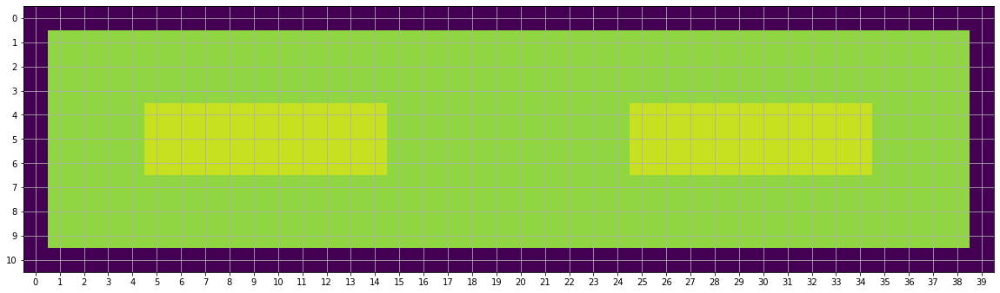

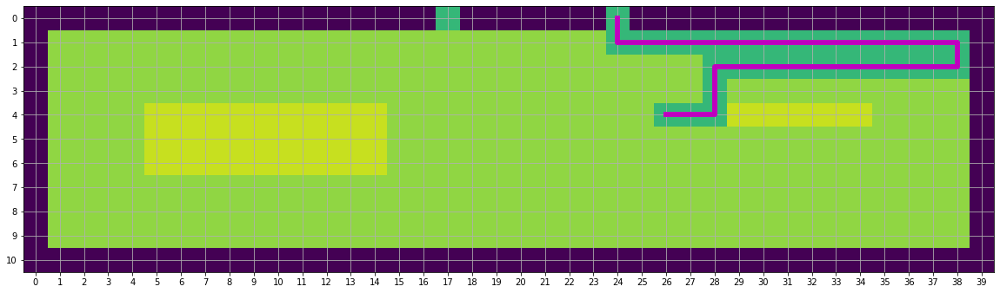

In [13]:
agent.restore(r"/home/studio-lab-user/sagemaker-studiolab-notebooks/wildcatter-ThreeAmigos/examples/my_checkpoint_1661343140/checkpoint_000020/")
#agent.restore(r"/home/studio-lab-user/sagemaker-studiolab-notebooks/wildcatter-ThreeAmigos/examples/my_checkpoint_1661352120/checkpoint_001020/")

env_config = env_2d_two_rectangular_targets_config
env = SimpleDriller(env_config)
print("Beginning Drill Campaign")
obs = env.reset()
done = False
score = 0
plt.figure(figsize=(20, 20))
plt.imshow(env.state, vmin=-10, vmax=2)
plt.xticks(np.arange(0, env.ncol, 1.0))
plt.yticks(np.arange(0, env.nrow, 1.0))
plt.xlim([-0.5, env.ncol - 0.5])
plt.ylim([env.nrow - 0.5, -0.5])
plt.grid()

while not done:
    action = agent.compute_action(obs)
    obs, reward, done, info = env.step(action)
    score += reward

print("Reward:",reward)
plt.figure(figsize=(20, 20))
plt.imshow(env.state, vmin=-10, vmax=2)
for well in env.trajectory:
    traj_z, traj_x = np.asarray(well).T
    plt.plot(traj_x, traj_z, "-", c="m", linewidth=6)
plt.xticks(np.arange(0, env.ncol, 1.0))
plt.yticks(np.arange(0, env.nrow, 1.0))
plt.xlim([-0.5, env.ncol - 0.5])
plt.ylim([env.nrow - 0.5, -0.5])
plt.grid()
